In [1]:
import sys
sys.path.append("/home/bl9/gempy/")
#sys.path.append("C:/Users/Fabian/gempy/")
import gempy as gp

%matplotlib inline
import pymc
import numpy as np
import math

from IPython.core.display import Image

from pymc.Matplot import plot
from pymc import graph

from IPython.core.pylabtools import figsize
figsize(15, 6)

import scipy.optimize as sop
import scipy.stats as stats
from scipy.signal import argrelextrema

import matplotlib.mlab as mlab
from matplotlib import pyplot as plt

import importlib

from operator import itemgetter

from mpl_toolkits.mplot3d import Axes3D

from gempy import Topology

import vtk
import evtk

from scipy.interpolate import griddata

In [2]:
# Importing the data from csv files and setting extent and resolution
geo_data = gp.create_data([0,2000,0,2000,-2000,0],[ 50,50,50],
                         #path_f = "./input_data/Fab_TrapModel_Foliations.csv",
                         #path_i = "./input_data/Fab_TrapModel_Points.csv")
                         #path_f = "./input_data/FabLessPoints_Foliations.csv",
                         #path_i = "./input_data/FabLessPoints_Points1.csv")
                         path_f = "./input_data/Fab_Test_Foliations.csv",
                         path_i = "./input_data/Fab_Test_Points2.csv")
geo_data.n_faults = 1

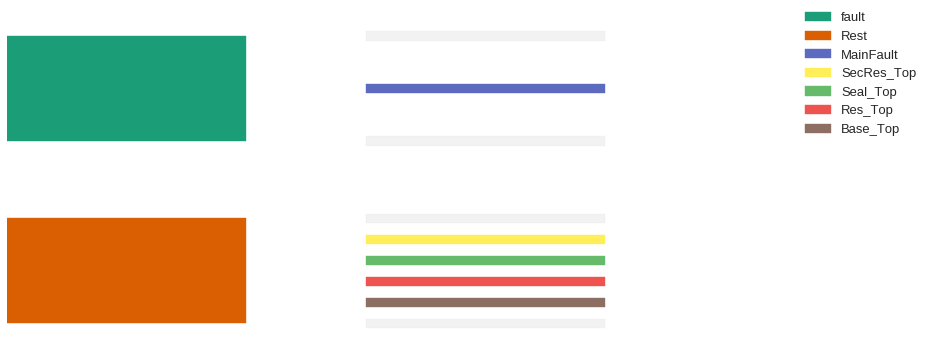

In [3]:
#gp.set_series(geo_data, {"fault":'MainFault', 
#                      "Rest":('Res_Base', 'Res_Top', 'Seal_Top', 'SecondaryReservoir')},
#                       order_series = ["fault","Rest",], order_formations=['MainFault', 
#                                         'SecondaryReservoir', 'Seal_Top', 'Res_Top','Res_Base',
#                                         ]) # for Fab_TrapModel
#
#gp.set_series(geo_data, {"fault":'MainFault', 
#                      "Rest":('Reservoir', 'Seal', 'SecondaryReservoir', 'Overlying')},
#                       order_series = ["fault","Rest",], order_formations=['MainFault', 
#                                         'Overlying', 'SecondaryReservoir', 'Seal','Reservoir',
# #                                        ]) 'for FabLessPoints

gp.set_series(geo_data, {"fault":'MainFault', 
                      "Rest":('Base_Top', 'Res_Top', 'Seal_Top', 'SecRes_Top')},
                       order_series = ["fault","Rest",], order_formations=['MainFault', 
                                         'SecRes_Top', 'Seal_Top', 'Res_Top','Base_Top',
                                         ]) #for Fab_Test

In [4]:
# Creating a row label 'fault side' to distinguish between footwall (FW) and hanging wall (HW)
geo_data.interfaces['fault side'] = 'nan'

In [5]:
HW_border = 1300 # distance of middle of fault (border HW/FW) from footwall border of model
                # (X = 2000 - 1300 = 700)
nonfault_cond = geo_data.interfaces['formation'] != 'MainFault'
fault_cond = geo_data.interfaces['formation'] == 'MainFault'

fw_x_cond = geo_data.interfaces['X'] > (geo_data.extent[:2][1] - HW_border) # condition for FW points

hw_x_cond = geo_data.interfaces['X'] < (geo_data.extent[:2][1] - HW_border) # condition for HW points

geo_data.interfaces.set_value(fw_x_cond,'fault side','footwall') # setting FW
geo_data.interfaces.set_value(hw_x_cond,'fault side','hanging wall') #setting HW
geo_data.interfaces.set_value(fault_cond,'fault side','nan'); # reverting fault points to 'nan'

In [4]:
#geo_data.set_formation_number(['MainFault','Res_Base', 'Res_Top', 'Seal_Top', 'SecondaryReservoir'])

In [5]:
#gp.data_to_pickle(geo_data, 'BasicFault') #saving data to pickle

In [29]:
#geo_data.interfaces.head()
#gp.get_data(geo_data)

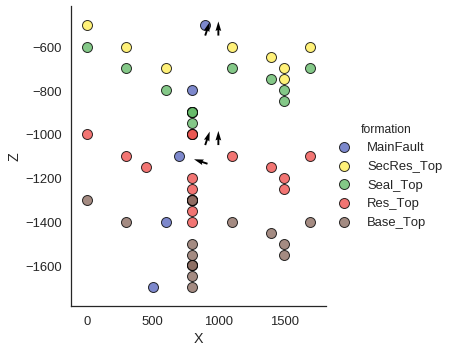

In [6]:
gp.plot_data(geo_data)

In [521]:
gp.plot_data_3D(geo_data)

In [7]:
# INTERPOLATION
interp_data = gp.InterpolatorInput(geo_data, 
                                   u_grade = [3, 3],
                                   compile_theano=True)

Level of Optimization:  fast_compile
Device:  cpu
Precision:  float32


In [8]:
# COMPUTATION OF THE MODEL
lith_sol, fault_sol = gp.compute_model(interp_data)

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.154477984905867e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


In [9]:
# CREATING SURFACES FOR LAYERS
base_surf, base_surf_simp = gp.get_surfaces(interp_data = interp_data, potential_lith=lith_sol[0,1], potential_fault=fault_sol[0,1], n_formation = (interp_data.get_formation_number()['Base_Top']))
res_surf, res_surf_simp = gp.get_surfaces(interp_data = interp_data, potential_lith=lith_sol[0,1], potential_fault=fault_sol[0,1], n_formation = (interp_data.get_formation_number()['Res_Top']))
seal_surf, seal_surf_simp = gp.get_surfaces(interp_data = interp_data, potential_lith=lith_sol[0,1], potential_fault=fault_sol[0,1], n_formation = (interp_data.get_formation_number()['Seal_Top']))
sec_res_surf, sec_res_surf_simp = gp.get_surfaces(interp_data = interp_data, potential_lith=lith_sol[0,1], potential_fault=fault_sol[0,1], n_formation = (interp_data.get_formation_number()['SecRes_Top']))

In [111]:
#geo_data.get_formation_number().keys()

In [29]:
#geo_data.get_formations()

In [465]:
geo_data.get_formation_number()

{'Base_Top': 5,
 'DefaultBasement': 0,
 'MainFault': 1,
 'Res_Top': 4,
 'Seal_Top': 3,
 'SecRes_Top': 2}

In [16]:
gp.plot_surfaces_3D(geo_data, [base_surf, sec_res_surf, seal_surf, res_surf], 
                    [base_surf_simp, sec_res_surf_simp, seal_surf_simp, res_surf_simp], plot_data=True)

In [174]:
gp.plot_surfaces_3D(geo_data, [res_surf], [res_surf_simp])

In [466]:
interp_data.get_formation_number()

{'Base_Top': 5,
 'DefaultBasement': 0,
 'MainFault': 1,
 'Res_Top': 4,
 'Seal_Top': 3,
 'SecRes_Top': 2}

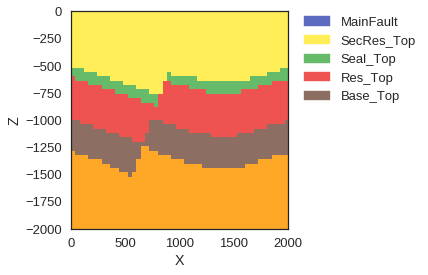

In [10]:
#%matplotlib notebook
%matplotlib inline
gp.plot_section(geo_data, lith_sol[0,0], 25, plot_data=0)

In [10]:
resolution = geo_data.resolution[1] #resolution, standard: 50
model_size = geo_data.extent[:2][1] # 'real' model extent, here: 2000 m - cubic (what if not cubic?)
scale_factor = (model_size/resolution) # scale factor used for calculating voxel volumes in [m]
                                        # here: 2000/50 = 40
rescale_f = interp_data.rescaling_factor # rescaling factor from geo_data to interp_data

minmax_buffer = False # buffer around local min and max values [on/off] - not used atm

In [11]:
# FUNCTION TO FIND ANTICLINAL SPILL POINT AND CROSS-FAULT LEAK POINT
def spill_leak_P(interp_data, res_surf):    
    
    # creating a grid with uniform distances for vertices of the reservoir surface
    grid_x, grid_y = np.meshgrid(np.unique(interp_data.geo_data_res.grid.grid[:, 0]),
                             np.unique(interp_data.geo_data_res.grid.grid[:, 1]))

    grid_x=(grid_x*rescale_f)-(np.min(grid_x)*rescale_f)
    grid_y=(grid_y*rescale_f)-(np.min(grid_y)*rescale_f)
    
    grid_z0 = griddata(res_surf[:,:2], res_surf[:,2],
                       (grid_x, grid_y), method='linear')
    
    # order of values that serve to find relative extrema (min/max)
    rel_order_max = 5
    rel_order_min = 2
    
    # check grid_z0 for max and min in directions x and y
    # direction X
    minX1,minX2 = argrelextrema(grid_z0,np.less,order=rel_order_min,axis=1)
    maxX1,maxX2 = argrelextrema(grid_z0,np.greater,order=rel_order_max,axis=1)
    grid_minX = np.zeros_like(grid_z0)
    grid_minX[minX1,minX2]=1           # grid of min in X
    grid_maxX = np.zeros_like(grid_z0)
    grid_maxX[maxX1,maxX2]=1           # grid of max in X
    
    #direction Y
    minY1,minY2 = argrelextrema(grid_z0,np.less,order=rel_order_min,axis=0)
    maxY1,maxY2 = argrelextrema(grid_z0,np.greater,order=rel_order_max,axis=0)
    grid_minY = np.zeros_like(grid_z0)
    grid_minY[minY1,minY2]=1           # grid of min in Y
    grid_maxY = np.zeros_like(grid_z0)
    grid_maxY[maxY1,maxY2]=1           # grid of max in Y
    
    # minmax buffering - not used atm
    # supposed to set neighboring values of min and max to min and max respectively, too 
    if minmax_buffer:
        grid_minX = np.logical_or(grid_minX,np.roll(grid_minX,1))
        grid_minX = np.logical_or(grid_minX,np.roll(grid_minX,-1))
        grid_maxX = np.logical_or(grid_maxX,np.roll(grid_maxX,1))
        grid_maxX = np.logical_or(grid_maxX,np.roll(grid_maxX,-1))
        grid_minY = np.logical_or(grid_minY,np.roll(grid_minY,1))
        grid_minY = np.logical_or(grid_minY,np.roll(grid_minY,-1))
        grid_maxY = np.logical_or(grid_maxY,np.roll(grid_maxY,1))
        grid_maxY = np.logical_or(grid_maxY,np.roll(grid_maxY,-1))
    
    #check for saddle points
    saddle_p1 = np.logical_and(grid_minX,grid_maxY)
    saddle_p2 = np.logical_and(grid_minY,grid_maxX)
    saddle_p_all= np.logical_or(saddle_p1, saddle_p2)
    
    # this should find saddle points relative to X and Y directions
    # problem of finding other points in a rotated direction?
    
    # fault leak line: defining line of juxtaposition, point of cross-fault leakage to be found on it
    # check for minima line that is on hanging wall side compared to max contact of layer top with fault
    fault_max_line_bool = np.copy(grid_maxX)
    fault_max_line = fault_max_line_bool.argmax(axis=1)
    fault_max = np.max(fault_max_line) # max of fault-layer contact as threshold        
    fleak_line = np.copy(grid_minX).astype(int)
    fleak_line[:,fault_max:]=0 # only returns minima at hanging wall side
    
    #fleak_line_z0 = grid_z0[fleak_line]
    #leak_max = fleak_line==np.nanargmax(fleak_line_z0)
    #print(np.nanargmax(fleak_line_z0))
    ### NOT FINISHED: DEFINE LEAK POINT OVER LEAK LINE MAX?
    
    # distinguish anticlinal spill points from fault leak points:
    pot_leak_points = np.logical_and(fleak_line,saddle_p_all)    
    pot_spill_points = saddle_p_all - pot_leak_points    # substracting leak bool from saddle point bool 
                                                    # to get spill point bool    
    # leak and spill point 3D coordinates
    # LEAK POINT
    pot_leak_Xcoord = grid_x[pot_leak_points]
    pot_leak_Ycoord = grid_y[pot_leak_points]
    pot_leak_Zcoord = grid_z0[pot_leak_points]    
    pot_leak_3Dcoord = np.array(list(zip(pot_leak_Xcoord, pot_leak_Ycoord, pot_leak_Zcoord)))
    
    if pot_leak_3Dcoord.size == 0:
        fault_leak_3Dcoord = np.array([]) # if no leak coordinates found, set to empty array
    else:
        max_leak_pos = pot_leak_3Dcoord[:,2].argmax(axis=0)
        fault_leak_3Dcoord = pot_leak_3Dcoord[max_leak_pos,:] # max is LP
        
    # SPILL POINT
    pot_spill_Xcoord = grid_x[pot_spill_points]
    pot_spill_Ycoord = grid_y[pot_spill_points]
    pot_spill_Zcoord = grid_z0[pot_spill_points]    
    pot_spill_3Dcoord = np.array(list(zip(pot_spill_Xcoord, pot_spill_Ycoord, pot_spill_Zcoord)))
    
    if pot_spill_3Dcoord.size == 0:
        anticline_spill_3Dcoord = np.array([]) # if no leak coordinates found, set to empty array
    else:
        max_spill_pos = pot_spill_3Dcoord[:,2].argmax(axis=0)
        anticline_spill_3Dcoord = pot_spill_3Dcoord[max_spill_pos,:] # max is SP
        
    #print('SP',anticline_spill_3Dcoord)
    #print('LP',fault_leak_3Dcoord)
    
    # PLOTTING (for visualization and checking)
    # plot of min/max bools and all potential LPs(+) and SPs(x):
    if True:
        figsize(15,6)
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        #ax.scatter(grid_x, grid_y, grid_z0, c="b", alpha = 0.1)
        ax.scatter(grid_x, grid_y, grid_minY, c="b", alpha = 0.1)
        ax.scatter(grid_x, grid_y, grid_maxY, c="r", alpha = 0.1)
        ax.scatter(grid_x, grid_y, grid_minX, c="b", alpha = 0.1)
        ax.scatter(grid_x, grid_y, grid_maxX, c="r", alpha = 0.1)
        ax.scatter(grid_x, grid_y, pot_spill_points, c="black", alpha = 1, marker='x', s = 250)
        ax.scatter(grid_x, grid_y, pot_leak_points, c="black", alpha = 1, marker='', s = 250)
        #ax.scatter(grid_x, grid_y, fleak_line, c="b", alpha = 1, marker='+', s= 250)
        #ax.scatter(grid_x, grid_y, leak_max[2], c="g", alpha = 1, marker='+', s= 250)
        
        ax.set_xlabel('X Label')
        ax.set_ylabel('Y Label')
        ax.set_zlabel('Z Label')
        
        plt.show()
    
    # plot of reservoir top surface and position of all potential LPs(+) and SPs(x):
    plot_spill_leak(res_surf, pot_spill_points, anticline_spill_3Dcoord, fault_leak_3Dcoord, grid_x, grid_y, grid_z0)
    
    return anticline_spill_3Dcoord, fault_leak_3Dcoord

In [12]:
# LITHOLOGY BLOCK MASKING FUNCTIONS

# Masking function that confines to voxels which are part fo the reservoir formation,
# in the footwall side and above the z-horizontal defined by the spill or leak point
def res_mask(lith,fault, bottom_z, formation_nr):
    mask = np.ones_like(lith)
    mask[~formation_nr] = False
    mask[fault.astype(bool)] = False
    bottom_z = bottom_z/scale_factor
    mask = mask.reshape(50,50,50)
    mask[:,:,:bottom_z] = False
    mask = mask.reshape(125000,)
    return mask

# Function that sets all voxels of lith_block which are equal (or closest to) to the spill_z
# horizontal as belonging to the overlying seal 
# (the voxels is located on the border of reservoir and seal):
def set_spill_to_seal(geo_data, lith, max_z):
    lith_spill = np.argmin(np.abs(geo_data.grid.grid[:, 2]+np.abs(max_z)))
    bol_lith_spill = geo_data.grid.grid[:, 2] == geo_data.grid.grid[:, 2][lith_spill]
    lith[bol_lith_spill] = 6
    return lith
        ### How to check in here, if single spill voxel = reservoir (5)??? Need x and y pos?

# Masking that confines the volume to ONLY those reservoir traps (from res_mask)
# that are NOT connected to the borders of the model (open system)
# Traps defined as CLOSED systems
def topo_analysis(lith, fault):
    fig = plt.figure()
    traps = []
    # Padding of lith- and fault-block (creating border sections, formation number = 8)
    lith_pad = (np.pad(lith.reshape(50,50,50), 1, 'constant', constant_values = (8,8)))
    fault_pad = (np.pad(fault.reshape(50,50,50), 1, 'constant', constant_values = (8,8)))
    topo = Topology.Topology(lith_pad, fault_pad)
    #topo.draw_section(25)
    topo_block = topo.labels
    # Finding sections which are possible traps in the reservoir (formation number = 7)
    topo_keys = [int(k) for k in topo.lith_to_labels_lot["7"].keys()]
    pad_keys = [int(p) for p in topo.lith_to_labels_lot["8"].keys()]
    #over_keys = [int(o) for o in topo.lith_to_labels_lot["2"].keys()]
    #sec_res_keys = [int(sr) for sr in topo.lith_to_labels_lot["3"].keys()]
    bool_block = np.zeros_like(topo_block)
    # Check for each possible trap section, if it is connected to a border
    for tk in topo_keys:
        print('Checking Section:', tk)
        # Saving enclosed sections as traps
        if topo.check_adjacency(tk, pad_keys[0]) == False:
            print("TRAP FOUND, section:", tk)
            traps.append(tk)
    if traps == []:
        print('No trap found! =(')
    else:
        for i in traps:
            # Creating a mask from the trap sections in the label block
            top_bool = topo_block == i
            bool_block[top_bool] = True
            ### Extra check for juxtaposition with layers above seal
            #if topo.check_adjacency(i, over_keys[0]) == False and topo.check_adjacency(i, sec_res_keys[0]) == False:
            #    print('Trap sealed upwards.')
            #    top_bool = topo_block == i
            #    bool_block[top_bool] = True
            #else: 
            #    print("Juxtaposition, no trap sealing.")
    # Removing padding
    trap_mask = bool_block[1:-1,1:-1,1:-1]
    #plt.imshow(trap_mask[:,25,:].T, origin="lower")
    #plt.show()
    return trap_mask

In [13]:
# MAIN FUNCTION: Calculation of maximum fill volume in reservoir traps

def max_trap_vol(interp_data, lith, fault, res_surface, fault_sealing):
    
    bottom_surface = np.ones_like(res_surface) # needed?   
    
    # calculate spill point
    spill_point, leak_point = spill_leak_P(interp_data, res_surface)
    
    #CHECK: ONLY CONTINUE IF SPILL POINT FOUND, ELSE RETURN ZERO TRAP VOLUME
    if spill_point.size == 0:
        spill_z = np.nan
        print('No SPILL POINT found!')
        trap_vol = 0
        final_trap_mask = np.zeros_like(lith)
        return trap_vol, lith, bottom_surface, final_trap_mask    
    
    else:
        print('SPILL POINT:',spill_point)
        spill_z = spill_point[2]
        #spill_z, spill_p, spill_min_line, spill_bottom = spill_point(res_surface)
        # calculate leak point
        if leak_point.size == 0:
            print('No LEAK POINT found! So FULL LEAKAGE assumed!')
            #leak_z = np.nan
            leak_z = 0
        else:
            print('Leak Point:',leak_point)
            leak_z = leak_point[2]
        #leak_z, leak_p, leak_line, leak_bottom = leak_point(res_surface)
    
        #PLOTTING OF SPILL, LEAK AND BOTTOM POSSIBLE HERE:
        #plot_spill(res_surface, spill_min_line, spill_p)
        #plot_leak(res_surface, leak_line, leak_p)
        #plot_trap(res_surface, bottom_surface, spill_p, leak_p)
        #PRINTING OF SPILL, LEAK:
        #print('Spill_Z:', spill_z)
        #print('Leak_Z:', leak_z)
        
        # Check for "down-to" z-horizon, maximum depth of reservoir
        # Check for fault sealing and subsequent relevance of leak point
        max_z = np.nanmax([spill_z, leak_z])
        if fault_sealing == True:
            if max_z == spill_z:
                print("Spill point defines trap.")
                print("Fault is sealing. Down to spill.")
                #bottom_surface = spill_bottom
            else:
                print("Fault leak point above spill point.")
                max_z = spill_z
                print("...but fault sealing. Down to spill.")
                #bottom_surface = spill_bottom
        else:
            if max_z == spill_z:
                print("Spill point defines trap.")
                print("Fault is pathway. Down to spill.")
                #bottom_surface = spill_bottom
            else:
                print("Fault leak point above spill point.")
                print("Cross-fault leakage. Down to leak.")
                #bottom_surface = leak_bottom      
        
        #print('Max_Z:', max_z)
        
        res_nr = lith == interp_data.get_formation_number()['Base_Top']
        pre_trap_mask = res_mask(lith, fault, max_z, res_nr)
              
        # volume cells for counting
        vol_cells = 0      
        
        pre_trap_mask_bool = (pre_trap_mask == True)
        # Check if there is anaything in the reservoir mask at all
        if np.count_nonzero(pre_trap_mask_bool) == 0:
            print("No res_formation above max_z!")
            return 0, lith, bottom_surface, pre_trap_mask
        else:
            lith[pre_trap_mask_bool] = 7                           # setting reservoir above bottom on footwall side 
                                                                # (incl. outside trap) to formation value = 7  
            if max_z == spill_z:
                lith = set_spill_to_seal(geo_data, lith, max_z)
            
            #test = lith.reshape(125000)                       
            #for i in range(len(test)):                         #to test pre-trap-masking volume
            #    if test[i] == 7:
            #        vol_cells +=1
            #res_vol = ((scale_factor)**3) * vol_cells 
            #print("VOLUME INCLUDING OUTSIDE TRAP:" ,res_vol)
            
            final_trap_mask = topo_analysis(lith, fault)
            #lith[pre_trap_mask_bool] = 5
            lith[final_trap_mask] = 9                         # setting final trap to formation value = 9
            vol_cells = np.count_nonzero(final_trap_mask)
            
            #calulate volume from cells
            trap_vol = ((scale_factor)**3) * vol_cells 
            
            #return the maximum reservoir volume
            return trap_vol, lith, bottom_surface, final_trap_mask

In [14]:
# PLOTTING FUNCTIONS: Spill and leak point visualization
def plot_spill_leak(res_surface, pot_spills, spill_point, leak_point, grid_x, grid_y, grid_z0):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(grid_x, grid_y, grid_z0, c="b", alpha = 0.1)
    #ax.scatter(grid_x, grid_y,pot_spills, c="r", alpha = 1, marker='p', s = 250)
    if spill_point.size != 0:        
        ax.scatter(spill_point[0],spill_point[1],spill_point[2], c="black", alpha = 1, marker='x', s = 250)
    if leak_point.size != 0:        
        ax.scatter(leak_point[0],leak_point[1],leak_point[2], c="black", alpha = 1, marker='+', s = 250)
        
    ax.set_xlabel('X Label')
    ax.set_ylabel('Y Label')
    ax.set_zlabel('Z Label')
    
    plt.show()

In [15]:
# for setting up postional conditions to determine thicknesses and the like:
fw_th_point = 900 # distance of test point for thickness from footwall border of model 
                  # (e.g.: X = 2000 - 900 = 1100)
HW_border = 1300 # distance of middle of fault (border HW/FW) from footwall border of model
                # (X = 2000 - 1300 = 700)

# SAVING ORIGINAL Z-VALUES (so they are not overwritten and can be used a base for every iteration)    
sec_res_z = interp_data.geo_data_res.interfaces[interp_data.geo_data_res.interfaces['formation'] == 'SecRes_Top']['Z']
seal_z = interp_data.geo_data_res.interfaces[interp_data.geo_data_res.interfaces['formation'] == 'Seal_Top']['Z']
res_z = interp_data.geo_data_res.interfaces[interp_data.geo_data_res.interfaces['formation'] == 'Res_Top']['Z']
base_z = interp_data.geo_data_res.interfaces[interp_data.geo_data_res.interfaces['formation'] == 'Base_Top']['Z']

#res_len = len(interp_data.geo_data_res.interfaces[interp_data.geo_data_res.interfaces['formation'] == 'Res_Top']['Z'])    

# SETTING Z-UNCERTAINTIES FOR EACH LAYER TOP
std_secres_top = 10
std_seal_top = 20
std_res_top = 40
std_base_top = 60
z_unc_secres_top = pymc.Normal('z_unc_secres_top', 0, 1./np.square(std_secres_top/rescale_f))
z_unc_seal_top = pymc.Normal('z_unc_seal_top', 0, 1./np.square(std_seal_top/rescale_f))
z_unc_res_top = pymc.Normal('z_unc_res_top', 0, 1./np.square(std_res_top/rescale_f))
z_unc_base_top = pymc.Normal('z_unc_base_top', 0, 1./np.square(std_base_top/rescale_f))

# SETTING FAULT OFFSET UNCERTAINTY
std_offset = 75
offset_unc = pymc.Normal('offset_unc', 0/rescale_f, 1./np.square(std_offset/rescale_f))

# FAULT SEALING UNCERTAINTY (p = probability of success (1 = True); True = fault sealing)
fault_sealing = pymc.Bernoulli('fault_sealing_unc',p=.25)

In [16]:
# Boolean conditions to find data points for each formation
base_top_cond = interp_data.geo_data_res.interfaces['formation'] == 'Base_Top'
res_top_cond = interp_data.geo_data_res.interfaces['formation'] == 'Res_Top'
seal_top_cond = interp_data.geo_data_res.interfaces['formation'] == 'Seal_Top'
secres_top_cond = interp_data.geo_data_res.interfaces['formation'] == 'SecRes_Top'

# Footwall and hanging wall conditions
footwall = interp_data.geo_data_res.interfaces['fault side'] == 'footwall'
hanging_wall = interp_data.geo_data_res.interfaces['fault side'] == 'hanging wall'

# Combining hanging wall and formation conditions
HW_secres_top = np.logical_and(secres_top_cond,hanging_wall)
HW_seal_top = np.logical_and(seal_top_cond,hanging_wall)
HW_res_top = np.logical_and(res_top_cond,hanging_wall)
HW_base_top = np.logical_and(base_top_cond,hanging_wall)

#interp_data.geo_data_res.interfaces.set_value(HW_secres_top,'Z',25)

Z variations top to bottom: 25.0866367551 2.71637329426 -10.0386787901 15.3486069388
Fault offset variation: -83.8404022912


/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:58: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:59: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:60: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:69: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:71: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:80: UserWarning: Boolean Serie

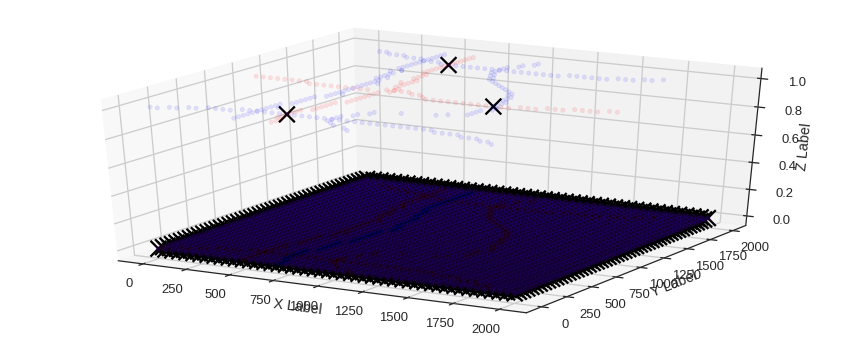

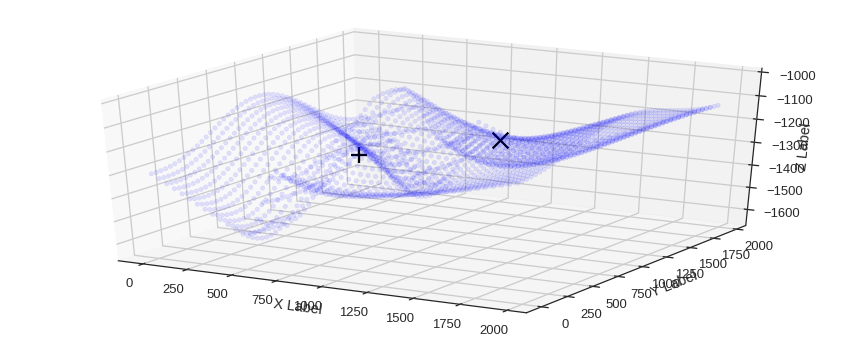

SPILL POINT: [ 1387.75512695   857.1428833  -1168.37697183]
Leak Point: [  571.42858887   938.7755127  -1311.40329301]
Spill point defines trap.
Fault is sealing. Down to spill.


/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  # This is added back by InteractiveShellApp.init_path()


Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 23040000.0 m³


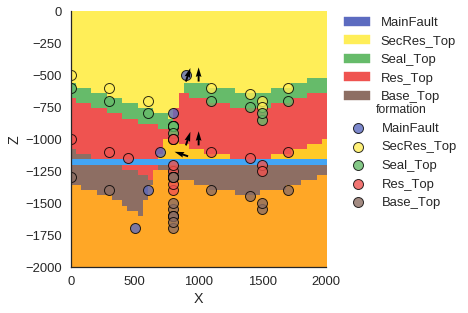

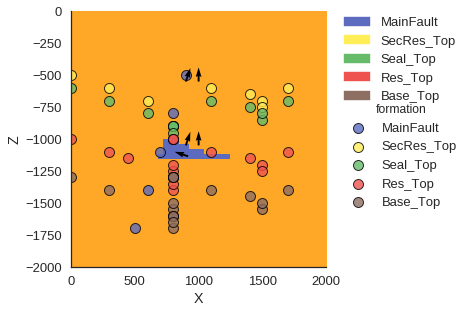

In [17]:
# PYMC MODEL FUNCTIONS 

# Updating of interp_data points with new z-values resulting from z-positional uncertainty
# and including offset uncertainty:
@pymc.deterministic
def interp_unc(value=0, z_unc_secres_top = z_unc_secres_top, z_unc_seal_top=z_unc_seal_top, 
                  z_unc_res_top = z_unc_res_top, z_unc_base_top = z_unc_base_top, off_unc=offset_unc):
    #print('CHECK0:', res_z)
    new_z_secres_top = sec_res_z + z_unc_secres_top
    new_z_seal_top = seal_z + z_unc_seal_top
    new_z_res_top = res_z + z_unc_res_top
    new_z_base_top = base_z + z_unc_base_top   
    
    # for offset uncertainty: additional change on hanging wall (HW): 
    HW_new_z_secres_top = new_z_secres_top + off_unc
    HW_new_z_seal_top = new_z_seal_top + off_unc
    HW_new_z_res_top = new_z_res_top + off_unc
    HW_new_z_base_top = new_z_base_top + off_unc
    
    print('Z variations top to bottom:', z_unc_secres_top*rescale_f, 
          z_unc_seal_top*rescale_f, z_unc_res_top*rescale_f, z_unc_base_top*rescale_f)
    
    print('Fault offset variation:', off_unc*rescale_f)
    #print('CHECK1:', new_z_res_top)
    #print('CHECK2:', HW_new_z_res_top)
    
    # FOOTWALL UNCERTAINTY
    interp_data.geo_data_res.interfaces.set_value(secres_top_cond,'Z',new_z_secres_top)
    interp_data.geo_data_res.interfaces.set_value(seal_top_cond,'Z',new_z_seal_top)
    interp_data.geo_data_res.interfaces.set_value(res_top_cond,'Z',new_z_res_top)
    interp_data.geo_data_res.interfaces.set_value(base_top_cond,'Z',new_z_base_top)
    
    # HANGING WALL UNCERTAINTY (incl. offset)
    interp_data.geo_data_res.interfaces.set_value(HW_secres_top,'Z',HW_new_z_secres_top)
    interp_data.geo_data_res.interfaces.set_value(HW_seal_top,'Z',HW_new_z_seal_top)
    interp_data.geo_data_res.interfaces.set_value(HW_res_top,'Z',HW_new_z_res_top)
    interp_data.geo_data_res.interfaces.set_value(HW_base_top,'Z',HW_new_z_base_top)
    
    #print('CHECK3:', interp_data.geo_data_res.interfaces)    
    return interp_data

# Calculating formation thickness based on z-difference between a bottom and top point on the footwall (fw)

# This is done using interp_data, where X,Y and Z-values are rescaled according to the rescaling_factor.
# Value[1] of extent_rescaled equals the maximum extent of model (here: 2000).
# So if we want to find the rescaled chosen X-position (here: 1100), 
# we simply calculate 2000-fw_th_point(here:900) rescaled (see fw_x)
# Y_mid defines that we are looking at a central position (in y-direction) in the model.
# The difference in z between two points has to be rescaled to the original scale again.
rescale_f = interp_data.rescaling_factor

# Reservoir thickness
@pymc.deterministic
def res_th(interp_data=interp_unc):
    fw_x = interp_data.geo_data_res.interfaces['X'] == (interp_data.extent_rescaled['X'].values[1] - (fw_th_point/rescale_f))
    y_mid = interp_data.geo_data_res.interfaces['Y'] == (interp_data.extent_rescaled['Y'].values[1] - (1000/rescale_f))
    points_fw = interp_data.geo_data_res.interfaces[fw_x]
    points_fw = points_fw[y_mid] 
    fw_rb_z = points_fw[base_top_cond]['Z'].values*rescale_f
    fw_sb_z = points_fw[res_top_cond]['Z'].values*rescale_f
    return np.abs(fw_sb_z-fw_rb_z)

#Seal thickness
@pymc.deterministic
def seal_th(interp_data=interp_unc):
    fw_x = interp_data.geo_data_res.interfaces['X'] == (interp_data.extent_rescaled['X'].values[1] - (fw_th_point/rescale_f))
    y_mid = interp_data.geo_data_res.interfaces['Y'] == (interp_data.extent_rescaled['Y'].values[1] - (1000/rescale_f))
    points_fw = interp_data.geo_data_res.interfaces[fw_x]
    points_fw = points_fw[y_mid] 
    fw_r2b_z = points_fw[seal_top_cond]['Z'].values*rescale_f
    fw_sb_z = points_fw[res_top_cond]['Z'].values*rescale_f
    return np.abs(fw_r2b_z-fw_sb_z)

# Secondary reservoir thickness
@pymc.deterministic
def sec_res_th(interp_data=interp_unc):
    fw_x = interp_data.geo_data_res.interfaces['X'] == (interp_data.extent_rescaled['X'].values[1] - (fw_th_point/rescale_f))
    y_mid = interp_data.geo_data_res.interfaces['Y'] == (interp_data.extent_rescaled['Y'].values[1] - (1000/rescale_f))
    points_fw = interp_data.geo_data_res.interfaces[fw_x]
    points_fw = points_fw[y_mid] 
    fw_r2b_z = points_fw[seal_top_cond]['Z'].values*rescale_f
    fw_ob_z = points_fw[secres_top_cond]['Z'].values*rescale_f
    return np.abs(fw_ob_z-fw_r2b_z)

# Volumetric calculation 
@pymc.deterministic
def structural_model(interp_data_M=interp_unc, fault_sealing=fault_sealing):
    lith_sol, fault_sol = gp.compute_model(interp_data_M)
    lith_block = lith_sol[0,0]
    fault_block = fault_sol[0,0]  
    res_top_surf, res_top_surf_simp = gp.get_surfaces(
                                          interp_data = interp_data_M, potential_lith=lith_sol[0,1], 
        potential_fault=fault_sol[0,1], n_formation = interp_data.get_formation_number()['Res_Top'])
    max_vol, lith_sol[0,0], bottom, trap = max_trap_vol(interp_data_M, lith_block, fault_block, res_top_surf, fault_sealing)
    print("Maximum reservoir volume: %s m³" % max_vol)
    #gp.plot_section(geo_data, lith_sol[0,0], 5, plot_data =1)
    gp.plot_section(geo_data, lith_sol[0,0], 25, plot_data =1)
    #gp.plot_section(geo_data, lith_sol[0,0], 45, plot_data =1)
    gp.plot_section(geo_data, trap, 25, plot_data =1)
    return lith_sol, fault_sol, max_vol, trap

In [30]:
iterations = 100

In [31]:
model = pymc.Model([interp_unc, z_unc_res_top, z_unc_base_top, z_unc_seal_top, z_unc_secres_top, offset_unc, fault_sealing, structural_model, res_th, seal_th, sec_res_th])

Z variations top to bottom: -1.6162239062 -4.16455159394 8.39199268951 28.749313827
Fault offset variation: 61.3550017908


/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:80: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:81: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:82: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:58: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:59: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:60: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:69: UserWarning: Boolean Serie

Z variations top to bottom: -1.6162239062 -4.16455159394 8.39199268951 45.6729566357
Fault offset variation: 61.3550017908
Z variations top to bottom: -2.18030897767 -4.16455159394 8.39199268951 45.6729566357
Fault offset variation: 61.3550017908
Z variations top to bottom: -1.6162239062 -4.16455159394 9.64145949679 45.6729566357
Fault offset variation: 61.3550017908
Z variations top to bottom: -1.6162239062 -8.46849252229 9.64145949679 45.6729566357
Fault offset variation: 61.3550017908


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.996489747088333e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)
/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:70: DeprecationWarning: numpy boolean subtract, the `-` operator, is deprecated, use the bitwise_xor, the `^` operator, or the logical_xor function instead.


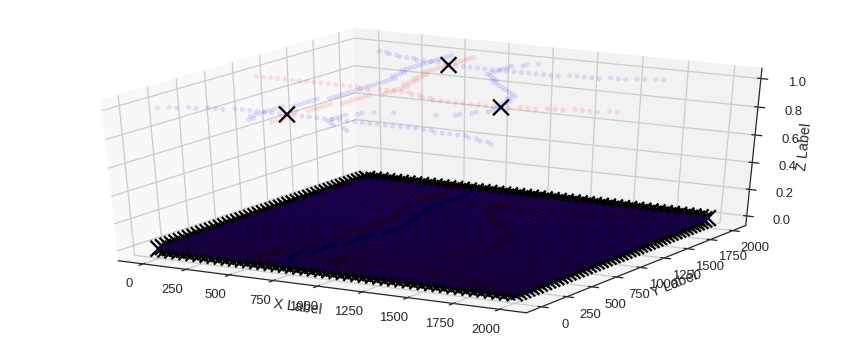

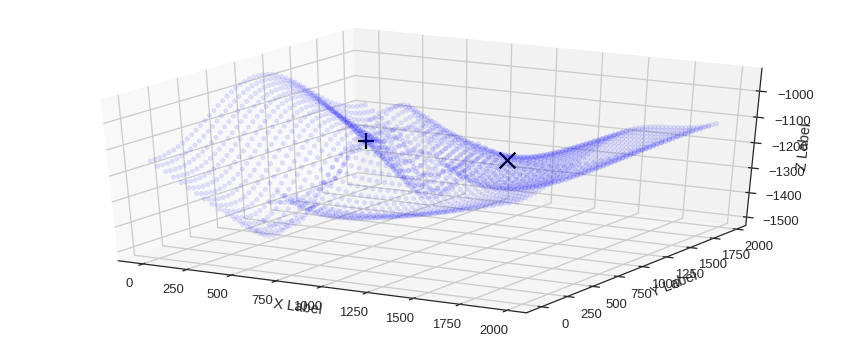

SPILL POINT: [ 1428.57141113   857.1428833  -1149.26561662]
Leak Point: [  612.24487305   938.7755127  -1152.86747684]
Spill point defines trap.
Fault is sealing. Down to spill.


/home/bl9/anaconda3/lib/python3.5/site-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  # This is added back by InteractiveShellApp.init_path()


Checking Section: 21
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
TRAP FOUND, section: 20
Maximum reservoir volume: 14784000.0 m³
 [                  2%                  ] 2 of 100 complete in 13.6 secZ variations top to bottom: -1.6162239062 -8.46849252229 9.64145949679 45.6729566357
Fault offset variation: 36.5490062802
Z variations top to bottom: -1.6162239062 -8.46849252229 9.64145949679 33.3733835261
Fault offset variation: 36.5490062802
Z variations top to bottom: -1.1648559252 -8.46849252229 9.64145949679 33.3733835261
Fault offset variation: 36.5490062802
Z variations top to bottom: -1.1648559252 -8.46849252229 13.0725947578 33.3733835261
Fault offset variation: 36.5490062802
Z variations top to bottom: -1.1648559252 -9.10520123083 9.64145949679 33.3733835261
Fault offset variation: 36.5490062802


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.246839255788281e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


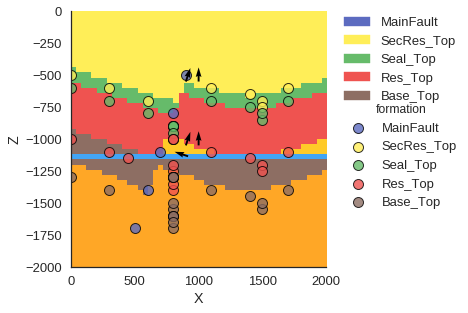

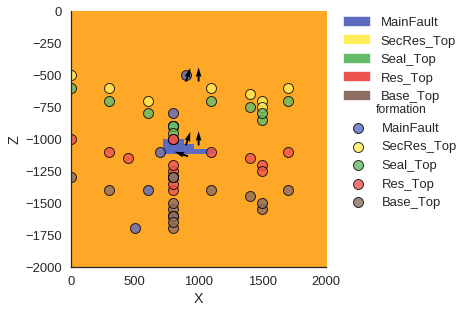

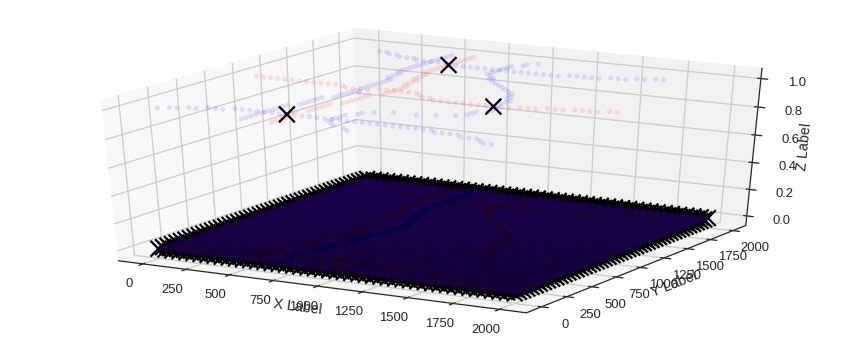

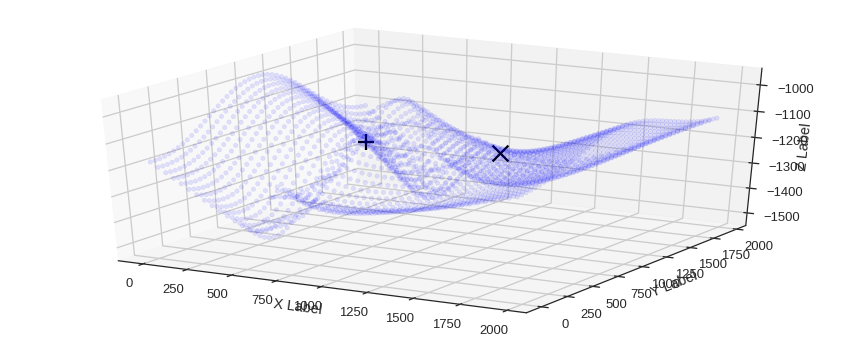

SPILL POINT: [ 1387.75512695   857.1428833  -1149.15560931]
Leak Point: [  612.24487305   938.7755127  -1179.18518462]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14720000.0 m³
 [-                 3%                  ] 3 of 100 complete in 29.9 secZ variations top to bottom: -1.1648559252 -9.10520123083 9.64145949679 33.3733835261
Fault offset variation: -9.91174089291
Z variations top to bottom: -1.1648559252 -9.10520123083 9.64145949679 67.2338634762
Fault offset variation: -9.91174089291
Z variations top to bottom: 1.20566699135 -9.10520123083 9.64145949679 67.2338634762
Fault offset variation: -9.91174089291
Z variations top to bottom: 1.20566699135 -9.10520123083 21.8535391038 67.2338634762
Fault offset variation: -9.91174089291
Z variations top to bottom: 1.20566699135 -9.60907809995 9.64145949679 67.2338634762
Fault offset variation: -9.91174089291


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.4043516349815377e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


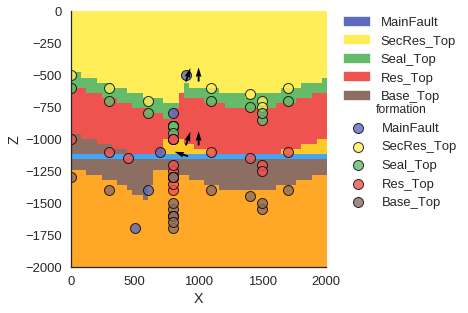

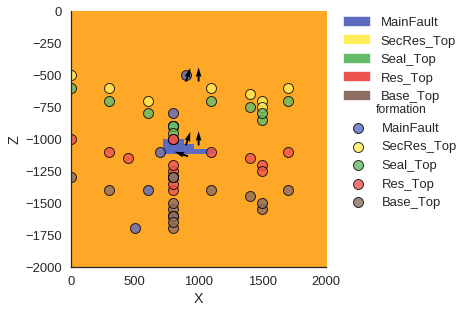

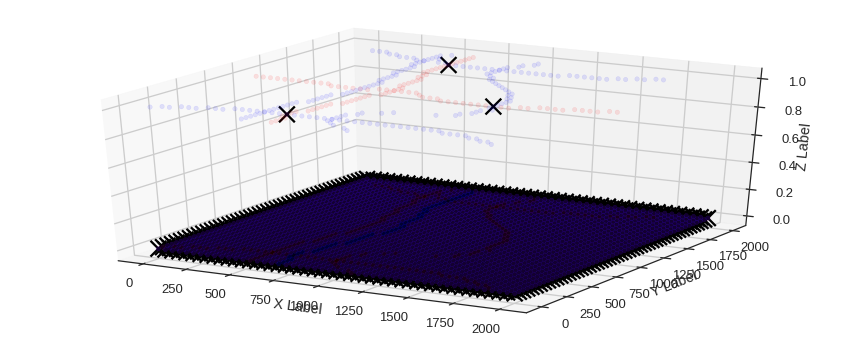

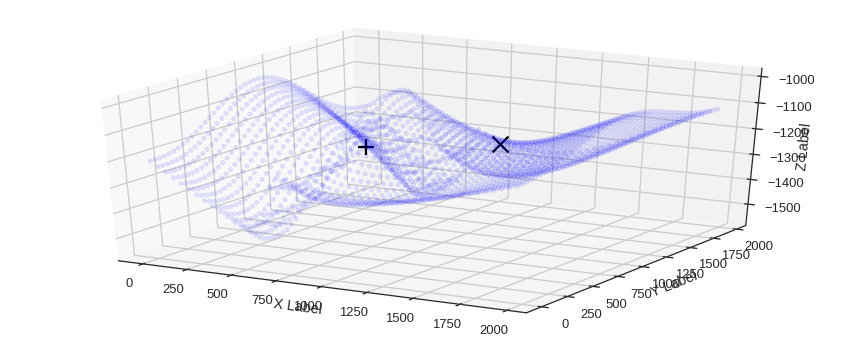

SPILL POINT: [ 1387.75512695   857.1428833  -1149.13967604]
Leak Point: [  612.24487305   938.7755127  -1230.63492957]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14464000.0 m³
 [-                 4%                  ] 4 of 100 complete in 43.6 secZ variations top to bottom: 1.20566699135 -9.60907809995 9.64145949679 67.2338634762
Fault offset variation: -47.1048362595
Z variations top to bottom: 1.20566699135 -9.60907809995 9.64145949679 34.9224428009
Fault offset variation: -9.91174089291
Z variations top to bottom: 4.22445851785 -9.60907809995 9.64145949679 34.9224428009
Fault offset variation: -9.91174089291
Z variations top to bottom: 4.22445851785 -9.60907809995 8.7094357648 34.9224428009
Fault offset variation: -9.91174089291
Z variations top to bottom: 4.22445851785 -15.8995122509 8.7094357648 34.9224428009
Fault offset variation: -9.91174089291


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.827150583610937e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


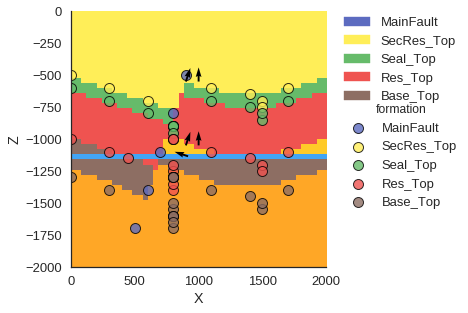

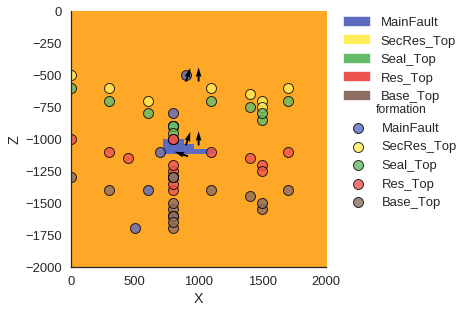

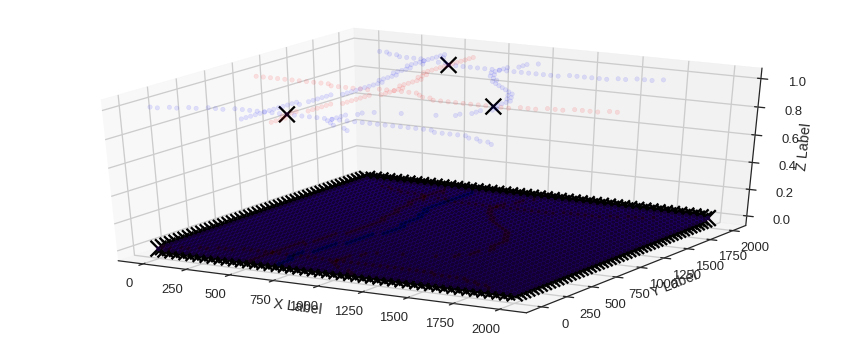

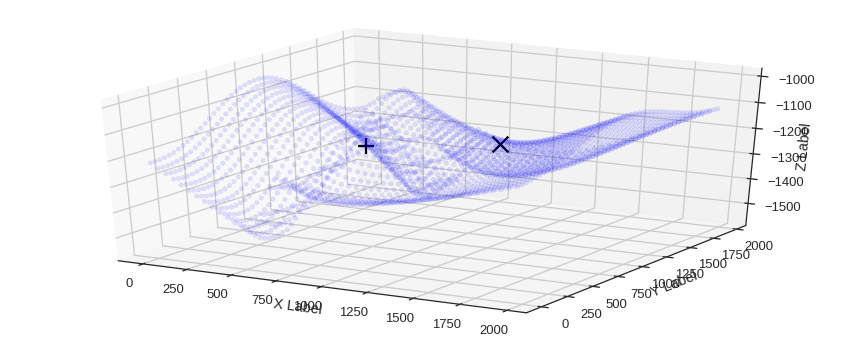

SPILL POINT: [ 1387.75512695   857.1428833  -1150.17149744]
Leak Point: [  612.24487305   938.7755127  -1229.98817729]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14336000.0 m³
 [-                 5%                  ] 5 of 100 complete in 58.3 secZ variations top to bottom: 4.22445851785 -15.8995122509 8.7094357648 34.9224428009
Fault offset variation: -37.9763875962
Z variations top to bottom: 4.22445851785 -15.8995122509 8.7094357648 1.92289860295
Fault offset variation: -37.9763875962
Z variations top to bottom: 3.58369015693 -15.8995122509 8.7094357648 34.9224428009
Fault offset variation: -37.9763875962
Z variations top to bottom: 3.58369015693 -15.8995122509 16.864724757 34.9224428009
Fault offset variation: -37.9763875962
Z variations top to bottom: 3.58369015693 -14.749258406 8.7094357648 34.9224428009
Fault offset variation: -37.9763875962


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.873652267005756e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


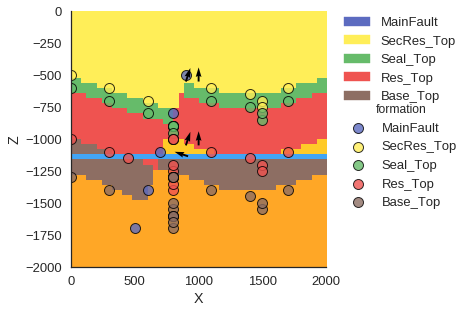

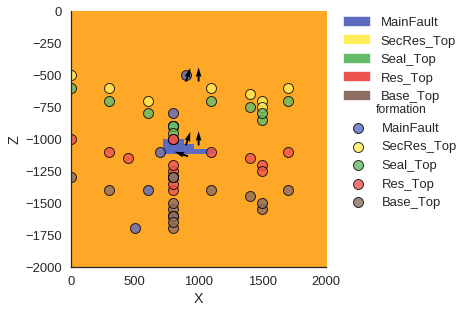

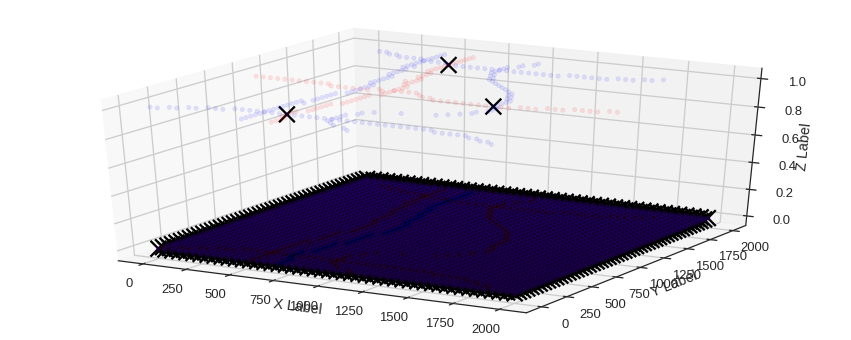

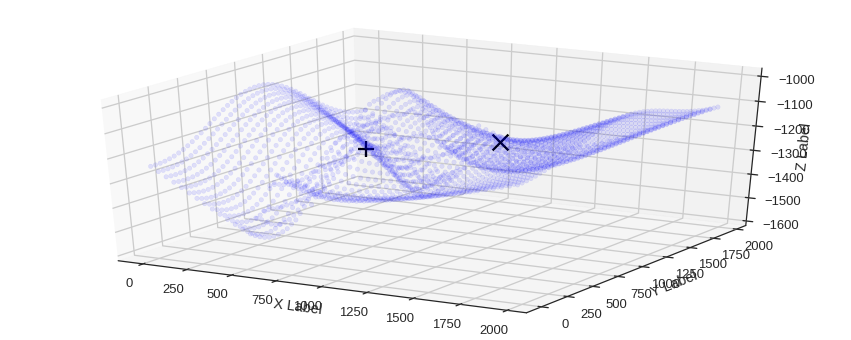

SPILL POINT: [ 1387.75512695   857.1428833  -1149.55311296]
Leak Point: [  612.24487305   938.7755127  -1252.04360915]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14272000.0 m³
 [--                6%                  ] 6 of 100 complete in 71.9 secZ variations top to bottom: 3.58369015693 -14.749258406 8.7094357648 34.9224428009
Fault offset variation: -77.1548290457
Z variations top to bottom: 3.58369015693 -14.749258406 8.7094357648 32.8238688847
Fault offset variation: -77.1548290457
Z variations top to bottom: 4.16485872192 -14.749258406 8.7094357648 32.8238688847
Fault offset variation: -77.1548290457
Z variations top to bottom: 4.16485872192 -14.749258406 23.6584830098 32.8238688847
Fault offset variation: -77.1548290457
Z variations top to bottom: 4.16485872192 -8.87389189566 23.6584830098 32.8238688847
Fault offset variation: -77.1548290457


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.5792195676156418e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


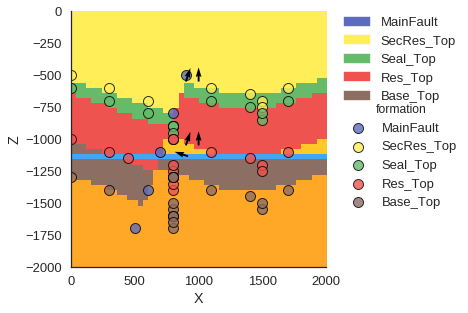

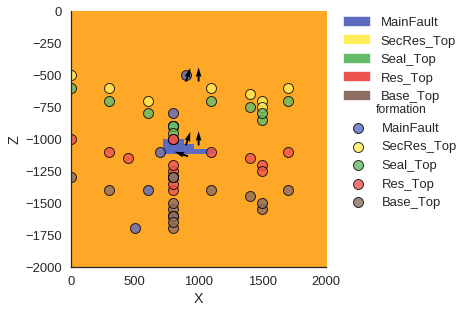

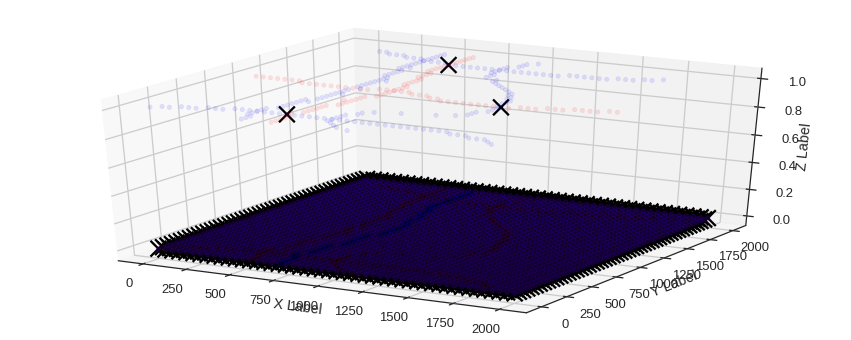

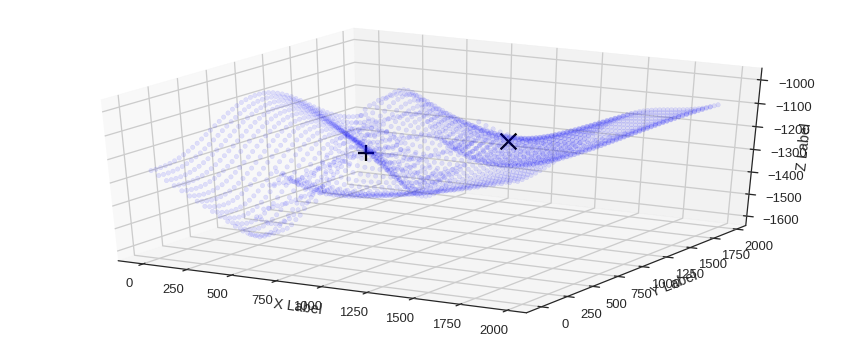

SPILL POINT: [ 1428.57141113   857.1428833  -1135.58771443]
Leak Point: [  612.24487305   938.7755127  -1269.34947087]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 21
Checking Section: 18
TRAP FOUND, section: 18
Maximum reservoir volume: 18816000.0 m³
 [--                7%                  ] 7 of 100 complete in 85.7 secZ variations top to bottom: 4.16485872192 -8.87389189566 23.6584830098 32.8238688847
Fault offset variation: -69.4009706271
Z variations top to bottom: 4.16485872192 -8.87389189566 23.6584830098 40.8871423348
Fault offset variation: -69.4009706271
Z variations top to bottom: 4.35111623053 -8.87389189566 23.6584830098 40.8871423348
Fault offset variation: -69.4009706271
Z variations top to bottom: 4.35111623053 -8.87389189566 23.1135171649 40.8871423348
Fault offset variation: -69.4009706271
Z variations top to bottom: 4.35111623053 -12.1583189439 23.1135171649 40.8871423348
Fault offset variation: -69.4009706271


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.2859567971184047e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


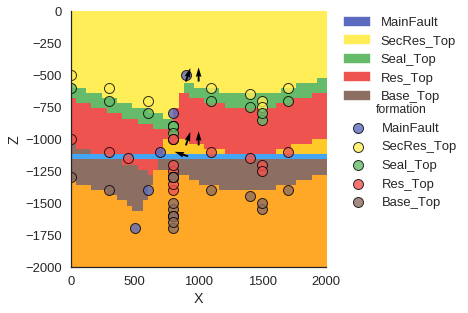

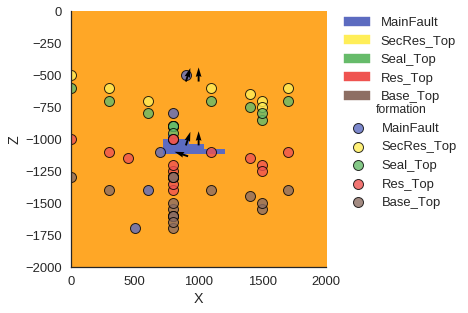

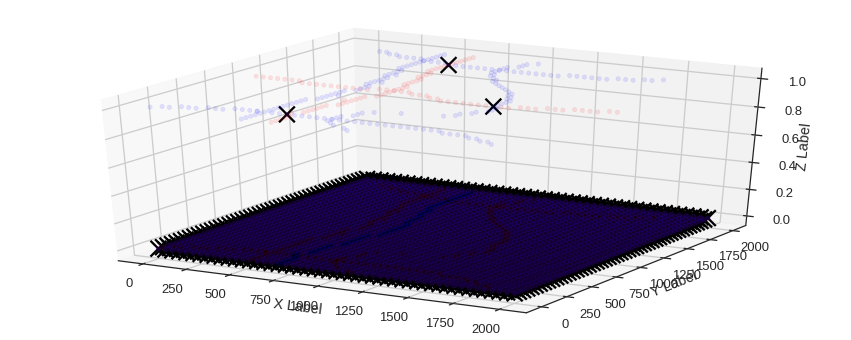

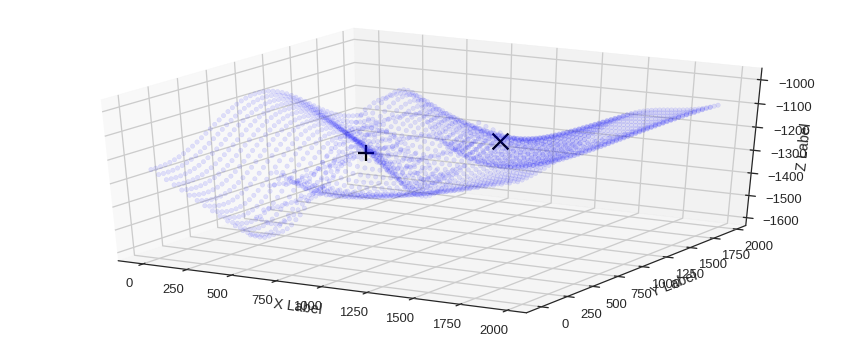

SPILL POINT: [ 1387.75512695   857.1428833  -1136.19366648]
Leak Point: [  612.24487305   938.7755127  -1264.21848997]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 21
Checking Section: 18
TRAP FOUND, section: 18
Maximum reservoir volume: 18688000.0 m³
 [---               8%                  ] 8 of 100 complete in 99.5 secZ variations top to bottom: 4.35111623053 -12.1583189439 23.1135171649 40.8871423348
Fault offset variation: -43.2953152826
Z variations top to bottom: 4.35111623053 -12.1583189439 23.1135171649 -2.6345748323
Fault offset variation: -43.2953152826
Z variations top to bottom: 4.54831056521 -12.1583189439 23.1135171649 40.8871423348
Fault offset variation: -43.2953152826
Z variations top to bottom: 4.54831056521 -12.1583189439 24.1745683449 40.8871423348
Fault offset variation: -43.2953152826
Z variations top to bottom: 4.54831056521 -5.60519304153 24.1745683449 40.8871423348
Fault offset variation: -43.2953152826


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.4278732196496575e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


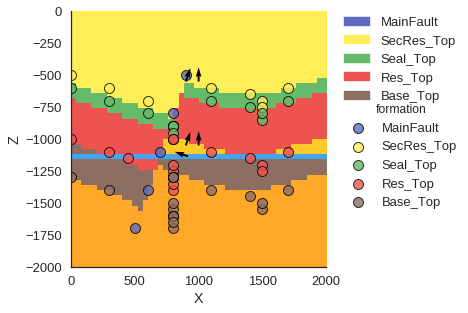

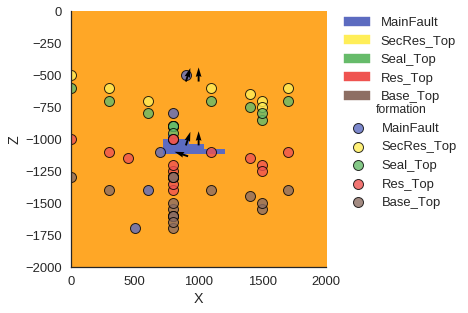

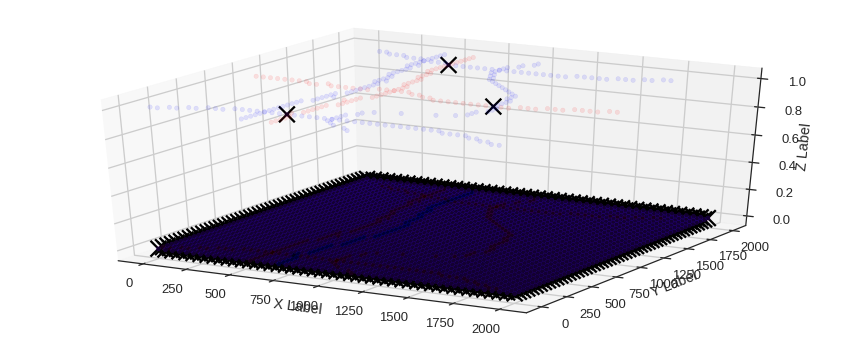

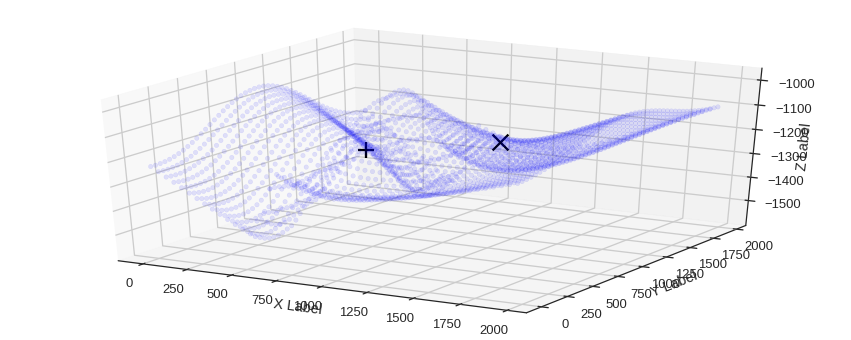

SPILL POINT: [ 1387.75512695   857.1428833  -1135.34755583]
Leak Point: [  612.24487305   938.7755127  -1243.81929158]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 18880000.0 m³
 [---               9%                  ] 9 of 100 complete in 113.1 secZ variations top to bottom: 4.54831056521 -5.60519304153 24.1745683449 40.8871423348
Fault offset variation: -47.7593856743
Z variations top to bottom: 4.54831056521 -5.60519304153 24.1745683449 -11.8803426899
Fault offset variation: -47.7593856743
Z variations top to bottom: 3.59769427456 -5.60519304153 24.1745683449 40.8871423348
Fault offset variation: -47.7593856743
Z variations top to bottom: 3.59769427456 -5.60519304153 21.5018762546 40.8871423348
Fault offset variation: -47.7593856743
Z variations top to bottom: 3.59769427456 -0.432193332993 21.5018762546 40.8871423348
Fault offset variation: -47.7593856743


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.387285464797162e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


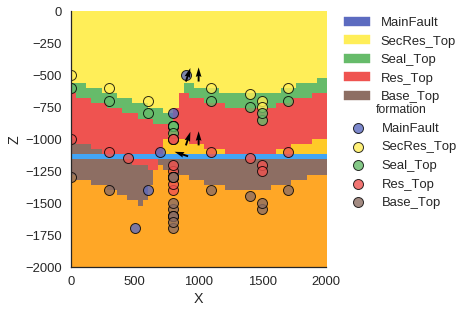

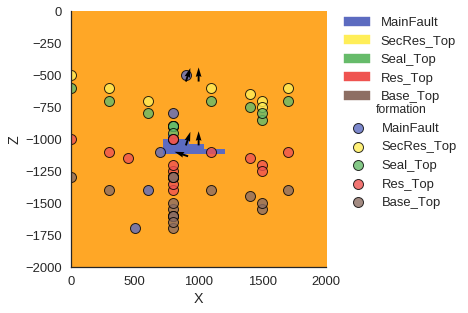

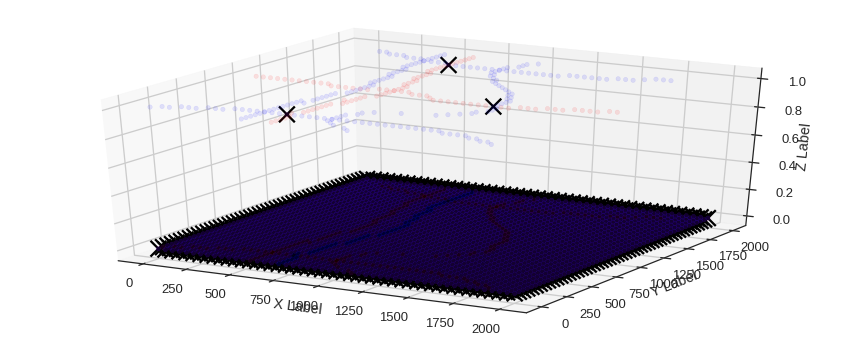

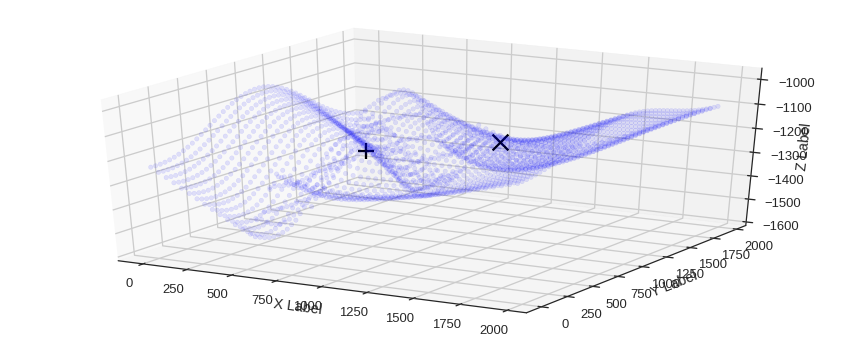

SPILL POINT: [ 1387.75512695   857.1428833  -1137.74666553]
Leak Point: [  612.24487305   938.7755127  -1249.09207757]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 17856000.0 m³
 [---              10%                  ] 10 of 100 complete in 126.9 secZ variations top to bottom: 3.59769427456 -0.432193332993 21.5018762546 40.8871423348
Fault offset variation: -123.211608235
Z variations top to bottom: 3.59769427456 -0.432193332993 21.5018762546 75.2874507303
Fault offset variation: -47.7593856743
Z variations top to bottom: 5.93469243552 -0.432193332993 21.5018762546 75.2874507303
Fault offset variation: -47.7593856743
Z variations top to bottom: 5.93469243552 -0.432193332993 19.5463509199 75.2874507303
Fault offset variation: -47.7593856743
Z variations top to bottom: 5.93469243552 6.43249920344 19.5463509199 75.2874507303
Fault offset variation: -47.7593856743


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.2123490539538437e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


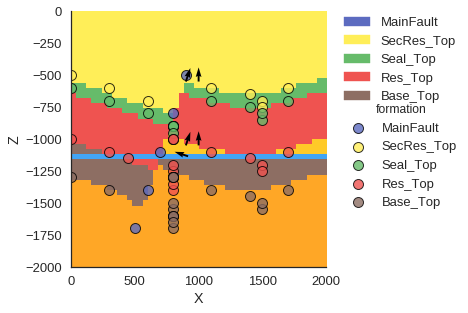

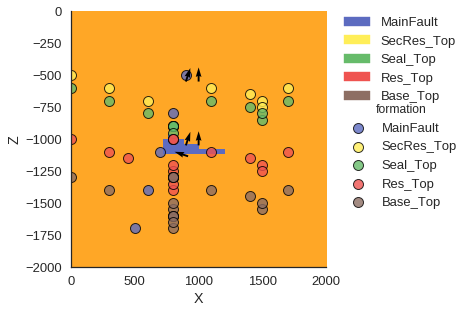

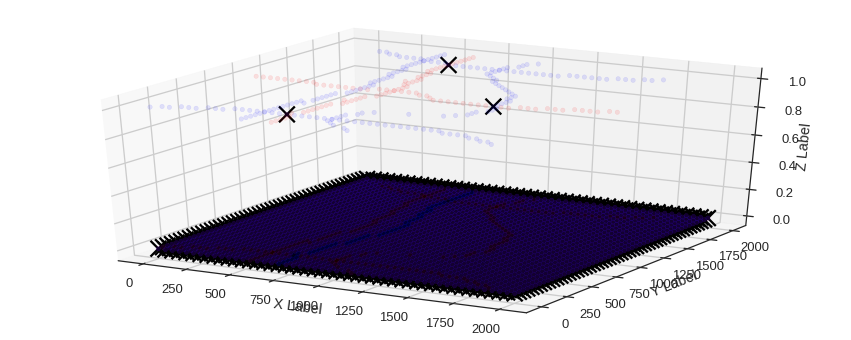

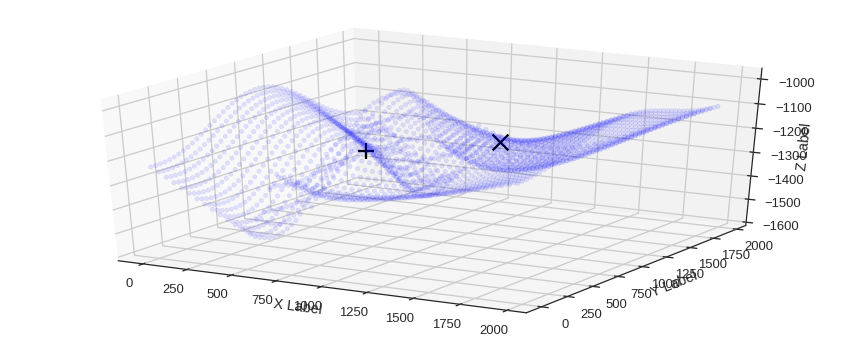

SPILL POINT: [ 1387.75512695   857.1428833  -1140.02432161]
Leak Point: [  612.24487305   938.7755127  -1251.1137737 ]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 17152000.0 m³
 [----             11%                  ] 11 of 100 complete in 140.6 secZ variations top to bottom: 5.93469243552 6.43249920344 19.5463509199 75.2874507303
Fault offset variation: -55.092767193
Z variations top to bottom: 5.93469243552 6.43249920344 19.5463509199 37.0638521245
Fault offset variation: -55.092767193
Z variations top to bottom: 6.89666254731 6.43249920344 19.5463509199 37.0638521245
Fault offset variation: -55.092767193
Z variations top to bottom: 6.89666254731 6.43249920344 11.9892940378 37.0638521245
Fault offset variation: -55.092767193
Z variations top to bottom: 6.89666254731 4.97081891217 11.9892940378 37.0638521245
Fault offset variation: -55.092767193


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.3560172909831145e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


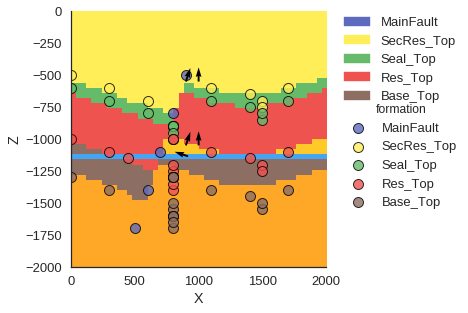

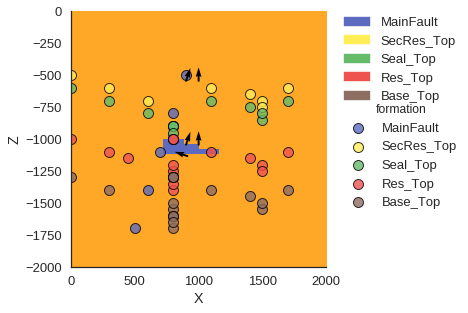

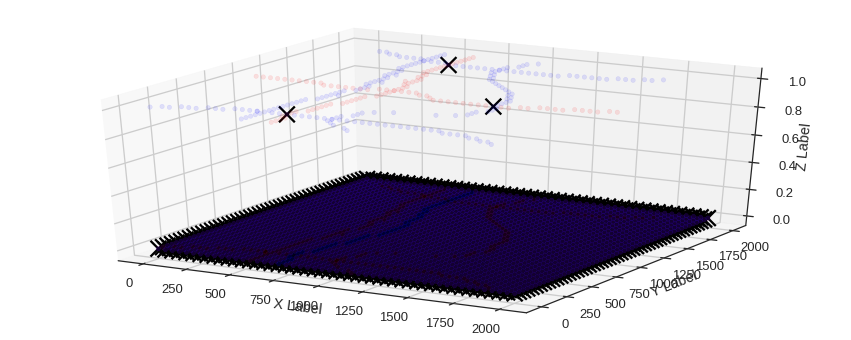

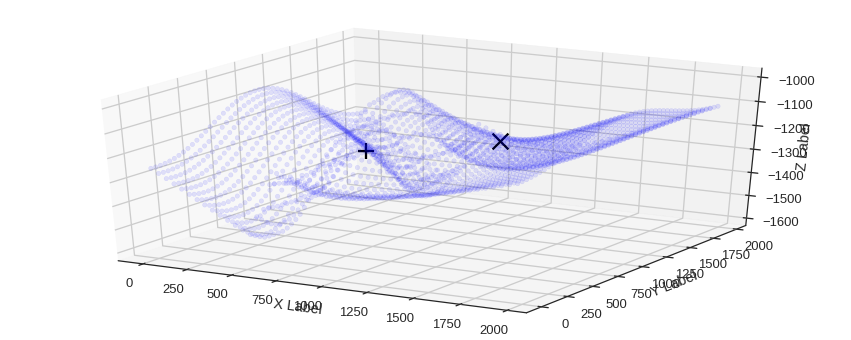

SPILL POINT: [ 1387.75512695   857.1428833  -1146.82119192]
Leak Point: [  612.24487305   938.7755127  -1262.16008067]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 15424000.0 m³
 [----             12%                  ] 12 of 100 complete in 154.7 secZ variations top to bottom: 6.89666254731 4.97081891217 11.9892940378 37.0638521245
Fault offset variation: -17.5911109285
Z variations top to bottom: 6.89666254731 4.97081891217 11.9892940378 -3.96683954761
Fault offset variation: -17.5911109285
Z variations top to bottom: 5.56362792443 4.97081891217 11.9892940378 -3.96683954761
Fault offset variation: -17.5911109285
Z variations top to bottom: 5.56362792443 4.97081891217 5.26930043754 -3.96683954761
Fault offset variation: -17.5911109285
Z variations top to bottom: 5.56362792443 9.69796444434 5.26930043754 -3.96683954761
Fault offset variation: -17.5911109285


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.9594940253719884e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


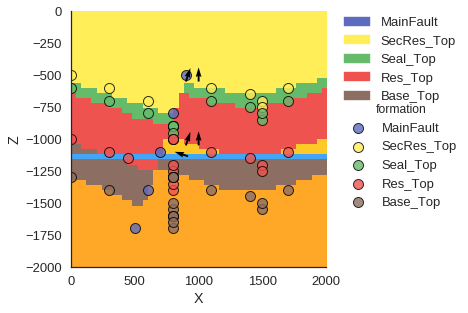

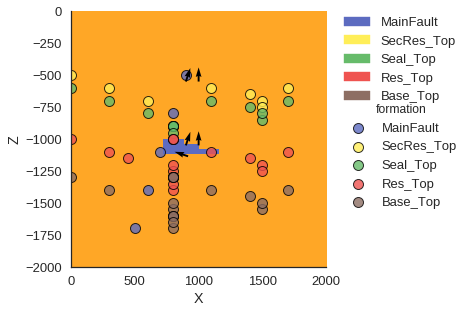

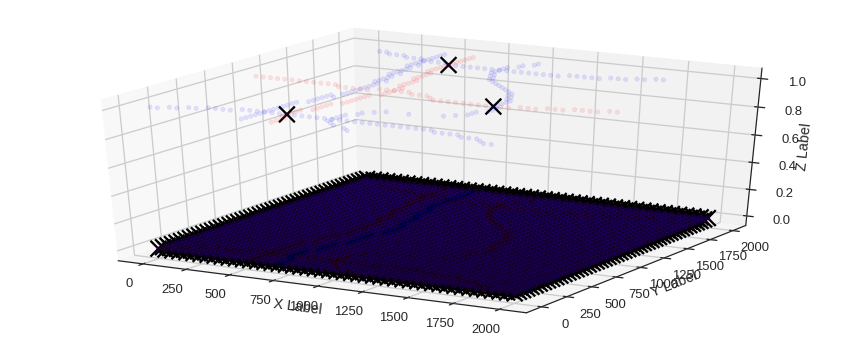

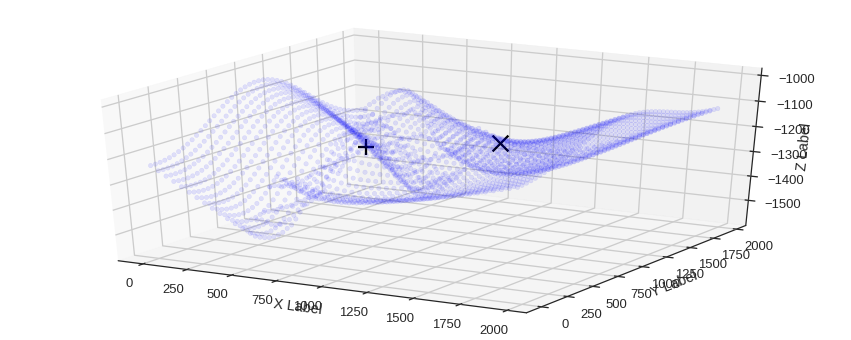

SPILL POINT: [ 1387.75512695   857.1428833  -1153.30136305]
Leak Point: [  612.24487305   938.7755127  -1240.00960159]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13504000.0 m³
 [----             13%                  ] 13 of 100 complete in 169.1 secZ variations top to bottom: 5.56362792443 4.97081891217 5.26930043754 -3.96683954761
Fault offset variation: -17.9438287079
Z variations top to bottom: 5.56362792443 4.97081891217 5.26930043754 -21.0209065132
Fault offset variation: -17.9438287079
Z variations top to bottom: 5.32199937839 4.97081891217 5.26930043754 -3.96683954761
Fault offset variation: -17.9438287079
Z variations top to bottom: 5.32199937839 4.97081891217 13.021546318 -3.96683954761
Fault offset variation: -17.9438287079
Z variations top to bottom: 5.32199937839 8.49406832702 5.26930043754 -3.96683954761
Fault offset variation: -17.9438287079


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.108255063582032e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


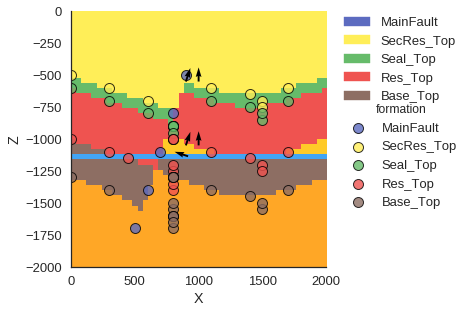

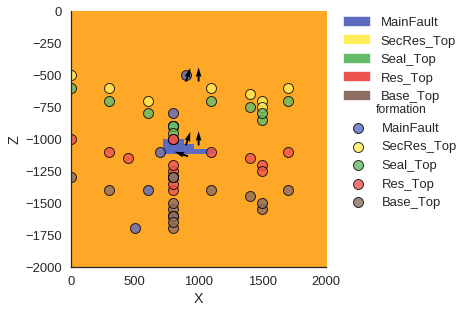

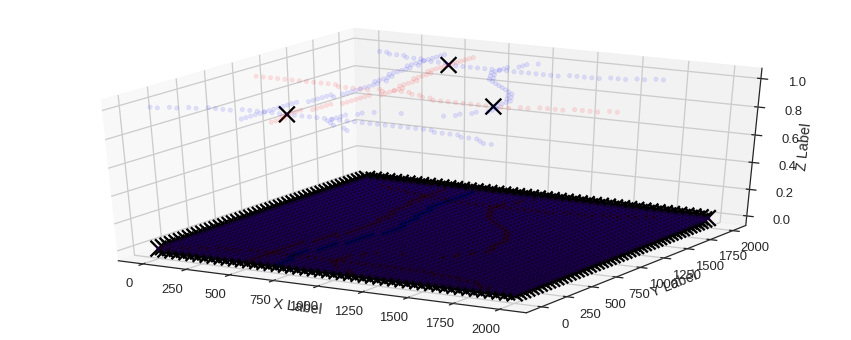

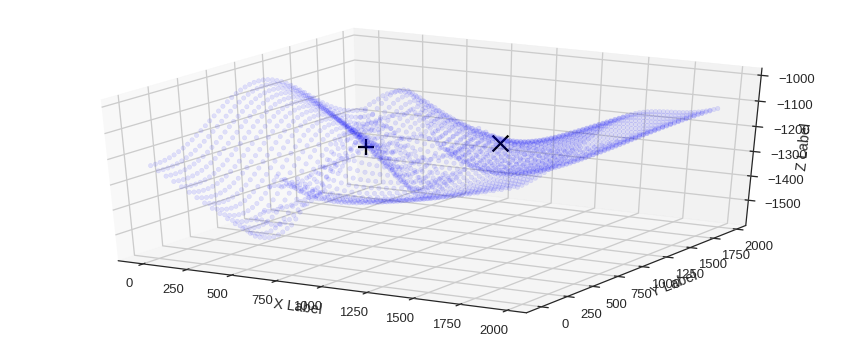

SPILL POINT: [ 1387.75512695   857.1428833  -1153.34523676]
Leak Point: [  612.24487305   938.7755127  -1240.05138743]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13504000.0 m³
 [-----            14%                  ] 14 of 100 complete in 183.7 secZ variations top to bottom: 5.32199937839 8.49406832702 5.26930043754 -3.96683954761
Fault offset variation: -14.328852861
Z variations top to bottom: 5.32199937839 8.49406832702 5.26930043754 -16.7761990241
Fault offset variation: -14.328852861
Z variations top to bottom: 3.5309202681 8.49406832702 5.26930043754 -16.7761990241
Fault offset variation: -14.328852861
Z variations top to bottom: 5.32199937839 8.49406832702 -4.48138262949 -16.7761990241
Fault offset variation: -14.328852861
Z variations top to bottom: 5.32199937839 4.03041716139 -4.48138262949 -16.7761990241
Fault offset variation: -14.328852861


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.5769279071718998e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


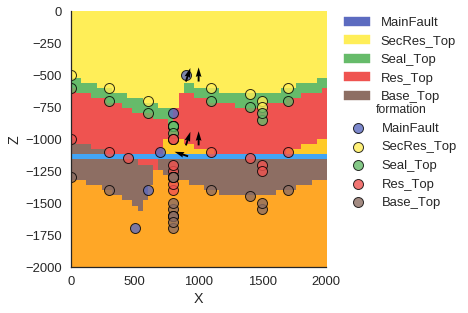

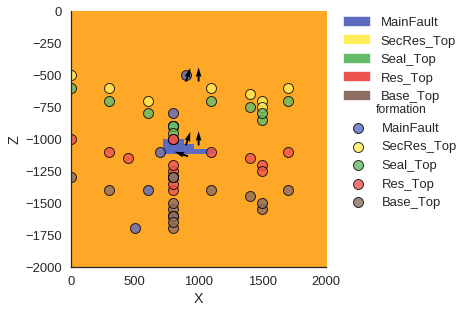

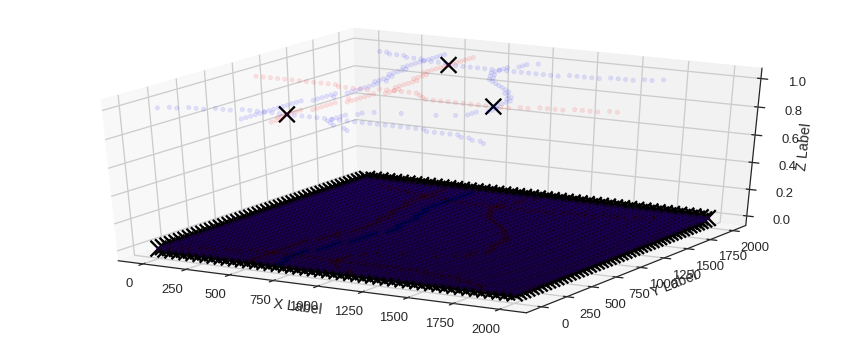

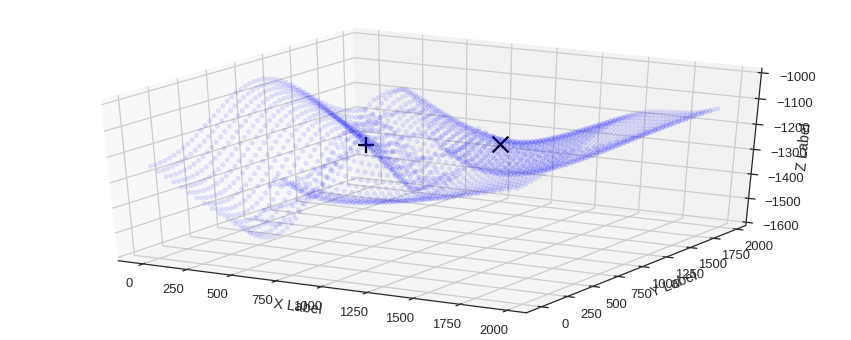

SPILL POINT: [ 1387.75512695   857.1428833  -1163.40246509]
Leak Point: [  612.24487305   938.7755127  -1241.9056617 ]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 25280000.0 m³
 [-----            15%                  ] 15 of 100 complete in 197.4 secZ variations top to bottom: 5.32199937839 4.03041716139 -4.48138262949 -16.7761990241
Fault offset variation: -22.3610592968
Z variations top to bottom: 5.32199937839 4.03041716139 -4.48138262949 22.3380230756
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.10991750251 4.03041716139 -4.48138262949 22.3380230756
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.10991750251 4.03041716139 -11.3713401516 22.3380230756
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.10991750251 -7.46942237699 -11.3713401516 22.3380230756
Fault offset variation: -22.3610592968


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0874615444245173e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


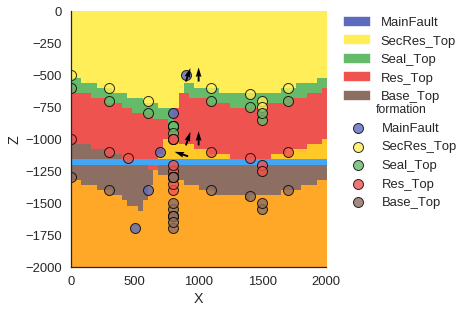

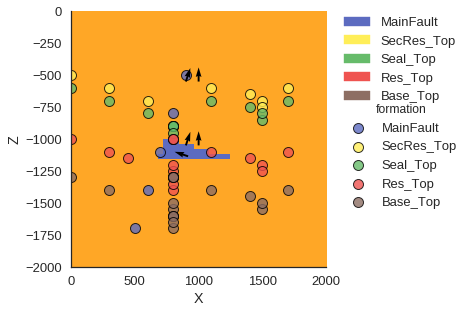

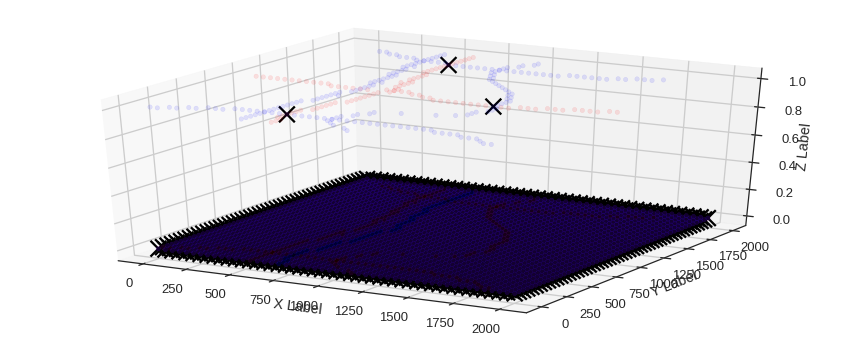

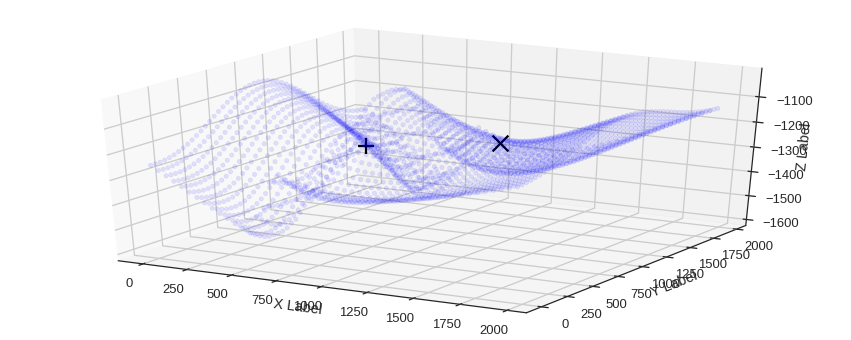

SPILL POINT: [ 1387.75512695   857.1428833  -1169.5037586 ]
Leak Point: [  612.24487305   938.7755127  -1255.22161703]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 22272000.0 m³
 [------           16%                  ] 16 of 100 complete in 211.1 secZ variations top to bottom: 4.10991750251 -7.46942237699 -11.3713401516 22.3380230756
Fault offset variation: 70.4012619046
Z variations top to bottom: 4.10991750251 -7.46942237699 -11.3713401516 21.8094348925
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.01117039476 -7.46942237699 -11.3713401516 21.8094348925
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.01117039476 -7.46942237699 -26.5486670178 21.8094348925
Fault offset variation: -22.3610592968
Z variations top to bottom: 4.01117039476 -3.60751193389 -26.5486670178 21.8094348925
Fault offset variation: -22.3610592968


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.651725477587424e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


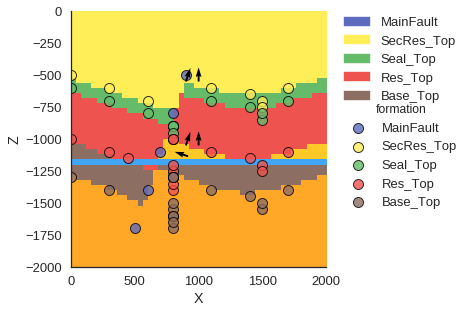

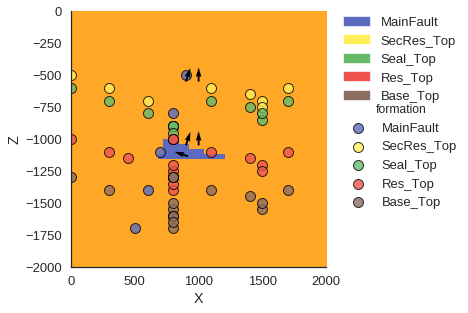

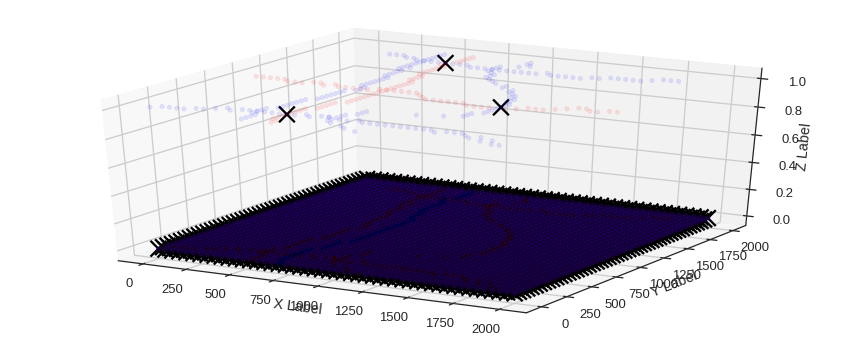

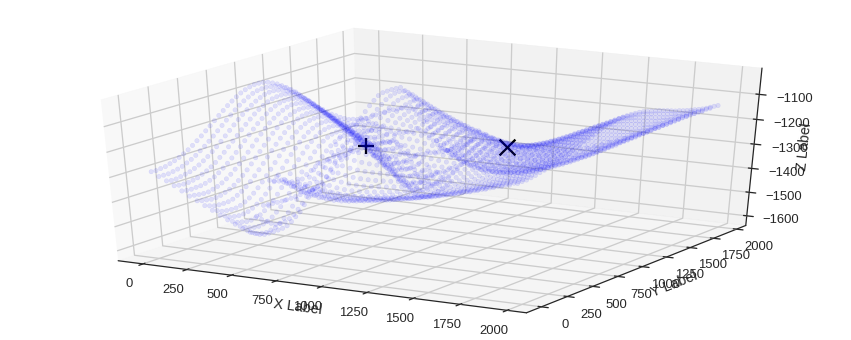

SPILL POINT: [ 1428.57141113   857.1428833  -1192.40606187]
Leak Point: [  612.24487305   938.7755127  -1265.88522528]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 18368000.0 m³
 [------           17%                  ] 17 of 100 complete in 224.8 secZ variations top to bottom: 4.01117039476 -3.60751193389 -26.5486670178 21.8094348925
Fault offset variation: -71.8012332243
Z variations top to bottom: 4.01117039476 -3.60751193389 -26.5486670178 -24.1219583689
Fault offset variation: -71.8012332243
Z variations top to bottom: 2.57076289879 -3.60751193389 -26.5486670178 -24.1219583689
Fault offset variation: -71.8012332243
Z variations top to bottom: 2.57076289879 -3.60751193389 -15.6884073375 -24.1219583689
Fault offset variation: -71.8012332243
Z variations top to bottom: 2.57076289879 2.53699709614 -15.6884073375 -24.1219583689
Fault offset variation: -71.8012332243


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 7.769659048084687e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


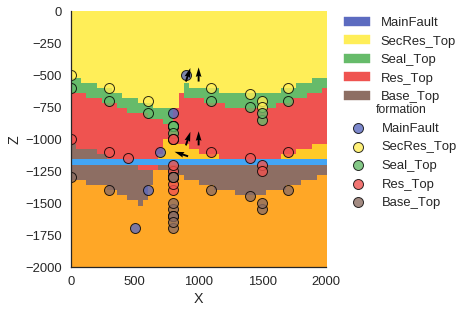

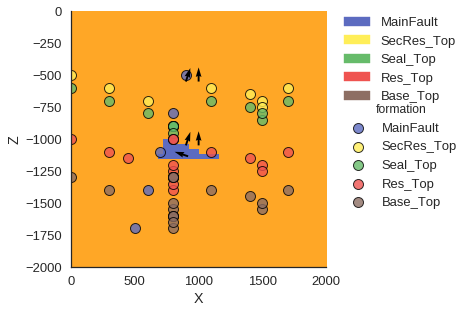

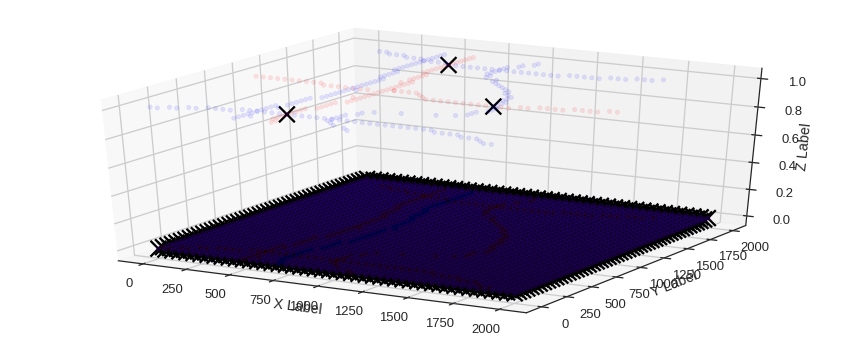

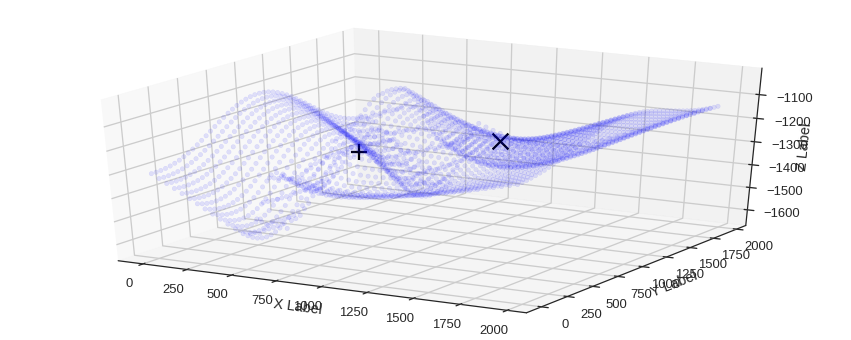

SPILL POINT: [ 1387.75512695   857.1428833  -1174.02037897]
Leak Point: [  571.42858887   938.7755127  -1303.6463208 ]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 21184000.0 m³
 [------           18%                  ] 18 of 100 complete in 238.6 secZ variations top to bottom: 2.57076289879 -3.60751193389 -15.6884073375 -24.1219583689
Fault offset variation: -19.4048467108
Z variations top to bottom: 2.57076289879 -3.60751193389 -15.6884073375 24.4328258976
Fault offset variation: -19.4048467108
Z variations top to bottom: -0.666353609022 -3.60751193389 -15.6884073375 24.4328258976
Fault offset variation: -19.4048467108
Z variations top to bottom: -0.666353609022 -3.60751193389 -27.5092844138 24.4328258976
Fault offset variation: -19.4048467108
Z variations top to bottom: -0.666353609022 1.47709092765 -27.5092844138 24.4328258976
Fault offset variation: -19.4048467108


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 7.360194051453384e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


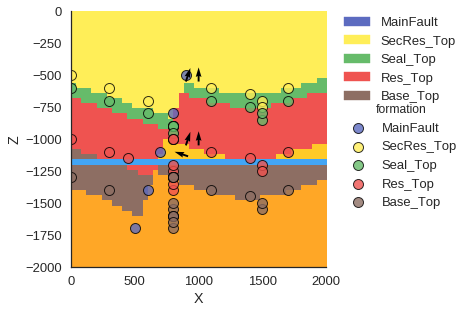

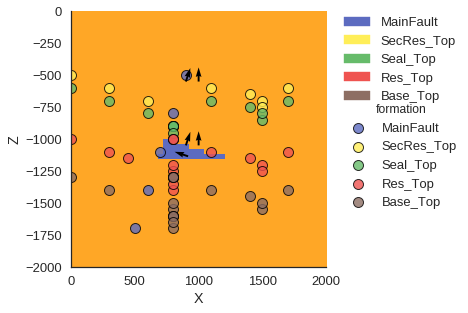

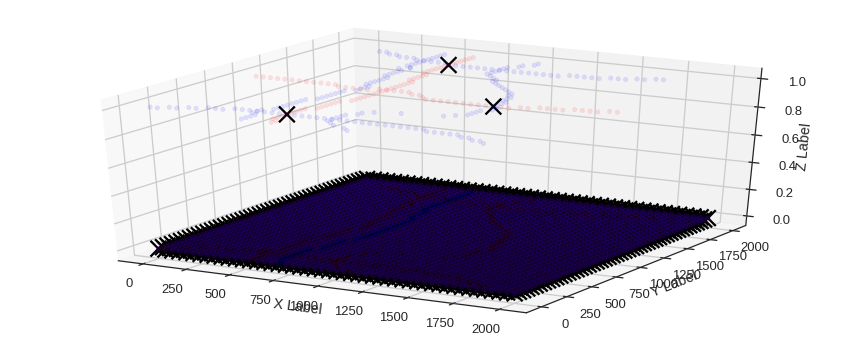

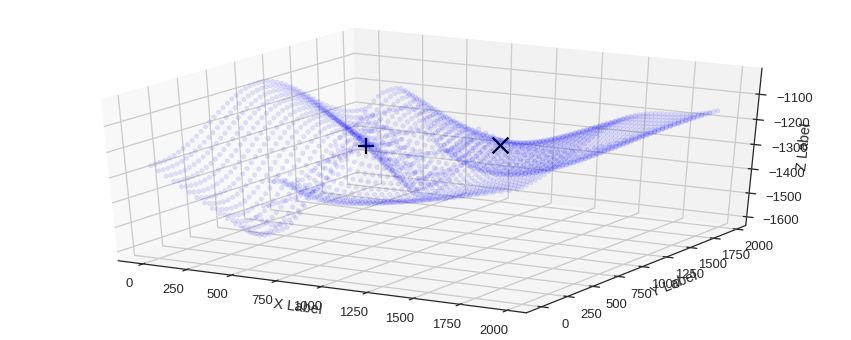

SPILL POINT: [ 1387.75512695   857.1428833  -1185.16714528]
Leak Point: [  612.24487305   938.7755127  -1264.40198662]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 17280000.0 m³
 [-------          19%                  ] 19 of 100 complete in 252.4 secZ variations top to bottom: -0.666353609022 -3.60751193389 -27.5092844138 24.4328258976
Fault offset variation: 50.1789834734
Z variations top to bottom: -0.666353609022 -3.60751193389 -27.5092844138 69.3783430164
Fault offset variation: 50.1789834734
Z variations top to bottom: 1.351315721 -3.60751193389 -27.5092844138 69.3783430164
Fault offset variation: 50.1789834734
Z variations top to bottom: 1.351315721 -3.60751193389 -35.5074508564 69.3783430164
Fault offset variation: 50.1789834734
Z variations top to bottom: 1.351315721 3.588284901 -27.5092844138 69.3783430164
Fault offset variation: 50.1789834734
Z variations top to bottom: 

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.369569054723136e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


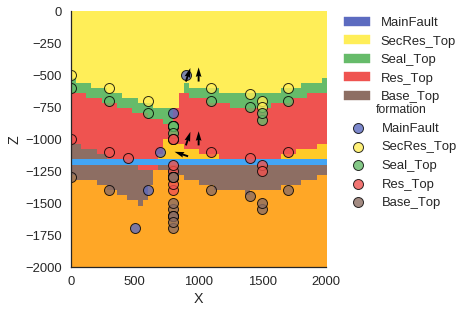

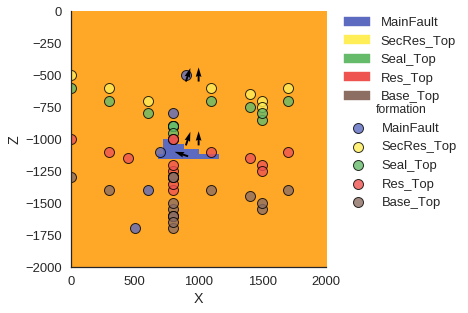

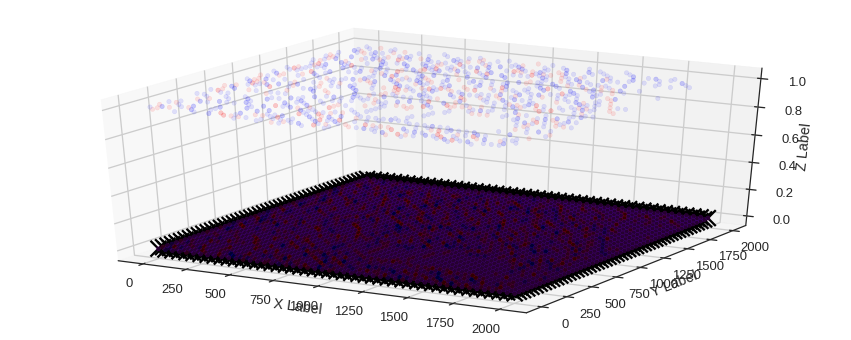

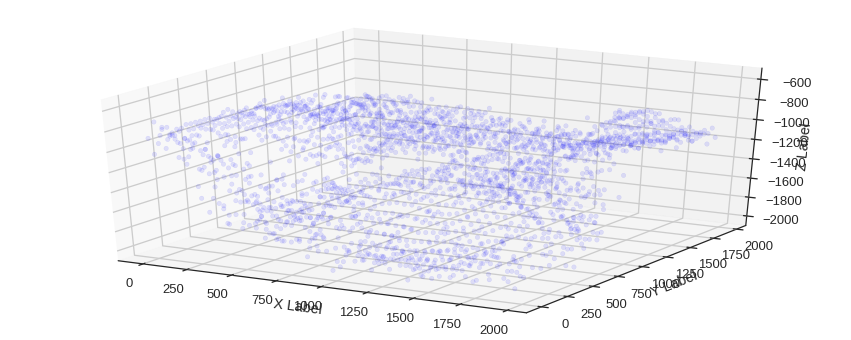

No SPILL POINT found!
Maximum reservoir volume: 0 m³
 [-------          20%                  ] 20 of 100 complete in 265.6 secZ variations top to bottom: 1.351315721 -3.60751193389 -27.5092844138 69.3783430164
Fault offset variation: 169.949154868
Z variations top to bottom: 1.351315721 -3.60751193389 -27.5092844138 21.6735592658
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.667936327276 -3.60751193389 -27.5092844138 21.6735592658
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.667936327276 -3.60751193389 -39.826843923 21.6735592658
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.667936327276 -4.99358506163 -39.826843923 21.6735592658
Fault offset variation: 50.1789834734


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.4785800542141976e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


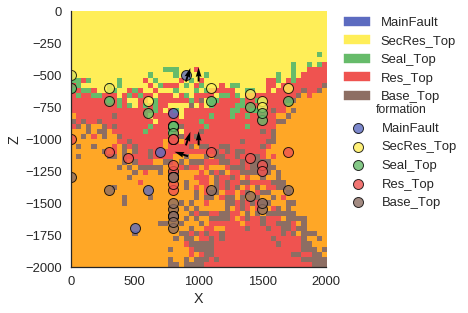

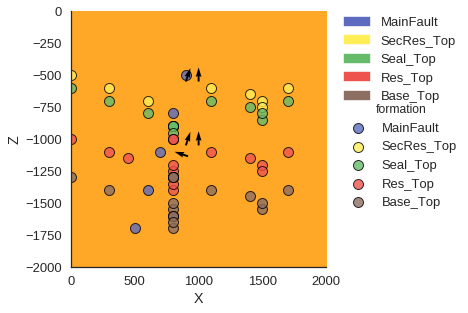

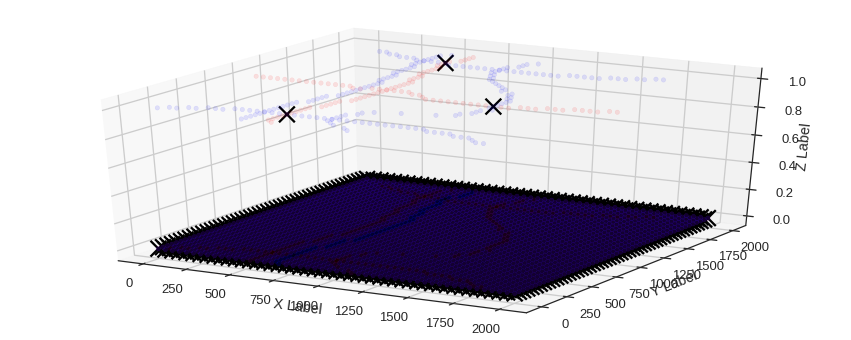

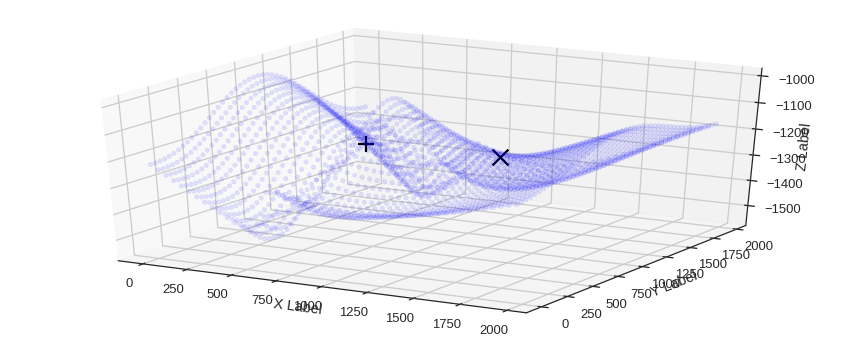

SPILL POINT: [ 1387.75512695   857.1428833  -1197.42938846]
Leak Point: [  612.24487305   938.7755127  -1215.8721181 ]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13952000.0 m³
 [-------          21%                  ] 21 of 100 complete in 279.4 secZ variations top to bottom: 0.667936327276 -4.99358506163 -39.826843923 21.6735592658
Fault offset variation: 68.3634557259
Z variations top to bottom: 0.667936327276 -4.99358506163 -39.826843923 23.0352142391
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.444932382796 -4.99358506163 -39.826843923 23.0352142391
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.444932382796 -4.99358506163 -39.5837959857 23.0352142391
Fault offset variation: 50.1789834734
Z variations top to bottom: 0.444932382796 -4.2466377684 -39.5837959857 23.0352142391
Fault offset variation: 50.1789834734


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.107851913846215e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


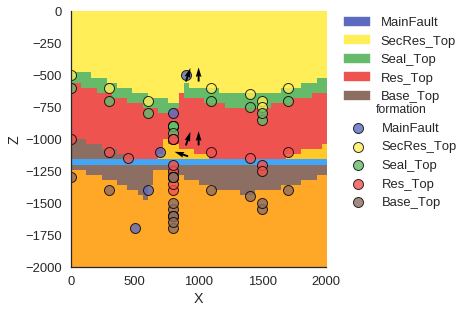

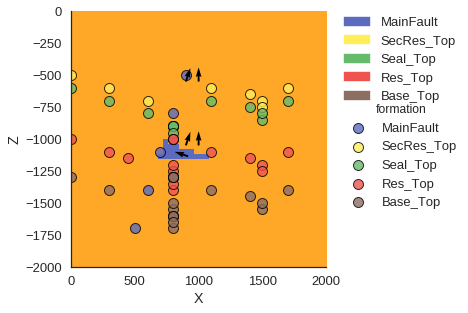

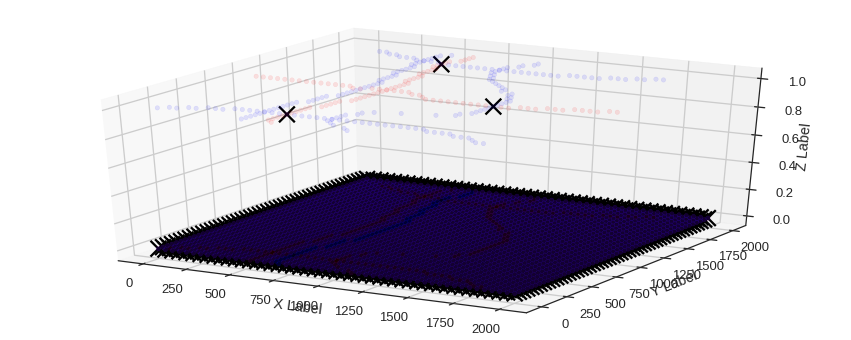

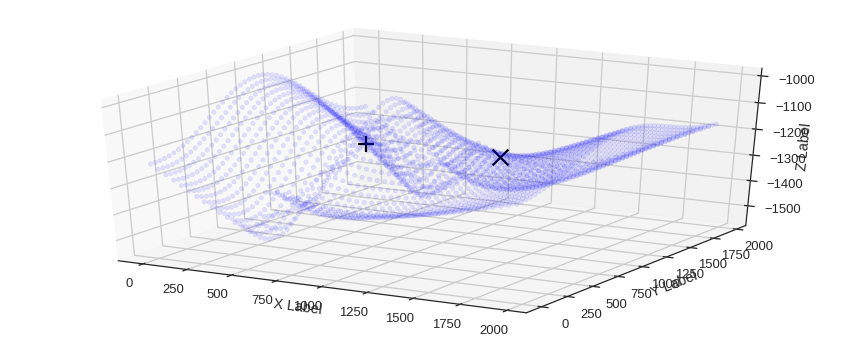

SPILL POINT: [ 1387.75512695   857.1428833  -1197.109927  ]
Leak Point: [  612.24487305   938.7755127  -1215.70360834]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14016000.0 m³
 [--------         22%                  ] 22 of 100 complete in 293.1 secZ variations top to bottom: 0.444932382796 -4.2466377684 -39.5837959857 23.0352142391
Fault offset variation: 99.8642246028
Z variations top to bottom: 0.444932382796 -4.2466377684 -39.5837959857 47.3024932871
Fault offset variation: 99.8642246028
Z variations top to bottom: 2.95221938063 -4.2466377684 -39.5837959857 23.0352142391
Fault offset variation: 99.8642246028
Z variations top to bottom: 2.95221938063 -4.2466377684 -55.9271175024 23.0352142391
Fault offset variation: 99.8642246028
Z variations top to bottom: 2.95221938063 2.12808522263 -39.5837959857 23.0352142391
Fault offset variation: 99.8642246028
Z variations top to bottom

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.6883556065191456e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


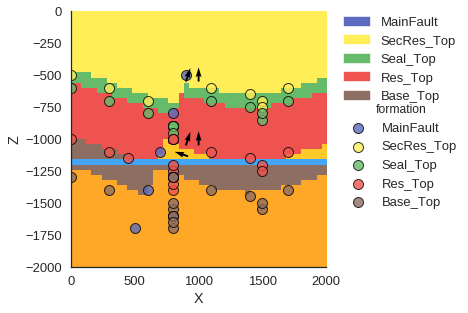

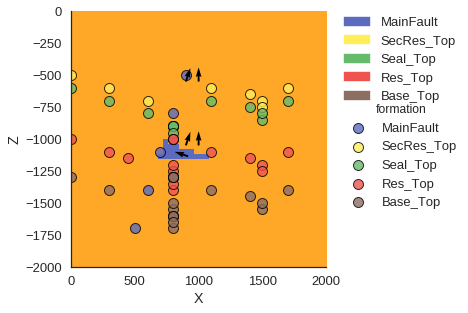

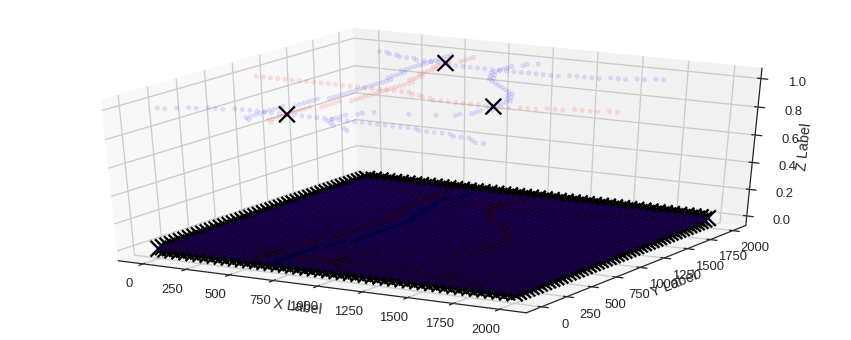

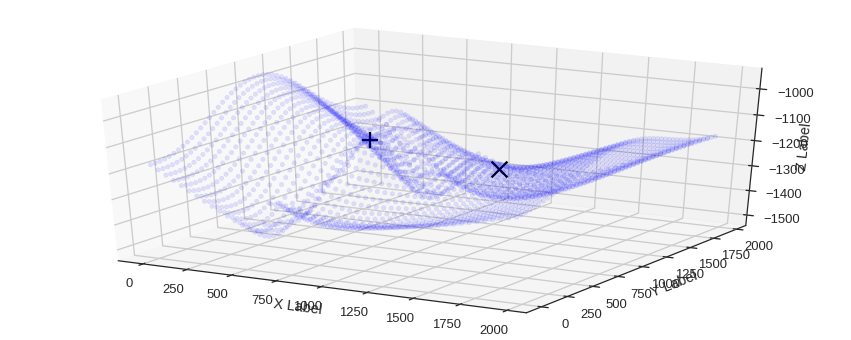

SPILL POINT: [ 1387.75512695   857.1428833  -1197.25970292]
Leak Point: [  612.24487305   979.59185791 -1162.06777506]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 13952000.0 m³
 [--------         23%                  ] 23 of 100 complete in 308.1 secZ variations top to bottom: 2.95221938063 -4.2466377684 -39.5837959857 23.0352142391
Fault offset variation: 70.994100937
Z variations top to bottom: 2.95221938063 -4.2466377684 -39.5837959857 38.4946235205
Fault offset variation: 70.994100937
Z variations top to bottom: 2.07884964034 -4.2466377684 -39.5837959857 23.0352142391
Fault offset variation: 70.994100937
Z variations top to bottom: 2.07884964034 -4.2466377684 -44.6102840039 23.0352142391
Fault offset variation: 70.994100937
Z variations top to bottom: 2.07884964034 -6.43829925853 -44.6102840039 23.0352142391
Fault offset variation: 70.994100937


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.439920306409384e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


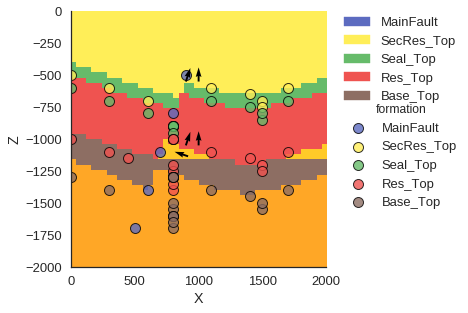

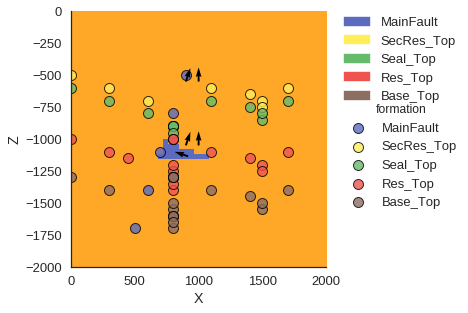

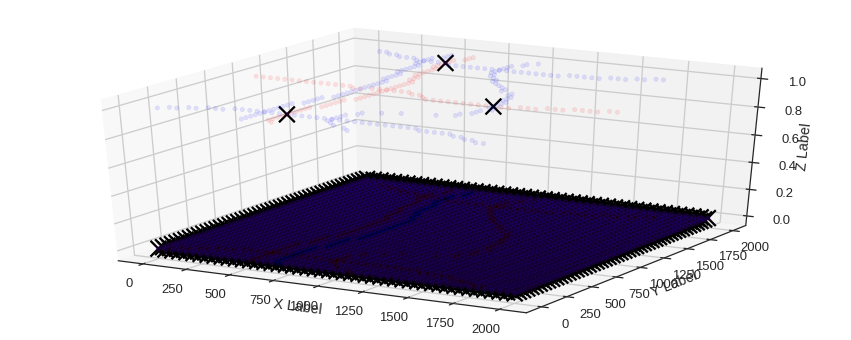

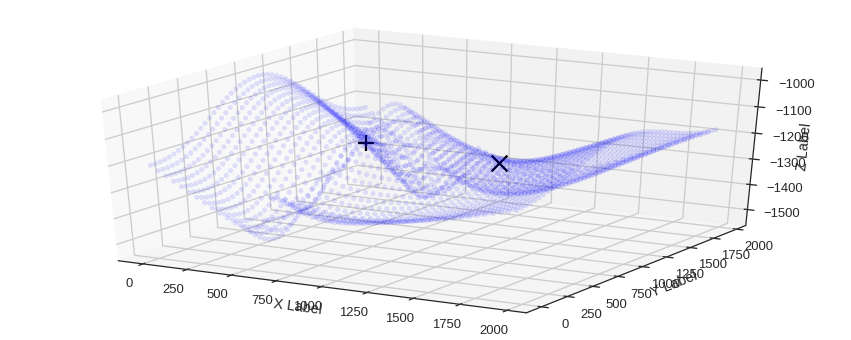

SPILL POINT: [ 1387.75512695   857.1428833  -1202.02150077]
Leak Point: [  612.24487305   938.7755127  -1198.30301891]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 12736000.0 m³
 [---------        24%                  ] 24 of 100 complete in 321.7 secZ variations top to bottom: 2.07884964034 -6.43829925853 -44.6102840039 23.0352142391
Fault offset variation: 41.8250188986
Z variations top to bottom: 2.07884964034 -6.43829925853 -44.6102840039 -4.41214950986
Fault offset variation: 41.8250188986
Z variations top to bottom: 1.6051713684 -6.43829925853 -44.6102840039 -4.41214950986
Fault offset variation: 41.8250188986
Z variations top to bottom: 1.6051713684 -6.43829925853 -32.4542396853 -4.41214950986
Fault offset variation: 41.8250188986
Z variations top to bottom: 1.6051713684 -3.98947023773 -32.4542396853 -4.41214950986
Fault offset variation: 41.8250188986


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0407899368736206e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


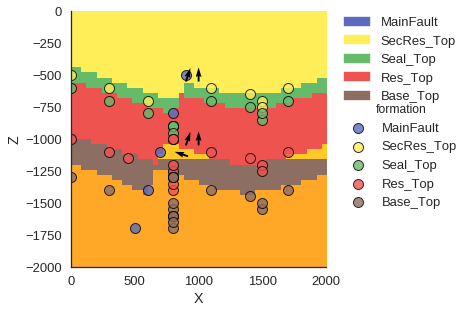

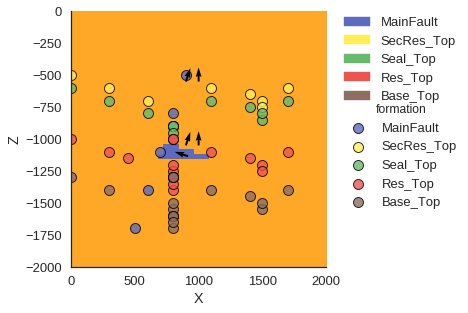

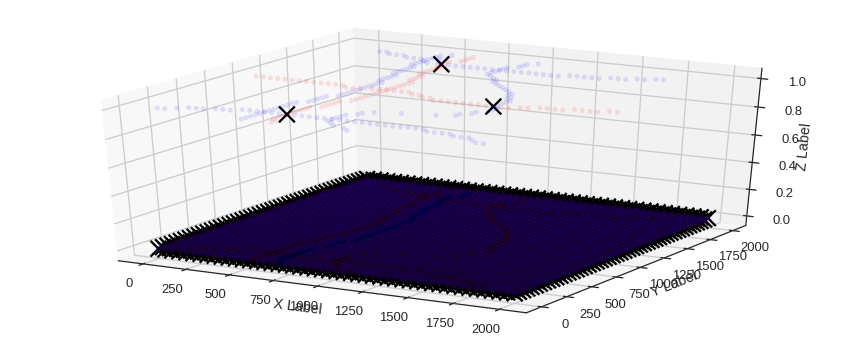

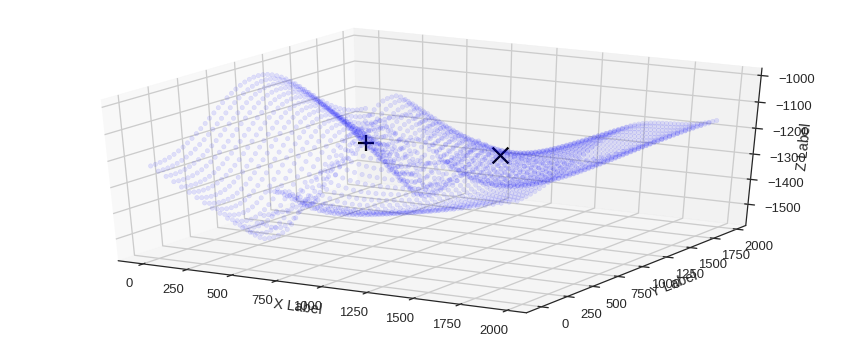

SPILL POINT: [ 1387.75512695   857.1428833  -1190.07916608]
Leak Point: [  612.24487305   938.7755127  -1216.98656398]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 16128000.0 m³
 [---------        25%                  ] 25 of 100 complete in 335.5 secZ variations top to bottom: 1.6051713684 -3.98947023773 -32.4542396853 -4.41214950986
Fault offset variation: 48.9809468505
Z variations top to bottom: 1.6051713684 -3.98947023773 -32.4542396853 -5.32712966745
Fault offset variation: 48.9809468505
Z variations top to bottom: -1.05037112713 -3.98947023773 -32.4542396853 -5.32712966745
Fault offset variation: 48.9809468505
Z variations top to bottom: 1.6051713684 -3.98947023773 -26.6238712435 -5.32712966745
Fault offset variation: 48.9809468505
Z variations top to bottom: 1.6051713684 -3.19410502413 -26.6238712435 -5.32712966745
Fault offset variation: 48.9809468505


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.4691342680470694e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


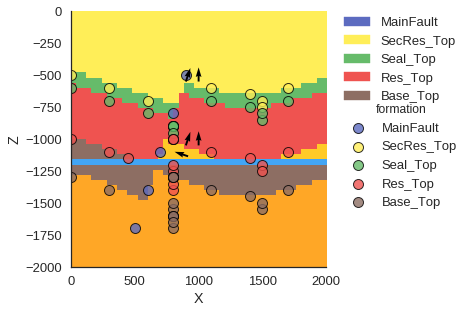

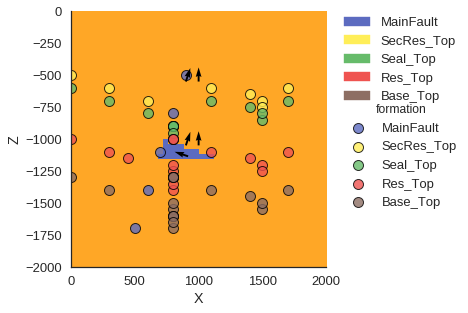

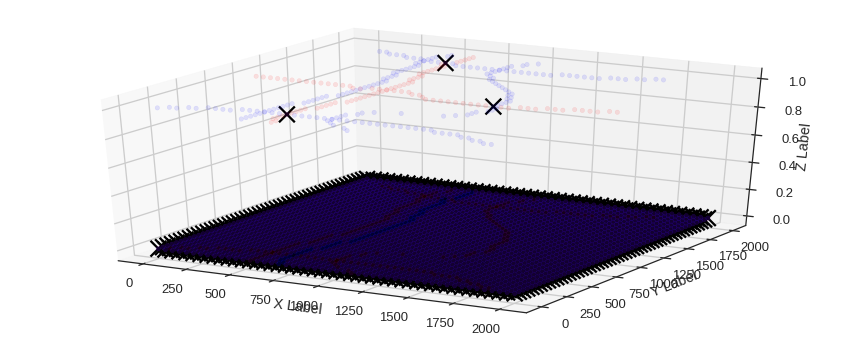

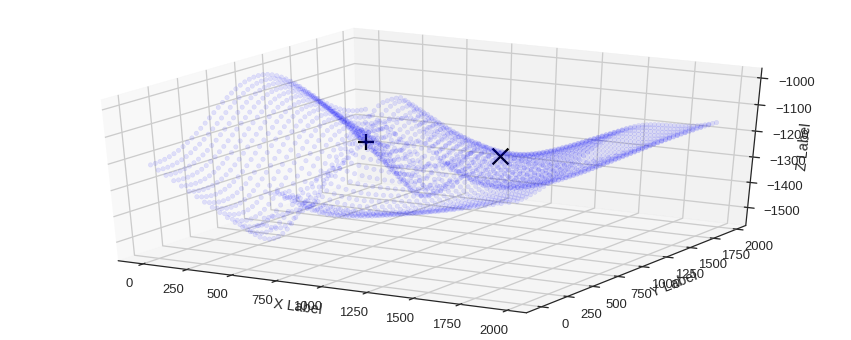

SPILL POINT: [ 1387.75512695   857.1428833  -1184.53130244]
Leak Point: [  612.24487305   938.7755127  -1201.04473174]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 17600000.0 m³
 [---------        26%                  ] 26 of 100 complete in 350.0 secZ variations top to bottom: 1.6051713684 -3.19410502413 -26.6238712435 -5.32712966745
Fault offset variation: 158.446896507
Z variations top to bottom: 1.6051713684 -3.19410502413 -26.6238712435 0.998739702761
Fault offset variation: 48.9809468505
Z variations top to bottom: 0.380005825636 -3.19410502413 -26.6238712435 0.998739702761
Fault offset variation: 48.9809468505
Z variations top to bottom: 1.6051713684 -3.19410502413 -22.3014449668 0.998739702761
Fault offset variation: 48.9809468505
Z variations top to bottom: 1.6051713684 -2.05101508369 -22.3014449668 0.998739702761
Fault offset variation: 48.9809468505


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.6233570043766576e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


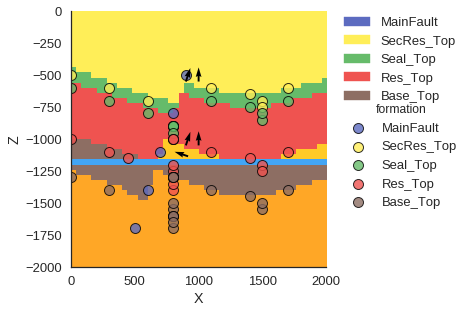

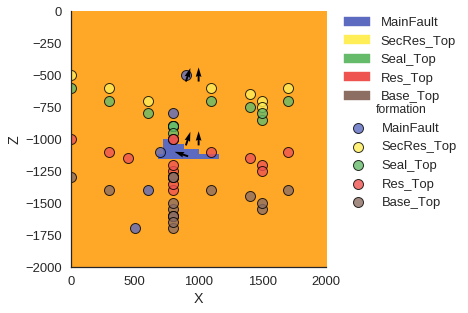

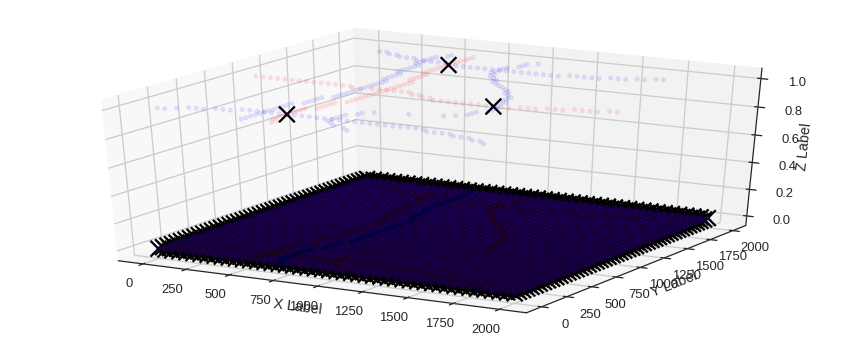

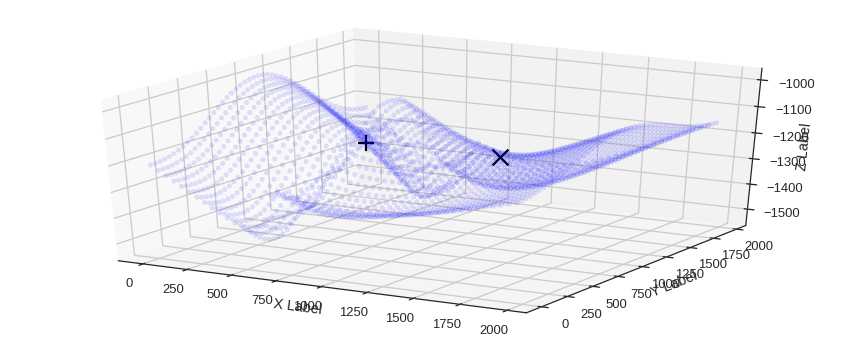

SPILL POINT: [ 1387.75512695   857.1428833  -1180.23767684]
Leak Point: [  612.24487305   938.7755127  -1197.51274068]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 18880000.0 m³
 [----------       27%                  ] 27 of 100 complete in 363.8 secZ variations top to bottom: 1.6051713684 -2.05101508369 -22.3014449668 0.998739702761
Fault offset variation: 41.5495825791
Z variations top to bottom: 1.6051713684 -2.05101508369 -22.3014449668 0.965178144566
Fault offset variation: 41.5495825791
Z variations top to bottom: 2.01022497775 -2.05101508369 -22.3014449668 0.965178144566
Fault offset variation: 41.5495825791
Z variations top to bottom: 2.01022497775 -2.05101508369 -19.4257653313 0.965178144566
Fault offset variation: 41.5495825791
Z variations top to bottom: 2.01022497775 -6.8503333316 -19.4257653313 0.965178144566
Fault offset variation: 41.5495825791


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.7616210072168674e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


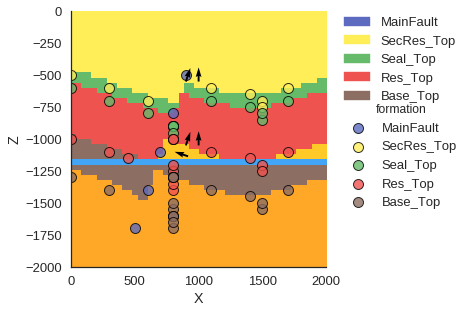

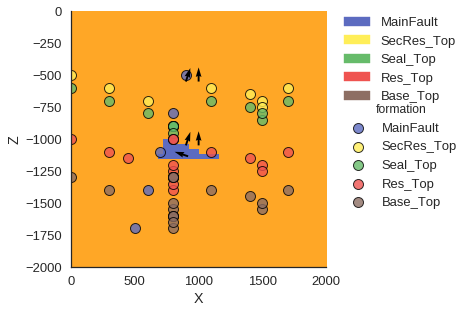

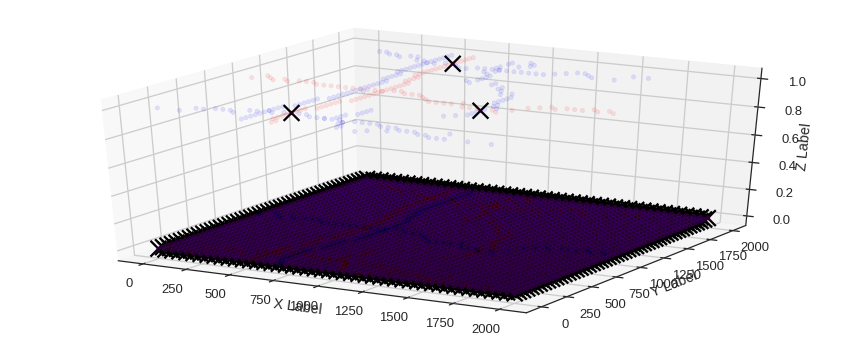

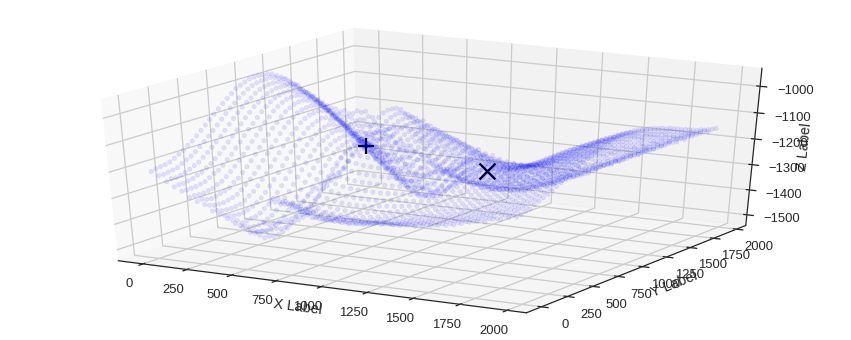

SPILL POINT: [ 1387.75512695   734.69384766 -1194.81792776]
Leak Point: [  612.24487305   938.7755127  -1188.3733075 ]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 11
TRAP FOUND, section: 11
Checking Section: 14
Maximum reservoir volume: 16704000.0 m³
 [----------       28%                  ] 28 of 100 complete in 377.5 secZ variations top to bottom: 2.01022497775 -6.8503333316 -19.4257653313 0.965178144566
Fault offset variation: 19.2966558085
Z variations top to bottom: 2.01022497775 -6.8503333316 -19.4257653313 28.564950465
Fault offset variation: 19.2966558085
Z variations top to bottom: 2.38419798613 -6.8503333316 -19.4257653313 28.564950465
Fault offset variation: 19.2966558085
Z variations top to bottom: 2.38419798613 -6.8503333316 -28.9529383161 28.564950465
Fault offset variation: 19.2966558085
Z variations top to bottom: 2.38419798613 -6.78847279745 -28.9529383161 28.564950465
Fault offset variation: 19.2966558085


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.1777753171924328e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


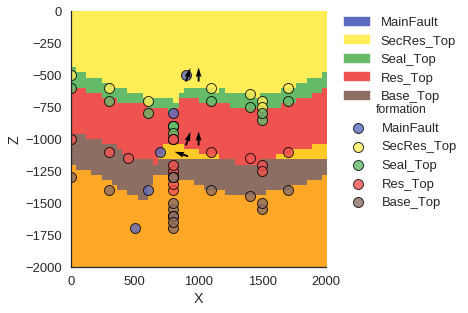

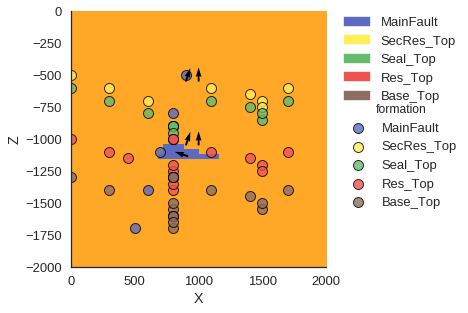

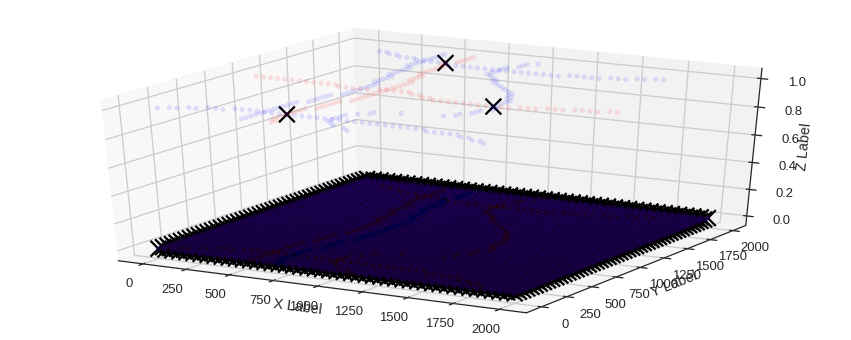

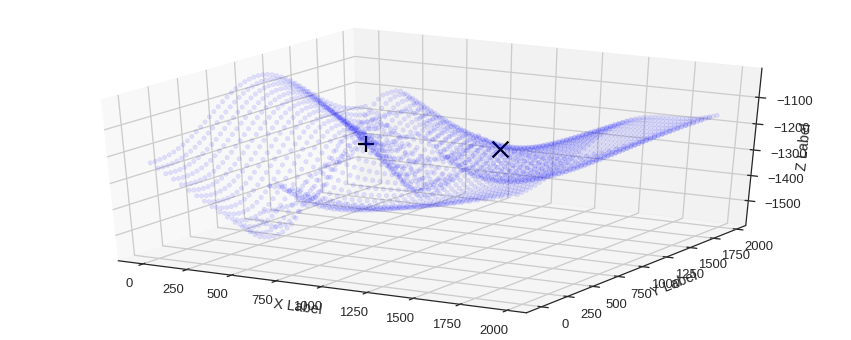

SPILL POINT: [ 1387.75512695   857.1428833  -1187.14519357]
Leak Point: [  612.24487305   938.7755127  -1237.7828963 ]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 16832000.0 m³
 [-----------      29%                  ] 29 of 100 complete in 391.3 secZ variations top to bottom: 2.38419798613 -6.78847279745 -28.9529383161 28.564950465
Fault offset variation: -85.0471537275
Z variations top to bottom: 2.38419798613 -6.78847279745 -28.9529383161 19.4802156495
Fault offset variation: 19.2966558085
Z variations top to bottom: 1.62908855181 -6.78847279745 -28.9529383161 19.4802156495
Fault offset variation: 19.2966558085
Z variations top to bottom: 1.62908855181 -6.78847279745 -40.8990910374 19.4802156495
Fault offset variation: 19.2966558085
Z variations top to bottom: 1.62908855181 -10.2344947283 -28.9529383161 19.4802156495
Fault offset variation: 19.2966558085


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.997951263604252e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


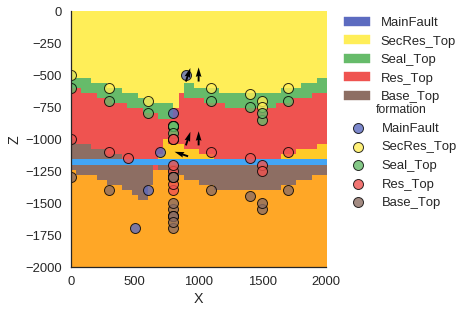

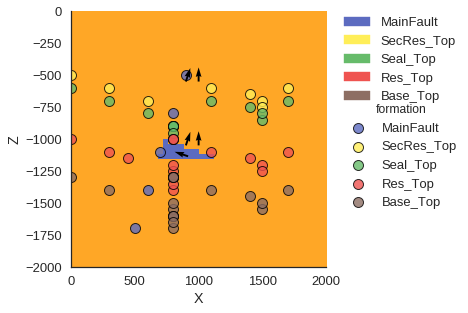

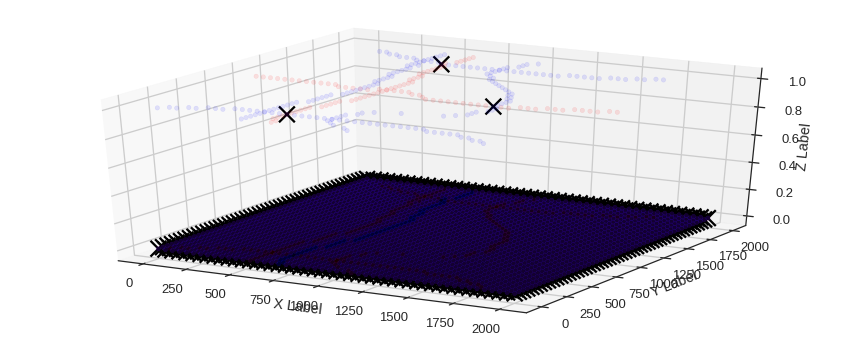

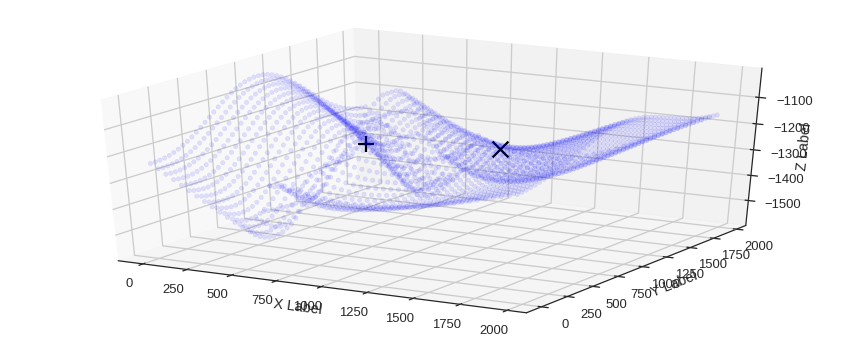

SPILL POINT: [ 1387.75512695   857.1428833  -1187.17232622]
Leak Point: [  612.24487305   938.7755127  -1237.43568158]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 16832000.0 m³
 [-----------      30%                  ] 30 of 100 complete in 405.2 secZ variations top to bottom: 1.62908855181 -10.2344947283 -28.9529383161 19.4802156495
Fault offset variation: 106.499331526
Z variations top to bottom: 1.62908855181 -10.2344947283 -28.9529383161 28.6856514203
Fault offset variation: 19.2966558085
Z variations top to bottom: -0.641944781292 -10.2344947283 -28.9529383161 28.6856514203
Fault offset variation: 19.2966558085
Z variations top to bottom: -0.641944781292 -10.2344947283 -15.2744232064 28.6856514203
Fault offset variation: 19.2966558085
Z variations top to bottom: -0.641944781292 -5.52948237237 -15.2744232064 28.6856514203
Fault offset variation: 19.2966558085


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.7426669876179366e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


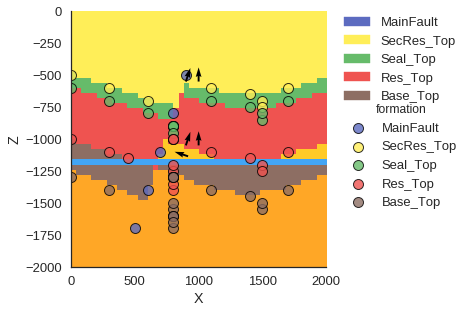

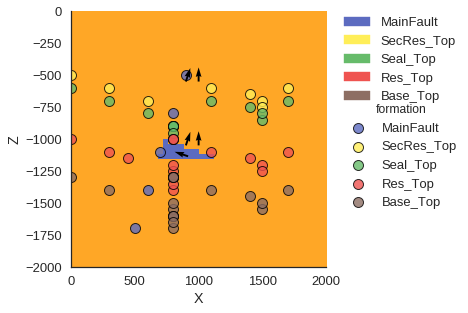

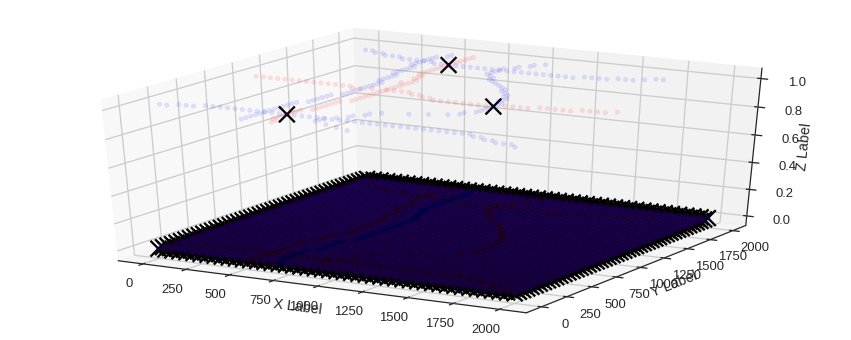

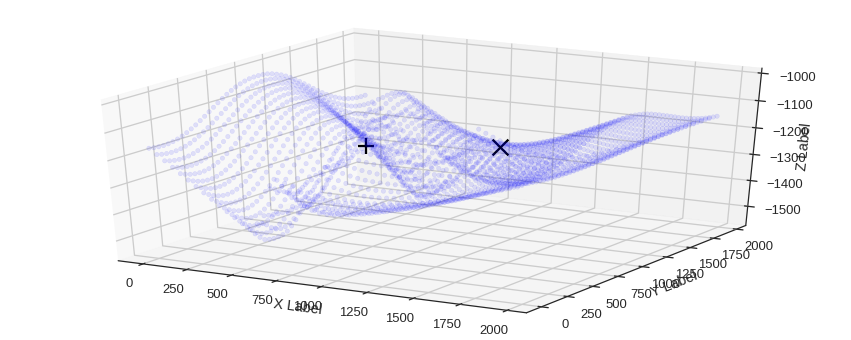

SPILL POINT: [ 1387.75512695   857.1428833  -1164.01771039]
Leak Point: [  612.24487305   938.7755127  -1229.47186617]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 20736000.0 m³
 [-----------      31%                  ] 31 of 100 complete in 419.1 secZ variations top to bottom: -0.641944781292 -10.2344947283 -15.2744232064 28.6856514203
Fault offset variation: -40.3680102366
Z variations top to bottom: -0.641944781292 -10.2344947283 -15.2744232064 -12.9915330482
Fault offset variation: -40.3680102366
Z variations top to bottom: 2.96146837298 -10.2344947283 -15.2744232064 28.6856514203
Fault offset variation: -40.3680102366
Z variations top to bottom: 2.96146837298 -10.2344947283 -1.6425329481 28.6856514203
Fault offset variation: -40.3680102366
Z variations top to bottom: 2.96146837298 -12.2514430096 -1.6425329481 28.6856514203
Fault offset variation: -40.3680102366


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 8.482914891361215e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


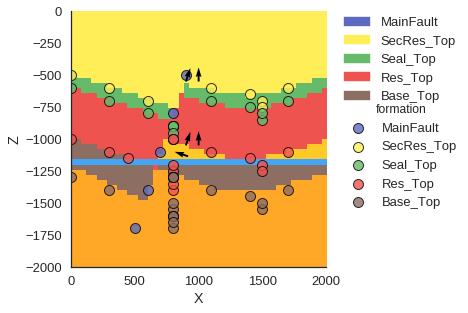

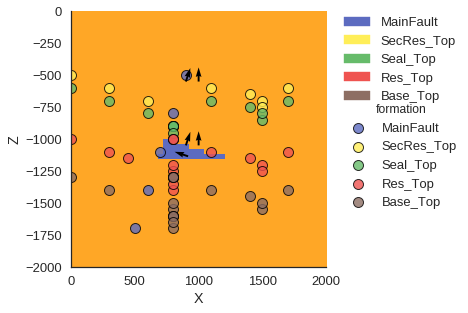

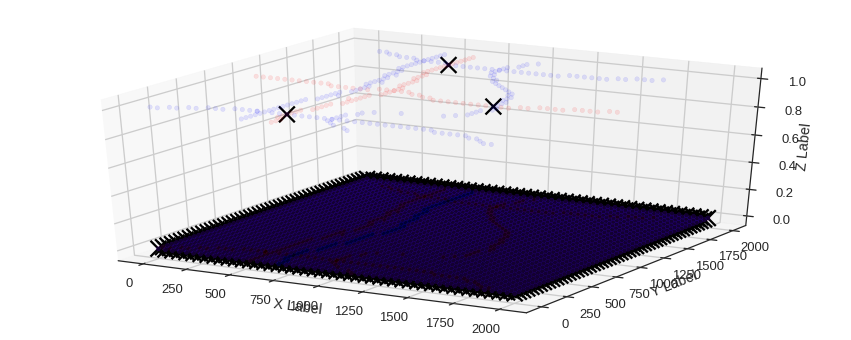

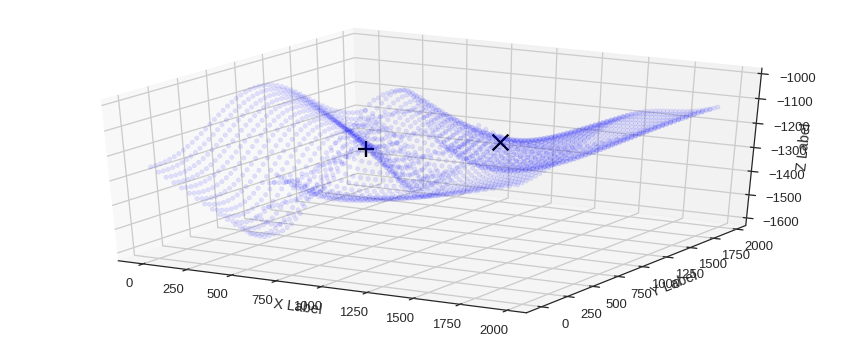

SPILL POINT: [ 1387.75512695   857.1428833  -1160.23285275]
Leak Point: [  612.24487305   938.7755127  -1261.13824459]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 11968000.0 m³
 [------------     32%                  ] 32 of 100 complete in 433.8 secZ variations top to bottom: 2.96146837298 -12.2514430096 -1.6425329481 28.6856514203
Fault offset variation: -47.7601446416
Z variations top to bottom: 2.96146837298 -12.2514430096 -1.6425329481 57.0993881183
Fault offset variation: -47.7601446416
Z variations top to bottom: 2.45839918465 -12.2514430096 -1.6425329481 57.0993881183
Fault offset variation: -47.7601446416
Z variations top to bottom: 2.45839918465 -12.2514430096 -2.77848079161 57.0993881183
Fault offset variation: -47.7601446416
Z variations top to bottom: 2.45839918465 -11.5656766471 -2.77848079161 57.0993881183
Fault offset variation: -47.7601446416


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.2845449450535913e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


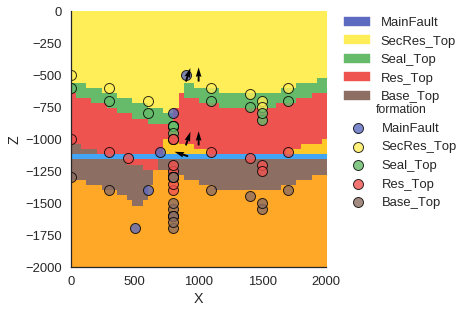

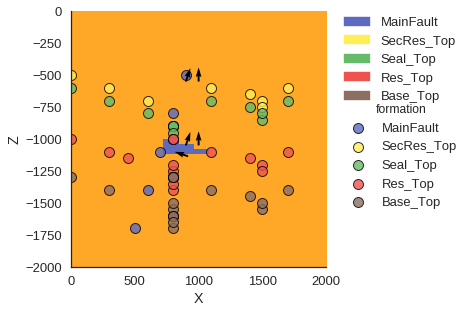

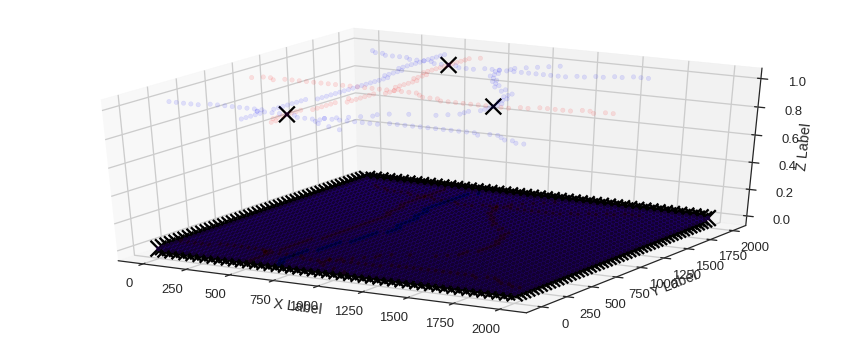

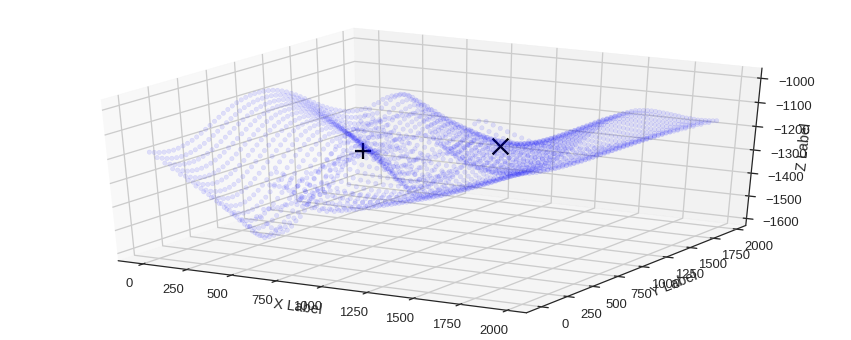

SPILL POINT: [ 1387.75512695   857.1428833  -1161.34226518]
Leak Point: [  571.42858887   979.59185791 -1271.20654483]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 22
Checking Section: 19
TRAP FOUND, section: 19
Maximum reservoir volume: 11648000.0 m³
 [------------     33%                  ] 33 of 100 complete in 447.7 secZ variations top to bottom: 2.45839918465 -11.5656766471 -2.77848079161 57.0993881183
Fault offset variation: 43.8163854751
Z variations top to bottom: 2.45839918465 -11.5656766471 -2.77848079161 55.2688146516
Fault offset variation: 43.8163854751
Z variations top to bottom: 2.30584540886 -11.5656766471 -2.77848079161 55.2688146516
Fault offset variation: 43.8163854751
Z variations top to bottom: 2.30584540886 -11.5656766471 -13.7433187663 55.2688146516
Fault offset variation: 43.8163854751
Z variations top to bottom: 2.30584540886 -7.96032917941 -13.7433187663 55.2688146516
Fault offset variation: 43.8163854751


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.996281112727561e-16
  ' condition number: {}'.format(rcond), RuntimeWarning)


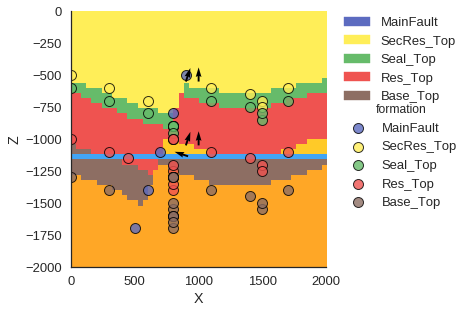

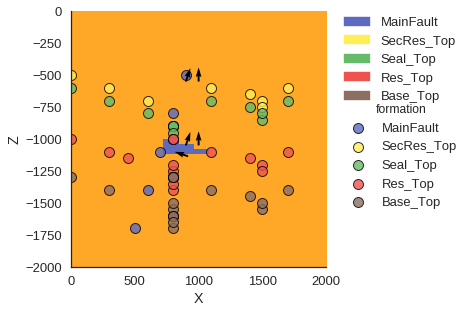

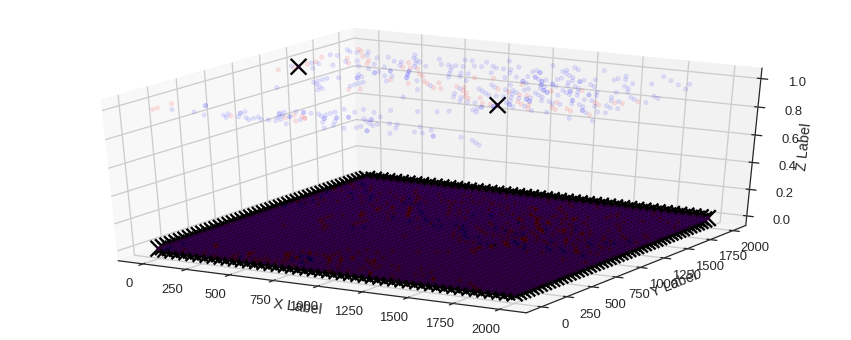

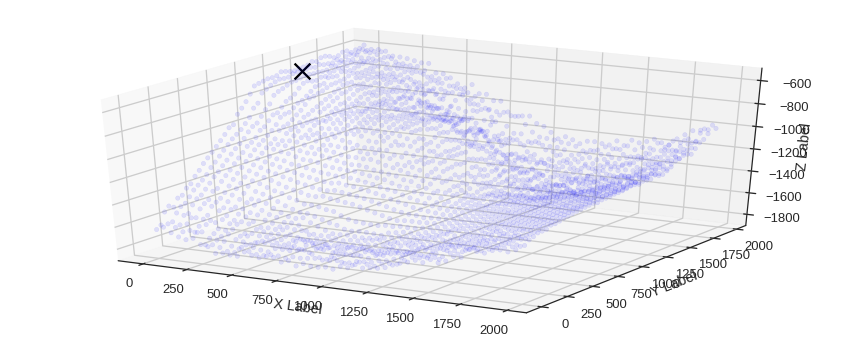

SPILL POINT: [   40.81632614  1306.12243652  -630.27407565]
No LEAK POINT found! So FULL LEAKAGE assumed!
Fault leak point above spill point.
...but fault sealing. Down to spill.
No res_formation above max_z!
Maximum reservoir volume: 0 m³
 [------------     34%                  ] 34 of 100 complete in 460.6 secZ variations top to bottom: 2.30584540886 -7.96032917941 -13.7433187663 55.2688146516
Fault offset variation: 10.3176001369
Z variations top to bottom: 2.30584540886 -7.96032917941 -13.7433187663 45.3411421809
Fault offset variation: 10.3176001369
Z variations top to bottom: 3.16362653742 -7.96032917941 -13.7433187663 45.3411421809
Fault offset variation: 10.3176001369
Z variations top to bottom: 3.16362653742 -7.96032917941 -6.55155193877 45.3411421809
Fault offset variation: 10.3176001369
Z variations top to bottom: 3.16362653742 -7.17695824043 -6.55155193877 45.3411421809
Fault offset variation: 10.3176001369


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 8.415085468727046e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


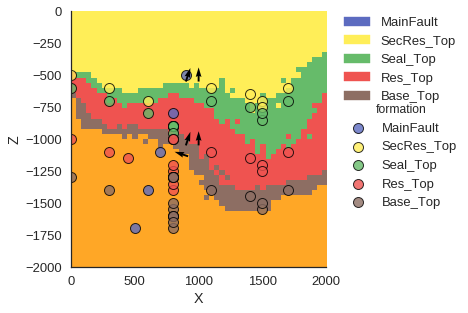

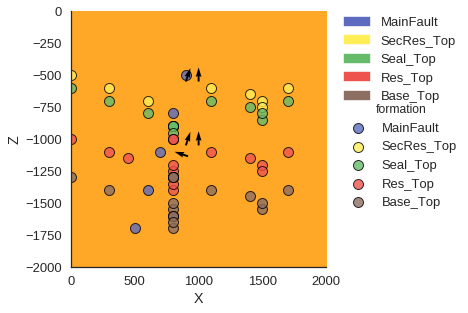

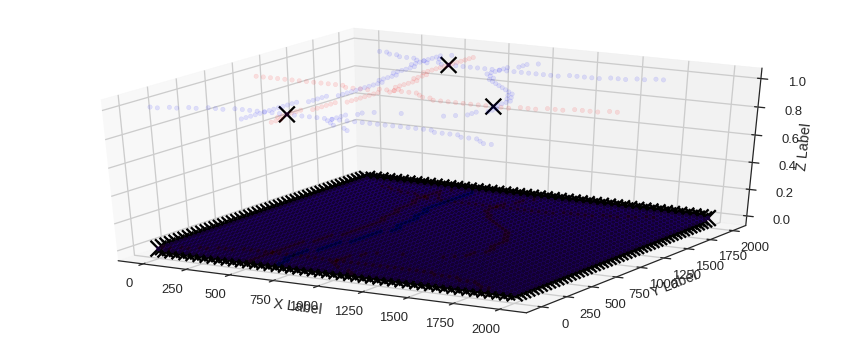

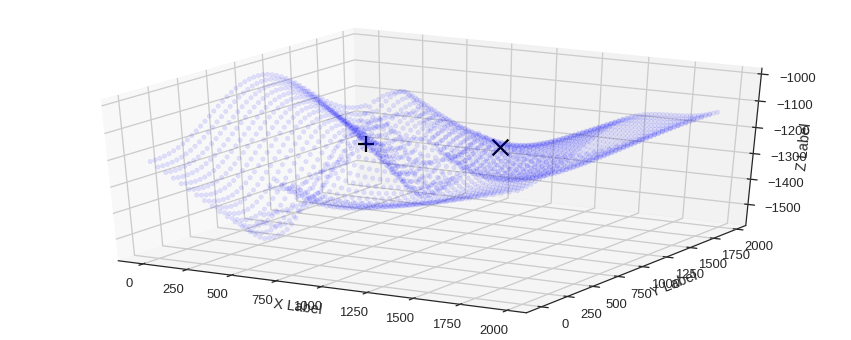

SPILL POINT: [ 1387.75512695   857.1428833  -1165.08633143]
Leak Point: [  612.24487305   938.7755127  -1224.70590077]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 24384000.0 m³
 [-------------    35%                  ] 35 of 100 complete in 474.2 secZ variations top to bottom: 3.16362653742 -7.17695824043 -6.55155193877 45.3411421809
Fault offset variation: -50.550267437
Z variations top to bottom: 3.16362653742 -7.17695824043 -6.55155193877 14.2435328944
Fault offset variation: -50.550267437
Z variations top to bottom: 2.70009757383 -7.17695824043 -6.55155193877 14.2435328944
Fault offset variation: -50.550267437
Z variations top to bottom: 2.70009757383 -7.17695824043 -6.95143867278 14.2435328944
Fault offset variation: -50.550267437
Z variations top to bottom: 2.70009757383 -4.12178467171 -6.95143867278 14.2435328944
Fault offset variation: -50.550267437


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.759384730600557e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


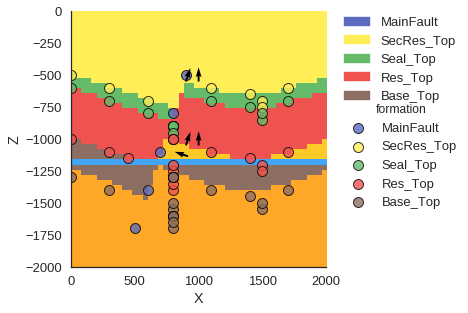

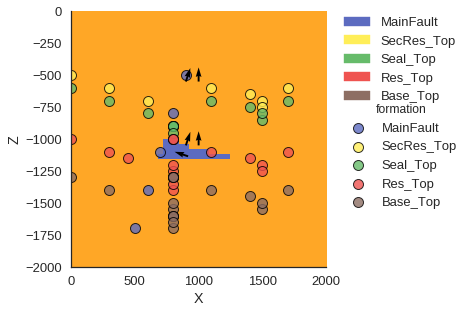

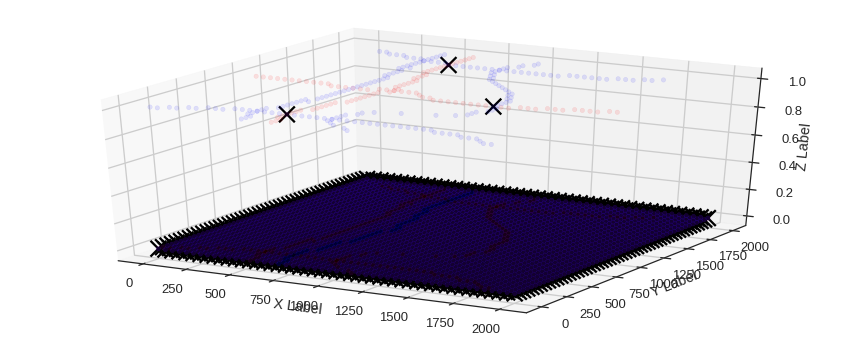

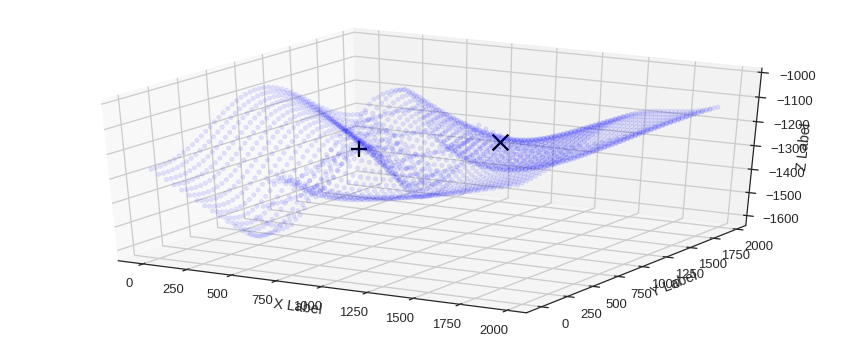

SPILL POINT: [ 1387.75512695   857.1428833  -1165.31343999]
Leak Point: [  571.42858887   938.7755127  -1272.78393593]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 24384000.0 m³
 [-------------    36%                  ] 36 of 100 complete in 487.9 secZ variations top to bottom: 2.70009757383 -7.17695824043 -6.95143867278 14.2435328944
Fault offset variation: -56.5444842735
Z variations top to bottom: 2.70009757383 -7.17695824043 -6.95143867278 31.0863001613
Fault offset variation: -56.5444842735
Z variations top to bottom: 4.59656569476 -7.17695824043 -6.95143867278 31.0863001613
Fault offset variation: -56.5444842735
Z variations top to bottom: 4.59656569476 -7.17695824043 -16.31847859 31.0863001613
Fault offset variation: -56.5444842735
Z variations top to bottom: 4.59656569476 -10.8071847135 -16.31847859 31.0863001613
Fault offset variation: -56.5444842735


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.594447391981227e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


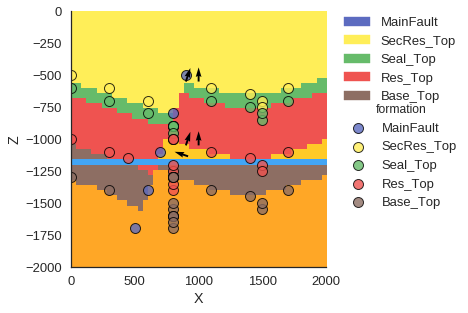

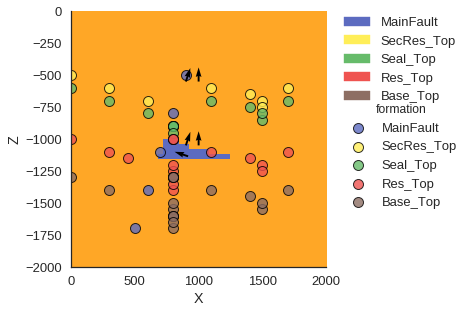

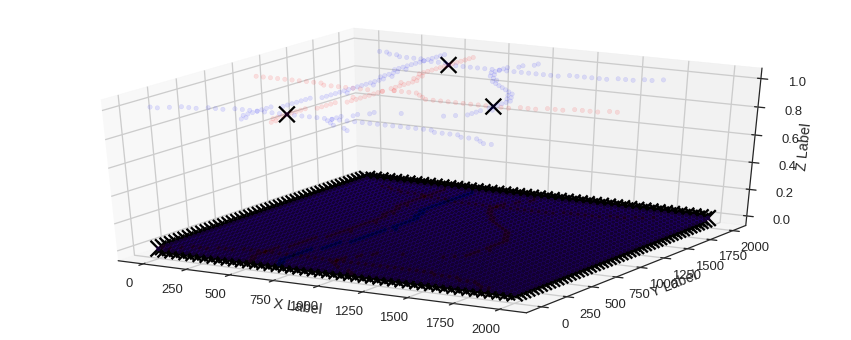

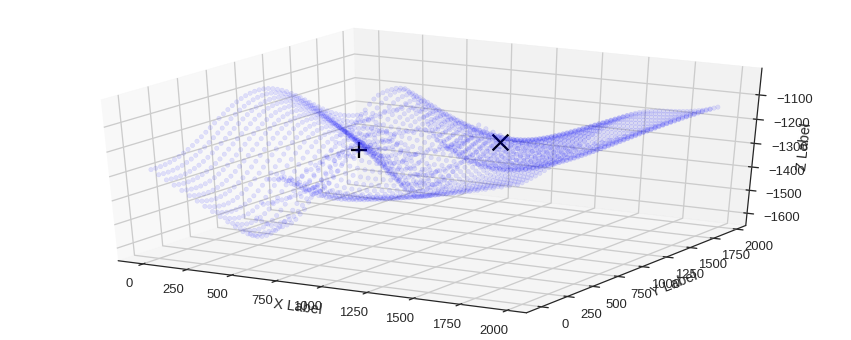

SPILL POINT: [ 1387.75512695   857.1428833  -1174.49945357]
Leak Point: [  571.42858887   938.7755127  -1289.11507369]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 20992000.0 m³
 [--------------   37%                  ] 37 of 100 complete in 501.9 secZ variations top to bottom: 4.59656569476 -10.8071847135 -16.31847859 31.0863001613
Fault offset variation: -20.6176162727
Z variations top to bottom: 4.59656569476 -10.8071847135 -16.31847859 14.1851836198
Fault offset variation: -20.6176162727
Z variations top to bottom: 5.89264516995 -10.8071847135 -16.31847859 14.1851836198
Fault offset variation: -20.6176162727
Z variations top to bottom: 5.89264516995 -10.8071847135 -12.7754233864 14.1851836198
Fault offset variation: -20.6176162727
Z variations top to bottom: 5.89264516995 -9.03498704936 -12.7754233864 14.1851836198
Fault offset variation: -20.6176162727


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.2971844912400563e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


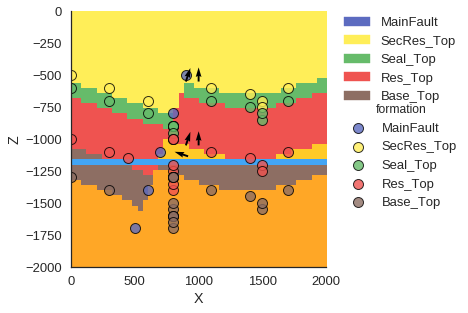

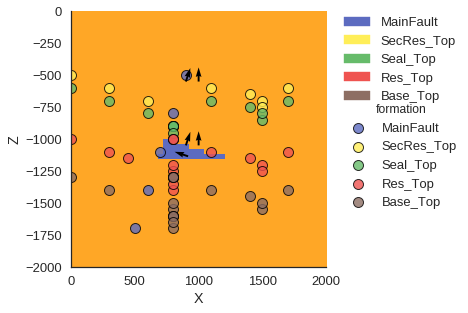

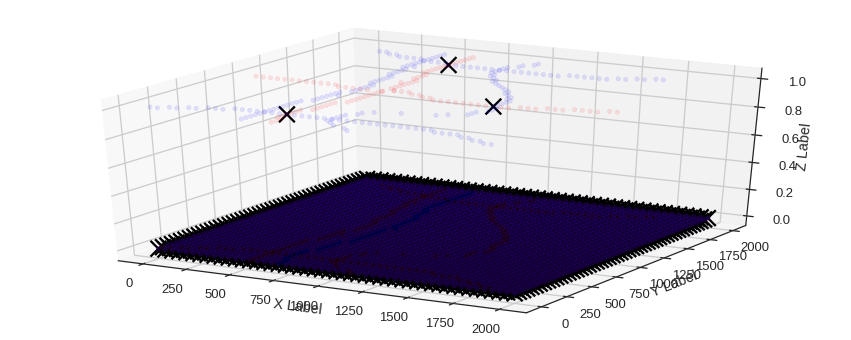

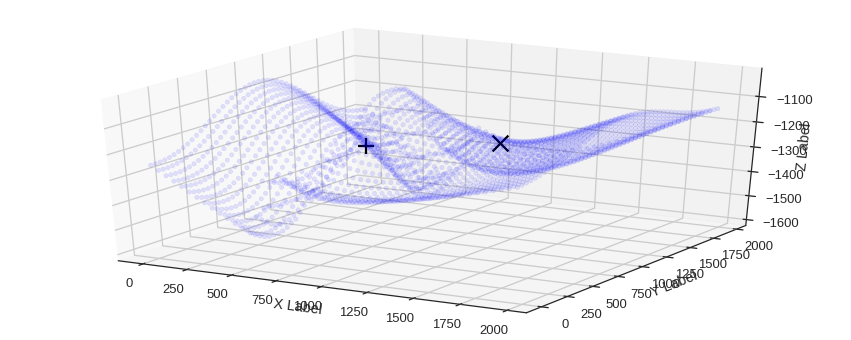

SPILL POINT: [ 1387.75512695   857.1428833  -1171.12182711]
Leak Point: [  612.24487305   938.7755127  -1254.39004508]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 21824000.0 m³
 [--------------   38%                  ] 38 of 100 complete in 515.8 secZ variations top to bottom: 5.89264516995 -9.03498704936 -12.7754233864 14.1851836198
Fault offset variation: 149.16487383
Z variations top to bottom: 5.89264516995 -9.03498704936 -12.7754233864 -4.00098007621
Fault offset variation: 149.16487383
Z variations top to bottom: 7.65326779353 -9.03498704936 -12.7754233864 -4.00098007621
Fault offset variation: 149.16487383
Z variations top to bottom: 7.65326779353 -9.03498704936 2.19117222093 -4.00098007621
Fault offset variation: 149.16487383
Z variations top to bottom: 7.65326779353 -6.84654642106 2.19117222093 -4.00098007621
Fault offset variation: 149.16487383


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.125846807615739e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


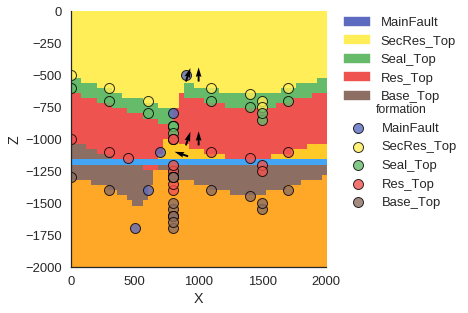

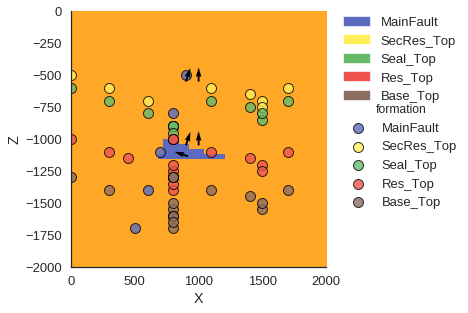

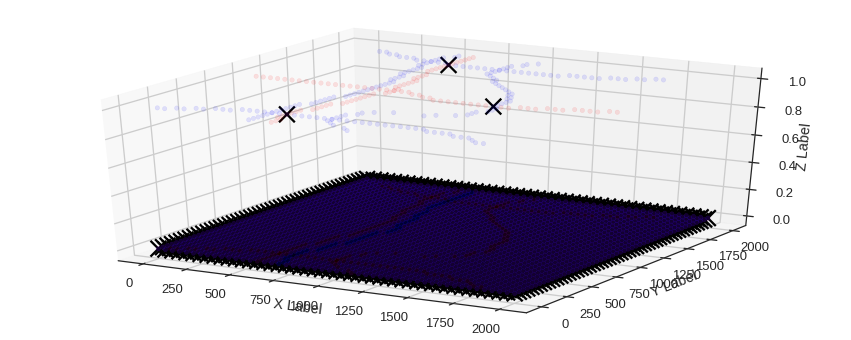

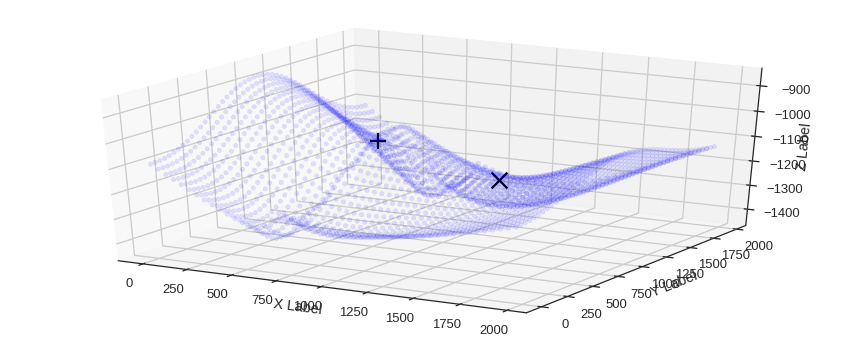

SPILL POINT: [ 1387.75512695   857.1428833  -1155.81062413]
Leak Point: [  653.06121826   979.59185791 -1078.45414984]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 1344000.0 m³
 [--------------   39%                  ] 39 of 100 complete in 529.5 secZ variations top to bottom: 7.65326779353 -6.84654642106 2.19117222093 -4.00098007621
Fault offset variation: 94.212706427
Z variations top to bottom: 7.65326779353 -6.84654642106 2.19117222093 15.4955741522
Fault offset variation: 94.212706427
Z variations top to bottom: 8.50329108014 -6.84654642106 2.19117222093 15.4955741522
Fault offset variation: 94.212706427
Z variations top to bottom: 8.50329108014 -6.84654642106 6.12249993407 15.4955741522
Fault offset variation: 94.212706427
Z variations top to bottom: 8.50329108014 -2.8792993777 6.12249993407 15.4955741522
Fault offset variation: 94.212706427


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.436824183936869e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


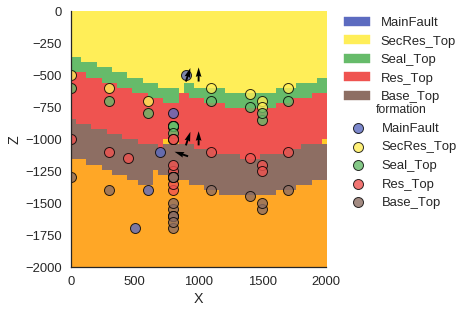

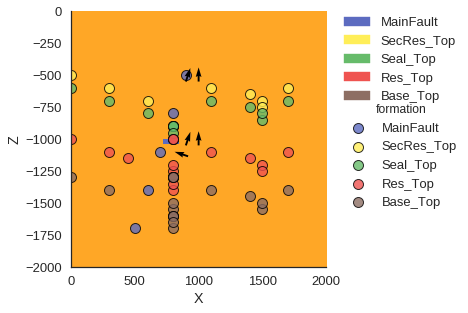

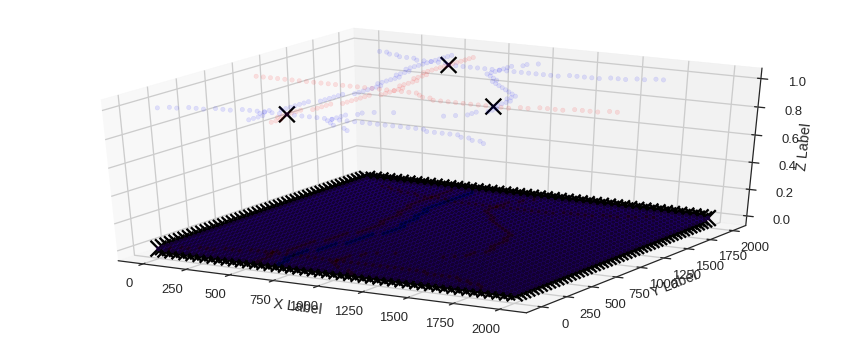

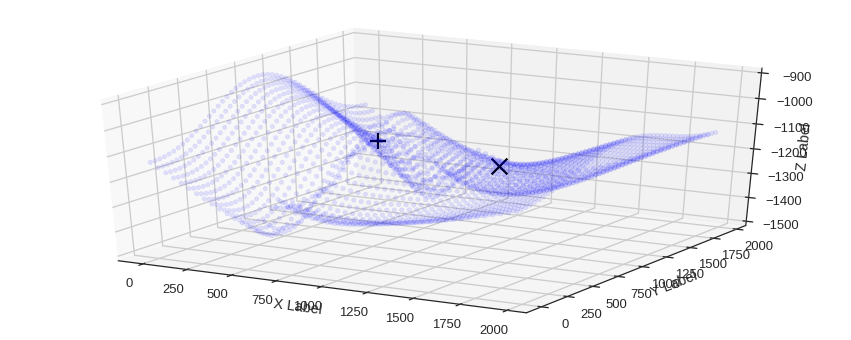

SPILL POINT: [ 1387.75512695   857.1428833  -1152.22427629]
Leak Point: [  653.06121826   979.59185791 -1127.32071461]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13632000.0 m³
 [---------------  40%                  ] 40 of 100 complete in 544.2 secZ variations top to bottom: 8.50329108014 -2.8792993777 6.12249993407 15.4955741522
Fault offset variation: 109.679700689
Z variations top to bottom: 8.50329108014 -2.8792993777 6.12249993407 37.3487295894
Fault offset variation: 94.212706427
Z variations top to bottom: 8.67295123194 -2.8792993777 6.12249993407 37.3487295894
Fault offset variation: 94.212706427
Z variations top to bottom: 8.67295123194 -2.8792993777 13.4904309332 37.3487295894
Fault offset variation: 94.212706427
Z variations top to bottom: 8.67295123194 0.377728067433 6.12249993407 37.3487295894
Fault offset variation: 94.212706427
Z variations top to bo

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.1963884704045977e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


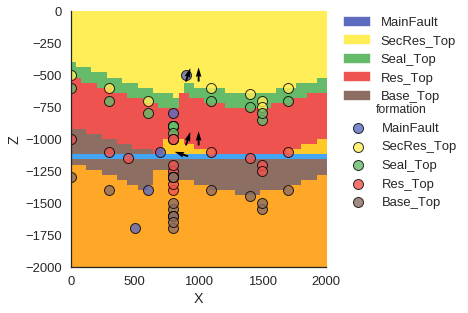

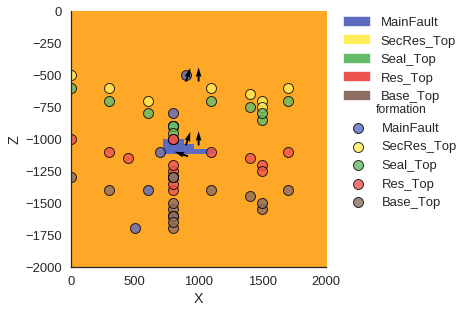

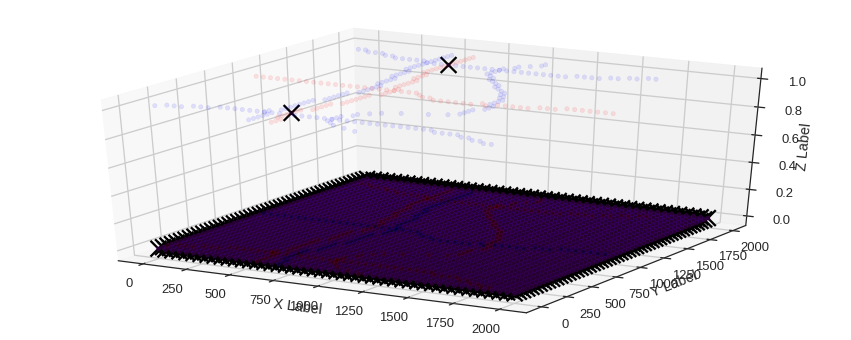

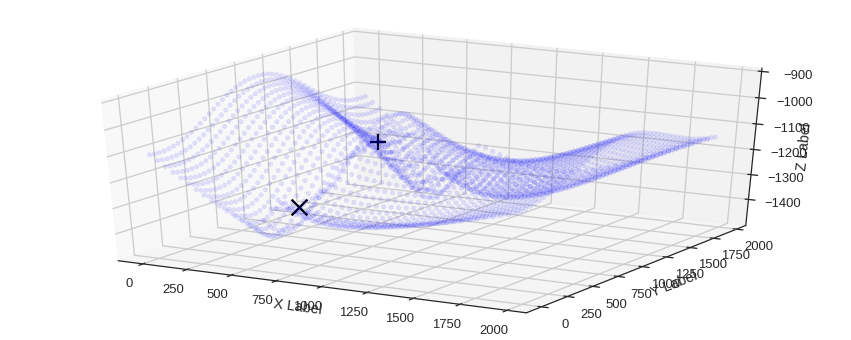

SPILL POINT: [  653.06121826   244.89796448 -1281.57592501]
Leak Point: [  653.06121826   979.59185791 -1130.49920476]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 12864000.0 m³
 [---------------  41%                  ] 41 of 100 complete in 558.9 secZ variations top to bottom: 8.67295123194 -2.8792993777 6.12249993407 37.3487295894
Fault offset variation: 130.349668765
Z variations top to bottom: 8.67295123194 -2.8792993777 6.12249993407 33.7797367155
Fault offset variation: 130.349668765
Z variations top to bottom: 8.34045127815 -2.8792993777 6.12249993407 33.7797367155
Fault offset variation: 130.349668765
Z variations top to bottom: 8.34045127815 -2.8792993777 1.10214393374 33.7797367155
Fault offset variation: 130.349668765
Z variations top to bottom: 8.34045127815 -4.1746775961 1.10214393374 33.7797367155
Fault offset variation: 130.349668765


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.218157422793885e-16
  ' condition number: {}'.format(rcond), RuntimeWarning)


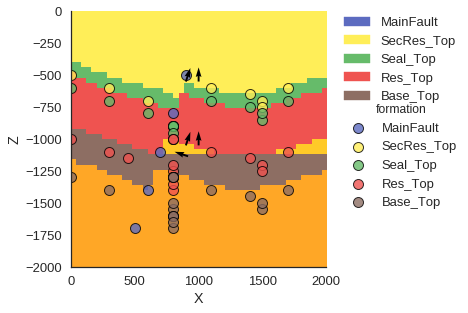

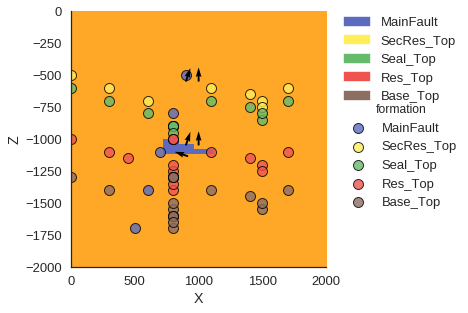

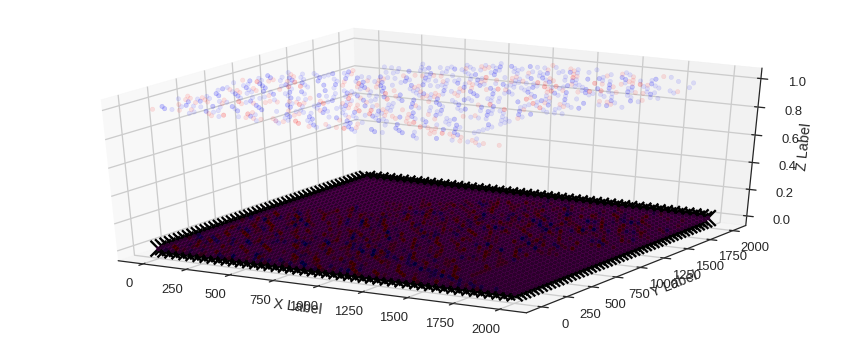

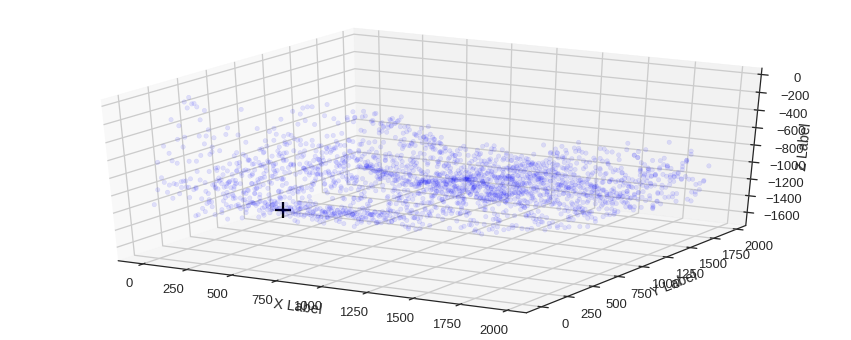

No SPILL POINT found!
Maximum reservoir volume: 0 m³
 [---------------  42%                  ] 42 of 100 complete in 572.3 secZ variations top to bottom: 8.34045127815 -4.1746775961 1.10214393374 33.7797367155
Fault offset variation: 174.39668776
Z variations top to bottom: 8.34045127815 -4.1746775961 1.10214393374 20.8169584003
Fault offset variation: 174.39668776
Z variations top to bottom: 8.77671914704 -4.1746775961 1.10214393374 20.8169584003
Fault offset variation: 174.39668776
Z variations top to bottom: 8.77671914704 -4.1746775961 6.21522261497 20.8169584003
Fault offset variation: 174.39668776
Z variations top to bottom: 8.77671914704 -0.0151021411702 6.21522261497 20.8169584003
Fault offset variation: 174.39668776


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.800388582267838e-13
  ' condition number: {}'.format(rcond), RuntimeWarning)


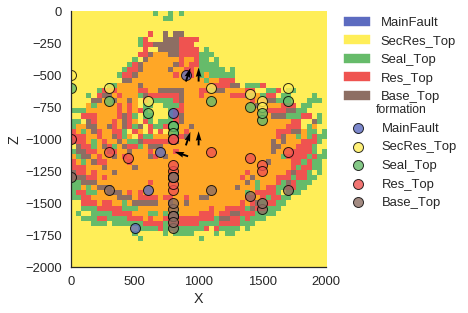

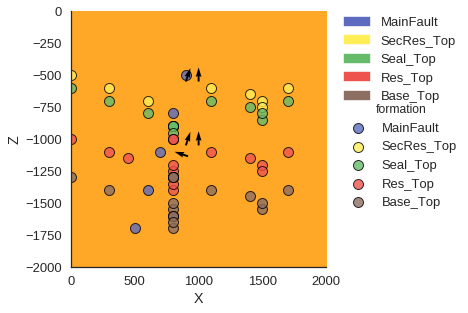

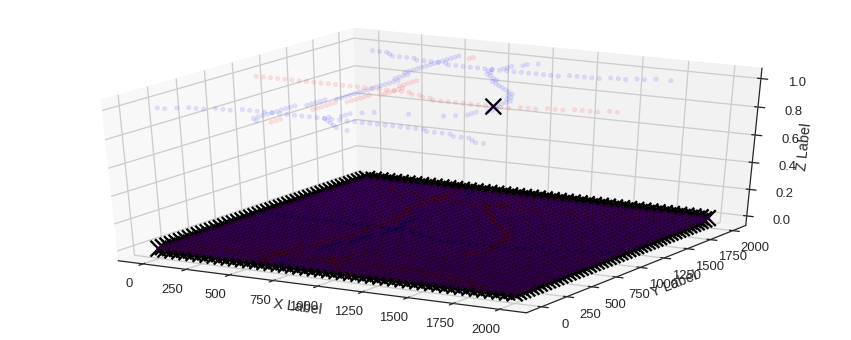

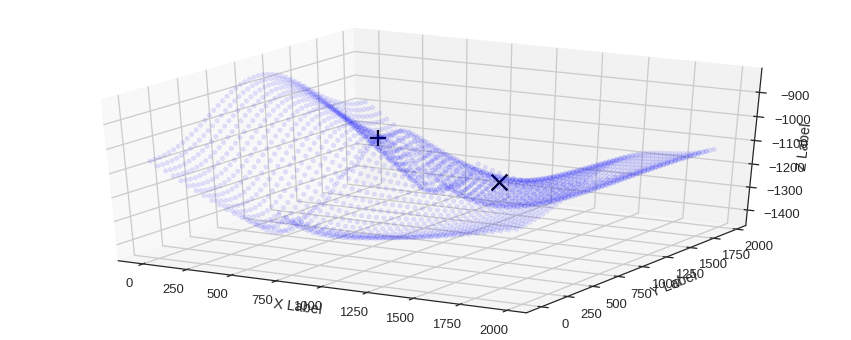

SPILL POINT: [ 1387.75512695   857.1428833  -1152.65299378]
Leak Point: [  653.06121826   979.59185791 -1049.90569667]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 1664000.0 m³
 [---------------- 43%                  ] 43 of 100 complete in 586.1 secZ variations top to bottom: 8.77671914704 -0.0151021411702 6.21522261497 20.8169584003
Fault offset variation: 122.503747261
Z variations top to bottom: 8.77671914704 -0.0151021411702 6.21522261497 42.07558627
Fault offset variation: 122.503747261
Z variations top to bottom: 7.29626044176 -0.0151021411702 6.21522261497 42.07558627
Fault offset variation: 122.503747261
Z variations top to bottom: 7.29626044176 -0.0151021411702 12.9143508609 42.07558627
Fault offset variation: 122.503747261
Z variations top to bottom: 7.29626044176 -2.49052381228 12.9143508609 42.07558627
Fault offset variation: 122.503747261


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.4854097946391818e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


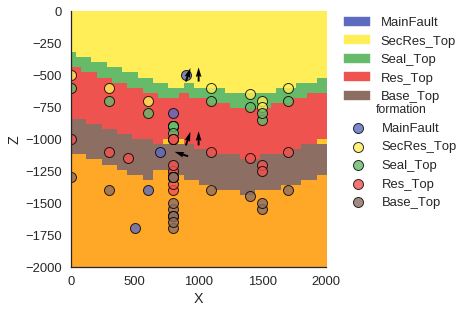

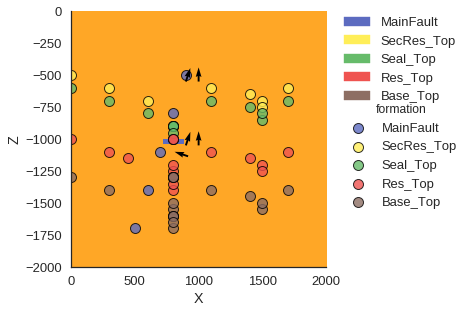

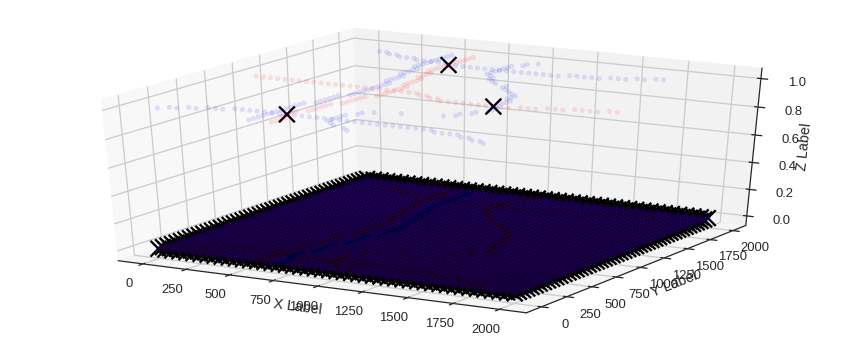

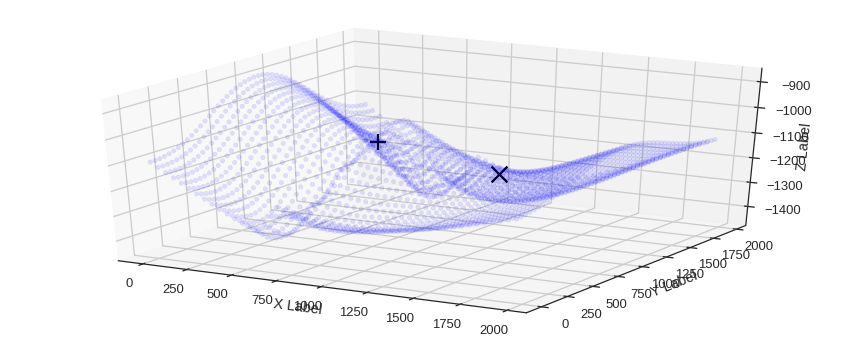

SPILL POINT: [ 1387.75512695   857.1428833  -1146.11520524]
Leak Point: [  653.06121826   979.59185791 -1097.83474445]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 6656000.0 m³
 [---------------- 44%                  ] 44 of 100 complete in 599.8 secZ variations top to bottom: 7.29626044176 -2.49052381228 12.9143508609 42.07558627
Fault offset variation: 43.5097242404
Z variations top to bottom: 7.29626044176 -2.49052381228 12.9143508609 26.634791538
Fault offset variation: 43.5097242404
Z variations top to bottom: 7.34973395989 -2.49052381228 12.9143508609 26.634791538
Fault offset variation: 43.5097242404
Z variations top to bottom: 7.34973395989 -2.49052381228 -1.58455284995 26.634791538
Fault offset variation: 43.5097242404
Z variations top to bottom: 7.34973395989 -2.03092801769 -1.58455284995 26.634791538
Fault offset variation: 43.5097242404


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.227855389469758e-16
  ' condition number: {}'.format(rcond), RuntimeWarning)


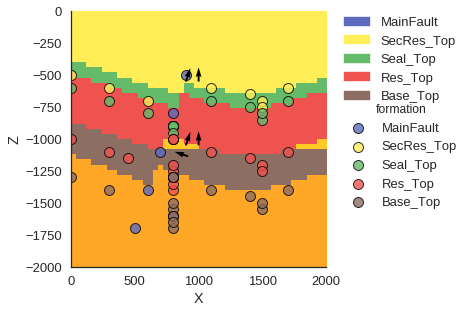

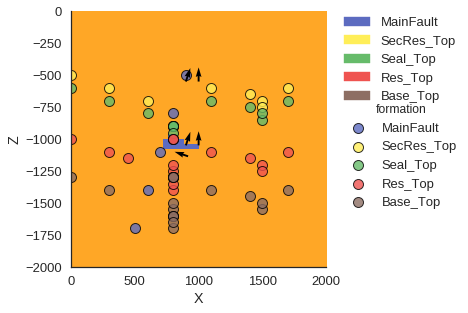

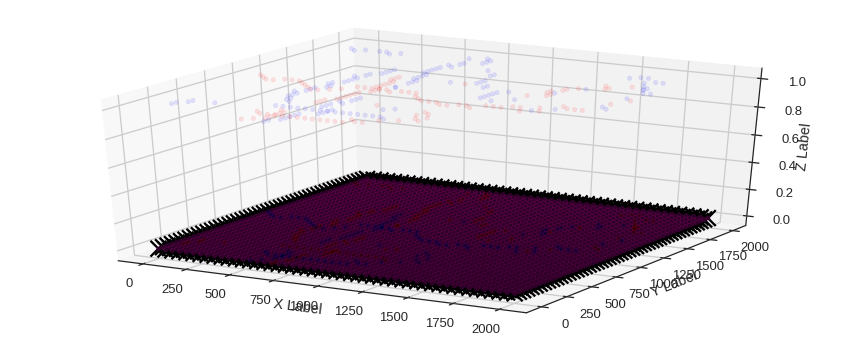

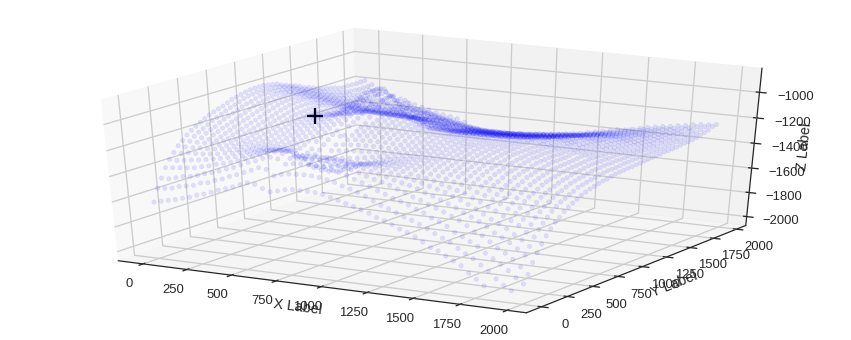

No SPILL POINT found!
Maximum reservoir volume: 0 m³
 [-----------------45%                  ] 45 of 100 complete in 612.6 secZ variations top to bottom: 7.34973395989 -2.03092801769 -1.58455284995 26.634791538
Fault offset variation: 123.61199602
Z variations top to bottom: 7.34973395989 -2.03092801769 -1.58455284995 3.60879189785
Fault offset variation: 123.61199602
Z variations top to bottom: 8.91885668747 -2.03092801769 -1.58455284995 3.60879189785
Fault offset variation: 123.61199602
Z variations top to bottom: 8.91885668747 -2.03092801769 -4.22371360027 3.60879189785
Fault offset variation: 123.61199602
Z variations top to bottom: 8.91885668747 4.61152724928 -4.22371360027 3.60879189785
Fault offset variation: 123.61199602


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.2594356980921706e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


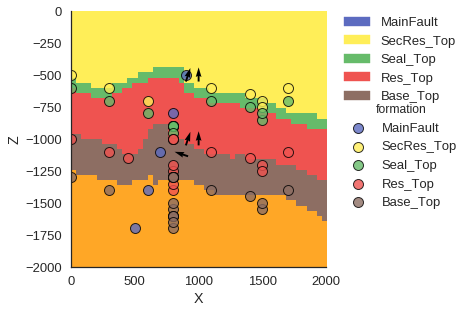

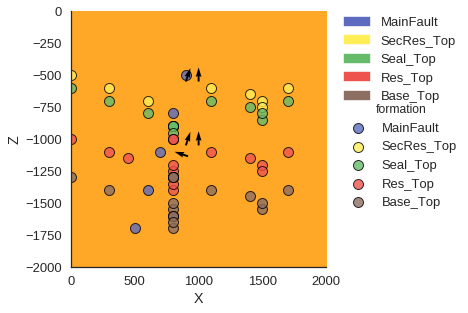

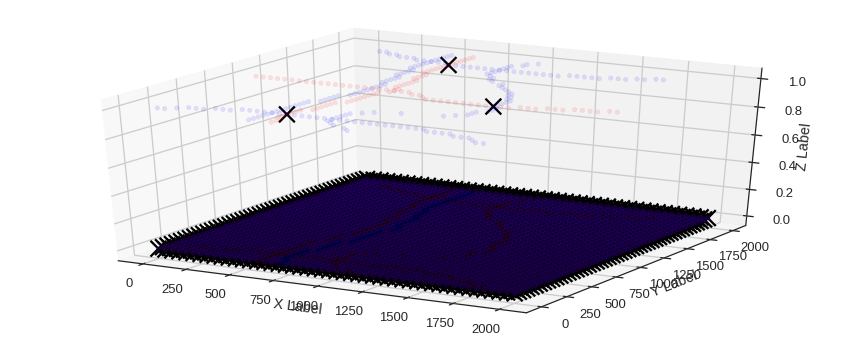

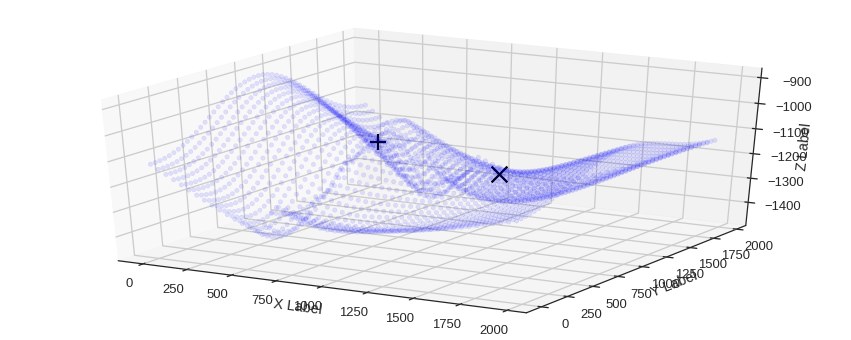

SPILL POINT: [ 1387.75512695   857.1428833  -1162.4903678 ]
Leak Point: [  653.06121826   979.59185791 -1112.21770989]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 11584000.0 m³
 [-----------------46%                  ] 46 of 100 complete in 626.2 secZ variations top to bottom: 8.91885668747 -2.03092801769 -4.22371360027 3.60879189785
Fault offset variation: 133.878069767
Z variations top to bottom: 8.91885668747 -2.03092801769 -4.22371360027 -29.6771421433
Fault offset variation: 133.878069767
Z variations top to bottom: 8.58671186584 -2.03092801769 -4.22371360027 -29.6771421433
Fault offset variation: 133.878069767
Z variations top to bottom: 8.58671186584 -2.03092801769 7.32331434378 -29.6771421433
Fault offset variation: 133.878069767
Z variations top to bottom: 8.58671186584 -6.6386114251 -4.22371360027 -29.6771421433
Fault offset variation: 133.878069767


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.8938576733598406e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


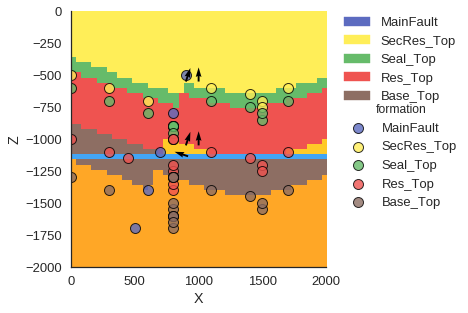

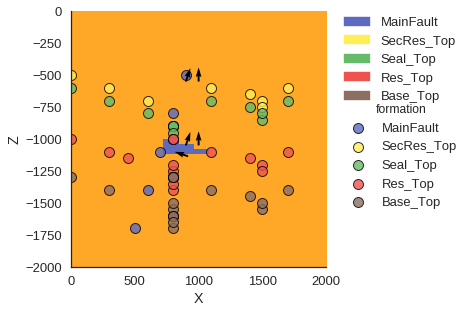

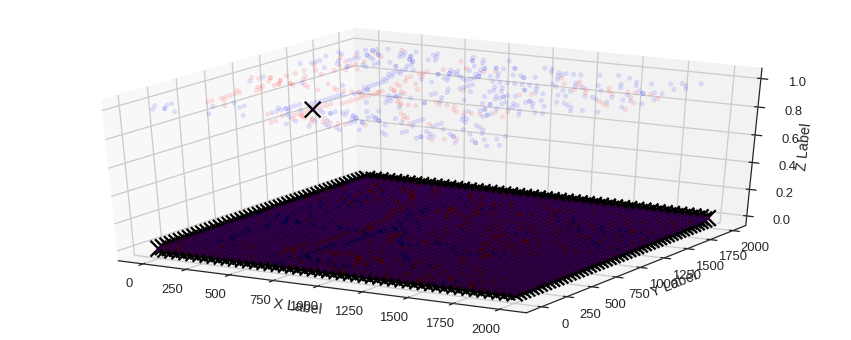

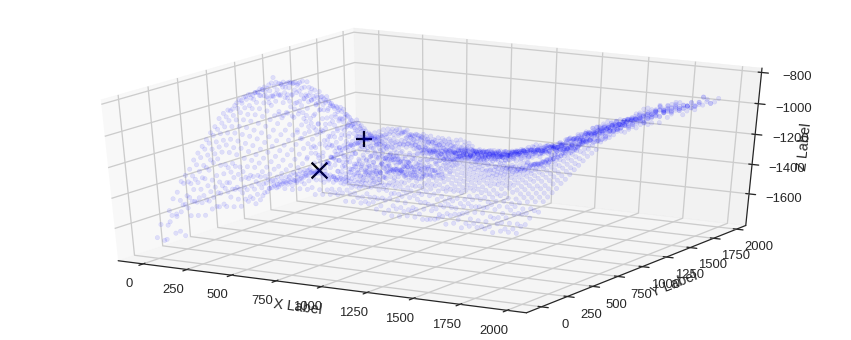

SPILL POINT: [  693.87756348   367.34692383 -1221.21469156]
Leak Point: [  653.06121826   857.1428833  -1141.04618014]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 42
TRAP FOUND, section: 42
Checking Section: 56
TRAP FOUND, section: 56
Checking Section: 57
TRAP FOUND, section: 57
Checking Section: 72
TRAP FOUND, section: 72
Checking Section: 40
TRAP FOUND, section: 40
Checking Section: 68
TRAP FOUND, section: 68
Checking Section: 67
TRAP FOUND, section: 67
Checking Section: 64
TRAP FOUND, section: 64
Checking Section: 69
Checking Section: 43
TRAP FOUND, section: 43
Maximum reservoir volume: 33792000.0 m³
 [-----------------47%                  ] 47 of 100 complete in 640.6 secZ variations top to bottom: 8.58671186584 -6.6386114251 -4.22371360027 -29.6771421433
Fault offset variation: 107.389384678
Z variations top to bottom: 8.58671186584 -6.6386114251 -4.22371360027 -47.7399236434
Fault offset variation: 107.389384678
Z variations top to b

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.959345426327257e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


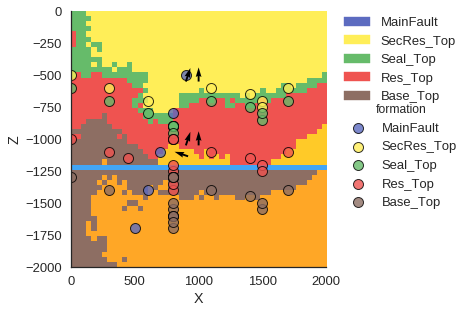

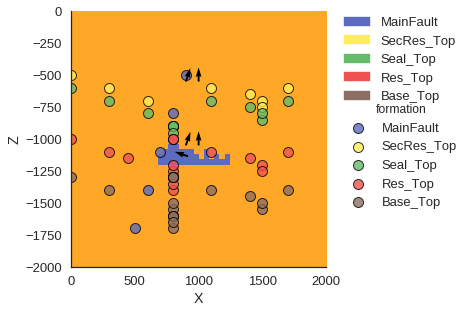

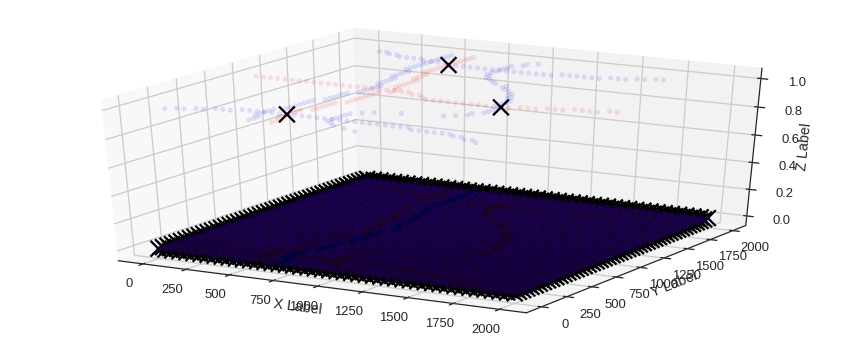

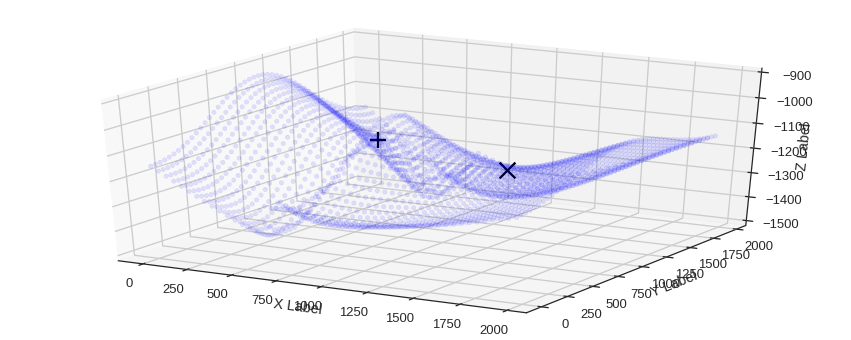

SPILL POINT: [ 1428.57141113   857.1428833  -1167.0088418 ]
Leak Point: [  653.06121826   979.59185791 -1127.42093325]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 10624000.0 m³
 [-----------------48%                  ] 48 of 100 complete in 654.3 secZ variations top to bottom: 8.58671186584 -11.9544648088 -8.89420364853 -47.7399236434
Fault offset variation: 93.5697387213
Z variations top to bottom: 8.58671186584 -11.9544648088 -8.89420364853 -67.2029183554
Fault offset variation: 93.5697387213
Z variations top to bottom: 7.98300119817 -11.9544648088 -8.89420364853 -47.7399236434
Fault offset variation: 93.5697387213
Z variations top to bottom: 7.98300119817 -11.9544648088 -19.3978319153 -47.7399236434
Fault offset variation: 93.5697387213
Z variations top to bottom: 7.98300119817 -26.3073426167 -19.3978319153 -47.7399236434
Fault offset variation: 93.5697387213


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.2115314685452652e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


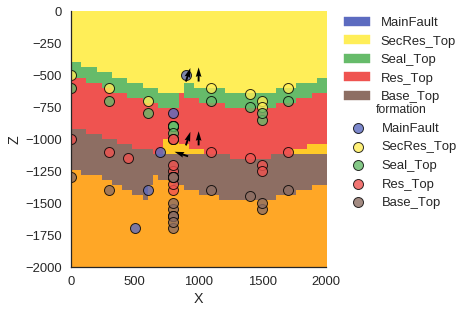

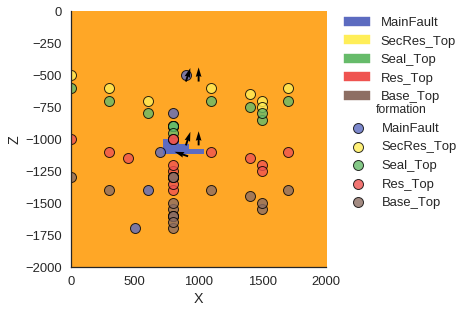

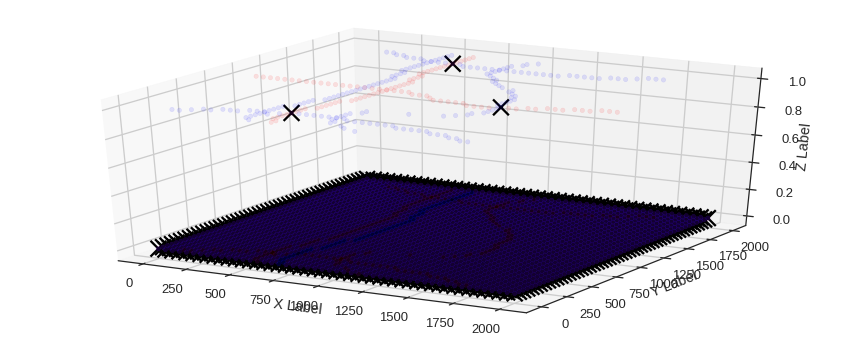

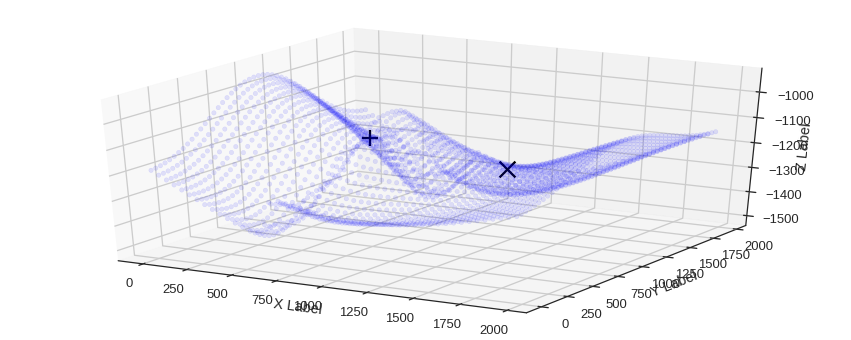

SPILL POINT: [ 1428.57141113   857.1428833  -1183.66635008]
Leak Point: [  612.24487305   979.59185791 -1146.48926132]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 20288000.0 m³
 [-----------------49%                  ] 49 of 100 complete in 667.9 secZ variations top to bottom: 7.98300119817 -11.9544648088 -19.3978319153 -47.7399236434
Fault offset variation: 158.035606736
Z variations top to bottom: 7.98300119817 -11.9544648088 -19.3978319153 -11.4305455191
Fault offset variation: 158.035606736
Z variations top to bottom: 7.07546020584 -11.9544648088 -19.3978319153 -11.4305455191
Fault offset variation: 158.035606736
Z variations top to bottom: 7.07546020584 -11.9544648088 -30.8446189256 -11.4305455191
Fault offset variation: 158.035606736
Z variations top to bottom: 7.07546020584 -11.4327662945 -30.8446189256 -11.4305455191
Fault offset variation: 158.035606736


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.033711523838355e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


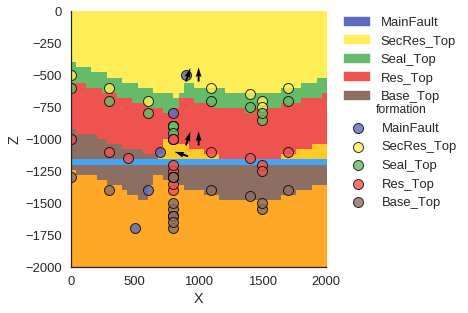

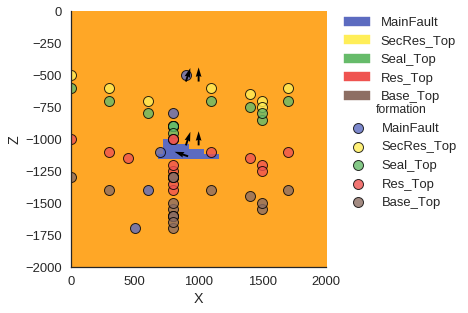

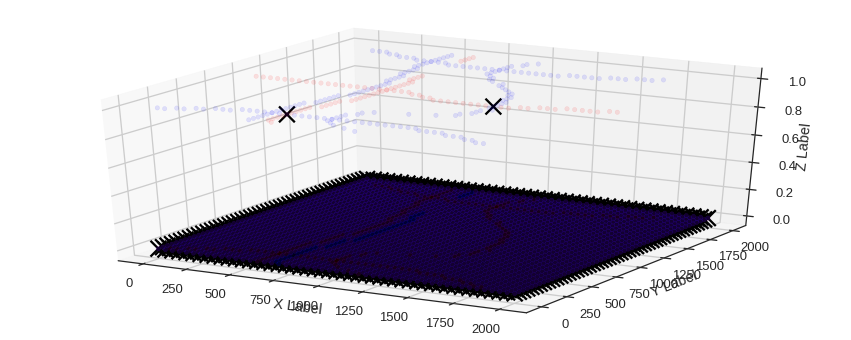

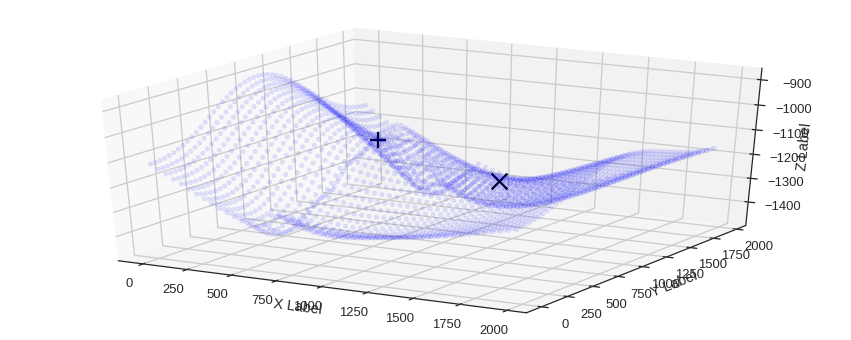

SPILL POINT: [ 1387.75512695   857.1428833  -1189.22278661]
Leak Point: [  653.06121826   979.59185791 -1102.98457045]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 16192000.0 m³
 [-----------------50%                  ] 50 of 100 complete in 682.6 secZ variations top to bottom: 7.07546020584 -11.4327662945 -30.8446189256 -11.4305455191
Fault offset variation: 186.434275556
Z variations top to bottom: 7.07546020584 -11.4327662945 -30.8446189256 42.9900729285
Fault offset variation: 186.434275556
Z variations top to bottom: 7.7850734787 -11.4327662945 -30.8446189256 42.9900729285
Fault offset variation: 186.434275556
Z variations top to bottom: 7.07546020584 -11.4327662945 -22.9869931023 42.9900729285
Fault offset variation: 186.434275556
Z variations top to bottom: 7.07546020584 -7.02501593036 -22.9869931023 42.9900729285
Fault offset variation: 186.434275556


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.05272764303161e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


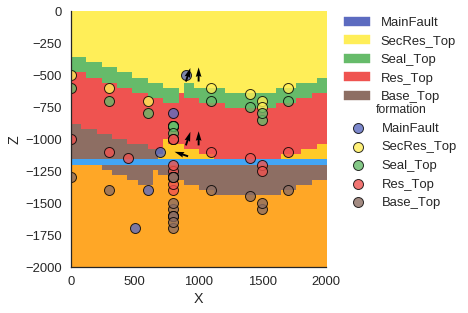

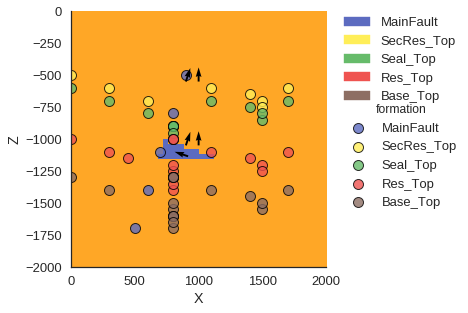

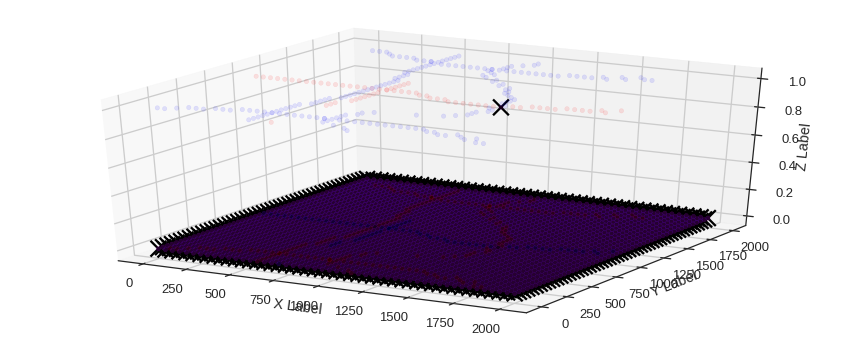

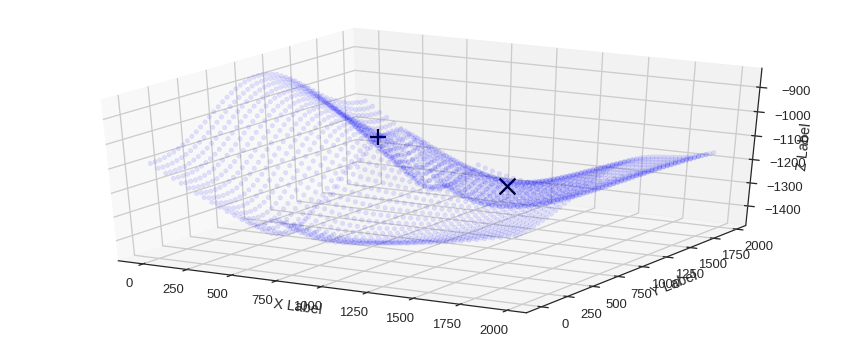

SPILL POINT: [ 1428.57141113   857.1428833  -1182.75257672]
Leak Point: [  653.06121826   979.59185791 -1064.47009629]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 640000.0 m³
 [-----------------51%                  ] 51 of 100 complete in 696.4 secZ variations top to bottom: 7.07546020584 -7.02501593036 -22.9869931023 42.9900729285
Fault offset variation: 214.929664087
Z variations top to bottom: 7.07546020584 -7.02501593036 -22.9869931023 20.043376186
Fault offset variation: 214.929664087
Z variations top to bottom: 8.08715882935 -7.02501593036 -22.9869931023 20.043376186
Fault offset variation: 214.929664087
Z variations top to bottom: 7.07546020584 -7.02501593036 -19.3395353869 20.043376186
Fault offset variation: 214.929664087
Z variations top to bottom: 7.07546020584 -3.68529010698 -19.3395353869 20.043376186
Fault offset variation: 214.929664087


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.83453404377365e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


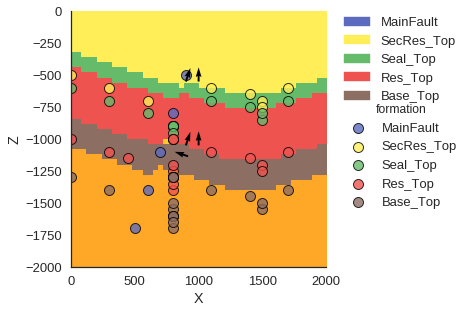

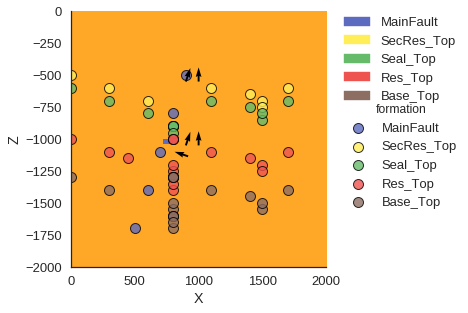

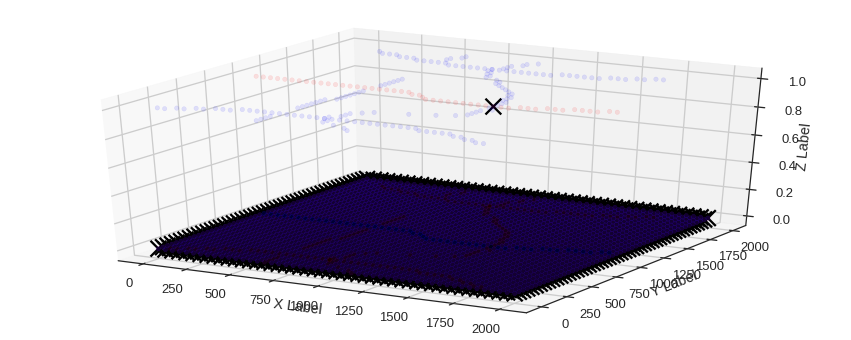

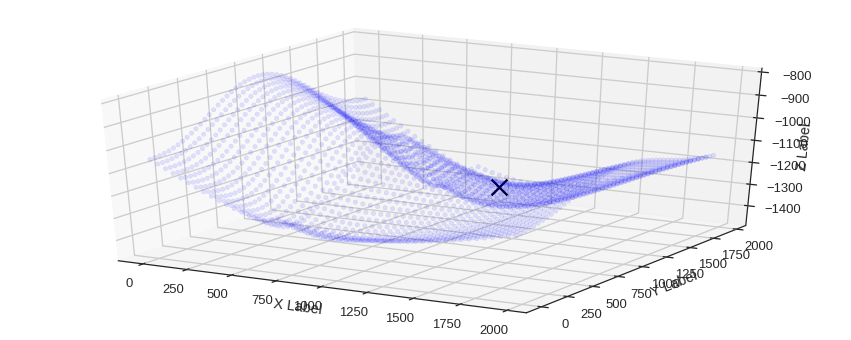

SPILL POINT: [ 1387.75512695   857.1428833  -1177.78344673]
No LEAK POINT found! So FULL LEAKAGE assumed!
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 8
No trap found! =(
Maximum reservoir volume: 0.0 m³
 [-----------------52%                  ] 52 of 100 complete in 710.1 secZ variations top to bottom: 7.07546020584 -7.02501593036 -19.3395353869 20.043376186
Fault offset variation: 195.335632109
Z variations top to bottom: 7.07546020584 -7.02501593036 -19.3395353869 72.7348235086
Fault offset variation: 195.335632109
Z variations top to bottom: 5.0098318131 -7.02501593036 -19.3395353869 20.043376186
Fault offset variation: 195.335632109
Z variations top to bottom: 5.0098318131 -7.02501593036 -22.8003750922 20.043376186
Fault offset variation: 195.335632109
Z variations top to bottom: 5.0098318131 -5.81615775231 -22.8003750922 20.043376186
Fault offset variation: 195.335632109


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.596454997355702e-19
  ' condition number: {}'.format(rcond), RuntimeWarning)


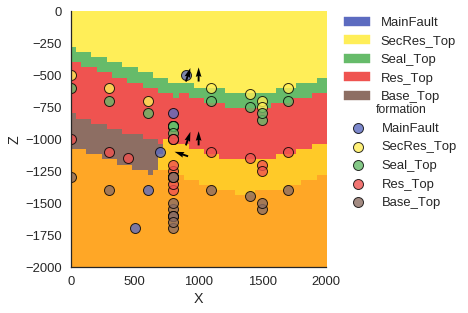

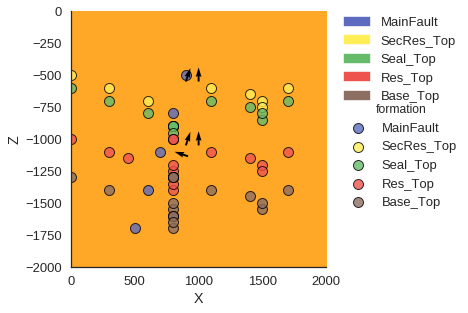

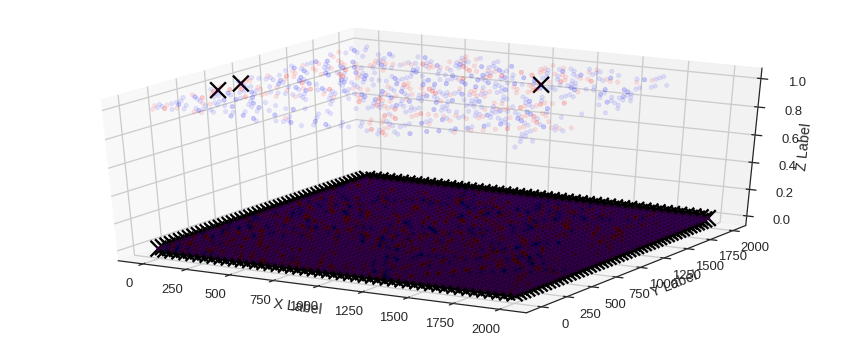

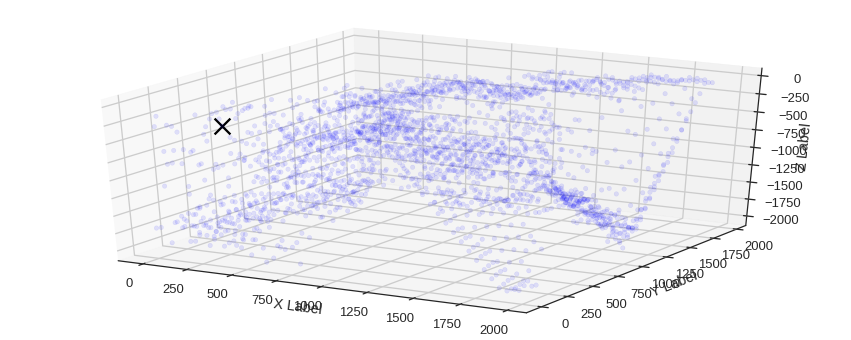

SPILL POINT: [  40.81632614  571.42858887 -535.45795145]
No LEAK POINT found! So FULL LEAKAGE assumed!
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 442
Checking Section: 460
Checking Section: 643
Checking Section: 533
Checking Section: 626
TRAP FOUND, section: 626
Checking Section: 559
TRAP FOUND, section: 559
Checking Section: 600
Checking Section: 528
TRAP FOUND, section: 528
Checking Section: 589
TRAP FOUND, section: 589
Checking Section: 631
Checking Section: 556
TRAP FOUND, section: 556
Checking Section: 545
TRAP FOUND, section: 545
Checking Section: 544
TRAP FOUND, section: 544
Checking Section: 440
Checking Section: 447
Checking Section: 599
Checking Section: 651
Checking Section: 620
Checking Section: 549
Checking Section: 612
Checking Section: 606
Checking Section: 458
TRAP FOUND, section: 458
Maximum reservoir volume: 768000.0 m³
 [-----------------53%                  ] 53 of 100 complete in 726.6 secZ variations top to bottom: 5

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.2927360924667193e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


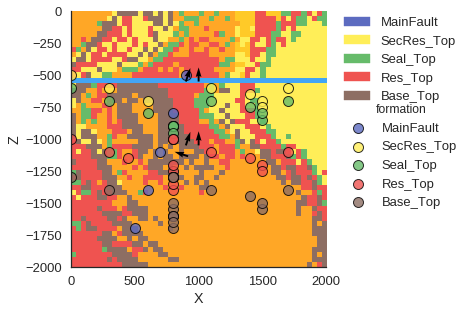

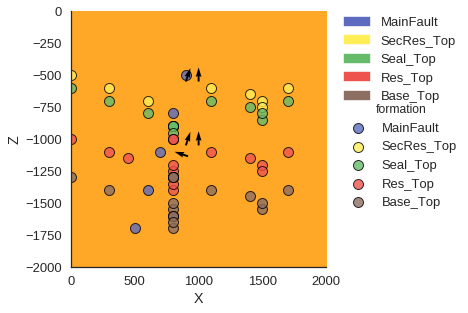

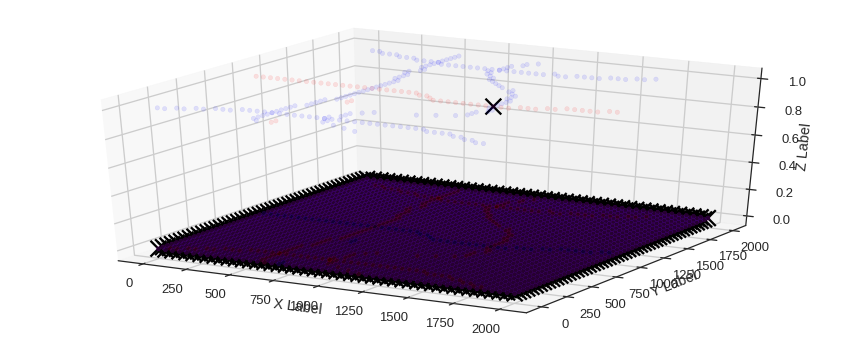

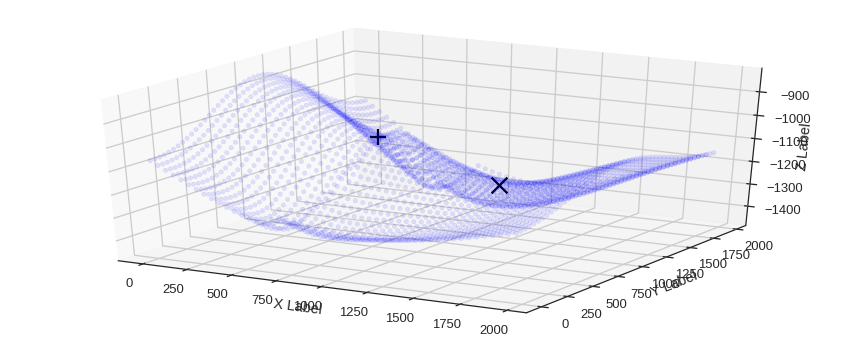

SPILL POINT: [ 1387.75512695   857.1428833  -1174.3885921 ]
Leak Point: [  653.06121826   979.59185791 -1050.66037778]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 21
Checking Section: 18
TRAP FOUND, section: 18
Maximum reservoir volume: 20992000.0 m³
 [-----------------54%                  ] 54 of 100 complete in 742.0 secZ variations top to bottom: 6.20966727186 -6.32722218199 -15.8478281094 24.3573293749
Fault offset variation: 216.029575031
Z variations top to bottom: 6.20966727186 -6.32722218199 -15.8478281094 31.7373333649
Fault offset variation: 216.029575031
Z variations top to bottom: 5.25186037618 -6.32722218199 -15.8478281094 31.7373333649
Fault offset variation: 216.029575031
Z variations top to bottom: 5.25186037618 -6.32722218199 -17.405875164 31.7373333649
Fault offset variation: 216.029575031
Z variations top to bottom: 5.25186037618 -6.61654690933 -17.405875164 31.7373333649
Fault offset variation: 216.029575031


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.5098348556797448e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


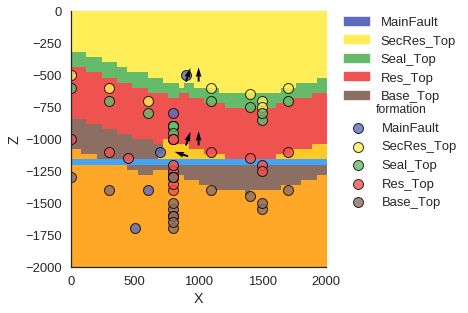

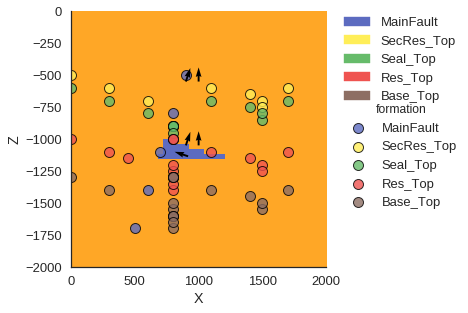

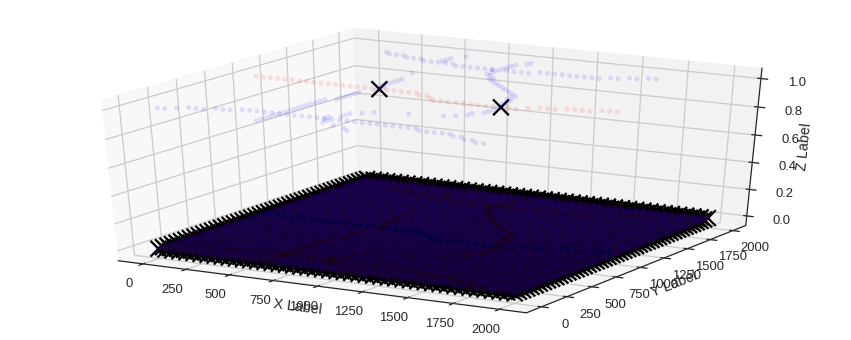

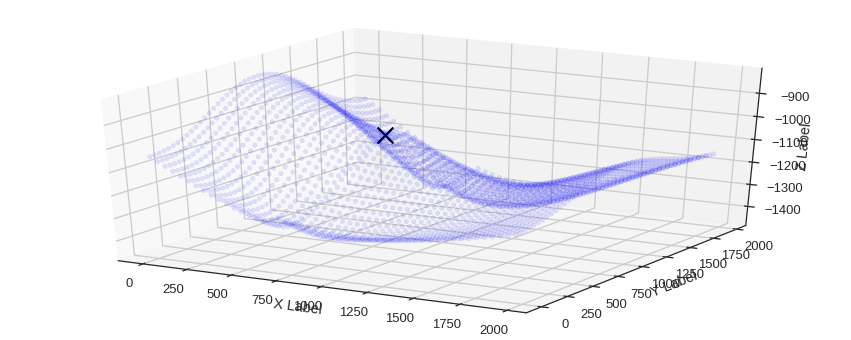

SPILL POINT: [  693.87756348   979.59185791 -1034.22061518]
No LEAK POINT found! So FULL LEAKAGE assumed!
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 8
No trap found! =(
Maximum reservoir volume: 0.0 m³
 [-----------------55%                  ] 55 of 100 complete in 755.6 secZ variations top to bottom: 5.25186037618 -6.61654690933 -17.405875164 31.7373333649
Fault offset variation: 159.172348521
Z variations top to bottom: 5.25186037618 -6.61654690933 -17.405875164 42.6929315343
Fault offset variation: 159.172348521
Z variations top to bottom: 5.3360257257 -6.61654690933 -17.405875164 42.6929315343
Fault offset variation: 159.172348521
Z variations top to bottom: 5.3360257257 -6.61654690933 -0.894604132766 42.6929315343
Fault offset variation: 159.172348521
Z variations top to bottom: 5.3360257257 -6.4290612513 -0.894604132766 42.6929315343
Fault offset variation: 159.172348521


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.2191385921622722e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


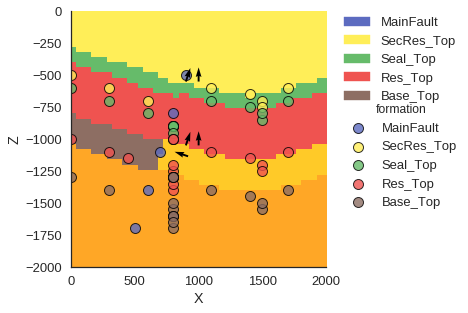

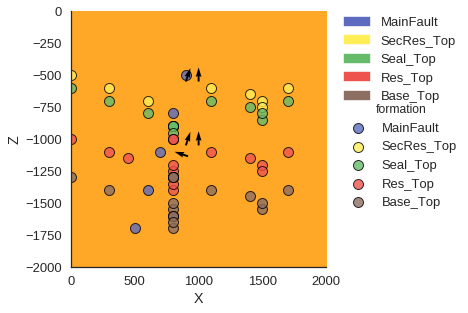

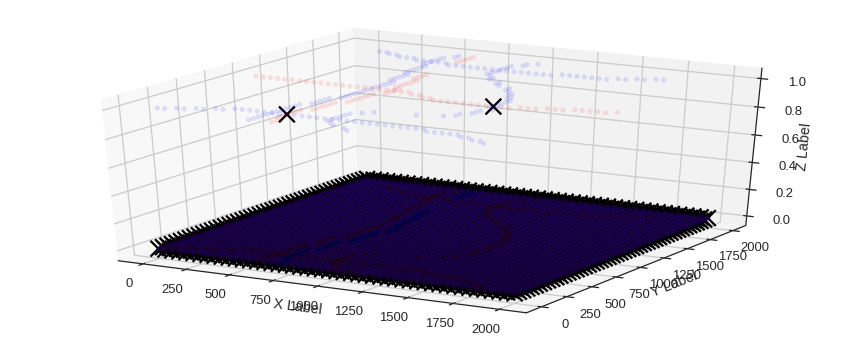

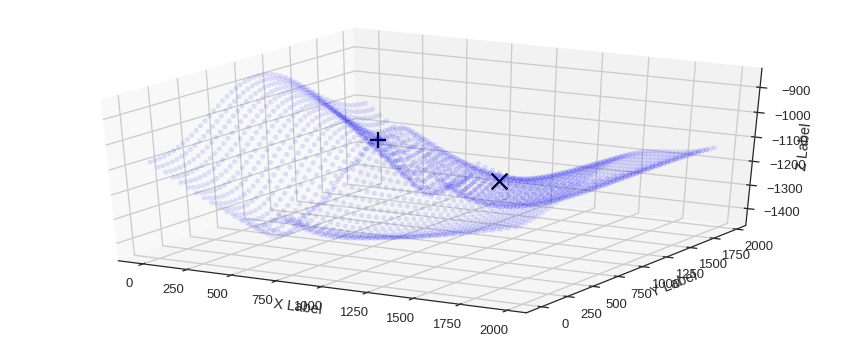

SPILL POINT: [ 1387.75512695   857.1428833  -1159.66324441]
Leak Point: [  653.06121826   979.59185791 -1073.89976066]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 15
Checking Section: 12
TRAP FOUND, section: 12
Maximum reservoir volume: 1344000.0 m³
 [-----------------56%-                 ] 56 of 100 complete in 769.3 secZ variations top to bottom: 5.3360257257 -6.4290612513 -0.894604132766 42.6929315343
Fault offset variation: 247.441156475
Z variations top to bottom: 5.3360257257 -6.4290612513 -0.894604132766 43.1230847694
Fault offset variation: 159.172348521
Z variations top to bottom: 5.55036357871 -6.4290612513 -0.894604132766 43.1230847694
Fault offset variation: 159.172348521
Z variations top to bottom: 5.55036357871 -6.4290612513 -12.4317671683 43.1230847694
Fault offset variation: 159.172348521
Z variations top to bottom: 5.55036357871 -3.96690302446 -12.4317671683 43.1230847694
Fault offset variation: 159.172348521


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.4927844077121675e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


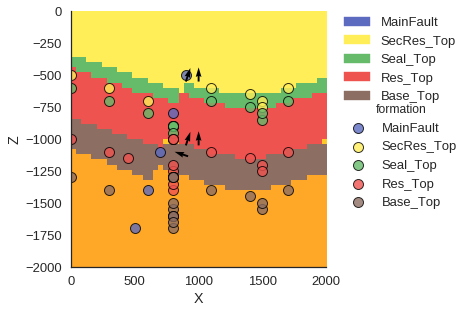

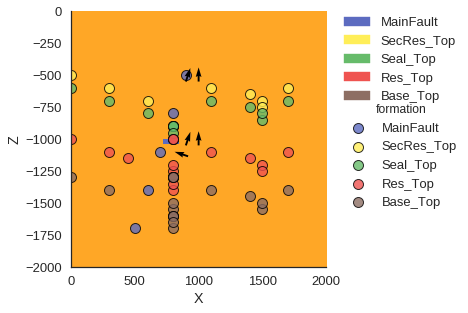

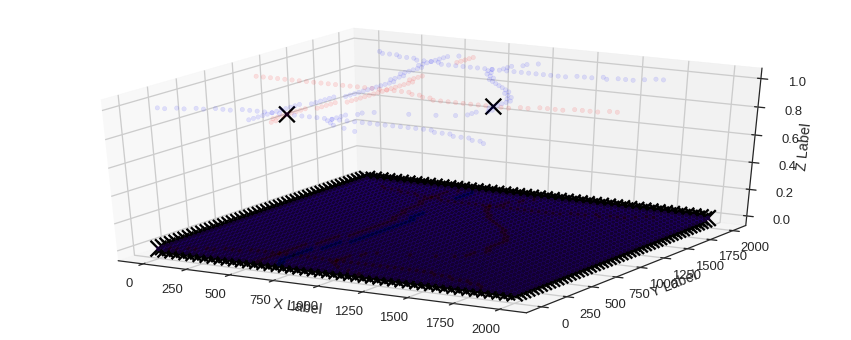

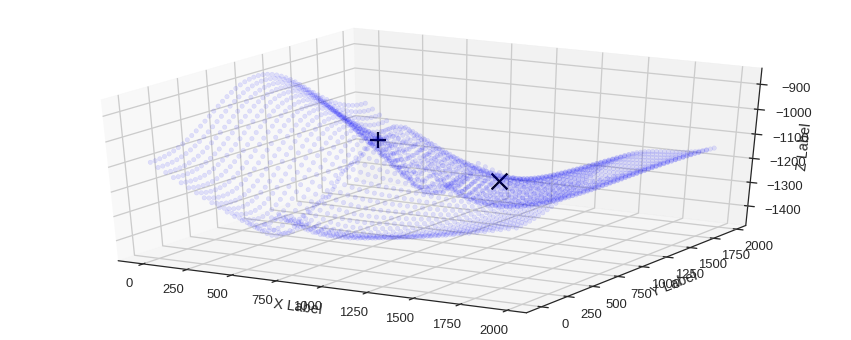

SPILL POINT: [ 1387.75512695   857.1428833  -1170.78323133]
Leak Point: [  653.06121826   979.59185791 -1084.68967402]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 3584000.0 m³
 [-----------------57%-                 ] 57 of 100 complete in 783.0 secZ variations top to bottom: 5.55036357871 -3.96690302446 -12.4317671683 43.1230847694
Fault offset variation: 76.516472709
Z variations top to bottom: 5.55036357871 -3.96690302446 -12.4317671683 47.4161205069
Fault offset variation: 76.516472709
Z variations top to bottom: 6.98990654802 -3.96690302446 -12.4317671683 47.4161205069
Fault offset variation: 76.516472709
Z variations top to bottom: 6.98990654802 -3.96690302446 2.00903704316 47.4161205069
Fault offset variation: 76.516472709
Z variations top to bottom: 6.98990654802 -8.22782310627 2.00903704316 47.4161205069
Fault offset variation: 76.516472709


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.984884133760805e-13
  ' condition number: {}'.format(rcond), RuntimeWarning)


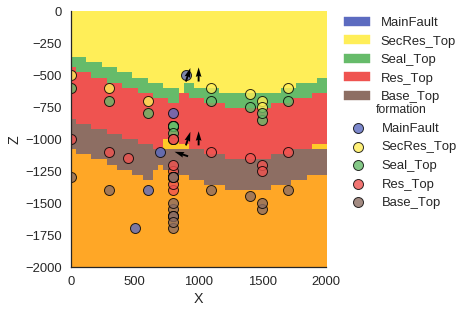

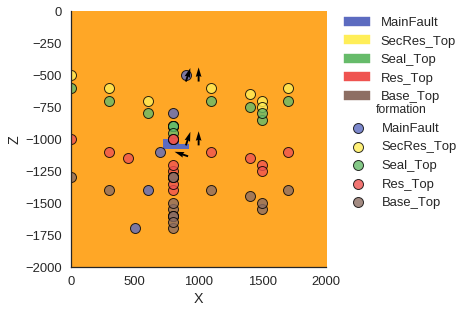

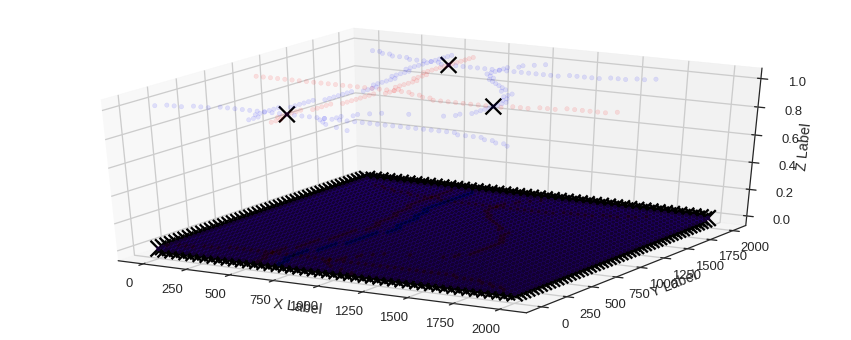

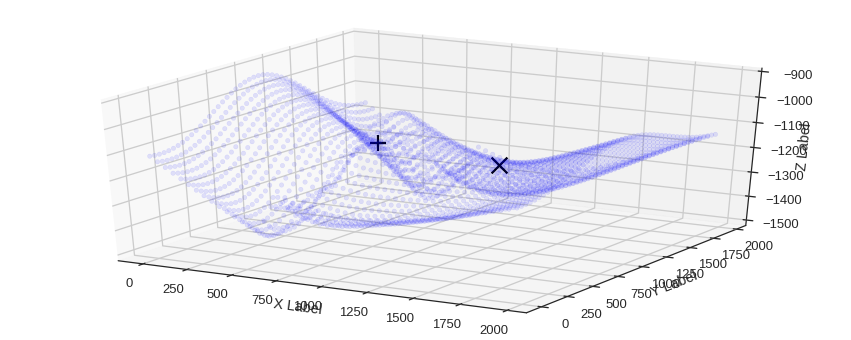

SPILL POINT: [ 1387.75512695   857.1428833  -1151.93561473]
Leak Point: [  653.06121826   979.59185791 -1141.97708472]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 12224000.0 m³
 [-----------------58%--                ] 58 of 100 complete in 796.6 secZ variations top to bottom: 6.98990654802 -8.22782310627 2.00903704316 47.4161205069
Fault offset variation: 50.2995416961
Z variations top to bottom: 6.98990654802 -8.22782310627 2.00903704316 19.7678183959
Fault offset variation: 50.2995416961
Z variations top to bottom: 8.03403320043 -8.22782310627 2.00903704316 19.7678183959
Fault offset variation: 50.2995416961
Z variations top to bottom: 8.03403320043 -8.22782310627 4.69451574233 19.7678183959
Fault offset variation: 50.2995416961
Z variations top to bottom: 8.03403320043 -10.0990706973 4.69451574233 19.7678183959
Fault offset variation: 50.2995416961


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.139765625629563e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


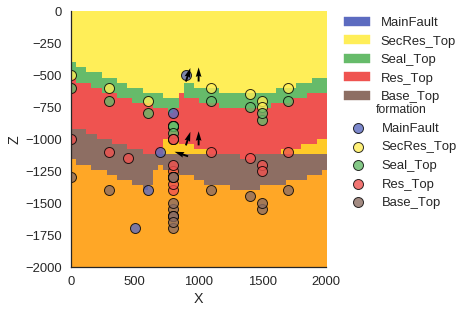

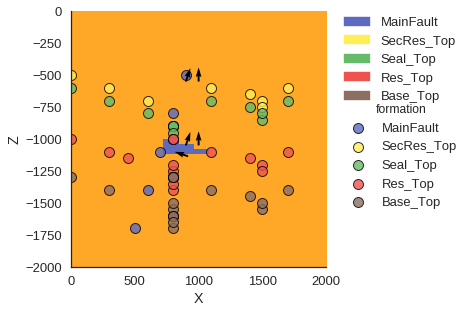

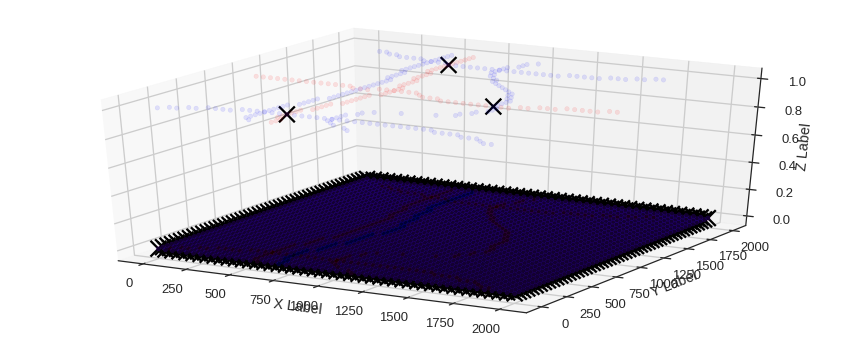

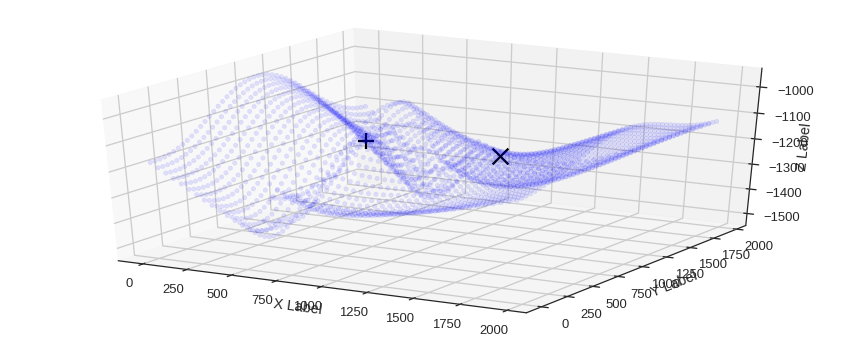

SPILL POINT: [ 1387.75512695   857.1428833  -1153.83493948]
Leak Point: [  612.24487305   938.7755127  -1169.42853752]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13504000.0 m³
 [-----------------59%--                ] 59 of 100 complete in 811.7 secZ variations top to bottom: 8.03403320043 -10.0990706973 4.69451574233 19.7678183959
Fault offset variation: 28.4789334329
Z variations top to bottom: 8.03403320043 -10.0990706973 4.69451574233 5.11357141472
Fault offset variation: 28.4789334329
Z variations top to bottom: 6.45195269046 -10.0990706973 4.69451574233 5.11357141472
Fault offset variation: 28.4789334329
Z variations top to bottom: 6.45195269046 -10.0990706973 2.44578349429 5.11357141472
Fault offset variation: 28.4789334329
Z variations top to bottom: 6.45195269046 -9.25762051582 2.44578349429 5.11357141472
Fault offset variation: 28.4789334329


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.1124907012315458e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


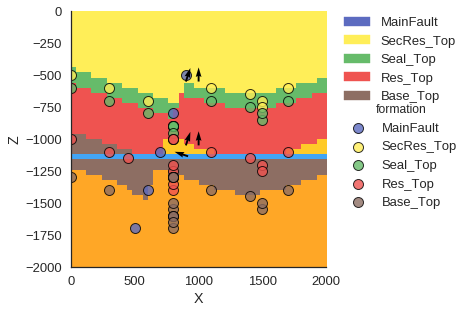

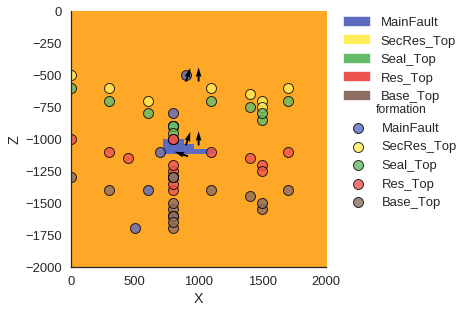

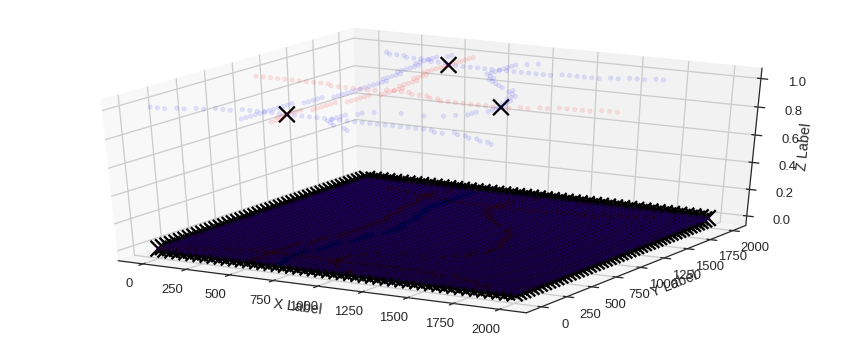

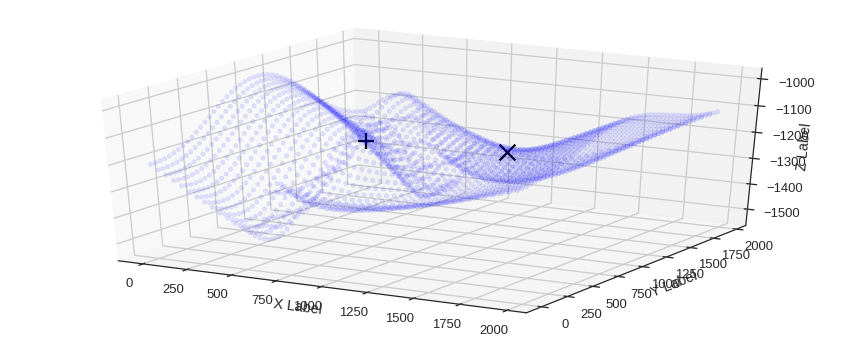

SPILL POINT: [ 1428.57141113   857.1428833  -1162.24914638]
Leak Point: [  612.24487305   938.7755127  -1193.81071865]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13696000.0 m³
 [-----------------60%--                ] 60 of 100 complete in 825.3 secZ variations top to bottom: 6.45195269046 -9.25762051582 2.44578349429 5.11357141472
Fault offset variation: -16.6009552598
Z variations top to bottom: 6.45195269046 -9.25762051582 2.44578349429 -31.4389615708
Fault offset variation: -16.6009552598
Z variations top to bottom: 5.57355719342 -9.25762051582 2.44578349429 5.11357141472
Fault offset variation: -16.6009552598
Z variations top to bottom: 5.57355719342 -9.25762051582 -7.33862947142 5.11357141472
Fault offset variation: -16.6009552598
Z variations top to bottom: 5.57355719342 -8.79412421158 -7.33862947142 5.11357141472
Fault offset variation: -16.6009552598


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.2967689422271889e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


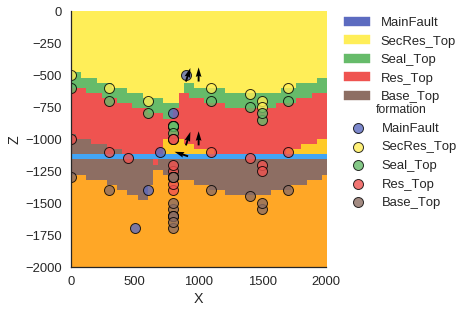

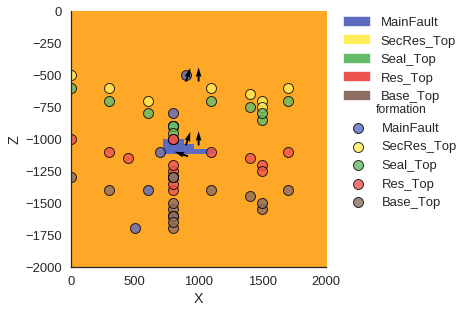

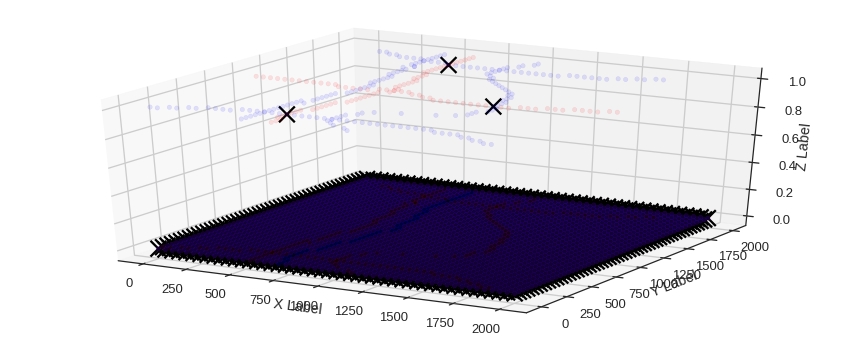

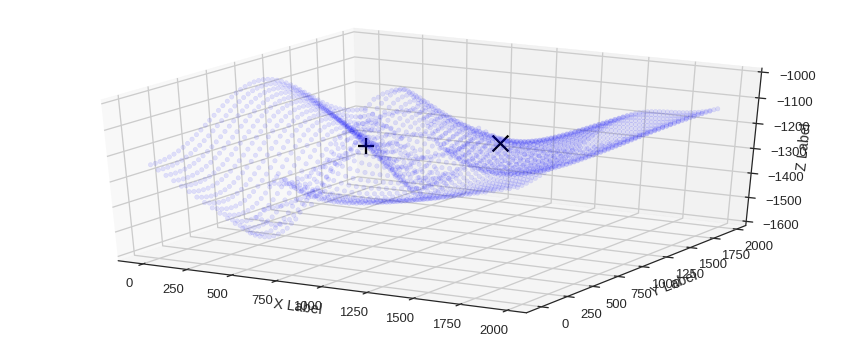

SPILL POINT: [ 1387.75512695   857.1428833  -1165.18388193]
Leak Point: [  612.24487305   938.7755127  -1246.96149674]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 24192000.0 m³
 [-----------------61%---               ] 61 of 100 complete in 839.3 secZ variations top to bottom: 5.57355719342 -8.79412421158 -7.33862947142 5.11357141472
Fault offset variation: -54.9580196576
Z variations top to bottom: 5.57355719342 -8.79412421158 -7.33862947142 -5.81588591527
Fault offset variation: -54.9580196576
Z variations top to bottom: 6.37455969245 -8.79412421158 -7.33862947142 -5.81588591527
Fault offset variation: -54.9580196576
Z variations top to bottom: 6.37455969245 -8.79412421158 -7.56633749345 -5.81588591527
Fault offset variation: -54.9580196576
Z variations top to bottom: 6.37455969245 -9.03411027899 -7.56633749345 -5.81588591527
Fault offset variation: -54.9580196576


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 5.0521933858682644e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


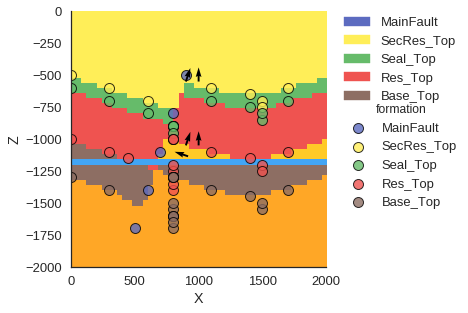

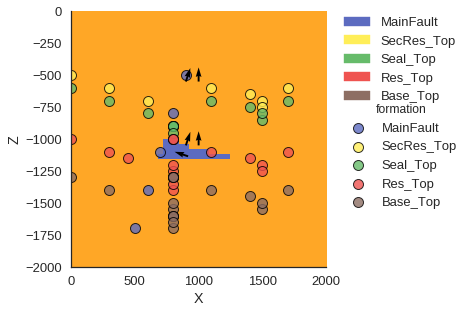

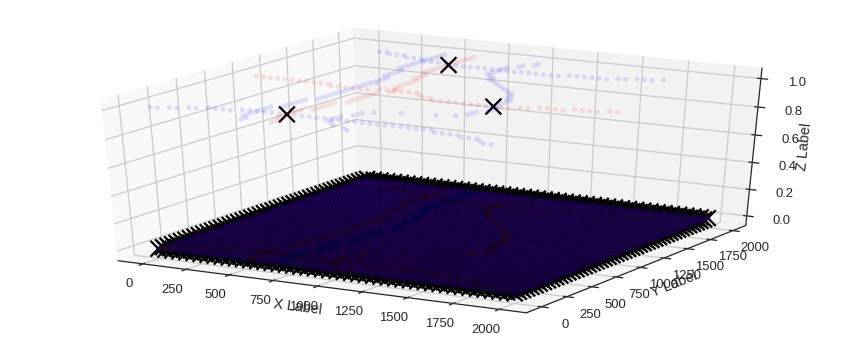

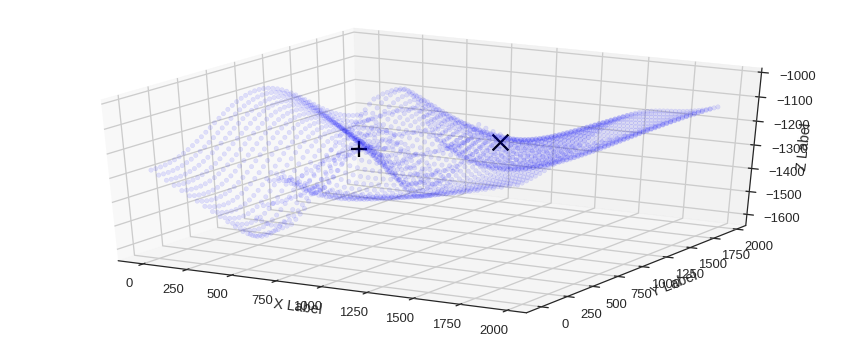

SPILL POINT: [ 1387.75512695   857.1428833  -1165.52324662]
Leak Point: [  571.42858887   938.7755127  -1277.59694272]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 24256000.0 m³
 [-----------------62%---               ] 62 of 100 complete in 852.9 secZ variations top to bottom: 6.37455969245 -9.03411027899 -7.56633749345 -5.81588591527
Fault offset variation: 25.6091569108
Z variations top to bottom: 6.37455969245 -9.03411027899 -7.56633749345 -43.5512420369
Fault offset variation: 25.6091569108
Z variations top to bottom: 5.73653532794 -9.03411027899 -7.56633749345 -5.81588591527
Fault offset variation: 25.6091569108
Z variations top to bottom: 5.73653532794 -9.03411027899 7.08382205711 -5.81588591527
Fault offset variation: 25.6091569108
Z variations top to bottom: 5.73653532794 -8.80447124743 7.08382205711 -5.81588591527
Fault offset variation: 25.6091569108


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.317436579225902e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


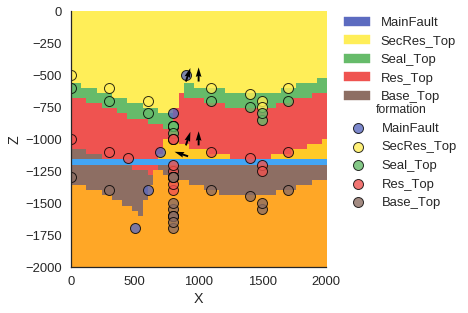

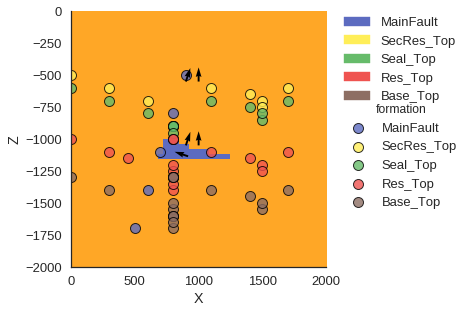

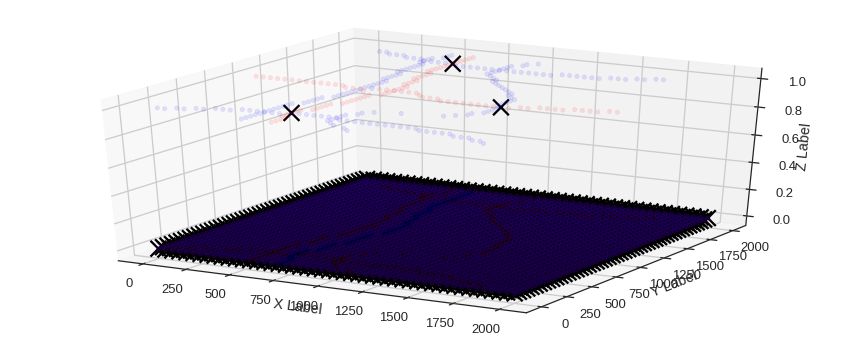

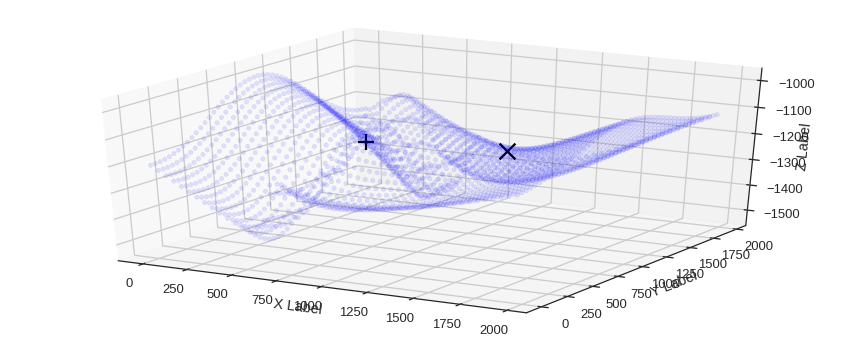

SPILL POINT: [ 1428.57141113   857.1428833  -1153.24971923]
Leak Point: [  612.24487305   938.7755127  -1191.11904385]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14272000.0 m³
 [-----------------63%---               ] 63 of 100 complete in 866.5 secZ variations top to bottom: 5.73653532794 -8.80447124743 7.08382205711 -5.81588591527
Fault offset variation: 118.779056151
Z variations top to bottom: 5.73653532794 -8.80447124743 7.08382205711 -23.0371052562
Fault offset variation: 118.779056151
Z variations top to bottom: 4.64461942605 -8.80447124743 7.08382205711 -5.81588591527
Fault offset variation: 118.779056151
Z variations top to bottom: 4.64461942605 -8.80447124743 16.1512832889 -5.81588591527
Fault offset variation: 118.779056151
Z variations top to bottom: 4.64461942605 -5.59263008413 7.08382205711 -5.81588591527
Fault offset variation: 118.779056151


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 5.388335177353154e-13
  ' condition number: {}'.format(rcond), RuntimeWarning)


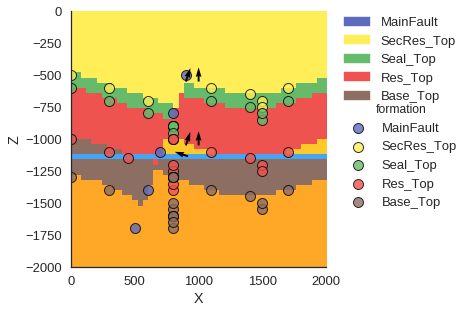

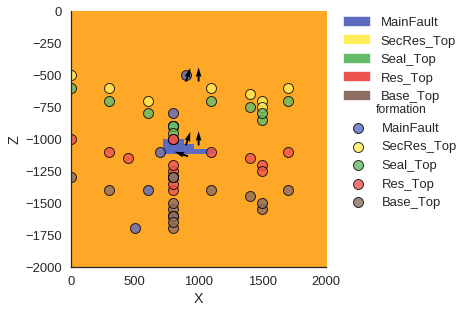

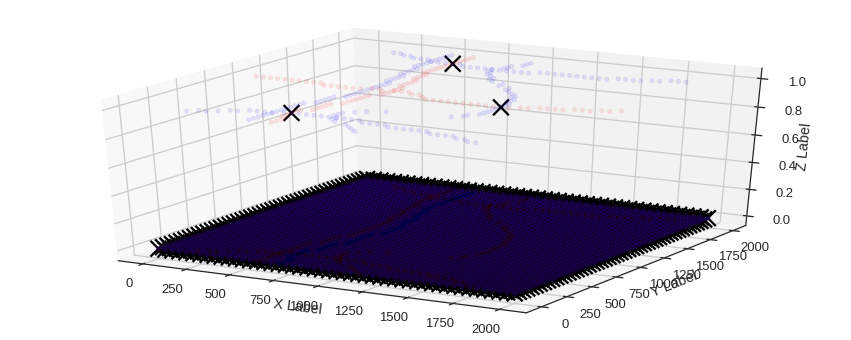

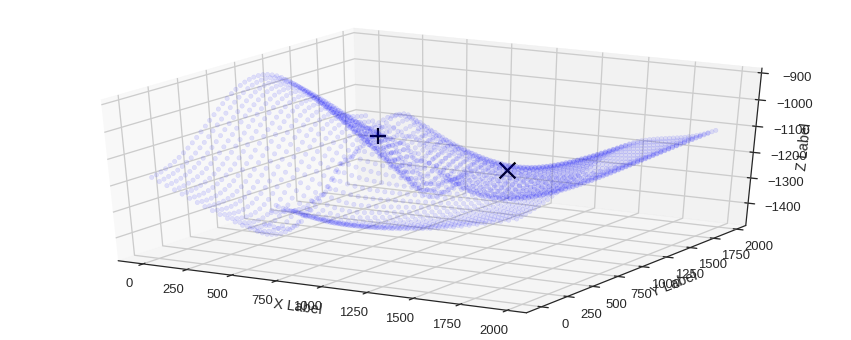

SPILL POINT: [ 1428.57141113   857.1428833  -1152.36552589]
Leak Point: [  653.06121826   979.59185791 -1097.79030916]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14656000.0 m³
 [-----------------64%----              ] 64 of 100 complete in 880.4 secZ variations top to bottom: 4.64461942605 -5.59263008413 7.08382205711 -5.81588591527
Fault offset variation: 142.679826495
Z variations top to bottom: 4.64461942605 -5.59263008413 7.08382205711 -60.1017353833
Fault offset variation: 142.679826495
Z variations top to bottom: 2.40433408571 -5.59263008413 7.08382205711 -60.1017353833
Fault offset variation: 142.679826495
Z variations top to bottom: 2.40433408571 -5.59263008413 9.15010481838 -60.1017353833
Fault offset variation: 142.679826495
Z variations top to bottom: 2.40433408571 -13.1299311079 7.08382205711 -60.1017353833
Fault offset variation: 142.679826495


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0330796048330895e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


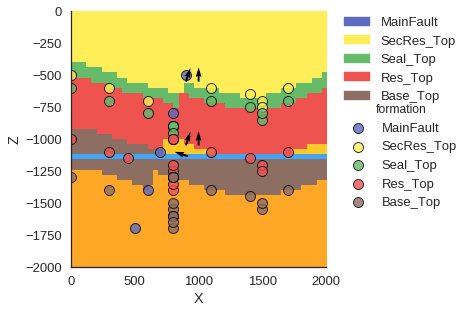

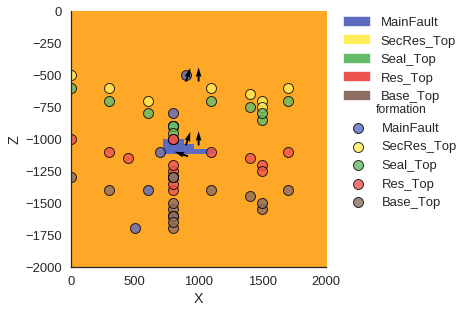

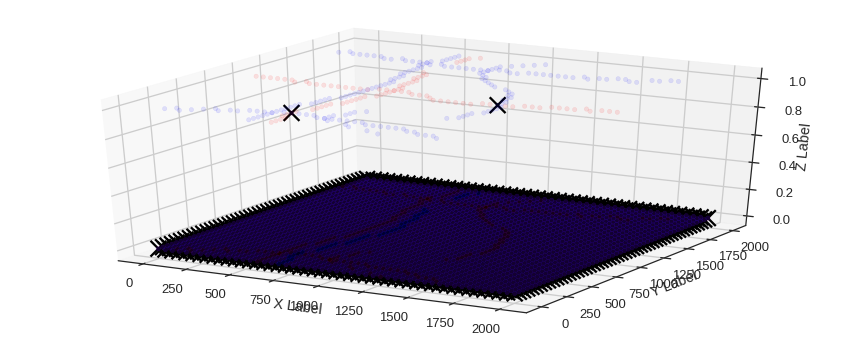

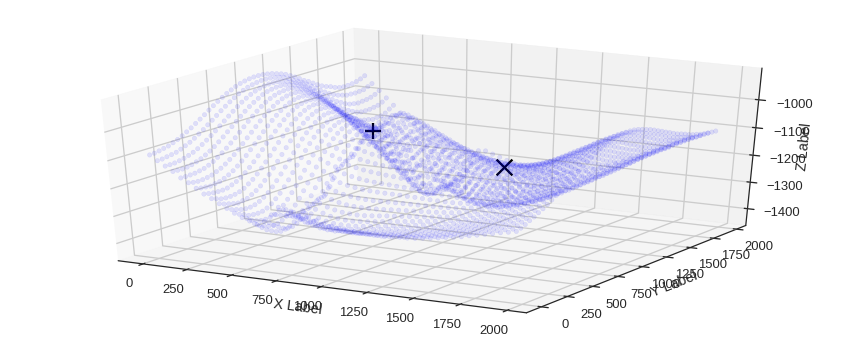

SPILL POINT: [ 1387.75512695   897.95916748 -1141.04185384]
Leak Point: [  653.06121826   938.7755127  -1071.81383612]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 1984000.0 m³
 [-----------------65%----              ] 65 of 100 complete in 894.1 secZ variations top to bottom: 2.40433408571 -13.1299311079 7.08382205711 -60.1017353833
Fault offset variation: 195.43886613
Z variations top to bottom: 2.40433408571 -13.1299311079 7.08382205711 -52.1592198782
Fault offset variation: 195.43886613
Z variations top to bottom: 0.233370687568 -13.1299311079 7.08382205711 -52.1592198782
Fault offset variation: 195.43886613
Z variations top to bottom: 0.233370687568 -13.1299311079 1.45852586967 -52.1592198782
Fault offset variation: 195.43886613
Z variations top to bottom: 0.233370687568 -15.9743637904 1.45852586967 -52.1592198782
Fault offset variation: 195.43886613


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.0652461323446853e-13
  ' condition number: {}'.format(rcond), RuntimeWarning)


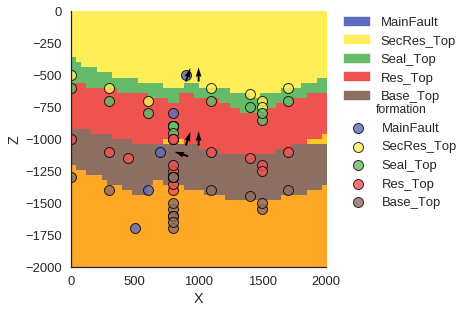

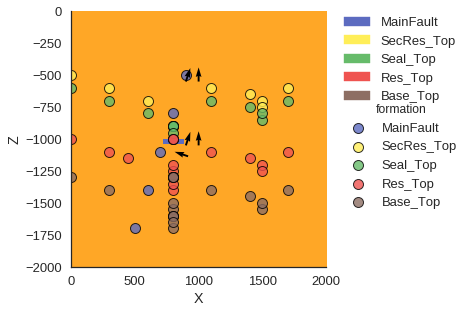

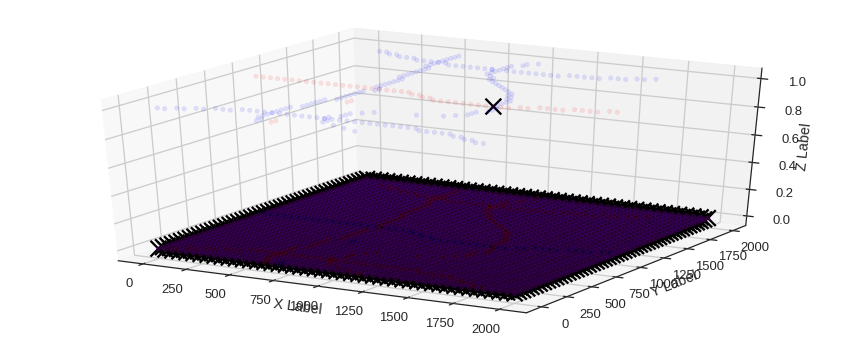

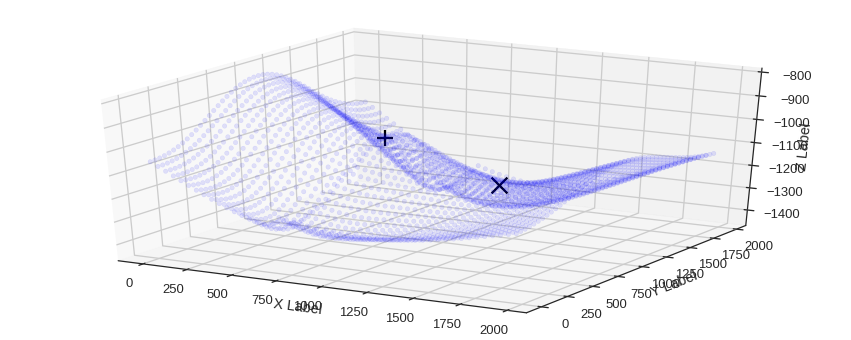

SPILL POINT: [ 1387.75512695   857.1428833  -1156.9040207 ]
Leak Point: [  693.87756348   979.59185791 -1033.07021788]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 12992000.0 m³
 [-----------------66%-----             ] 66 of 100 complete in 908.0 secZ variations top to bottom: 0.233370687568 -15.9743637904 1.45852586967 -52.1592198782
Fault offset variation: 194.783305
Z variations top to bottom: 0.233370687568 -15.9743637904 1.45852586967 -26.2834515477
Fault offset variation: 194.783305
Z variations top to bottom: 1.36903362326 -15.9743637904 1.45852586967 -26.2834515477
Fault offset variation: 194.783305
Z variations top to bottom: 1.36903362326 -15.9743637904 0.0260569313205 -26.2834515477
Fault offset variation: 194.783305
Z variations top to bottom: 1.36903362326 -14.8133542563 0.0260569313205 -26.2834515477
Fault offset variation: 194.783305


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0933011223776545e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


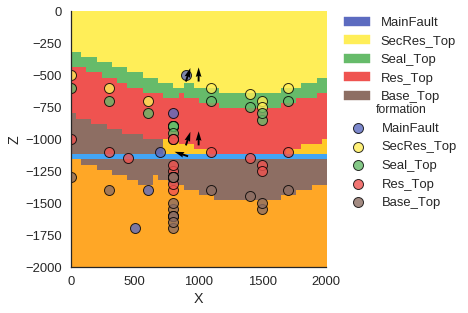

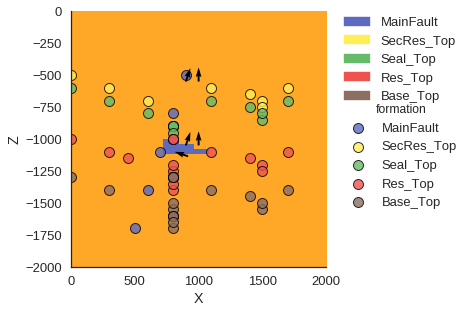

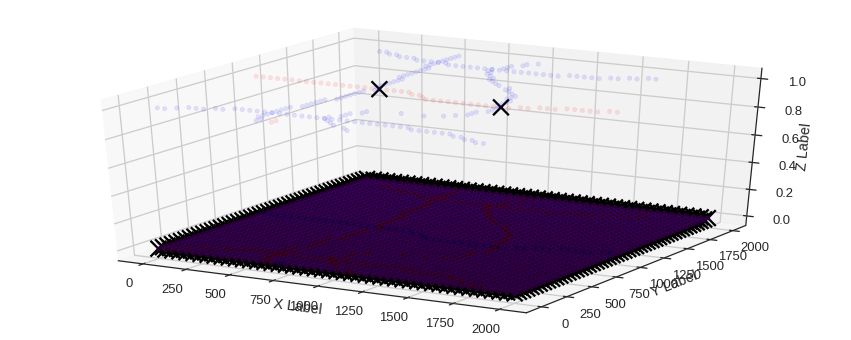

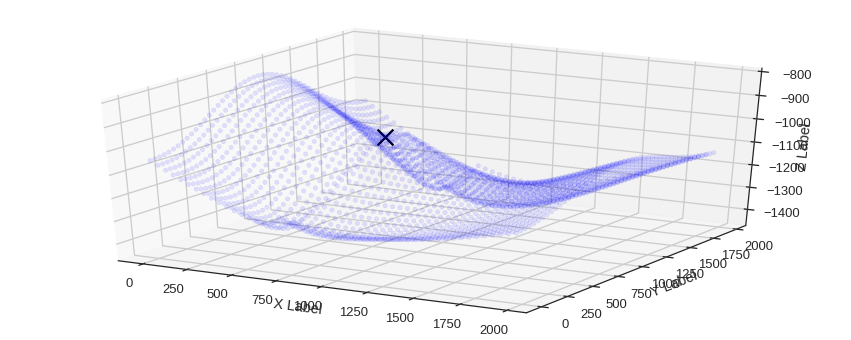

SPILL POINT: [  693.87756348   979.59185791 -1032.97579703]
No LEAK POINT found! So FULL LEAKAGE assumed!
Fault leak point above spill point.
...but fault sealing. Down to spill.
No res_formation above max_z!
Maximum reservoir volume: 0 m³
 [-----------------67%-----             ] 67 of 100 complete in 921.8 secZ variations top to bottom: 1.36903362326 -14.8133542563 0.0260569313205 -26.2834515477
Fault offset variation: 141.83365852
Z variations top to bottom: 1.36903362326 -14.8133542563 0.0260569313205 -34.391171429
Fault offset variation: 141.83365852
Z variations top to bottom: 0.88510735922 -14.8133542563 0.0260569313205 -34.391171429
Fault offset variation: 141.83365852
Z variations top to bottom: 0.88510735922 -14.8133542563 -5.30444729737 -34.391171429
Fault offset variation: 141.83365852
Z variations top to bottom: 0.88510735922 -18.4726115808 -5.30444729737 -34.391171429
Fault offset variation: 141.83365852


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 8.609916599122691e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


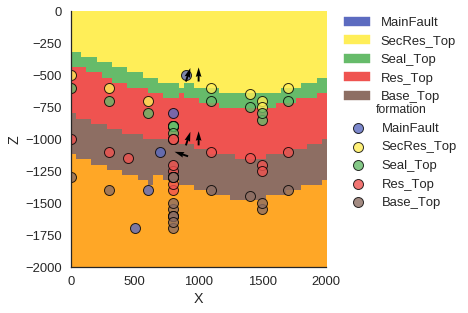

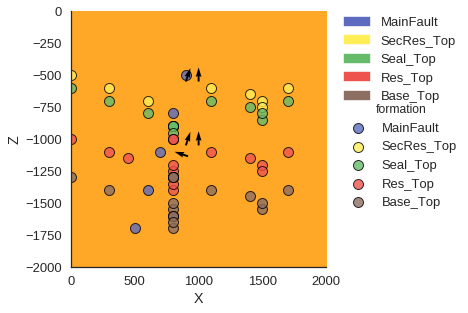

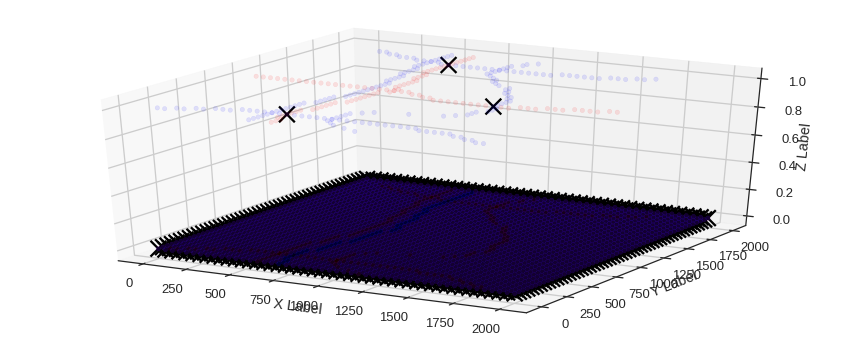

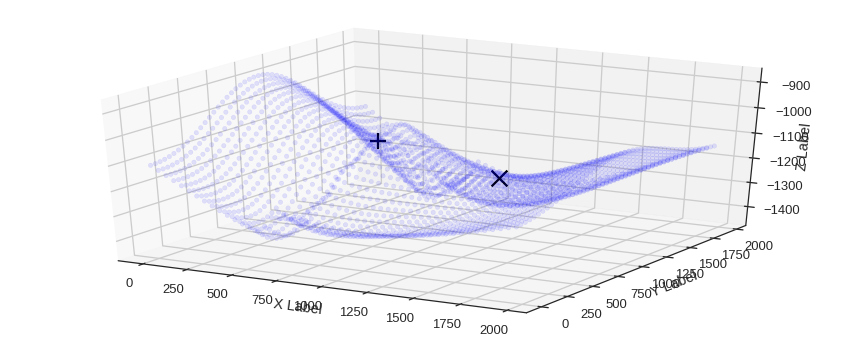

SPILL POINT: [ 1387.75512695   857.1428833  -1162.99766782]
Leak Point: [  653.06121826   979.59185791 -1092.49728698]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
TRAP FOUND, section: 13
Checking Section: 10
TRAP FOUND, section: 10
Checking Section: 14
Maximum reservoir volume: 4672000.0 m³
 [-----------------68%-----             ] 68 of 100 complete in 936.9 secZ variations top to bottom: 0.88510735922 -18.4726115808 -5.30444729737 -34.391171429
Fault offset variation: 129.010251876
Z variations top to bottom: 0.88510735922 -18.4726115808 -5.30444729737 -10.4951796961
Fault offset variation: 129.010251876
Z variations top to bottom: 2.7468242799 -18.4726115808 -5.30444729737 -10.4951796961
Fault offset variation: 129.010251876
Z variations top to bottom: 2.7468242799 -18.4726115808 -4.15419367631 -10.4951796961
Fault offset variation: 129.010251876
Z variations top to bottom: 2.7468242799 -18.8107656292 -4.15419367631 -10.4951796961
Faul

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0372832387678995e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


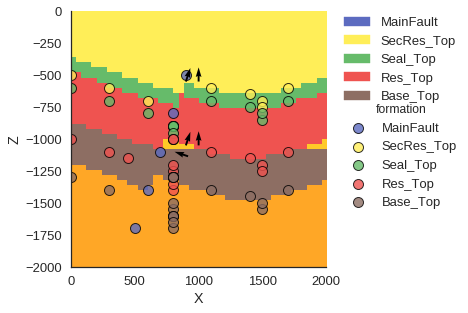

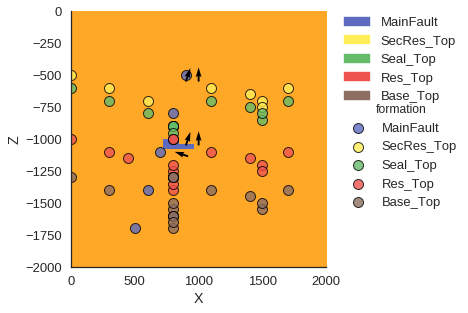

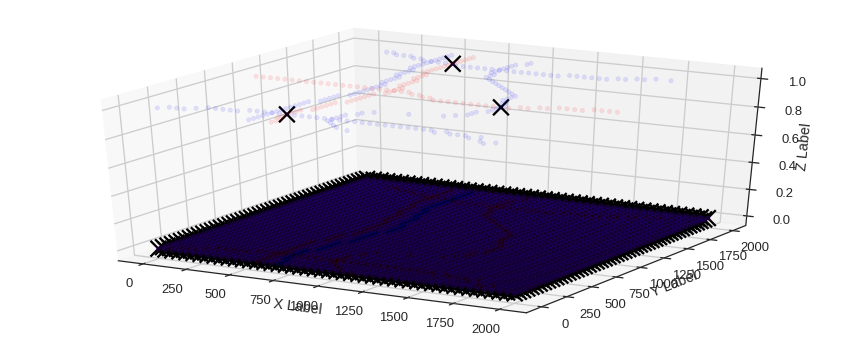

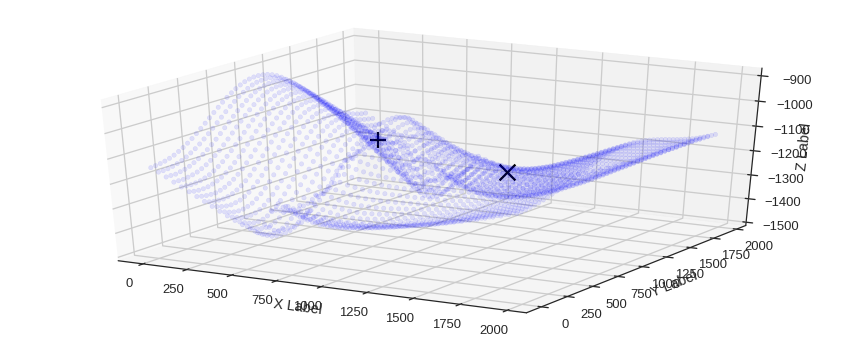

SPILL POINT: [ 1428.57141113   857.1428833  -1164.39674367]
Leak Point: [  653.06121826   979.59185791 -1116.08510446]
Fault leak point above spill point.
Cross-fault leakage. Down to leak.
Checking Section: 13
Checking Section: 10
TRAP FOUND, section: 10
Maximum reservoir volume: 4800000.0 m³
 [-----------------69%------            ] 69 of 100 complete in 950.9 secZ variations top to bottom: 2.7468242799 -18.8107656292 -4.15419367631 -10.4951796961
Fault offset variation: 73.0693117247
Z variations top to bottom: 2.7468242799 -18.8107656292 -4.15419367631 -41.450786692
Fault offset variation: 73.0693117247
Z variations top to bottom: 0.843093840236 -18.8107656292 -4.15419367631 -10.4951796961
Fault offset variation: 73.0693117247
Z variations top to bottom: 0.843093840236 -18.8107656292 -9.66833504773 -10.4951796961
Fault offset variation: 73.0693117247
Z variations top to bottom: 0.843093840236 -16.6377796809 -9.66833504773 -10.4951796961
Fault offset variation: 73.0693117247


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.921386749327019e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


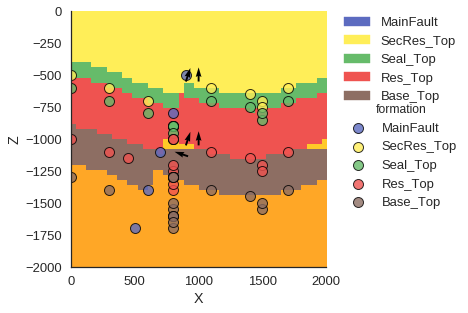

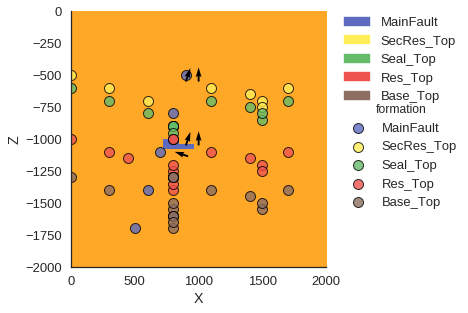

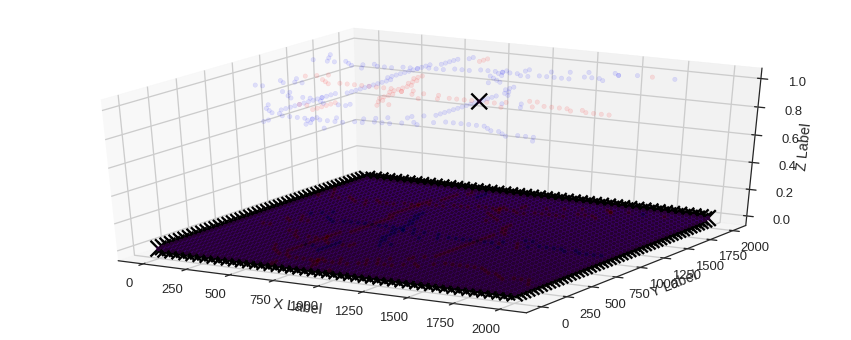

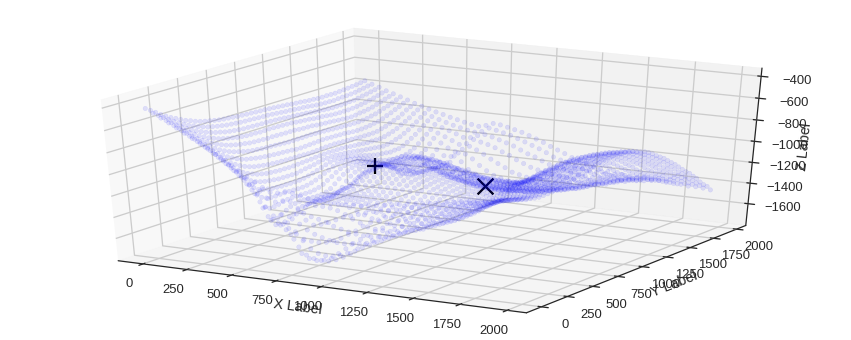

SPILL POINT: [ 1265.30615234   938.7755127  -1192.16323392]
Leak Point: [  612.24487305  1020.40814209 -1160.34366086]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 21
Checking Section: 20
TRAP FOUND, section: 20
Checking Section: 18
Maximum reservoir volume: 14976000.0 m³
 [-----------------70%------            ] 70 of 100 complete in 964.8 secZ variations top to bottom: 0.843093840236 -16.6377796809 -9.66833504773 -10.4951796961
Fault offset variation: 7.06815315769
Z variations top to bottom: 0.843093840236 -16.6377796809 -9.66833504773 2.6483477636
Fault offset variation: 7.06815315769
Z variations top to bottom: 1.89850597846 -16.6377796809 -9.66833504773 2.6483477636
Fault offset variation: 7.06815315769
Z variations top to bottom: 1.89850597846 -16.6377796809 -3.13627210685 2.6483477636
Fault offset variation: 7.06815315769
Z variations top to bottom: 1.89850597846 -14.1779450715 -3.13627210685 2.6483477636
Fault offset variation: 7.0

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.305296756098917e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


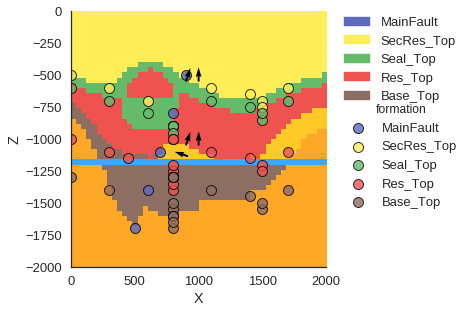

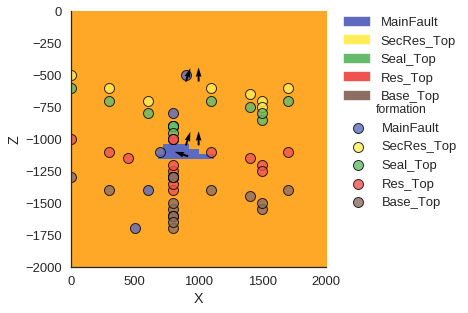

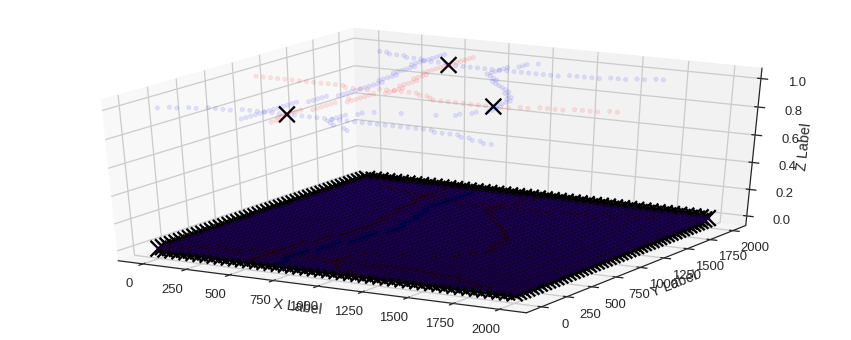

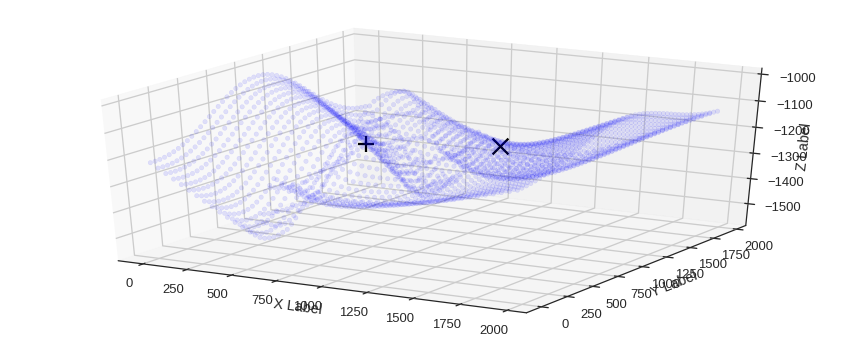

SPILL POINT: [ 1387.75512695   857.1428833  -1161.51971117]
Leak Point: [  612.24487305   938.7755127  -1222.85056962]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 11776000.0 m³
 [-----------------71%------            ] 71 of 100 complete in 978.6 secZ variations top to bottom: 1.89850597846 -14.1779450715 -3.13627210685 2.6483477636
Fault offset variation: -41.4546376816
Z variations top to bottom: 1.89850597846 -14.1779450715 -3.13627210685 33.4123393441
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.407002402365 -14.1779450715 -3.13627210685 33.4123393441
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.407002402365 -14.1779450715 8.27700191134 33.4123393441
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.407002402365 -8.89773325132 8.27700191134 33.4123393441
Fault offset variation: -41.4546376816


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 7.107205882844747e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


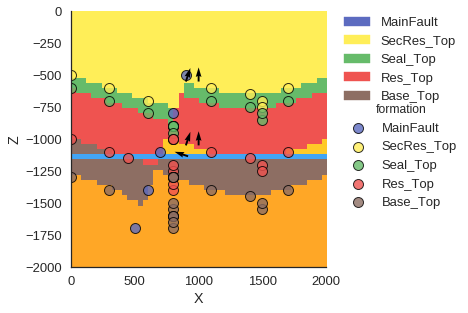

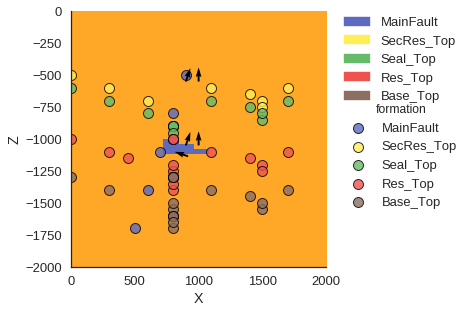

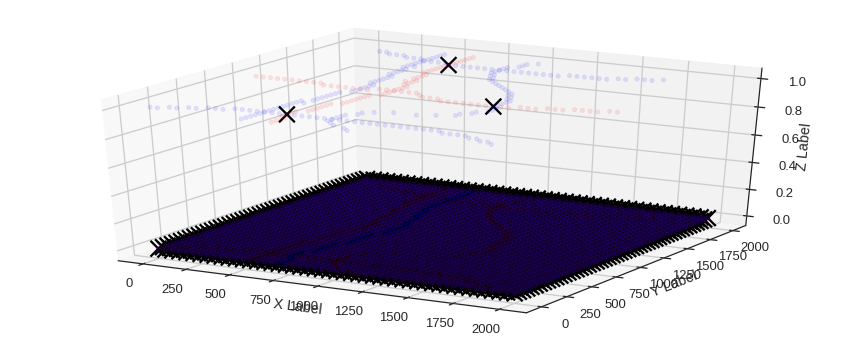

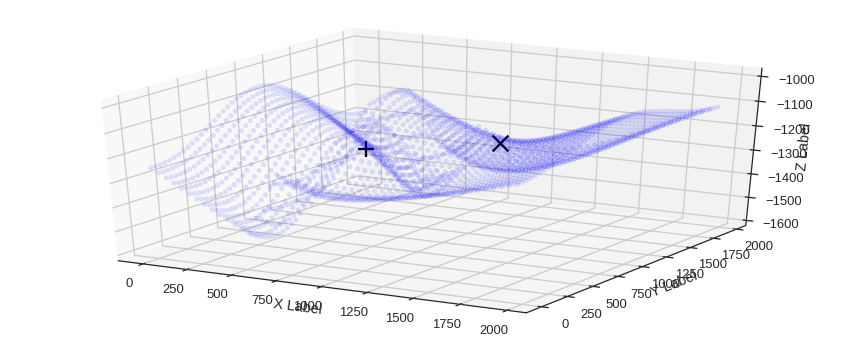

SPILL POINT: [ 1387.75512695   857.1428833  -1151.71950025]
Leak Point: [  612.24487305   938.7755127  -1252.84309098]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14336000.0 m³
 [-----------------72%-------           ] 72 of 100 complete in 992.6 secZ variations top to bottom: 0.407002402365 -8.89773325132 8.27700191134 33.4123393441
Fault offset variation: -71.7824184734
Z variations top to bottom: 0.407002402365 -8.89773325132 8.27700191134 -15.4223344729
Fault offset variation: -41.4546376816
Z variations top to bottom: 1.57634025976 -8.89773325132 8.27700191134 33.4123393441
Fault offset variation: -41.4546376816
Z variations top to bottom: 1.57634025976 -8.89773325132 5.5571781919 33.4123393441
Fault offset variation: -41.4546376816
Z variations top to bottom: 1.57634025976 -7.42672556102 5.5571781919 33.4123393441
Fault offset variation: -41.4546376816


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.1001568539791293e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


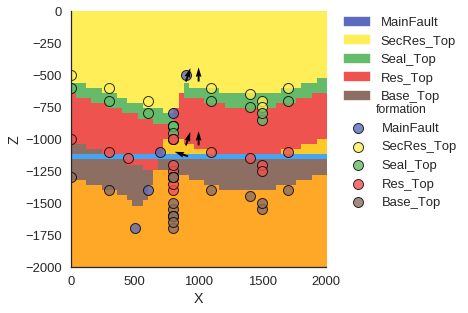

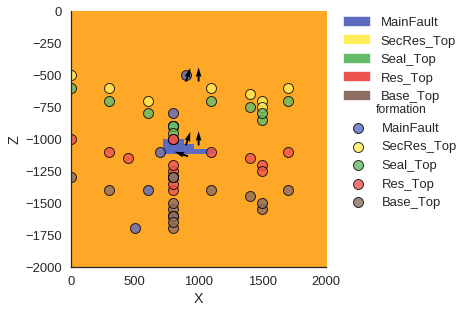

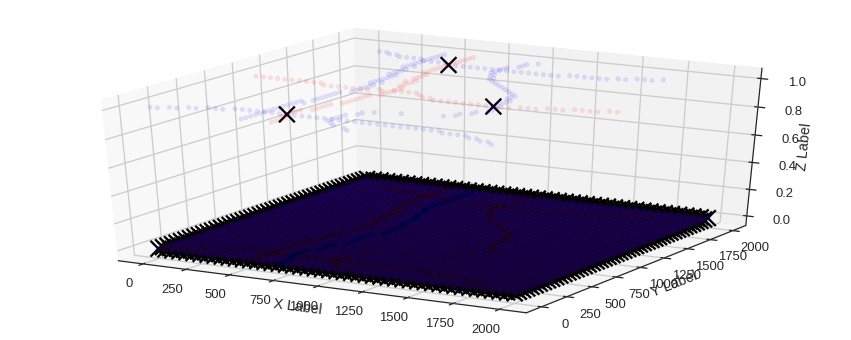

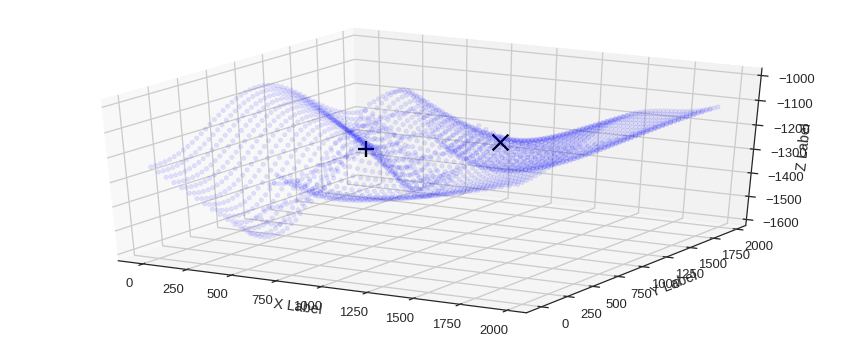

SPILL POINT: [ 1387.75512695   857.1428833  -1153.14101956]
Leak Point: [  612.24487305   938.7755127  -1256.72568816]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13504000.0 m³
 [-----------------73%-------           ] 73 of 100 complete in 1006.4 secZ variations top to bottom: 1.57634025976 -7.42672556102 5.5571781919 33.4123393441

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.0795386246330594e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)



Fault offset variation: -100.041387904
Z variations top to bottom: 1.57634025976 -7.42672556102 5.5571781919 22.6464828579
Fault offset variation: -41.4546376816
Z variations top to bottom: 2.36209603763 -7.42672556102 5.5571781919 22.6464828579
Fault offset variation: -41.4546376816
Z variations top to bottom: 2.36209603763 -7.42672556102 2.26996104854 22.6464828579
Fault offset variation: -41.4546376816
Z variations top to bottom: 2.36209603763 0.315880143426 2.26996104854 22.6464828579
Fault offset variation: -41.4546376816


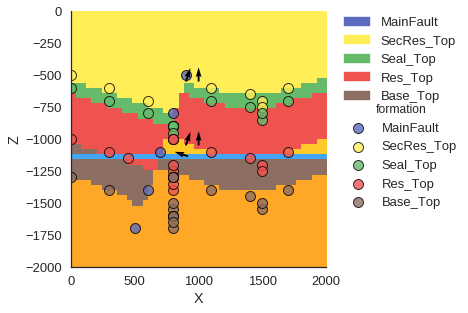

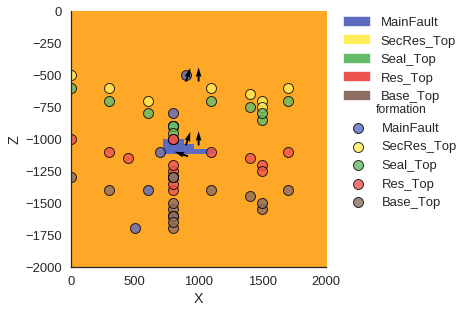

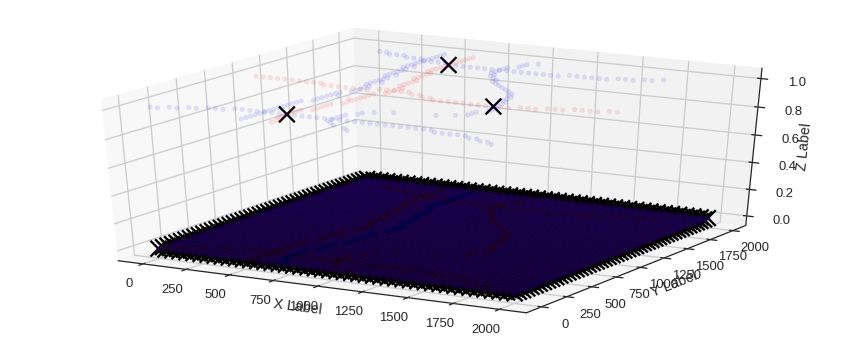

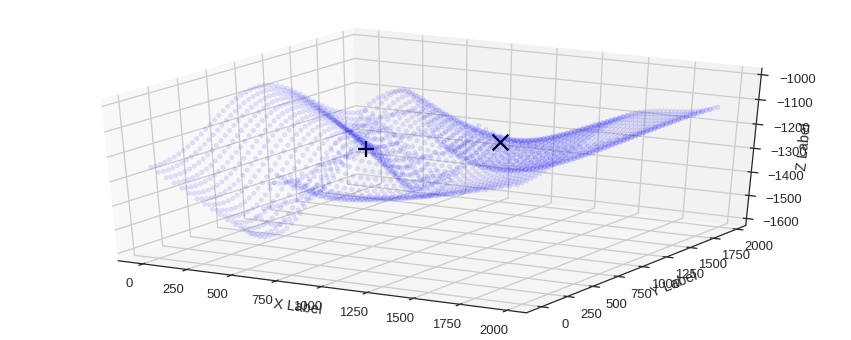

SPILL POINT: [ 1387.75512695   857.1428833  -1156.3295975 ]
Leak Point: [  612.24487305   938.7755127  -1258.93245174]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 12928000.0 m³
 [-----------------74%--------          ] 74 of 100 complete in 1020.5 secZ variations top to bottom: 2.36209603763 -7.42672556102 2.26996104854 22.6464828579
Fault offset variation: -85.7893573558
Z variations top to bottom: 2.36209603763 -7.42672556102 2.26996104854 26.9024631473
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.579786391455 -7.42672556102 2.26996104854 26.9024631473
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.579786391455 -7.42672556102 4.406902872 26.9024631473
Fault offset variation: -41.4546376816
Z variations top to bottom: 0.579786391455 -6.88156333964 4.406902872 26.9024631473
Fault offset variation: -41.4546376816


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.4054576079336467e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


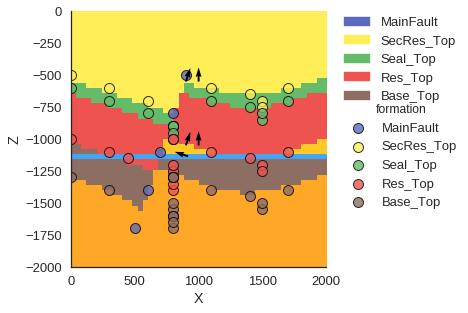

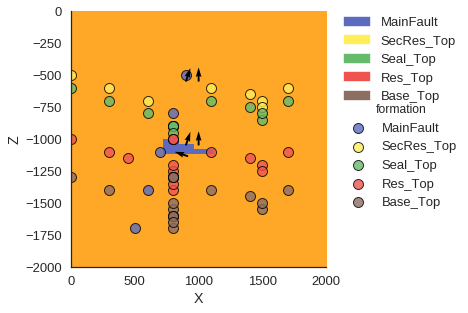

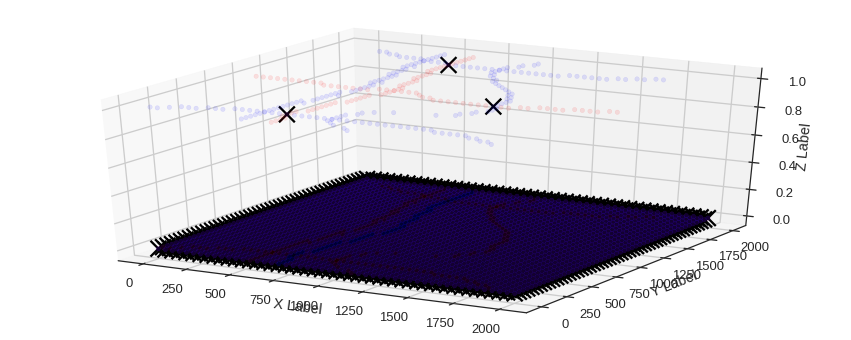

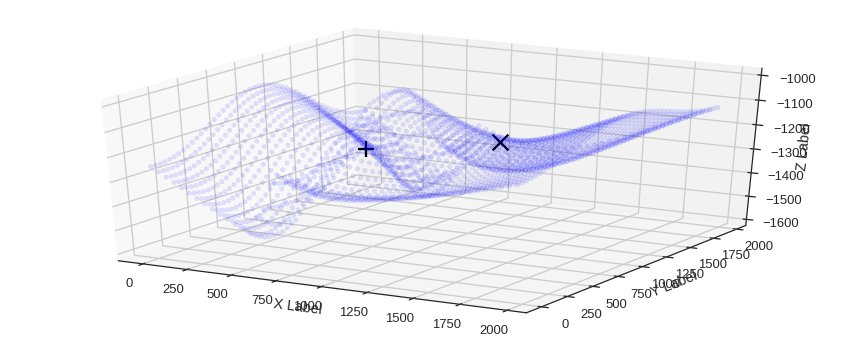

SPILL POINT: [ 1387.75512695   857.1428833  -1154.41970938]
Leak Point: [  612.24487305   938.7755127  -1256.87500332]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13376000.0 m³
 [-----------------75%--------          ] 75 of 100 complete in 1034.4 secZ variations top to bottom: 0.579786391455 -6.88156333964 4.406902872 26.9024631473
Fault offset variation: -36.2527761586
Z variations top to bottom: 0.579786391455 -6.88156333964 4.406902872 38.9172064811
Fault offset variation: -36.2527761586
Z variations top to bottom: 0.699755036898 -6.88156333964 4.406902872 38.9172064811
Fault offset variation: -36.2527761586
Z variations top to bottom: 0.699755036898 -6.88156333964 10.5541922736 38.9172064811
Fault offset variation: -36.2527761586
Z variations top to bottom: 0.699755036898 -5.86390741184 10.5541922736 38.9172064811
Fault offset variation: -36.2527761586


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.9404912912841504e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


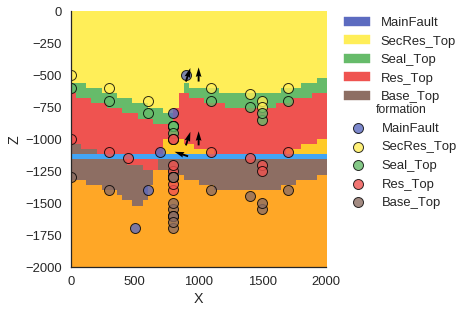

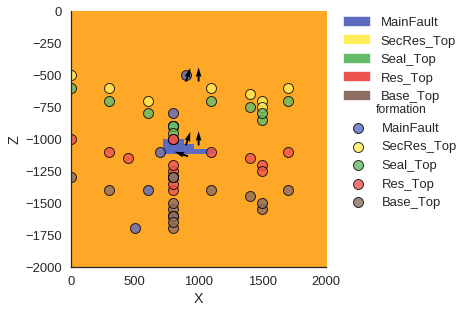

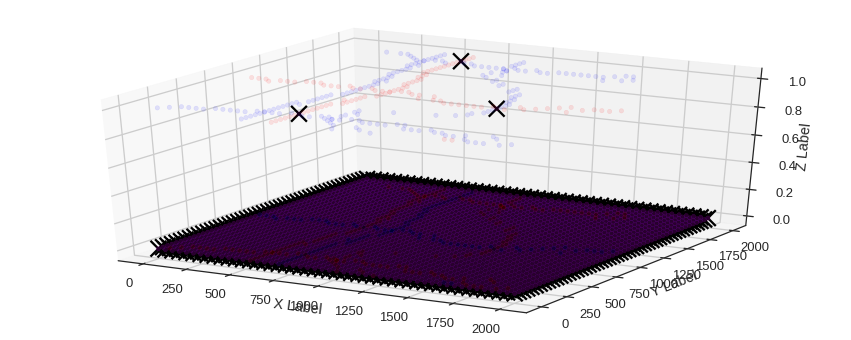

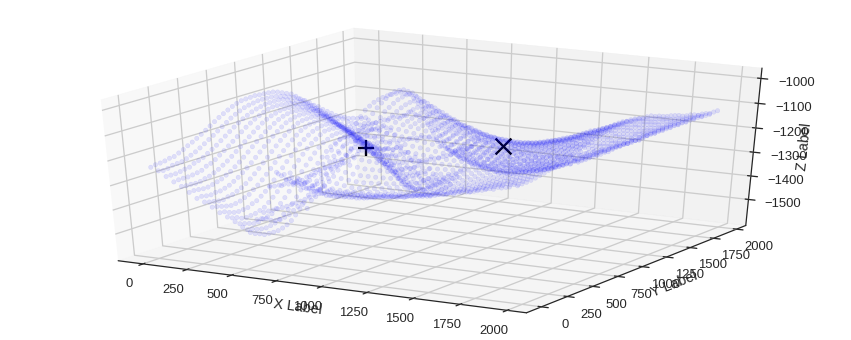

SPILL POINT: [ 1428.57141113   816.32653809 -1147.75555959]
Leak Point: [  612.24487305   938.7755127  -1240.68455069]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 15744000.0 m³
 [-----------------76%--------          ] 76 of 100 complete in 1048.2 secZ variations top to bottom: 0.699755036898 -5.86390741184 10.5541922736 38.9172064811
Fault offset variation: -100.34145921
Z variations top to bottom: 0.699755036898 -5.86390741184 10.5541922736 11.2470103821
Fault offset variation: -36.2527761586
Z variations top to bottom: 4.65495696362 -5.86390741184 10.5541922736 11.2470103821
Fault offset variation: -36.2527761586
Z variations top to bottom: 4.65495696362 -5.86390741184 7.63324146412 11.2470103821
Fault offset variation: -36.2527761586
Z variations top to bottom: 4.65495696362 -9.27563981983 7.63324146412 11.2470103821
Fault offset variation: -36.2527761586


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.2312728881489505e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


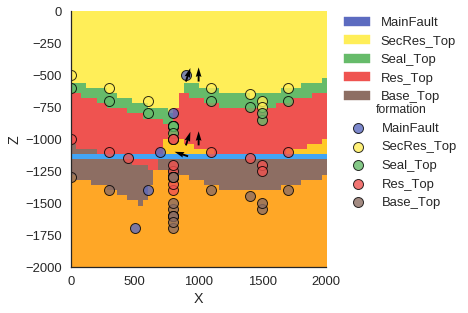

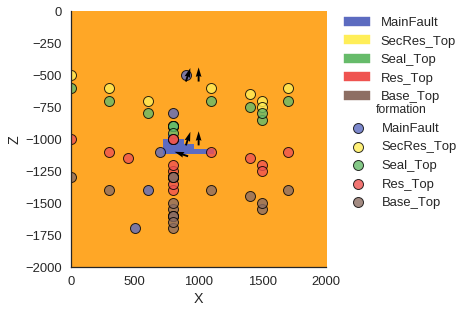

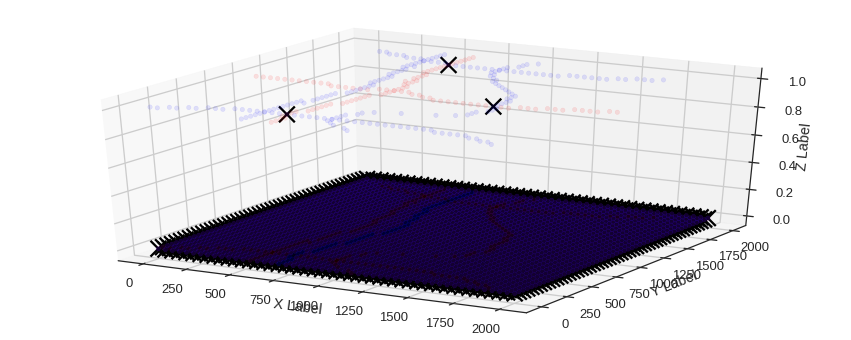

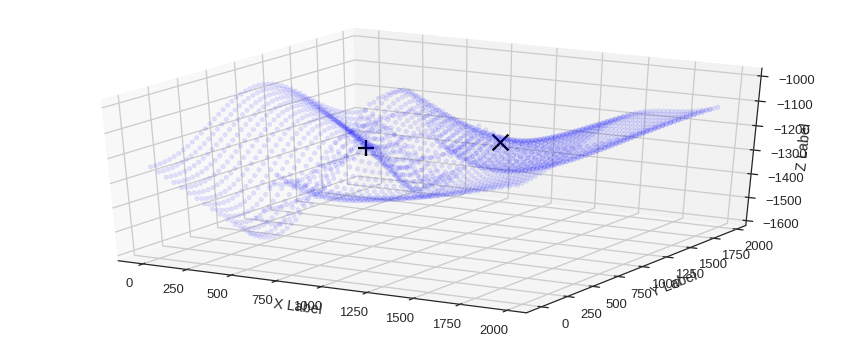

SPILL POINT: [ 1387.75512695   857.1428833  -1151.15962695]
Leak Point: [  612.24487305   938.7755127  -1250.249594  ]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14144000.0 m³
 [-----------------77%---------         ] 77 of 100 complete in 1063.1 secZ variations top to bottom: 4.65495696362 -9.27563981983 7.63324146412 11.2470103821
Fault offset variation: -33.0227262006
Z variations top to bottom: 4.65495696362 -9.27563981983 7.63324146412 -47.5441448022
Fault offset variation: -33.0227262006
Z variations top to bottom: 4.53117696163 -9.27563981983 7.63324146412 11.2470103821
Fault offset variation: -33.0227262006
Z variations top to bottom: 4.53117696163 -9.27563981983 4.6070025786 11.2470103821
Fault offset variation: -33.0227262006
Z variations top to bottom: 4.53117696163 -5.82700516583 4.6070025786 11.2470103821
Fault offset variation: -33.0227262006


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.6639287997731742e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


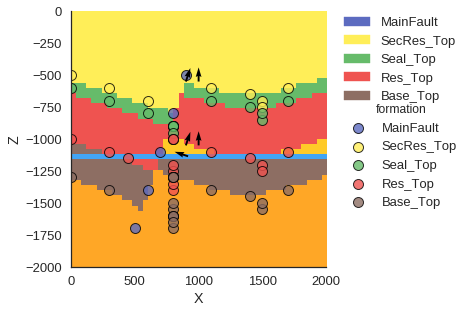

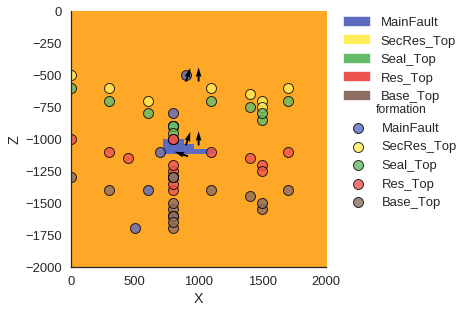

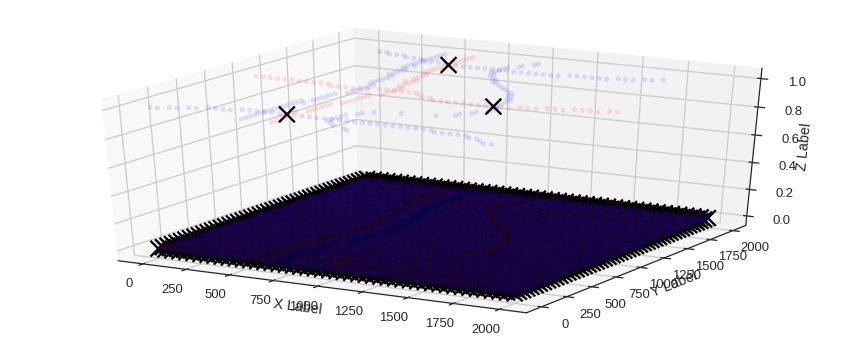

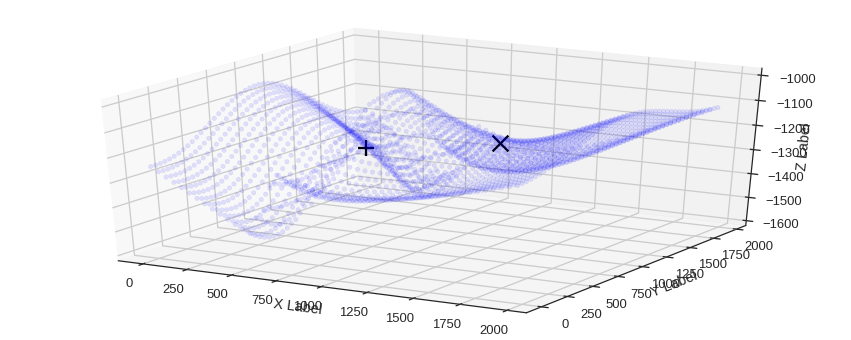

SPILL POINT: [ 1387.75512695   857.1428833  -1154.0227847 ]
Leak Point: [  612.24487305   938.7755127  -1250.49765126]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13440000.0 m³
 [-----------------78%---------         ] 78 of 100 complete in 1076.9 secZ variations top to bottom: 4.53117696163 -9.27563981983 4.6070025786 11.2470103821
Fault offset variation: -108.14633554
Z variations top to bottom: 4.53117696163 -9.27563981983 4.6070025786 21.800189535
Fault offset variation: -108.14633554
Z variations top to bottom: 7.32095142334 -9.27563981983 4.6070025786 21.800189535
Fault offset variation: -108.14633554
Z variations top to bottom: 7.32095142334 -9.27563981983 6.40031200114 21.800189535
Fault offset variation: -108.14633554
Z variations top to bottom: 7.32095142334 -9.33246911487 4.6070025786 21.800189535
Fault offset variation: -108.14633554


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.4846765310216892e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


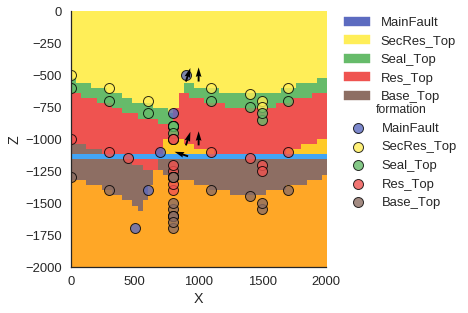

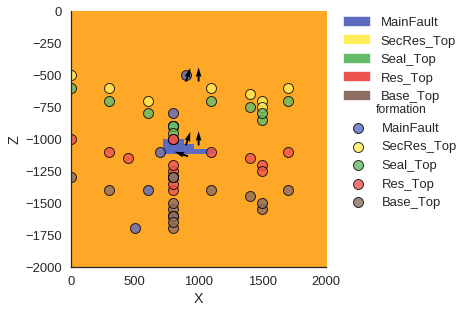

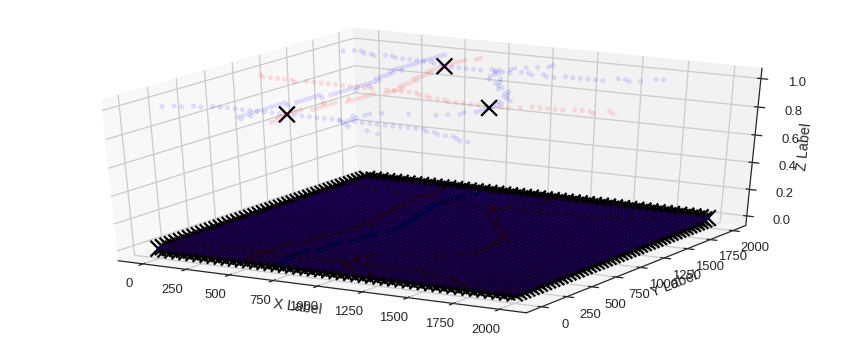

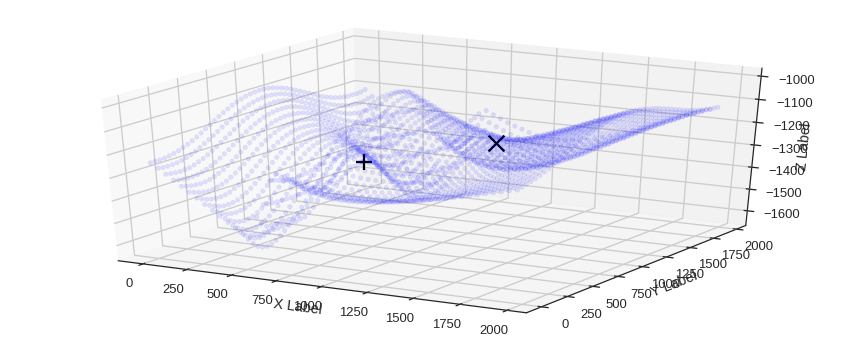

SPILL POINT: [ 1387.75512695   816.32653809 -1159.21590983]
Leak Point: [  571.42858887   979.59185791 -1337.21915618]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 22
Checking Section: 19
TRAP FOUND, section: 19
Maximum reservoir volume: 12352000.0 m³
 [-----------------79%----------        ] 79 of 100 complete in 1090.7 secZ variations top to bottom: 7.32095142334 -9.33246911487 4.6070025786 21.800189535
Fault offset variation: -43.7170300779
Z variations top to bottom: 7.32095142334 -9.33246911487 4.6070025786 -21.7783968364
Fault offset variation: -43.7170300779
Z variations top to bottom: 6.00237995029 -9.33246911487 4.6070025786 -21.7783968364
Fault offset variation: -43.7170300779
Z variations top to bottom: 6.00237995029 -9.33246911487 9.55312725725 -21.7783968364
Fault offset variation: -43.7170300779
Z variations top to bottom: 6.00237995029 -7.71129703565 9.55312725725 -21.7783968364
Fault offset variation: -43.7170300779


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.431189782107882e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


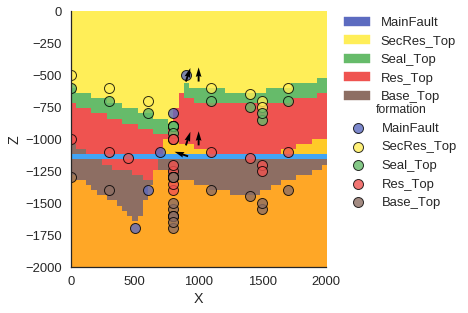

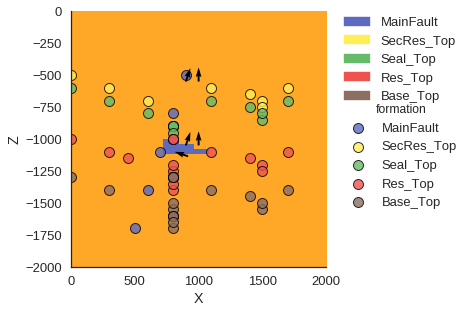

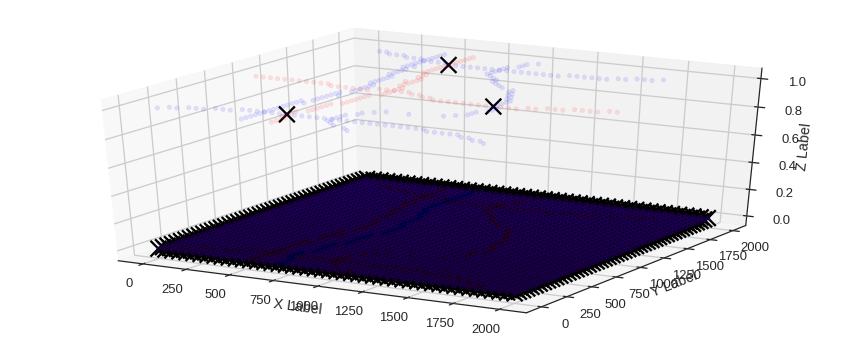

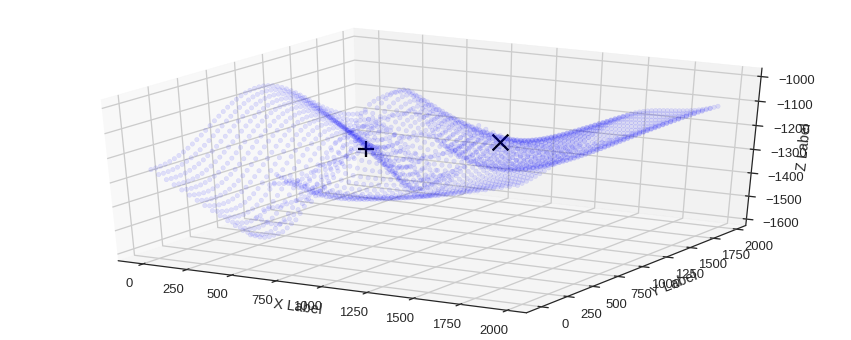

SPILL POINT: [ 1387.75512695   857.1428833  -1150.33467936]
Leak Point: [  612.24487305   938.7755127  -1253.12744033]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 21
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
TRAP FOUND, section: 20
Maximum reservoir volume: 14912000.0 m³
 [-----------------80%----------        ] 80 of 100 complete in 1104.5 secZ variations top to bottom: 6.00237995029 -7.71129703565 9.55312725725 -21.7783968364
Fault offset variation: -51.5446413669
Z variations top to bottom: 6.00237995029 -7.71129703565 9.55312725725 -74.648600975
Fault offset variation: -51.5446413669
Z variations top to bottom: 7.43494041921 -7.71129703565 9.55312725725 -21.7783968364
Fault offset variation: -51.5446413669
Z variations top to bottom: 7.43494041921 -7.71129703565 23.1614173338 -21.7783968364
Fault offset variation: -51.5446413669
Z variations top to bottom: 7.43494041921 -9.86163496099 9.55312725725 -21.7783968364
Fault offset

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 5.034037423023996e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


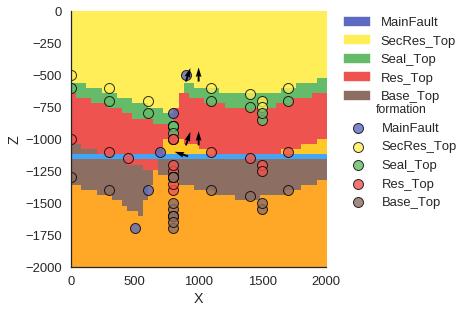

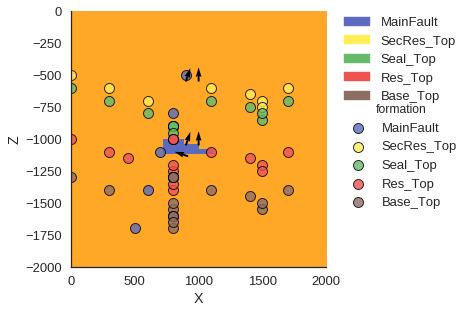

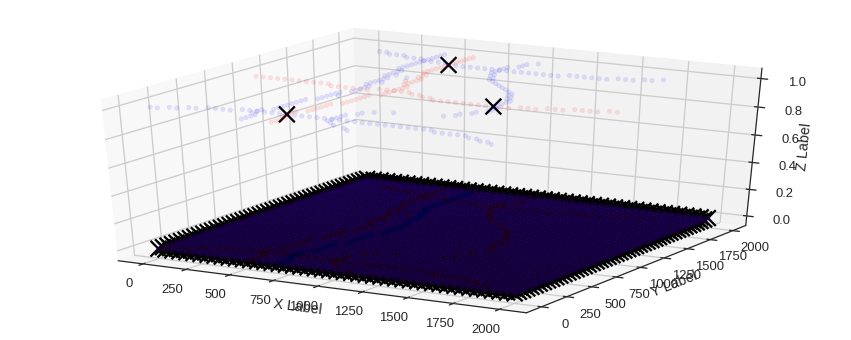

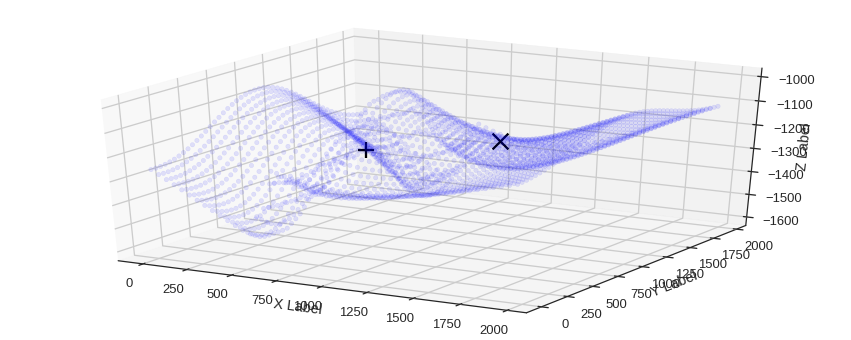

SPILL POINT: [ 1387.75512695   857.1428833  -1149.22676035]
Leak Point: [  612.24487305   938.7755127  -1260.23169046]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 14848000.0 m³
 [-----------------81%----------        ] 81 of 100 complete in 1119.8 secZ variations top to bottom: 7.43494041921 -9.86163496099 9.55312725725 -21.7783968364
Fault offset variation: 31.2750187991
Z variations top to bottom: 7.43494041921 -9.86163496099 9.55312725725 -83.2769177164
Fault offset variation: 31.2750187991
Z variations top to bottom: 7.20312515043 -9.86163496099 9.55312725725 -21.7783968364
Fault offset variation: 31.2750187991
Z variations top to bottom: 7.20312515043 -9.86163496099 0.233242464081 -21.7783968364
Fault offset variation: 31.2750187991
Z variations top to bottom: 7.20312515043 -9.45000957898 0.233242464081 -21.7783968364
Fault offset variation: 31.2750187991


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.4017461630609915e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


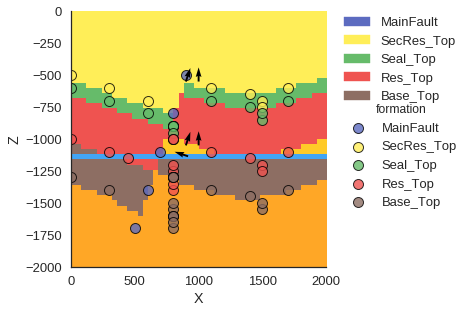

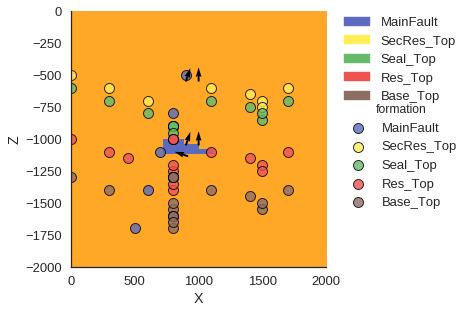

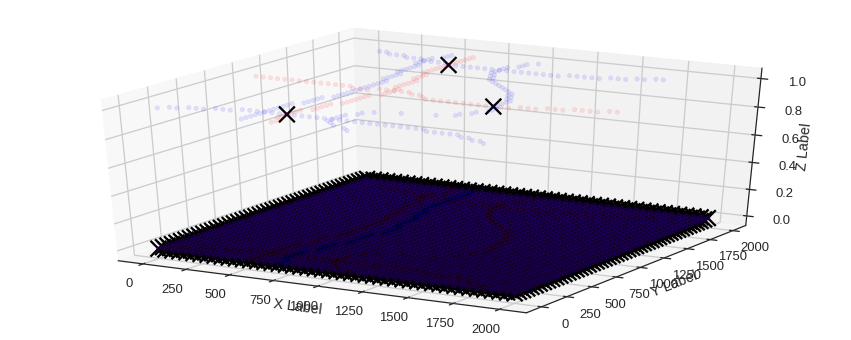

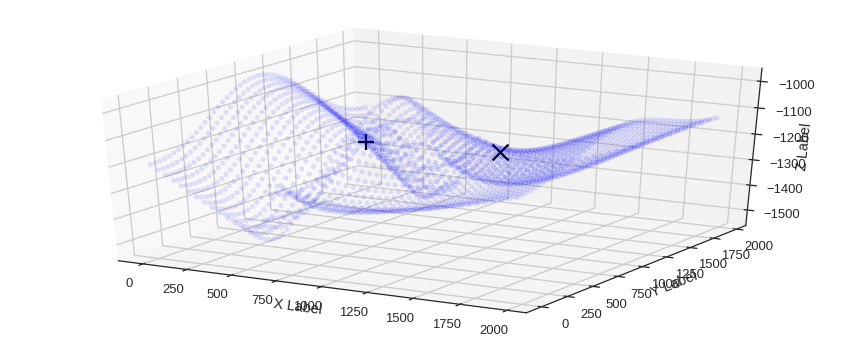

SPILL POINT: [ 1387.75512695   857.1428833  -1158.24928234]
Leak Point: [  612.24487305   938.7755127  -1192.1124335 ]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 12544000.0 m³
 [-----------------82%-----------       ] 82 of 100 complete in 1133.6 secZ variations top to bottom: 7.20312515043 -9.45000957898 0.233242464081 -21.7783968364
Fault offset variation: 42.3819034377
Z variations top to bottom: 7.20312515043 -9.45000957898 0.233242464081 20.0898246828
Fault offset variation: 42.3819034377
Z variations top to bottom: 7.86156558527 -9.45000957898 0.233242464081 20.0898246828
Fault offset variation: 42.3819034377
Z variations top to bottom: 7.86156558527 -9.45000957898 -5.56003566404 20.0898246828
Fault offset variation: 42.3819034377
Z variations top to bottom: 7.86156558527 -14.529548567 -5.56003566404 20.0898246828
Fault offset variation: 42.3819034377


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.2147842627652228e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


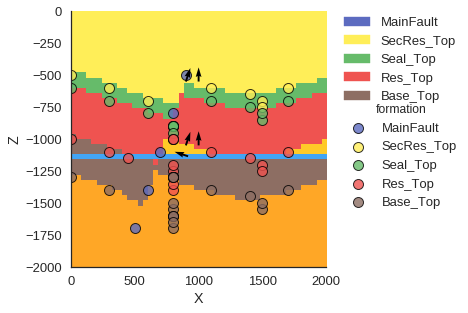

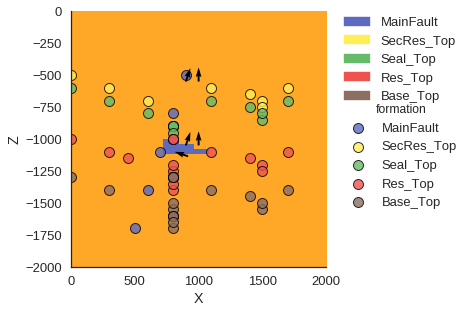

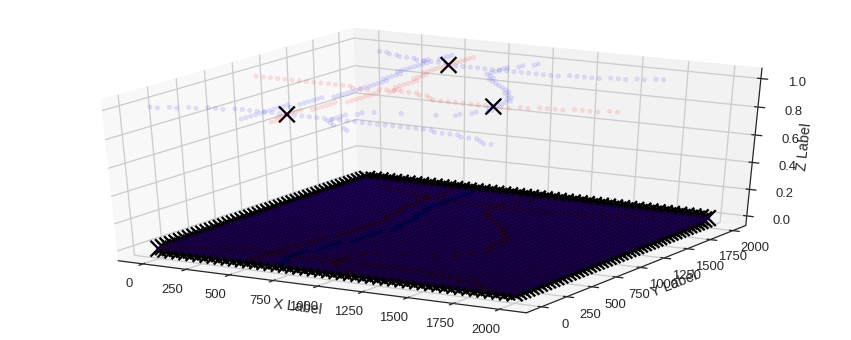

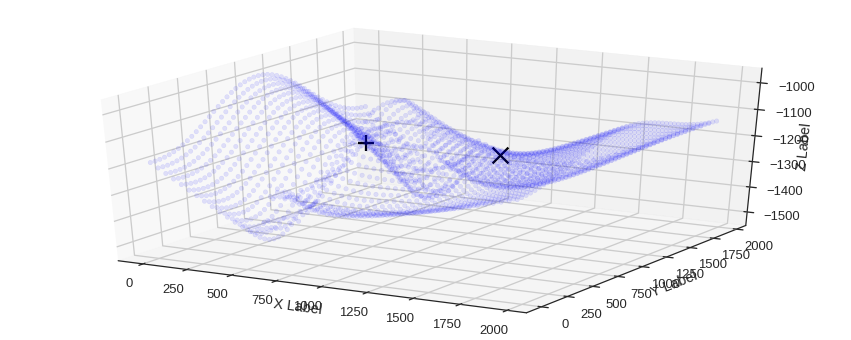

SPILL POINT: [ 1387.75512695   857.1428833  -1163.99351582]
Leak Point: [  612.24487305   938.7755127  -1188.73434987]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 24832000.0 m³
 [-----------------83%-----------       ] 83 of 100 complete in 1147.4 secZ variations top to bottom: 7.86156558527 -14.529548567 -5.56003566404 20.0898246828
Fault offset variation: 51.7686187488
Z variations top to bottom: 7.86156558527 -14.529548567 -5.56003566404 33.5408186605
Fault offset variation: 51.7686187488
Z variations top to bottom: 8.21937687757 -14.529548567 -5.56003566404 33.5408186605
Fault offset variation: 51.7686187488
Z variations top to bottom: 8.21937687757 -14.529548567 -8.00812572884 33.5408186605
Fault offset variation: 51.7686187488
Z variations top to bottom: 8.21937687757 -14.6440106652 -8.00812572884 33.5408186605
Fault offset variation: 51.7686187488


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.1156813320423176e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


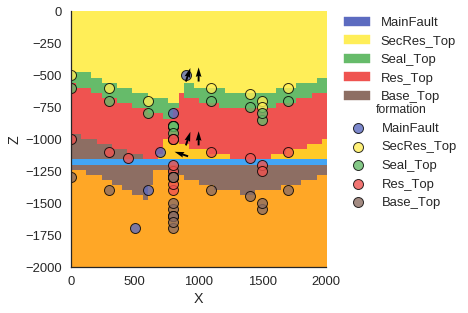

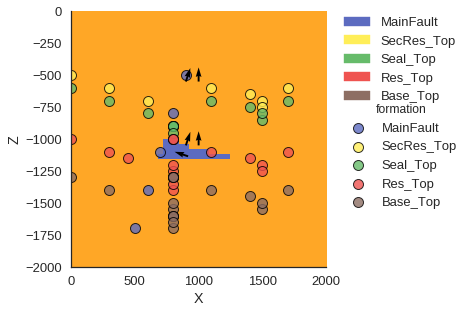

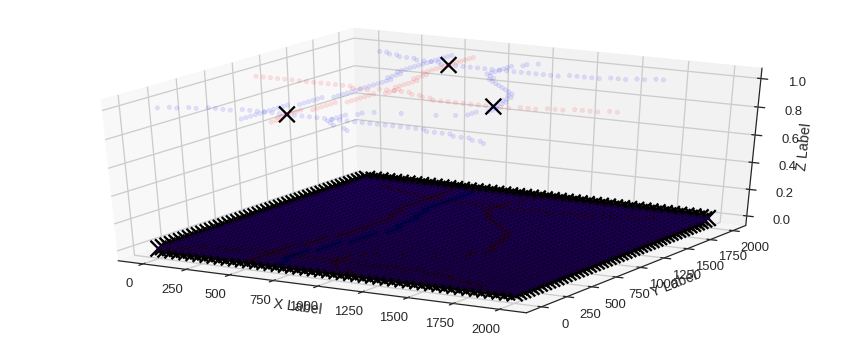

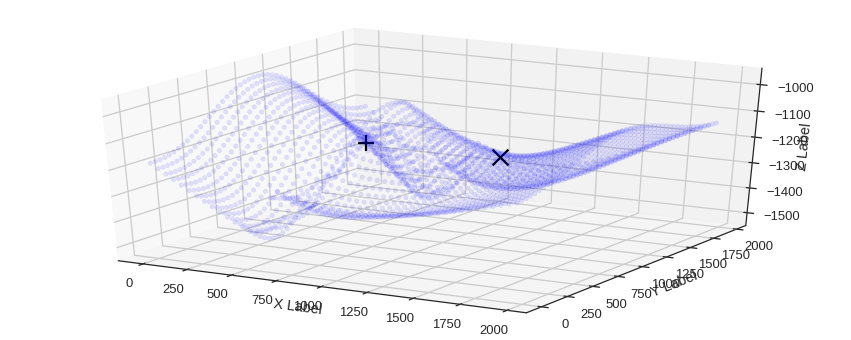

SPILL POINT: [ 1387.75512695   857.1428833  -1166.56306771]
Leak Point: [  612.24487305   938.7755127  -1181.84635338]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 23680000.0 m³
 [-----------------84%-----------       ] 84 of 100 complete in 1161.3 secZ variations top to bottom: 8.21937687757 -14.6440106652 -8.00812572884 33.5408186605
Fault offset variation: 94.2929866905
Z variations top to bottom: 8.21937687757 -14.6440106652 -8.00812572884 21.7484401494
Fault offset variation: 94.2929866905
Z variations top to bottom: 8.11861279958 -14.6440106652 -8.00812572884 21.7484401494
Fault offset variation: 94.2929866905
Z variations top to bottom: 8.11861279958 -14.6440106652 -23.4136355461 21.7484401494
Fault offset variation: 94.2929866905
Z variations top to bottom: 8.11861279958 -20.3465113778 -23.4136355461 21.7484401494
Fault offset variation: 94.2929866905


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.454914185625993e-13
  ' condition number: {}'.format(rcond), RuntimeWarning)


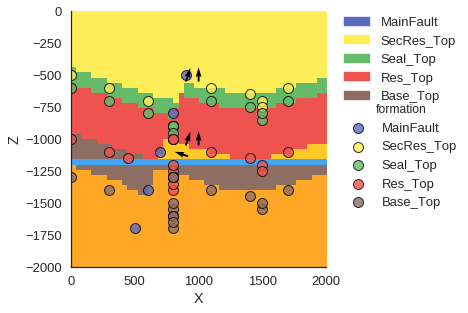

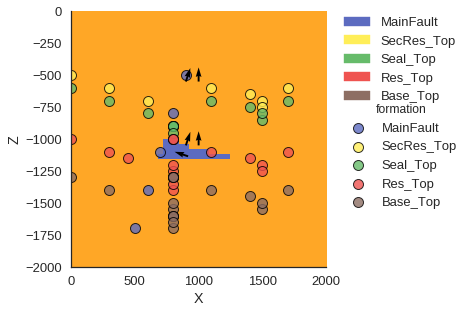

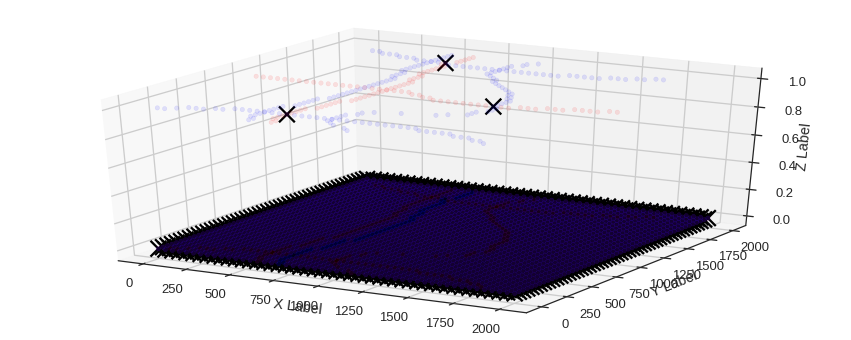

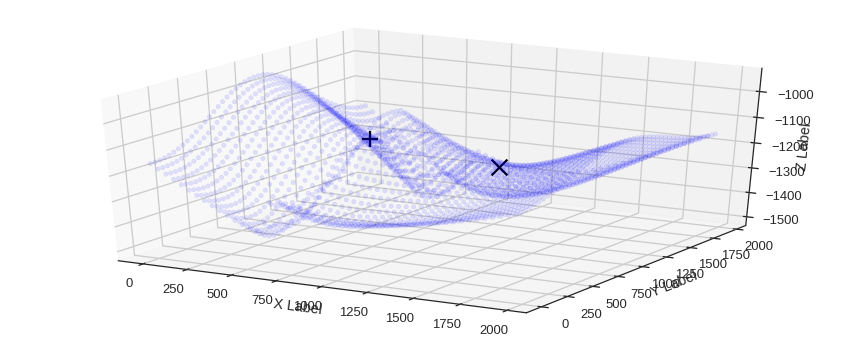

SPILL POINT: [ 1387.75512695   857.1428833  -1180.89063908]
Leak Point: [  612.24487305   979.59185791 -1151.24370731]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 18560000.0 m³
 [-----------------85%------------      ] 85 of 100 complete in 1175.1 secZ variations top to bottom: 8.11861279958 -14.6440106652 -23.4136355461 21.7484401494
Fault offset variation: 117.753011701
Z variations top to bottom: 8.11861279958 -14.6440106652 -23.4136355461 -3.69119047155
Fault offset variation: 117.753011701
Z variations top to bottom: 8.49728838976 -14.6440106652 -23.4136355461 -3.69119047155
Fault offset variation: 117.753011701
Z variations top to bottom: 8.49728838976 -14.6440106652 -20.9381749232 -3.69119047155
Fault offset variation: 117.753011701
Z variations top to bottom: 8.49728838976 -17.5971918726 -20.9381749232 -3.69119047155
Fault offset variation: 117.753011701


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 7.272732458309724e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


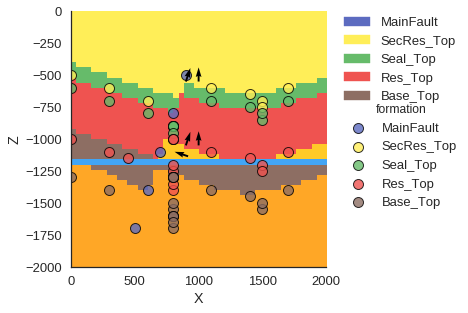

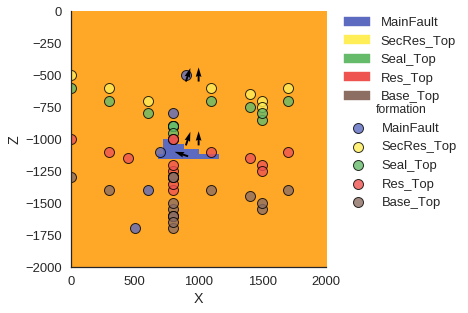

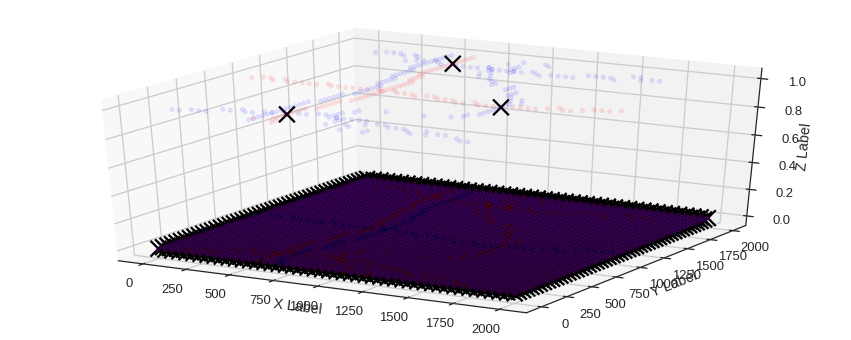

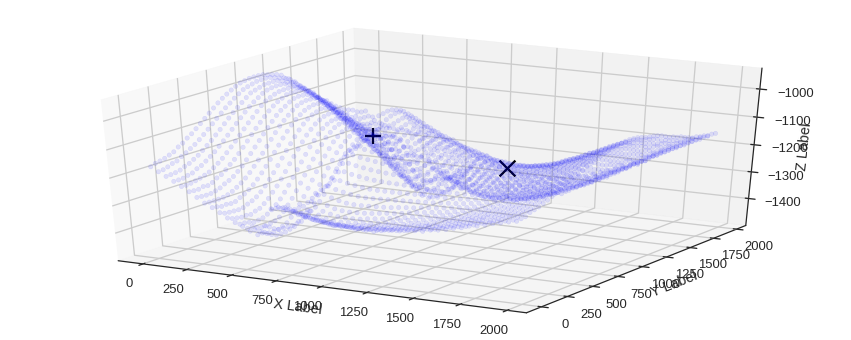

SPILL POINT: [ 1428.57141113   857.1428833  -1176.42699928]
Leak Point: [  653.06121826   938.7755127  -1126.73818227]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 21056000.0 m³
 [-----------------86%------------      ] 86 of 100 complete in 1190.1 secZ variations top to bottom: 8.49728838976 -17.5971918726 -20.9381749232 -3.69119047155
Fault offset variation: 113.262177072
Z variations top to bottom: 8.49728838976 -17.5971918726 -20.9381749232 2.23642461571
Fault offset variation: 113.262177072
Z variations top to bottom: 8.1292258132 -17.5971918726 -20.9381749232 2.23642461571
Fault offset variation: 113.262177072
Z variations top to bottom: 8.1292258132 -17.5971918726 -30.6011456739 2.23642461571
Fault offset variation: 113.262177072
Z variations top to bottom: 8.1292258132 -9.55054293696 -30.6011456739 2.23642461571
Fault offset variation: 113.262177072


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 9.624327376722697e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


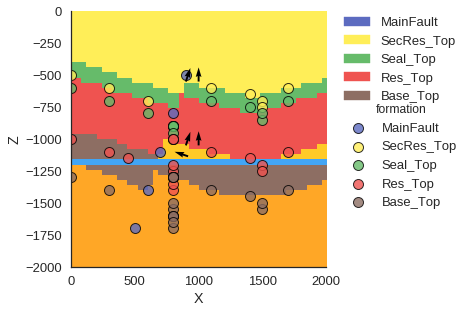

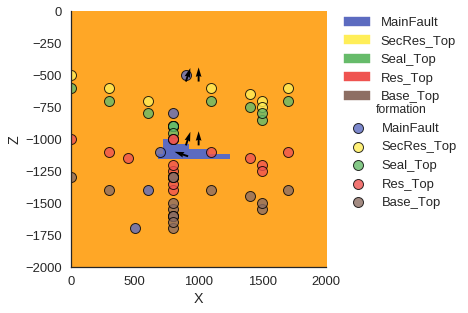

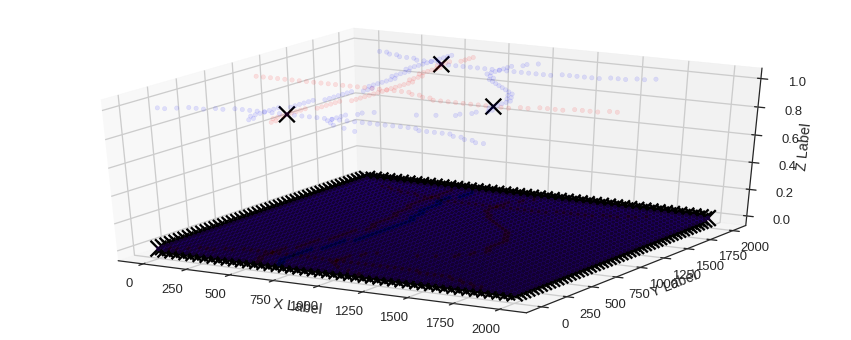

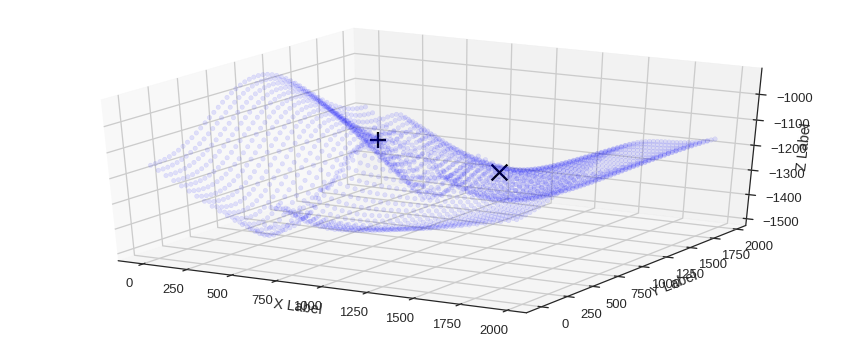

SPILL POINT: [ 1387.75512695   857.1428833  -1188.60444613]
Leak Point: [  653.06121826   979.59185791 -1141.38175763]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 16384000.0 m³
 [-----------------87%-------------     ] 87 of 100 complete in 1203.8 secZ variations top to bottom: 8.1292258132 -9.55054293696 -30.6011456739 2.23642461571
Fault offset variation: 63.2505549751
Z variations top to bottom: 8.1292258132 -9.55054293696 -30.6011456739 -20.7412110821
Fault offset variation: 63.2505549751
Z variations top to bottom: 8.31998446924 -9.55054293696 -30.6011456739 -20.7412110821
Fault offset variation: 63.2505549751
Z variations top to bottom: 8.31998446924 -9.55054293696 -47.4824752464 -20.7412110821
Fault offset variation: 63.2505549751
Z variations top to bottom: 8.31998446924 -2.2520700491 -30.6011456739 -20.7412110821
Fault offset variation: 63.2505549751
Z varia

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 2.124290530264826e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


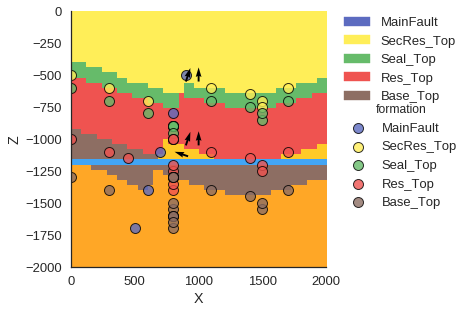

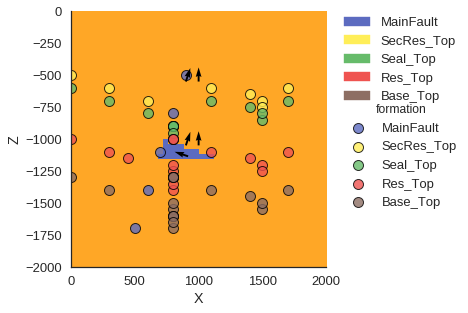

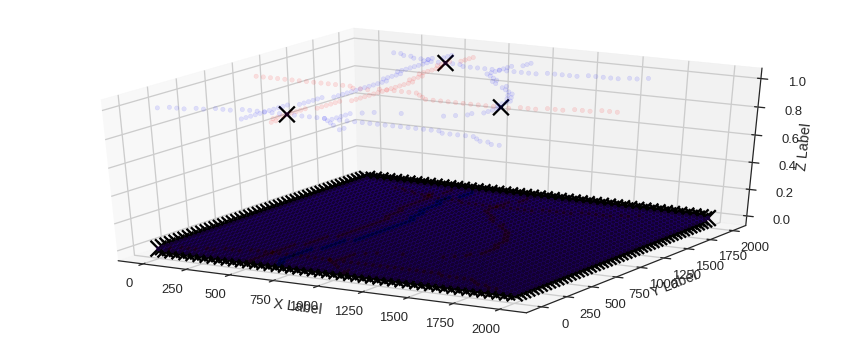

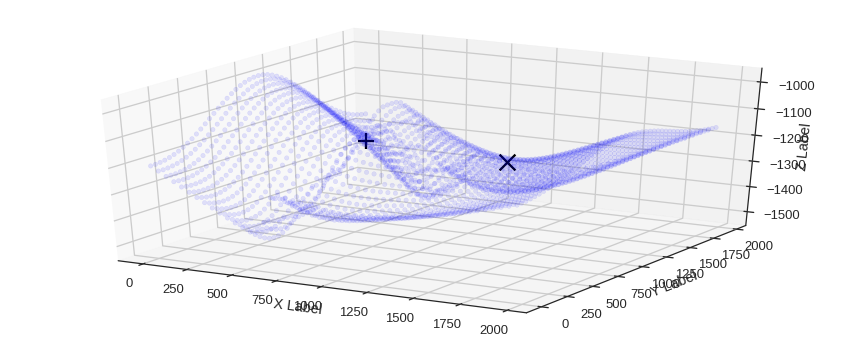

SPILL POINT: [ 1428.57141113   857.1428833  -1188.35257364]
Leak Point: [  612.24487305   938.7755127  -1183.38941809]
Fault leak point above spill point.
...but fault sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 16768000.0 m³
 [-----------------88%-------------     ] 88 of 100 complete in 1217.5 secZ variations top to bottom: 8.31998446924 -9.55054293696 -30.6011456739 -20.7412110821
Fault offset variation: 63.1084175077


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.692536901245269e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


Z variations top to bottom: 8.31998446924 -9.55054293696 -30.6011456739 -35.7199083563
Fault offset variation: 63.1084175077
Z variations top to bottom: 9.18050840953 -9.55054293696 -30.6011456739 -35.7199083563
Fault offset variation: 63.1084175077
Z variations top to bottom: 8.31998446924 -9.55054293696 -33.1493779929 -35.7199083563
Fault offset variation: 63.1084175077
Z variations top to bottom: 8.31998446924 -10.2823066589 -33.1493779929 -35.7199083563
Fault offset variation: 63.1084175077


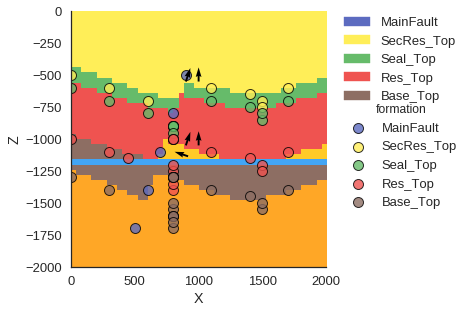

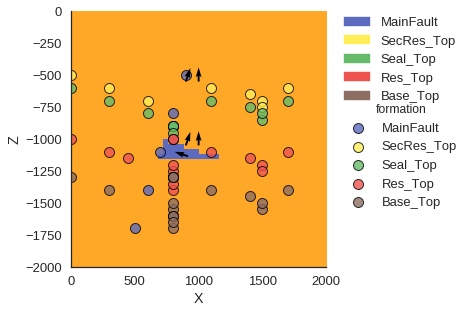

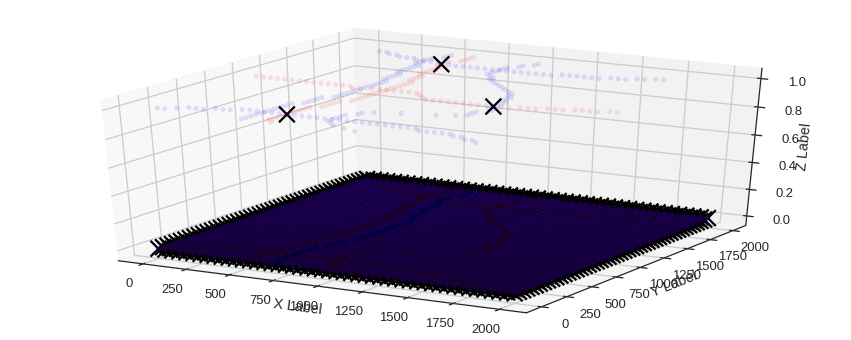

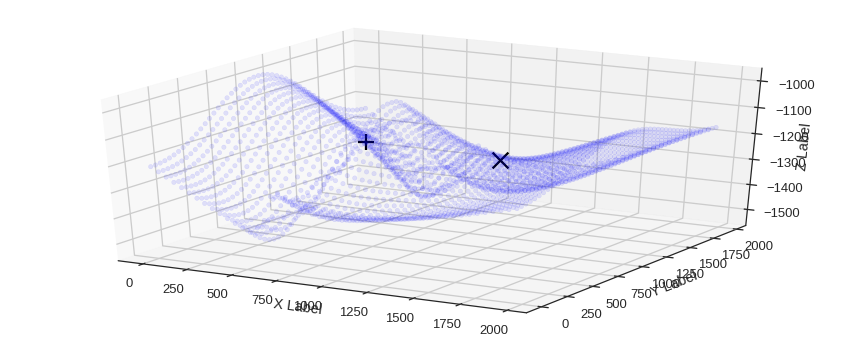

SPILL POINT: [ 1387.75512695   857.1428833  -1190.7153347 ]
Leak Point: [  612.24487305   938.7755127  -1192.79492717]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 16000000.0 m³
 [-----------------89%-------------     ] 89 of 100 complete in 1231.4 secZ variations top to bottom: 8.31998446924 -10.2823066589 -33.1493779929 -35.7199083563
Fault offset variation: 59.5055827523
Z variations top to bottom: 8.31998446924 -10.2823066589 -33.1493779929 -17.1332680795
Fault offset variation: 59.5055827523
Z variations top to bottom: 10.2275447953 -10.2823066589 -33.1493779929 -17.1332680795
Fault offset variation: 59.5055827523
Z variations top to bottom: 10.2275447953 -10.2823066589 -16.1250579139 -17.1332680795
Fault offset variation: 59.5055827523
Z variations top to bottom: 10.2275447953 -12.3781308533 -16.1250579139 -17.1332680795
Fault offset variation: 59.5055827523


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.634473112410717e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


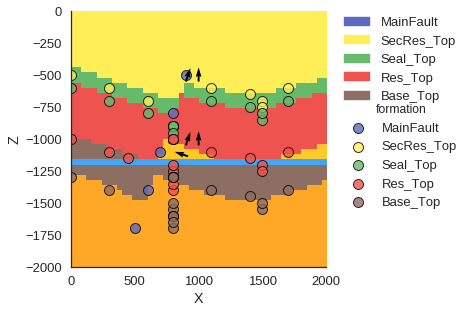

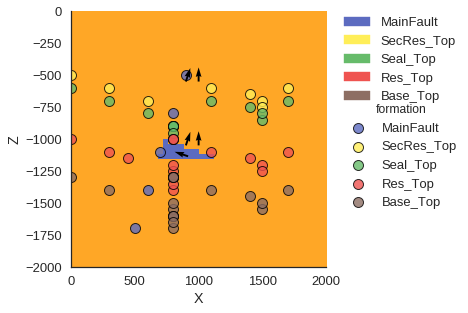

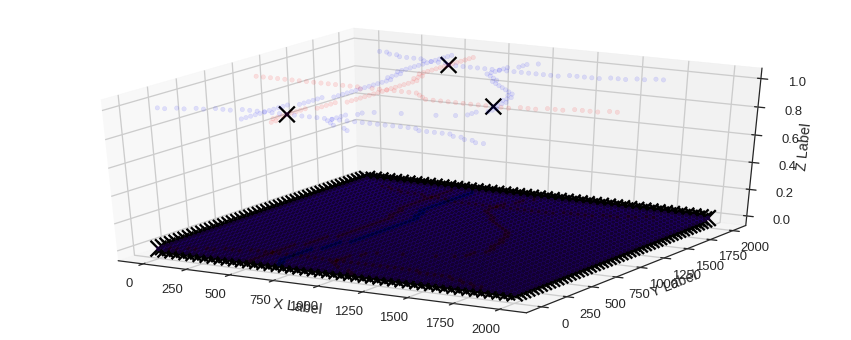

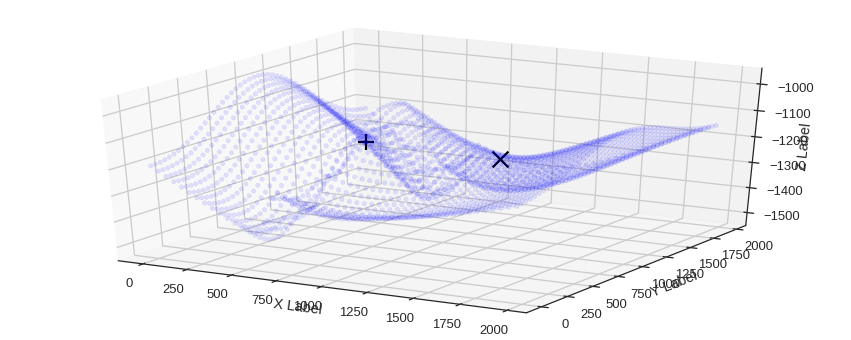

SPILL POINT: [ 1387.75512695   857.1428833  -1174.21342772]
Leak Point: [  612.24487305   938.7755127  -1180.13644458]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 21
Checking Section: 18
TRAP FOUND, section: 18
Maximum reservoir volume: 21056000.0 m³
 [-----------------90%--------------    ] 90 of 100 complete in 1245.3 secZ variations top to bottom: 10.2275447953 -12.3781308533 -16.1250579139 -17.1332680795
Fault offset variation: 79.7976197897
Z variations top to bottom: 10.2275447953 -12.3781308533 -16.1250579139 5.32641294315
Fault offset variation: 79.7976197897
Z variations top to bottom: 11.2363420248 -12.3781308533 -16.1250579139 5.32641294315
Fault offset variation: 79.7976197897
Z variations top to bottom: 11.2363420248 -12.3781308533 -11.5588939598 5.32641294315
Fault offset variation: 79.7976197897
Z variations top to bottom: 11.2363420248 -12.687683032 -11.5588939598 5.32641294315
Fault offset variation: 79.7976197897


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 7.436560171132612e-16
  ' condition number: {}'.format(rcond), RuntimeWarning)


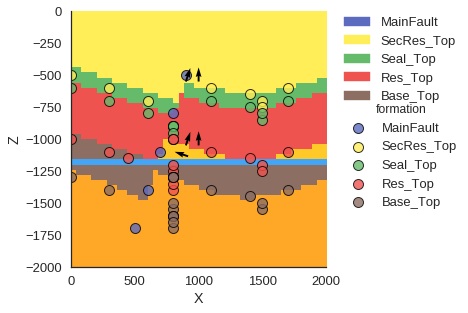

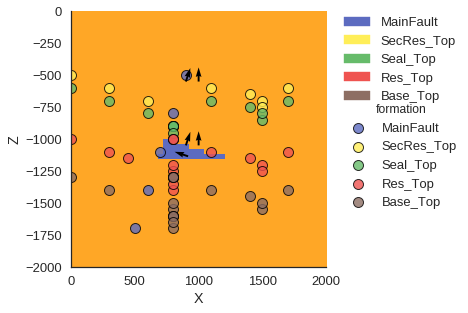

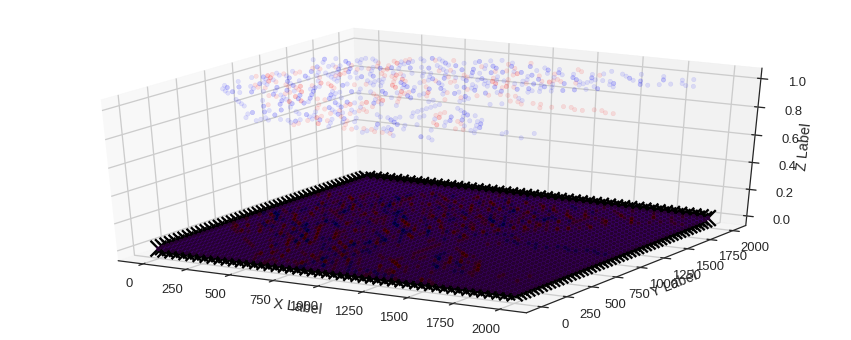

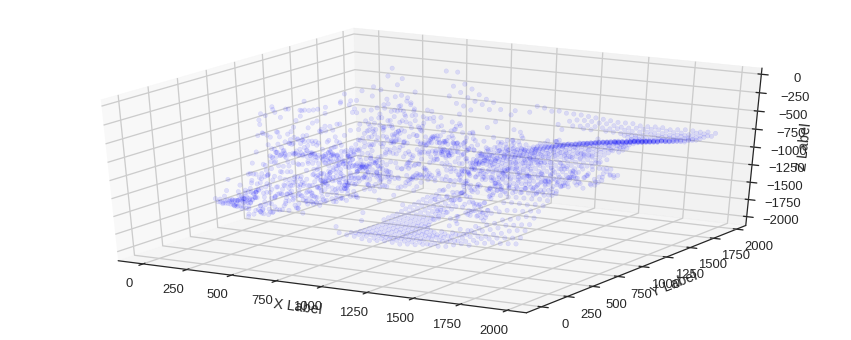

No SPILL POINT found!
Maximum reservoir volume: 0 m³
 [-----------------91%--------------    ] 91 of 100 complete in 1258.2 secZ variations top to bottom: 11.2363420248 -12.687683032 -11.5588939598 5.32641294315
Fault offset variation: 8.25011136364
Z variations top to bottom: 11.2363420248 -12.687683032 -11.5588939598 17.197732265
Fault offset variation: 8.25011136364
Z variations top to bottom: 13.2172208458 -12.687683032 -11.5588939598 17.197732265
Fault offset variation: 8.25011136364
Z variations top to bottom: 13.2172208458 -12.687683032 -18.877962051 17.197732265
Fault offset variation: 8.25011136364
Z variations top to bottom: 13.2172208458 -10.4703777278 -18.877962051 17.197732265
Fault offset variation: 8.25011136364


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.7172337770515744e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


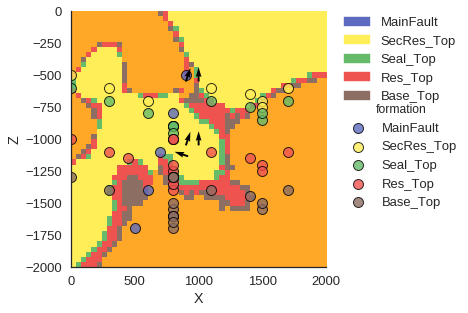

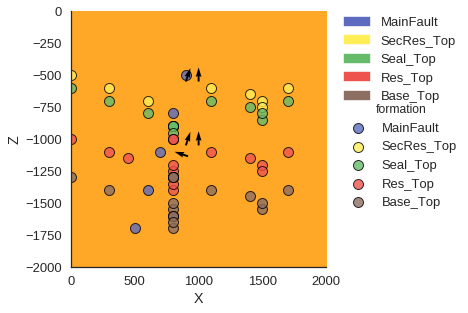

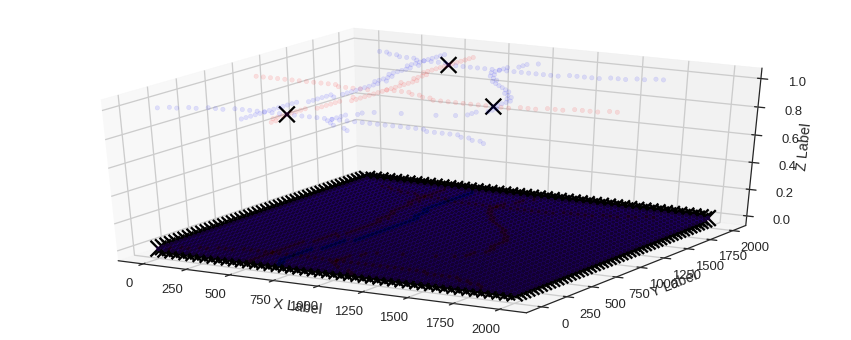

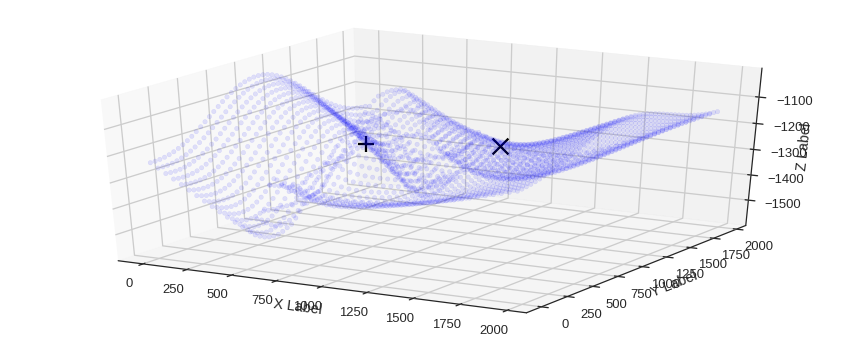

SPILL POINT: [ 1387.75512695   857.1428833  -1176.92693546]
Leak Point: [  612.24487305   938.7755127  -1239.26658626]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 20032000.0 m³
 [-----------------92%--------------    ] 92 of 100 complete in 1272.1 secZ variations top to bottom: 13.2172208458 -10.4703777278 -18.877962051 17.197732265
Fault offset variation: 42.2754313689
Z variations top to bottom: 13.2172208458 -10.4703777278 -18.877962051 46.9337833145
Fault offset variation: 42.2754313689
Z variations top to bottom: 12.7332255837 -10.4703777278 -18.877962051 46.9337833145
Fault offset variation: 42.2754313689
Z variations top to bottom: 12.7332255837 -10.4703777278 -26.8273479175 46.9337833145
Fault offset variation: 42.2754313689
Z variations top to bottom: 12.7332255837 -14.7358830565 -26.8273479175 46.9337833145
Fault offset variation: 42.2754313689


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.376551815925666e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


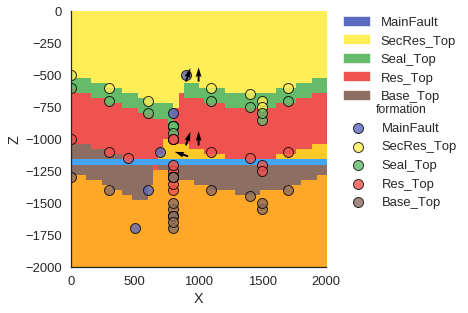

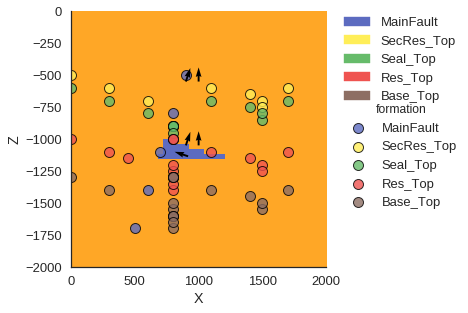

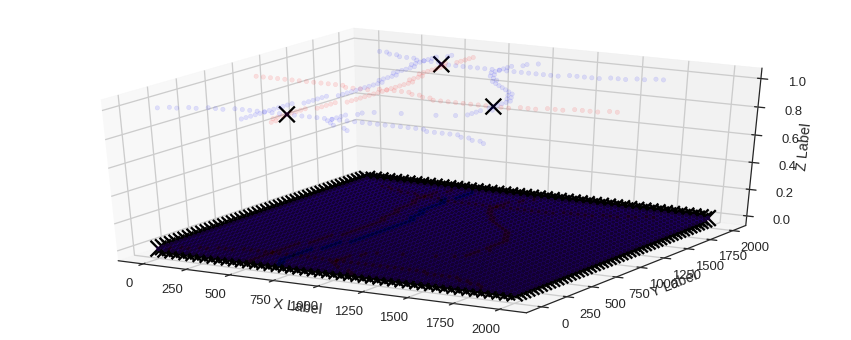

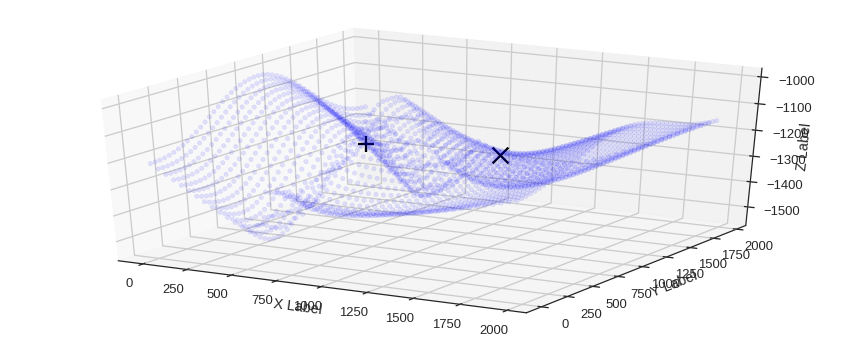

SPILL POINT: [ 1387.75512695   857.1428833  -1185.32235075]
Leak Point: [  612.24487305   938.7755127  -1211.94300475]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 17280000.0 m³
 [-----------------93%---------------   ] 93 of 100 complete in 1285.8 secZ variations top to bottom: 12.7332255837 -14.7358830565 -26.8273479175 46.9337833145
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.7332255837 -14.7358830565 -26.8273479175 74.3012868694
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.4700294091 -14.7358830565 -26.8273479175 74.3012868694
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.4700294091 -14.7358830565 -16.0726659001 74.3012868694
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.4700294091 -12.8215264207 -16.0726659001 74.3012868694
Fault offset variation: 26.1732907554


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.771562055721045e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


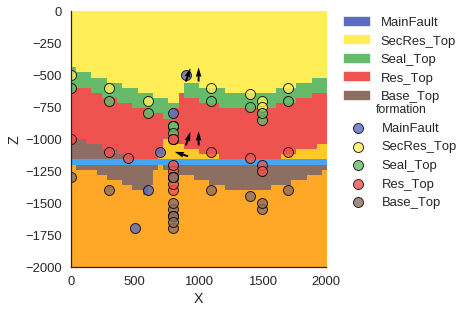

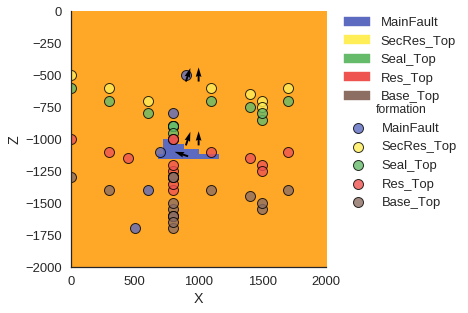

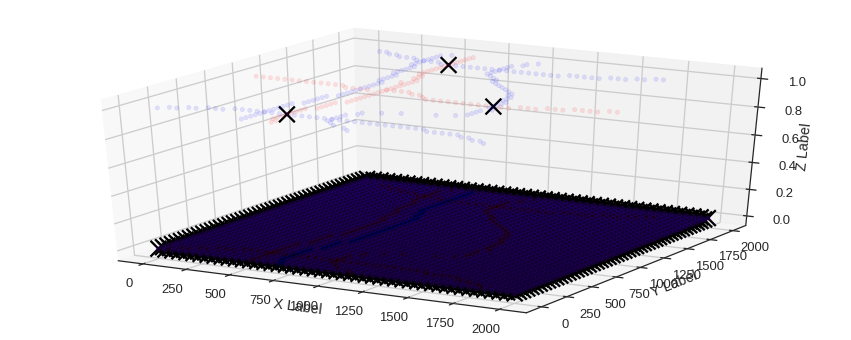

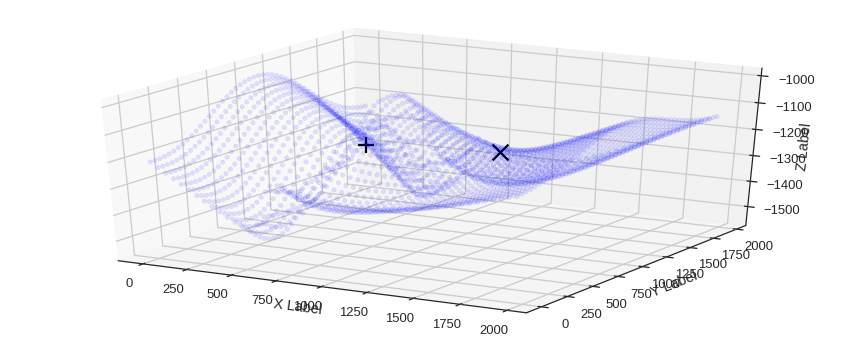

SPILL POINT: [ 1387.75512695   857.1428833  -1175.74005845]
Leak Point: [  612.24487305   938.7755127  -1217.88851374]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 20864000.0 m³
 [-----------------94%---------------   ] 94 of 100 complete in 1300.2 secZ variations top to bottom: 12.4700294091 -12.8215264207 -16.0726659001 74.3012868694
Fault offset variation: 31.0348723906
Z variations top to bottom: 12.4700294091 -12.8215264207 -16.0726659001 129.147290114
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.1085723237 -12.8215264207 -16.0726659001 74.3012868694
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.1085723237 -12.8215264207 -23.1208437168 74.3012868694
Fault offset variation: 26.1732907554
Z variations top to bottom: 12.1085723237 -9.98432508216 -23.1208437168 74.3012868694
Fault offset variation: 26.1732907554


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.577529448217041e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


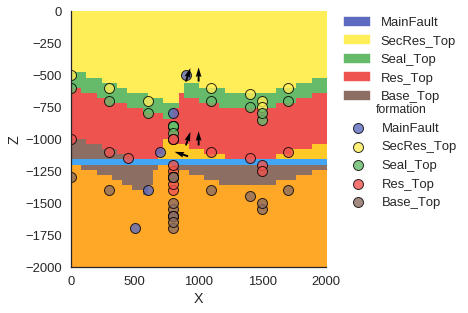

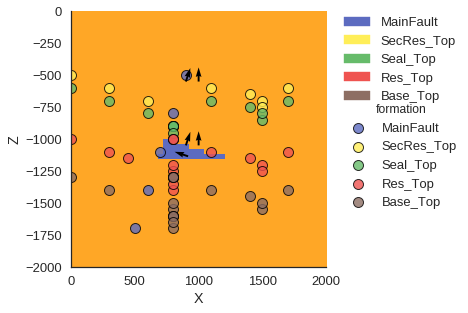

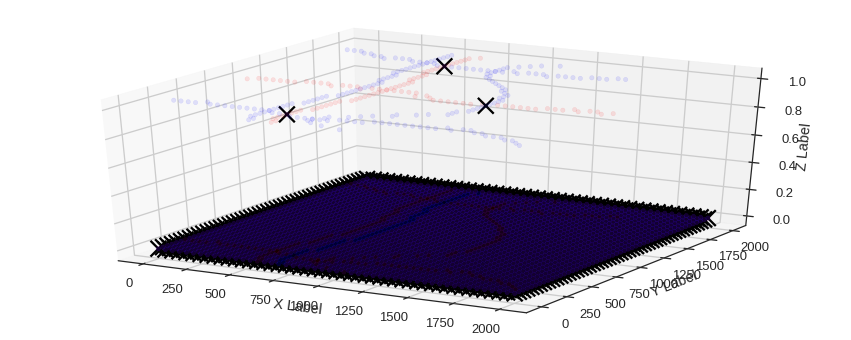

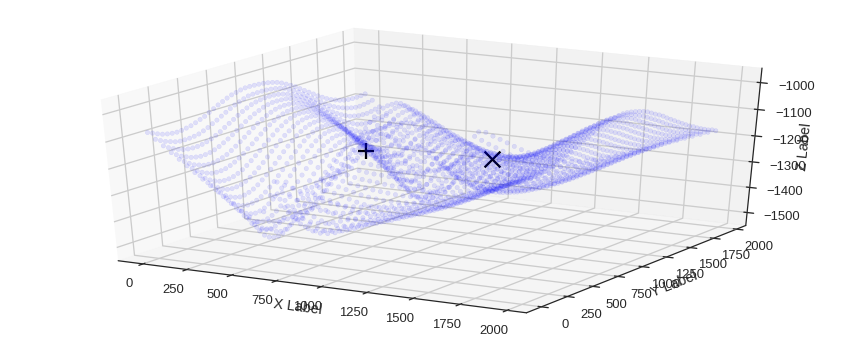

SPILL POINT: [ 1346.9387207    857.1428833  -1180.40015635]
Leak Point: [  612.24487305   938.7755127  -1218.97117002]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 22
Checking Section: 21
TRAP FOUND, section: 21
Checking Section: 18
TRAP FOUND, section: 18
Checking Section: 12
TRAP FOUND, section: 12
Maximum reservoir volume: 18112000.0 m³
 [-----------------95%----------------  ] 95 of 100 complete in 1315.8 secZ variations top to bottom: 12.1085723237 -9.98432508216 -23.1208437168 74.3012868694
Fault offset variation: -37.5694872818
Z variations top to bottom: 12.1085723237 -9.98432508216 -23.1208437168 51.5751969459
Fault offset variation: 26.1732907554
Z variations top to bottom: 13.4522261342 -9.98432508216 -23.1208437168 51.5751969459
Fault offset variation: 26.1732907554
Z variations top to bottom: 13.4522261342 -9.98432508216 -29.8418143885 51.5751969459
Fault offset variation: 26.1732907554
Z variations top to bottom: 13.4522261342 -11.326298819

/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.1785163265469554e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


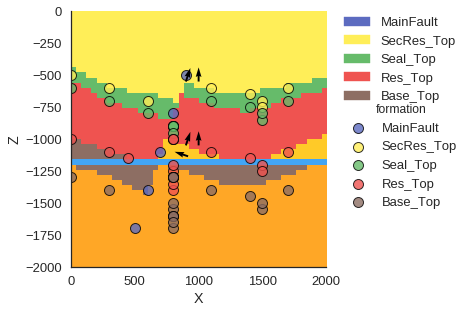

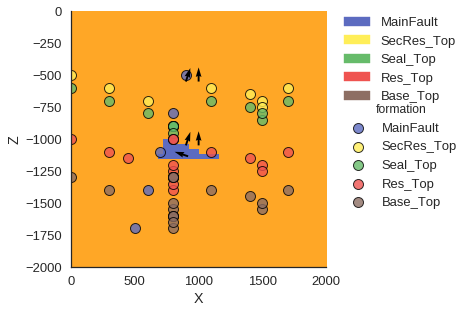

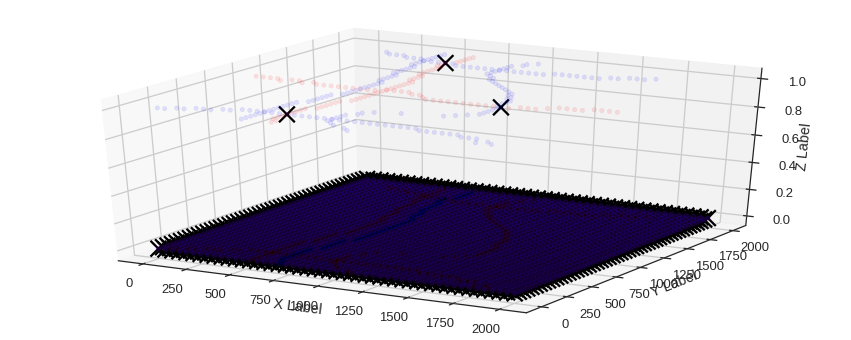

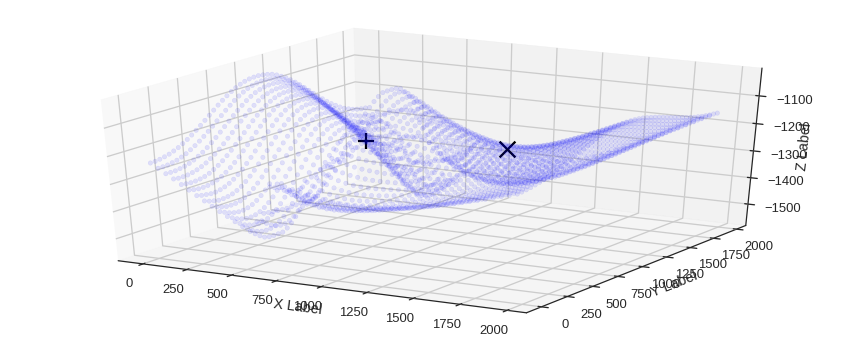

SPILL POINT: [ 1428.57141113   857.1428833  -1185.71656367]
Leak Point: [  612.24487305   938.7755127  -1226.31955368]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 17408000.0 m³
 [-----------------96%----------------  ] 96 of 100 complete in 1329.8 secZ variations top to bottom: 13.4522261342 -11.3262988197 -29.8418143885 51.5751969459
Fault offset variation: -11.0681521949
Z variations top to bottom: 13.4522261342 -11.3262988197 -29.8418143885 15.9229662371
Fault offset variation: -11.0681521949
Z variations top to bottom: 14.2071271809 -11.3262988197 -29.8418143885 15.9229662371
Fault offset variation: -11.0681521949
Z variations top to bottom: 14.2071271809 -11.3262988197 -31.8105888192 15.9229662371
Fault offset variation: -11.0681521949
Z variations top to bottom: 14.2071271809 -9.97259751243 -31.8105888192 15.9229662371
Fault offset variation: -11.0681521949


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 4.222707846232706e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


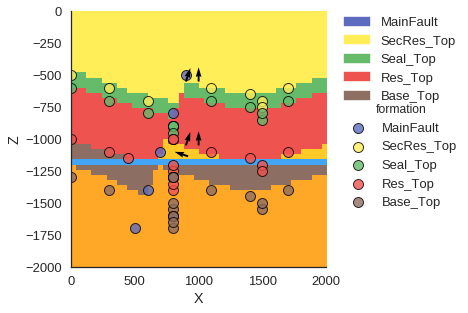

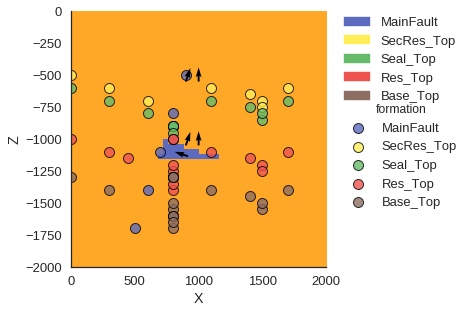

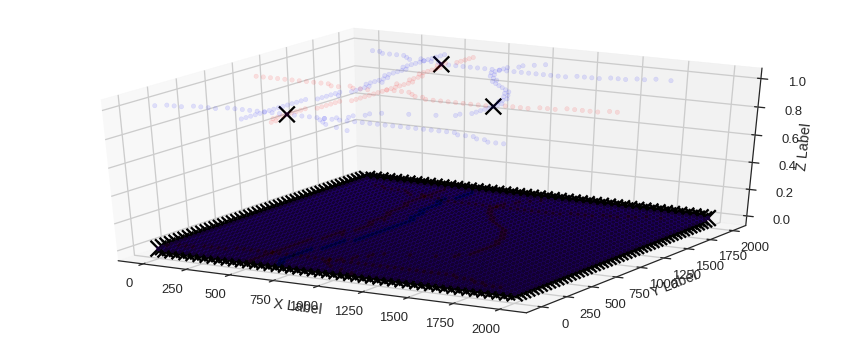

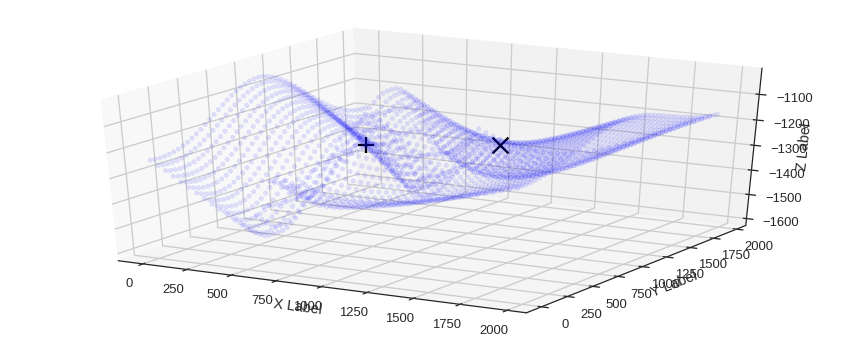

SPILL POINT: [ 1387.75512695   857.1428833  -1183.75341537]
Leak Point: [  612.24487305   938.7755127  -1259.3483125 ]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 15616000.0 m³
 [-----------------97%----------------  ] 97 of 100 complete in 1343.6 secZ variations top to bottom: 14.2071271809 -9.97259751243 -31.8105888192 15.9229662371
Fault offset variation: 35.1159364856
Z variations top to bottom: 14.2071271809 -9.97259751243 -31.8105888192 37.8708512483
Fault offset variation: 35.1159364856
Z variations top to bottom: 13.8991439853 -9.97259751243 -31.8105888192 37.8708512483
Fault offset variation: 35.1159364856
Z variations top to bottom: 13.8991439853 -9.97259751243 -32.1433373902 37.8708512483
Fault offset variation: 35.1159364856
Z variations top to bottom: 13.8991439853 -20.8255735692 -32.1433373902 37.8708512483
Fault offset variation: 35.1159364856


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.0982763309907995e-11
  ' condition number: {}'.format(rcond), RuntimeWarning)


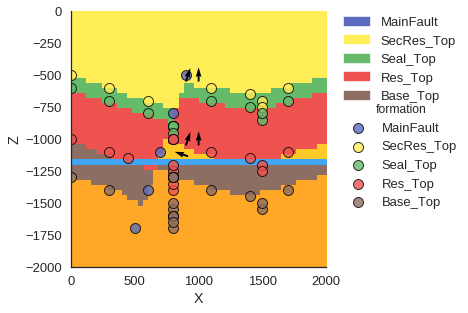

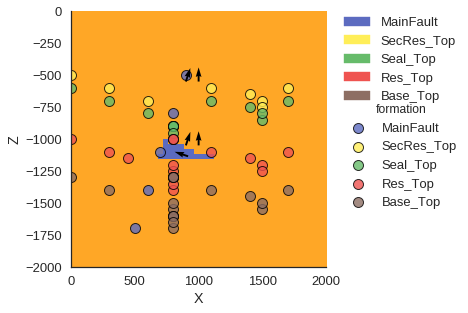

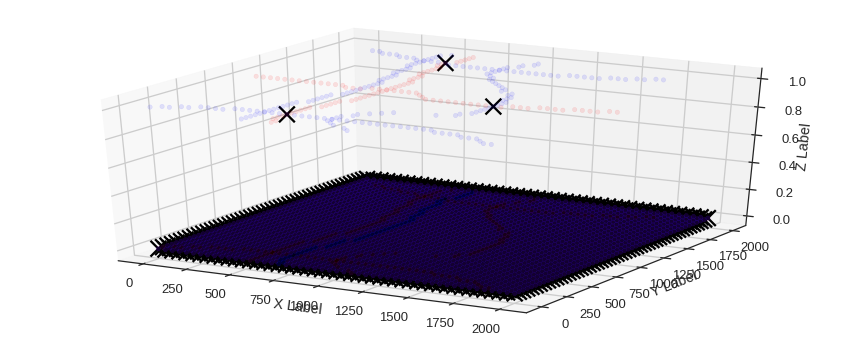

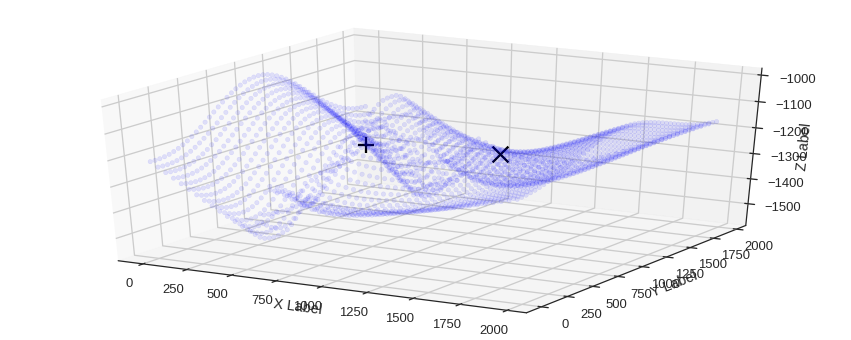

SPILL POINT: [ 1387.75512695   857.1428833  -1188.31490879]
Leak Point: [  612.24487305   938.7755127  -1226.74238068]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 15872000.0 m³
 [-----------------98%----------------- ] 98 of 100 complete in 1357.4 secZ variations top to bottom: 13.8991439853 -9.97259751243 -32.1433373902 37.8708512483
Fault offset variation: -11.1750465954
Z variations top to bottom: 13.8991439853 -9.97259751243 -32.1433373902 16.5103521933
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.477997463 -9.97259751243 -32.1433373902 16.5103521933
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.477997463 -9.97259751243 -33.7755433607 16.5103521933
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.477997463 -9.15660150399 -33.7755433607 16.5103521933
Fault offset variation: -11.1750465954


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 1.242305700178319e-14
  ' condition number: {}'.format(rcond), RuntimeWarning)


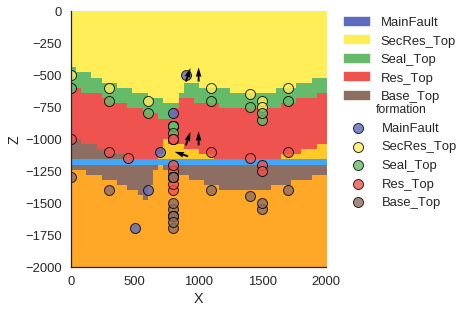

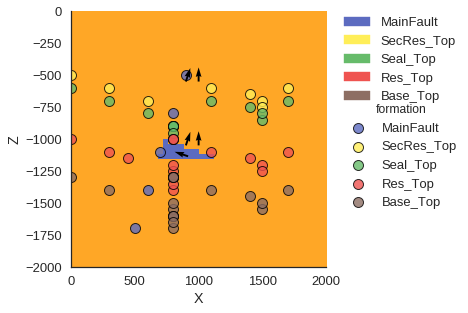

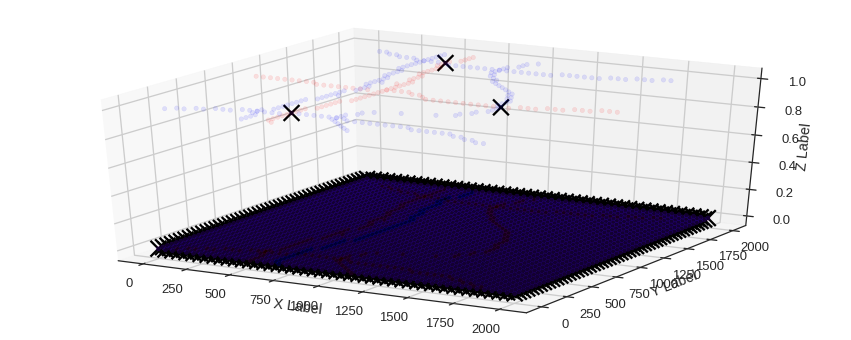

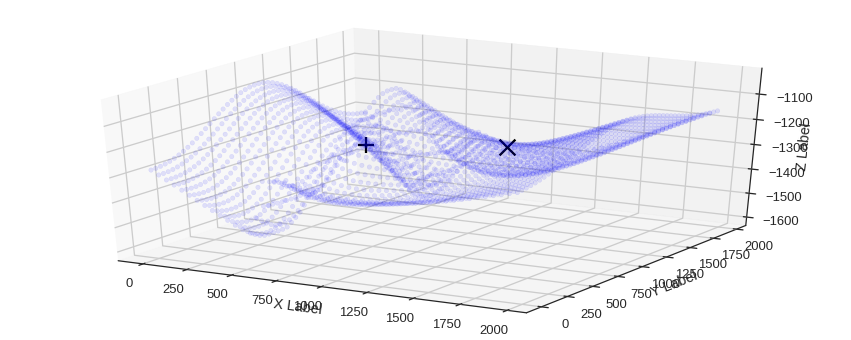

SPILL POINT: [ 1428.57141113   857.1428833  -1191.30120436]
Leak Point: [  612.24487305   938.7755127  -1261.79083121]
Spill point defines trap.
Fault is pathway. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 15680000.0 m³
 [-----------------99%----------------- ] 99 of 100 complete in 1371.3 secZ variations top to bottom: 11.477997463 -9.15660150399 -33.7755433607 16.5103521933
Fault offset variation: -35.6900781976
Z variations top to bottom: 11.477997463 -9.15660150399 -33.7755433607 33.6261590212
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.8417699749 -9.15660150399 -33.7755433607 33.6261590212
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.8417699749 -9.15660150399 -36.8237538067 33.6261590212
Fault offset variation: -11.1750465954
Z variations top to bottom: 11.8417699749 -9.39964566876 -36.8237538067 33.6261590212
Fault offset variation: -11.1750465954


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 6.877222315931908e-12
  ' condition number: {}'.format(rcond), RuntimeWarning)


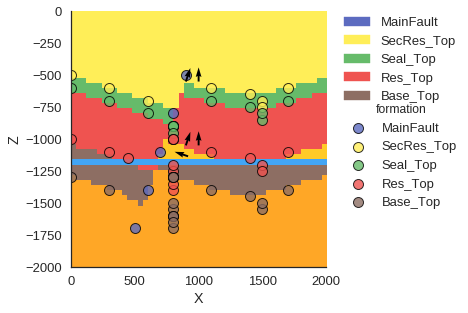

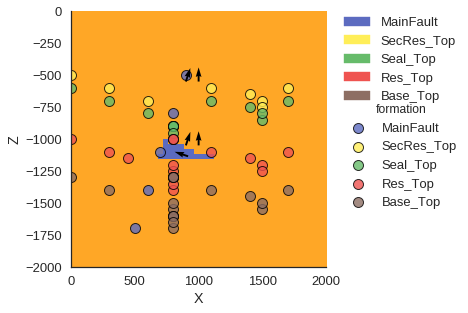

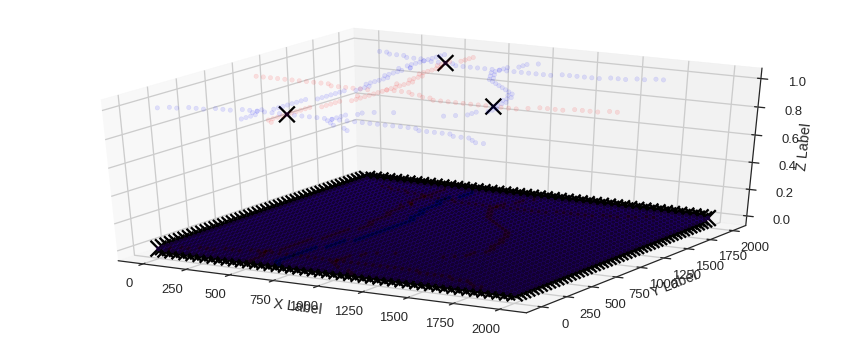

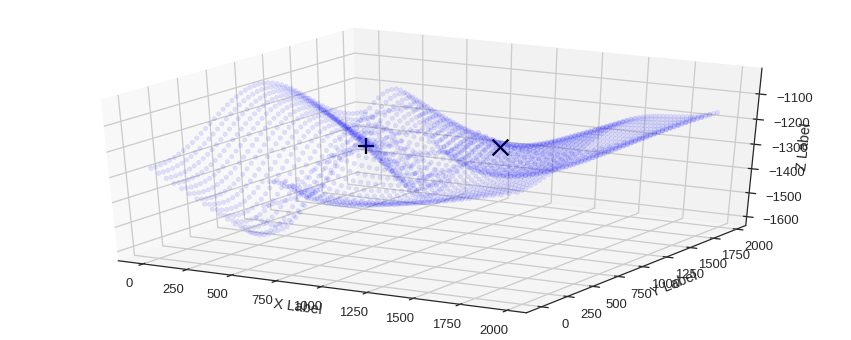

SPILL POINT: [ 1387.75512695   857.1428833  -1195.99379543]
Leak Point: [  612.24487305   938.7755127  -1264.2041537 ]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 16
TRAP FOUND, section: 16
Checking Section: 19
Maximum reservoir volume: 14720000.0 m³
 [-----------------100%-----------------] 100 of 100 complete in 1385.1 secZ variations top to bottom: 11.8417699749 -9.39964566876 -36.8237538067 33.6261590212
Fault offset variation: -31.6839400381
Z variations top to bottom: 11.8417699749 -9.39964566876 -36.8237538067 39.8182725494
Fault offset variation: -31.6839400381
Z variations top to bottom: 14.2968329665 -9.39964566876 -36.8237538067 39.8182725494
Fault offset variation: -31.6839400381
Z variations top to bottom: 11.8417699749 -9.39964566876 -42.529021684 39.8182725494
Fault offset variation: -31.6839400381
Z variations top to bottom: 11.8417699749 -11.4508327052 -42.529021684 39.8182725494
Fault offset variation: -31.6839400381


/home/bl9/anaconda3/lib/python3.5/site-packages/scipy/linalg/basic.py:223: RuntimeWarning: scipy.linalg.solve
Ill-conditioned matrix detected. Result is not guaranteed to be accurate.
Reciprocal condition number: 3.0769479778219692e-15
  ' condition number: {}'.format(rcond), RuntimeWarning)


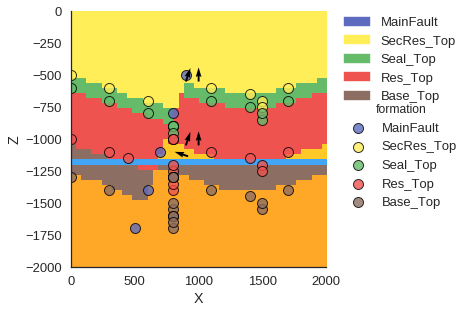

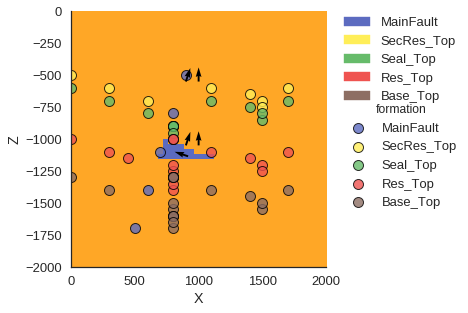

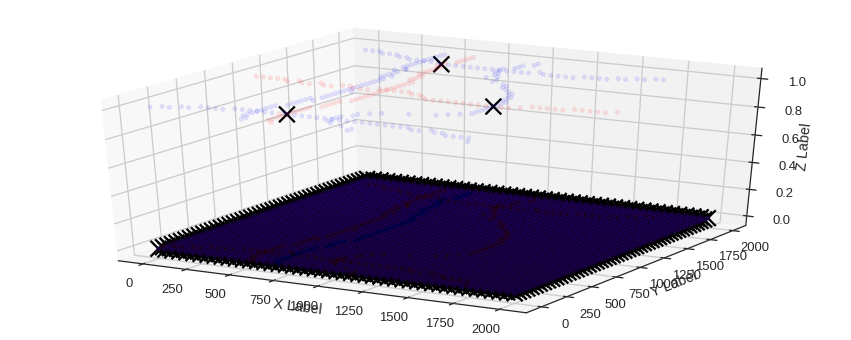

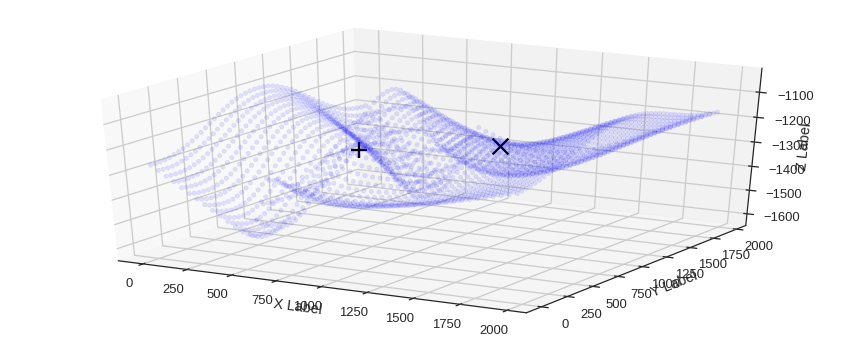

SPILL POINT: [ 1387.75512695   857.1428833  -1200.5394341 ]
Leak Point: [  571.42858887   938.7755127  -1294.89838244]
Spill point defines trap.
Fault is sealing. Down to spill.
Checking Section: 17
TRAP FOUND, section: 17
Checking Section: 20
Maximum reservoir volume: 13312000.0 m³
 [-----------------101%-----------------] 101 of 100 complete in 1398.9 sec

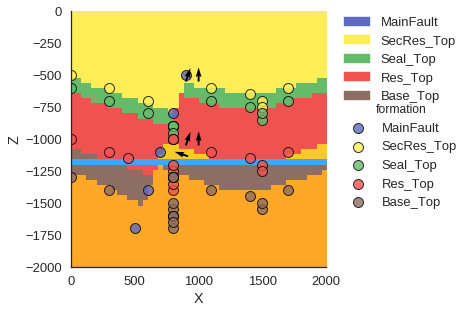

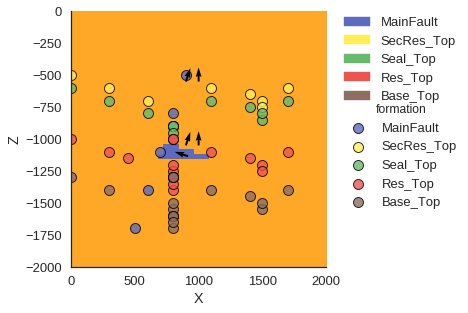

In [32]:
M = pymc.MCMC(model)
M.sample(iter=iterations)

In [58]:
res_top_unc_trace = M.trace('z_unc_res_top')[:]
offset_unc_trace = M.trace('offset_unc')[:]
fault_sealing_trace = M.trace('fault_sealing_unc')[:]
structural_model_trace = M.trace('structural_model')[:] #[0]=lith_sol,[1]=fault:sol,[2]=max_volume,[3]=trap_block

fw_res_th_trace = M.trace('res_th')[:]
fw_seal_th_trace = M.trace('seal_th')[:]
fw_sec_res_th_trace = M.trace('sec_res_th')[:]

#for j in range(iterations):
#    plt.figure()
#    #plt.title('Change in res_top: %s' % bla[j])
#    #print(bla[j])
#    if fault_sealing == True:
#        print("Fault is sealed.")
#    else:
#        print("Fault is permeable.")
#    print("Max. trap volume = ", trap_volume_trace[j][2])
#    gp.plot_section(geo_data, trap_volume_trace[j][0][0,0], 25, plot_data =1)

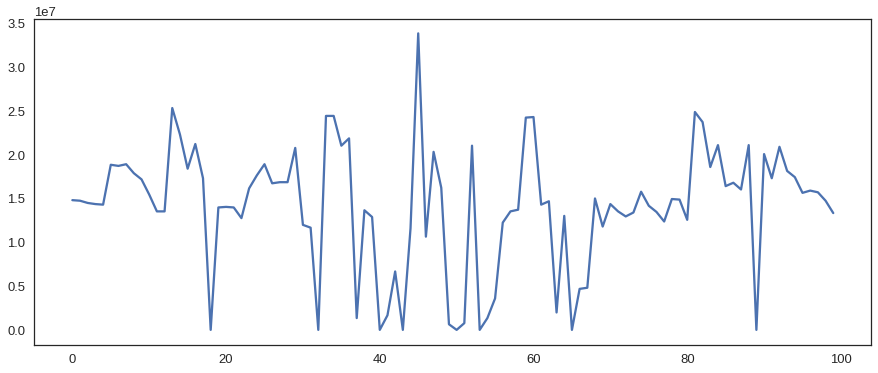

In [59]:
max_volume_trace = structural_model_trace[:,2]
plt.plot(max_volume_trace)

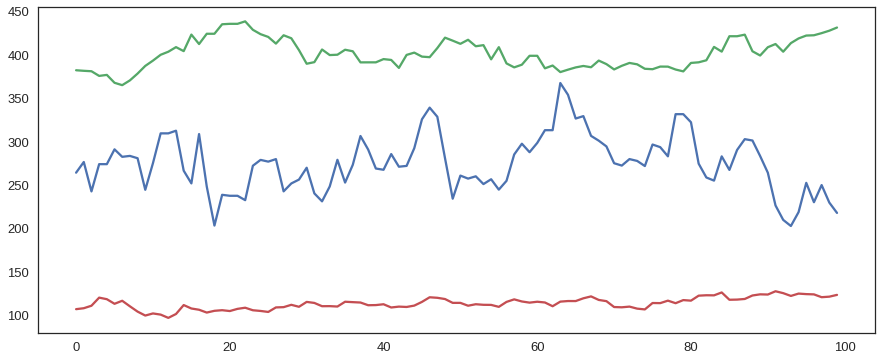

In [60]:
plt.plot(fw_res_th_trace)
plt.plot(fw_seal_th_trace)
plt.plot(fw_sec_res_th_trace)

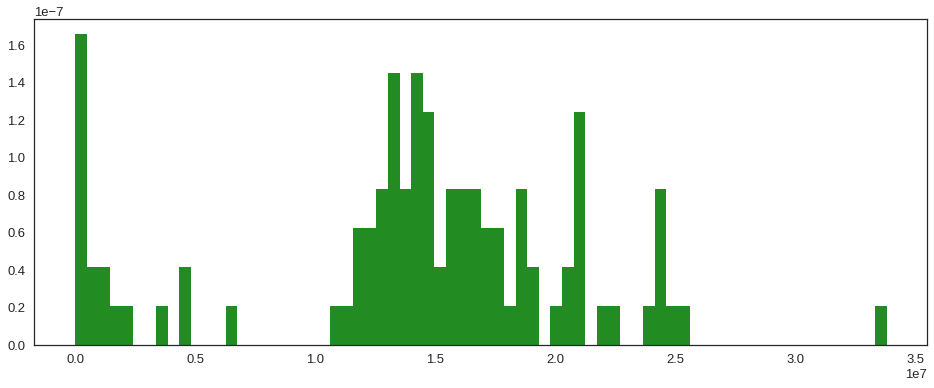

In [61]:
figsize(16, 6)

#_hist1 = plt.hist(max_volume_trace, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "steelblue")
volumes = max_volume_trace
mask = volumes == 0
masked_trace = volumes[~mask]
_hist1 = plt.hist(max_volume_trace, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "forestgreen")
#_hist1 = plt.hist(masked_trace, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "steelblue")

In [61]:
#import datetime
counter = 0
for i in structural_model_trace[:]:
    counter+=1
    #print(np.ascontiguousarray(i[3]))
    gp.export_vtk_rectilinear(geo_data, np.ascontiguousarray(i[3]), path="./output_data/trap_volumes/06_10-TRAP_10iterUNCnoLH_%s" % (counter))
    gp.export_vtk_rectilinear(geo_data, np.ascontiguousarray(i[0][0,0]), path="./output_data/lith_blocks/06_10-LITH_10iterUNCnoLH_%s" % (counter))

In [63]:
# INFORMATION ENTROPY FUNCTIONS
def compute_prob_lith(lith_blocks):
    """Blocks must be just the lith blocks!"""
    lith_id = np.unique(lith_blocks)
    lith_count = np.zeros_like(lith_blocks[0:len(lith_id)])
    for i, l_id in enumerate(lith_id):
        lith_count[i] = np.sum(lith_blocks == l_id, axis=0)
    lith_prob = lith_count / len(lith_blocks)
    return lith_prob


def calculate_ie_masked(lith_prob):
    ie = np.zeros_like(lith_prob[0])
    for l in lith_prob:
        pm = np.ma.masked_equal(l, 0)  # mask where layer prob is 0
        ie -= (pm * np.ma.log2(pm)).filled(0)
    return ie


def calculate_ie_total(ie, absolute=False):
    if absolute:
        return np.sum(ie)
    else:
        return np.sum(ie) / np.size(ie)

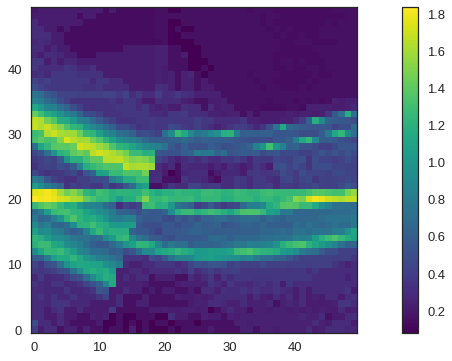

In [64]:
lith_blocks = []
for i in structural_model_trace[:]:
    lith_blocks.append(i[0][0,0].astype(int))

lith_prob = compute_prob_lith(lith_blocks)
i_entropy = calculate_ie_masked(lith_prob)

plt.imshow(i_entropy.reshape(50,50,50)[:,0,:].T, origin="lower", cmap="viridis")
plt.colorbar()

In [65]:
#LOSS FUNCTIONS
estimates_s = np.arange(0,60000000, 10000)

#weight factors
ov = 1.25
ov_b = 2
uv_b = 1.5

#risk parameters
risks_s = np.arange(0.5, 1.6, 0.25)

#risk neutral
def volume_loss4(estimate_s, true_s):
        loss_s = np.zeros_like(true_s)
        underest = (estimate_s < true_s) 
        underest_bad = (estimate_s <= 0) & (true_s > 0)
        overest = (estimate_s > true_s) 
        overest_bad = (estimate_s > 0) & (true_s <= 0)
        loss_s[underest] = (true_s[underest] - estimate_s)
        loss_s[underest_bad] = (true_s[underest_bad] - estimate_s)*uv_b
        loss_s[overest] = (estimate_s - true_s[overest])*ov
        loss_s[overest_bad] = (estimate_s - true_s[overest_bad])*ov_b
        return loss_s

#including risk
def volume_lossR(estimate_s, true_s, risk_s):
        loss_s = np.zeros_like(true_s)
        underest = (estimate_s < true_s) 
        underest_bad = (estimate_s == 0) & (true_s > 0)
        overest = (estimate_s > true_s) 
        overest_bad = (estimate_s > 0) & (true_s == 0)
        loss_s[underest] = (true_s[underest] - estimate_s)
        loss_s[underest_bad] = (true_s[underest_bad] - estimate_s)*(uv_b*(risk_s**-0.5))
        loss_s[overest] = (estimate_s - true_s[overest])*(ov*risk_s)
        loss_s[overest_bad] = np.abs((true_s[overest_bad]-estimate_s))*(ov_b*risk_s)
        return loss_s
    
#def volume_lossR(estimate_s, true_s, risk_s):
#        loss_s = np.zeros_like(true_s)
#        underest = (estimate_s < true_s) 
#        underest_bad = (estimate_s <= 0) & (true_s > 0)
#        overest = (estimate_s > true_s) 
#        overest_bad = (estimate_s > 0) & (true_s <= 0)
#        loss_s[underest] = (true_s[underest] - estimate_s)
#        loss_s[underest_bad] = (true_s[underest_bad] - estimate_s)*(uv_b*(risk_s**-0.5))
#        loss_s[overest] = (estimate_s - true_s[overest])*(ov*risk_s)
#        loss_s[overest_bad] = (estimate_s - true_s[overest_bad])*(ov_b*risk_s)
#        return loss_s

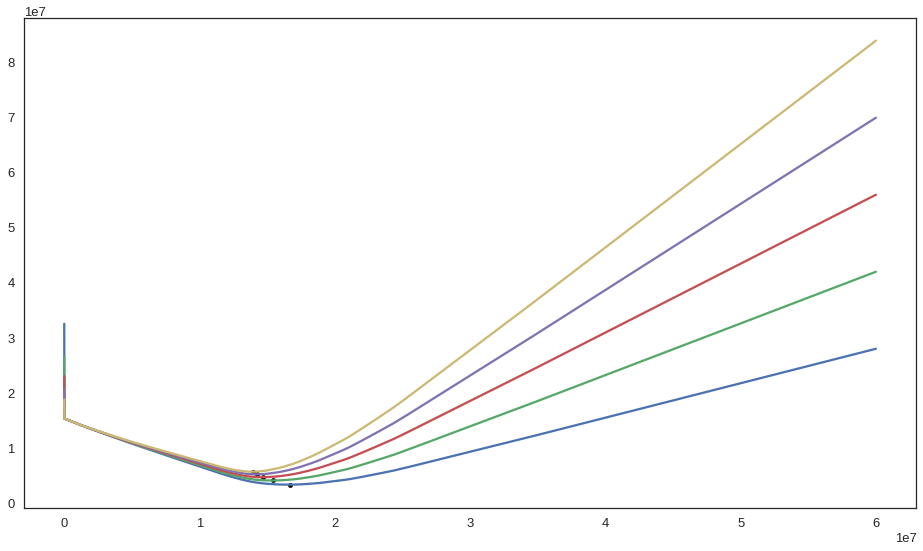

In [66]:
figsize(16, 9)

# No reduced uncertainty, different risks
BA_before = np.zeros_like(risks_s)
EL_before = np.zeros_like(risks_s)
expected_loss = lambda estimate_s, risk_s: volume_lossR(estimate_s, masked_trace, risk_s).mean()

counter = 0
for r in risks_s:
    loss = [expected_loss(e, r) for e in estimates_s]
    _min_score = sop.fmin(expected_loss, -40, args=(r,),disp = False)
    #print(_min_score)
    if _min_score < 0:
        _min_score = 0
    plt.plot(estimates_s, loss, label = "Risk r "+str(r))
    plt.scatter(_min_score, expected_loss(_min_score,r), s = 20, color = 'black')
    #lt.vlines(_min_results, 0, 0.02, color = 'black', linestyles="--")
    #print("Bayes action (minimum) at risk r %.2f: %.2f" % (r, _min_score))
    BA_before[counter] = _min_score
    EL_before[counter] = expected_loss(_min_score,r)
    counter += 1


In [55]:
# THICKNESS LIKELIHOOD FUNCTIONS
#Additional information, updating with likelihoods

#return fw_res_th, fw_seal_th, fw_sec_res_th, fw_rb_z, fw_sb_z, fw_r2b_z, fw_ob_z

std1 = 10
std2 = 20
std3 = 50

@pymc.stochastic
def sec_res_th_likelihood(value = 0, sec_res_th=sec_res_th):
    return pymc.normal_like(sec_res_th, 120., 1./np.square(std1))

@pymc.stochastic
def seal_th_likelihood(value = 0, seal_th=seal_th):
    return pymc.normal_like(seal_th, 400., 1./np.square(std2))

@pymc.stochastic
def res_th_likelihood(value = 0, res_th=res_th):
    return pymc.normal_like(res_th, 250., 1./np.square(std3))

In [56]:
#model = pymc.Model([pos_unc_model, z_unc_res_top, fault_sealing, fw_th, hw_th, 
#                    res_th_likelihood, seal_th_likelihood, sec_res_th_likelihood])
model_L = pymc.Model([interp_unc, z_unc_res_top, z_unc_base_top, z_unc_seal_top, z_unc_secres_top, offset_unc,
                    fault_sealing, structural_model, 
                    res_th, seal_th, sec_res_th, 
                    res_th_likelihood, seal_th_likelihood, sec_res_th_likelihood])

In [57]:
M_L = pymc.MCMC(model_L)
M_L.sample(iter=iterations)

ValueError: A tallyable PyMC object called sec_res_th_likelihood2 already exists. This will cause problems for some database backends.

In [22]:
res_top_unc_trace_L = M_L.trace('z_unc_res_top')[:]
offset_unc_trace_L = M_L.trace('offset_unc')[:]
fault_sealing_trace_L = M_L.trace('fault_sealing_unc')[:]
structural_model_trace_L = M_L.trace('structural_model')[:] #[0]=lith_sol,[1]=fault:sol,[2]=max_volume

fw_res_th_trace_L = M_L.trace('res_th')[:]
fw_seal_th_trace_L = M_L.trace('seal_th')[:]
fw_sec_res_th_trace_L = M_L.trace('sec_res_th')[:]

interp_trace_L = M_L.trace('interp_unc')[:]

#for j in range(iterations):
#    plt.figure()
#    #plt.title('Change in res_top: %s' % bla[j])
#    #print(bla[j])
#    if fault_sealing == True:
#        print("Fault is sealed.")
#    else:
#        print("Fault is permeable.")
#    print("Max. trap volume = ", trap_volume_trace[j][2])
#    gp.plot_section(geo_data, trap_volume_trace[j][0][0,0], 25, plot_data =1)

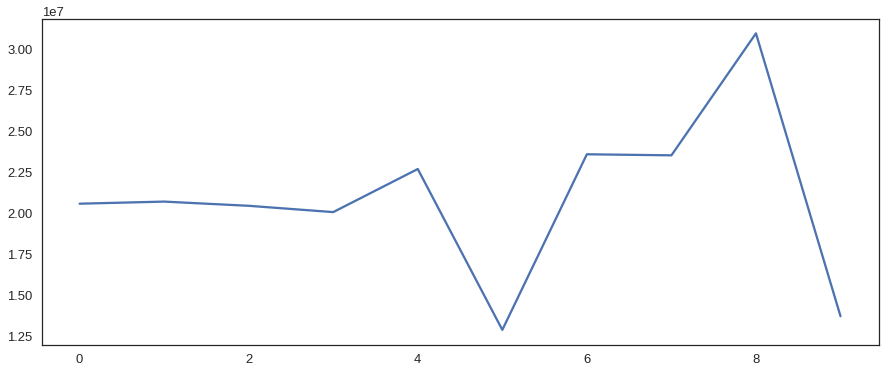

In [26]:
max_volume_trace_L = structural_model_trace_L[:,2]
plt.plot(max_volume_trace_L)

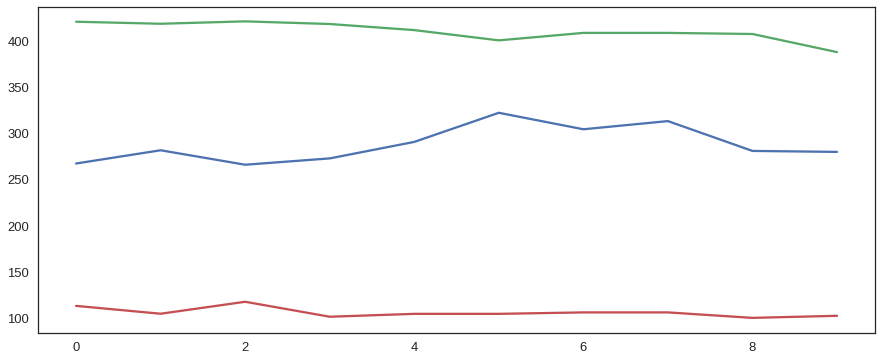

In [27]:
plt.plot(fw_res_th_trace_L)
plt.plot(fw_seal_th_trace_L)
plt.plot(fw_sec_res_th_trace_L)

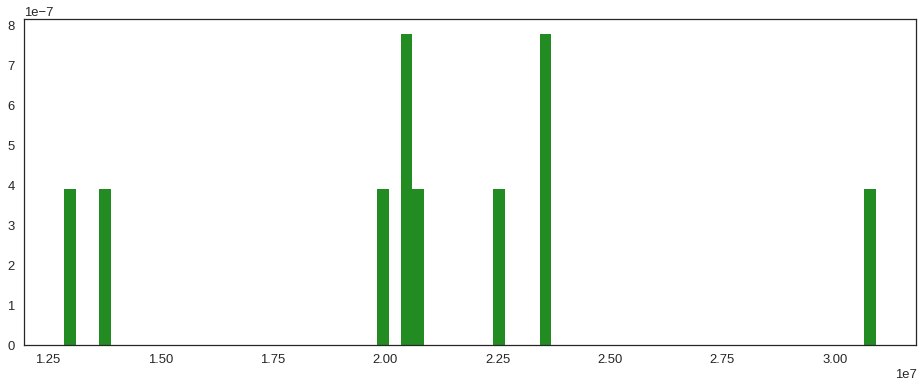

In [29]:
figsize(16, 6)

#_hist1 = plt.hist(max_volume_trace, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "steelblue")
volumes = max_volume_trace_L
mask = volumes == 0
masked_trace = volumes[~mask]
_hist1 = plt.hist(max_volume_trace_L, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "forestgreen")
#_hist1 = plt.hist(masked_trace, bins=70, normed=True, histtype="stepfilled",label="prior distribution", color = "steelblue")

In [464]:
figsize(16, 9)

# No reduced uncertainty, different risks
BA_before = np.zeros_like(risks_s)
EL_before = np.zeros_like(risks_s)
expected_loss = lambda estimate_s, risk_s: volume_lossR(estimate_s, masked_trace, risk_s).mean()

counter = 0
for r in risks_s:
    loss = [expected_loss(e, r) for e in estimates_s]
    _min_score = sop.fmin(expected_loss, -40, args=(r,),disp = False)
    #print(_min_score)
    if _min_score < 0:
        _min_score = 0
    plt.plot(estimates_s, loss, label = "Risk r "+str(r))
    plt.scatter(_min_score, expected_loss(_min_score,r), s = 20, color = 'black')
    #lt.vlines(_min_results, 0, 0.02, color = 'black', linestyles="--")
    #print("Bayes action (minimum) at risk r %.2f: %.2f" % (r, _min_score))
    BA_before[counter] = _min_score
    EL_before[counter] = expected_loss(_min_score,r)
    counter += 1


NameError: name 'risks_s' is not defined

In [12]:
# DETERMINATION OF LAYER THICKNESSES ON HANGING- AND FOOTWALL BASED ON VOXEL-COUNTING
#fault_block = fault_sol[0,0]
#lith_block = lith_sol[0,0]
#th_factor = scale_factor
#
## Finding fault tips, upper and lower
#def find_fault_tips(fault_block):
#    fault_reshape = fault_block.reshape(50,50,50)
#    upper_fault_tip = np.count_nonzero(fault_reshape[:,25,49])+1
#    lower_fault_tip = np.count_nonzero(fault_reshape[:,25,0])-1
#    return upper_fault_tip, lower_fault_tip
#    
## Footwall thicknesses
#def fw_thicknesses(lith_block, upper_fault_tip, th_factor):
#    lith_reshape = lith_block.reshape(50,50,50)
#    fw_reservoir_count = 0
#    fw_seal_count = 0 
#    fw_sec_res_count = 0 
#    for i in lith_reshape[upper_fault_tip,25,:]:
#        if i == (interp_data.get_formation_number()['Reservoir']):
#            fw_reservoir_count += 1
#            fw_reservoir_thickness = fw_reservoir_count * th_factor
#        elif i == (interp_data.get_formation_number()['Seal']):
#            fw_seal_count += 1
#            fw_seal_thickness = fw_seal_count * th_factor
#        elif i == (interp_data.get_formation_number()['SecondaryReservoir']):
#            fw_sec_res_count += 1
#            fw_sec_res_thickness = fw_sec_res_count * th_factor
#    return fw_reservoir_thickness, fw_seal_thickness, fw_sec_res_thickness
#
## Hanging wall thicknesses
#def hw_thicknesses(lith_block, lower_fault_tip, th_factor):
#    hw_reservoir_count = 0
#    hw_seal_count = 0 
#    hw_sec_res_count = 0 
#    for i in lith_reshape[lower_fault_tip,25,:]:
#        if i == (interp_data.get_formation_number()['Reservoir']):
#            hw_reservoir_count += 1
#            hw_reservoir_thickness = hw_reservoir_count * th_factor
#        elif i == (interp_data.get_formation_number()['Seal']):
#            hw_seal_count += 1
#            hw_seal_thickness = hw_seal_count * th_factor
#        elif i == (interp_data.get_formation_number()['SecondaryReservoir']):
#            hw_sec_res_count += 1
#            hw_sec_res_thickness = hw_sec_res_count * th_factor
#    return hw_reservoir_thickness, hw_seal_thickness, hw_sec_res_thickness

# DETERMINING THICKNESS BASED ON Z-POINT_POSITIONS IN INTERP_DATA

# Footwall at X = 1600 and Y = 1000
#def fw_thicknesses(interp_data):
#    res_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Reservoir'
#    seal_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Seal'
#    sec_res_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'SecondaryReservoir'
#    over_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Overlying'
#    
#    rescale_f = interp_data.rescaling_factor
#    
#    fw_x_cond = interp_data.geo_data_res.interfaces['X'] == (interp_data.extent_rescaled['X'].values[1] - (1400/rescale_f))
#    y_mid = interp_data.geo_data_res.interfaces['Y'] == (interp_data.extent_rescaled['Y'].values[1] - (1000/rescale_f))
#    points_fw = interp_data.geo_data_res.interfaces[fw_x_cond]
#    points_fw = points_fw[y_mid]
#    
#    fw_rb_z = points_fw[res_bot_cond]['Z'].values*rescale_f
#    fw_sb_z = points_fw[seal_bot_cond]['Z'].values*rescale_f
#    fw_r2b_z = points_fw[sec_res_bot_cond]['Z'].values*rescale_f
#    fw_ob_z = points_fw[over_bot_cond]['Z'].values*rescale_f
#    
#    fw_res_th = np.abs(fw_sb_z-fw_rb_z)
#    fw_seal_th = np.abs(fw_r2b_z-fw_sb_z)
#    fw_sec_res_th = np.abs(fw_ob_z-fw_r2b_z)
#    return fw_res_th, fw_seal_th, fw_sec_res_th, fw_rb_z, fw_sb_z, fw_r2b_z, fw_ob_z
#
## Hanging wall at X = 600 and Y = 1000
#def hw_thicknesses(interp_data):
#    res_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Reservoir'
#    seal_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Seal'
#    sec_res_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'SecondaryReservoir'
#    over_bot_cond = interp_data.geo_data_res.interfaces['formation'] == 'Overlying'
#    
#    rescale_f = interp_data.rescaling_factor
#    
#    hw_x_cond = interp_data.geo_data_res.interfaces['X'] == (interp_data.extent_rescaled['X'].values[1] - (400/rescale_f))
#    y_mid = interp_data.geo_data_res.interfaces['Y'] == (interp_data.extent_rescaled['Y'].values[1] - (1000/rescale_f))
#    points_hw = interp_data.geo_data_res.interfaces[hw_x_cond]
#    points_hw = points_hw[y_mid]
#    
#    hw_rb_z = points_hw[res_bot_cond]['Z']
#    hw_sb_z = points_hw[seal_bot_cond]['Z']
#    hw_r2b_z = points_hw[sec_res_bot_cond]['Z']
#    hw_ob_z = points_hw[over_bot_cond]['Z']
#    
#    hw_res_th = np.abs(hw_sb_z.values-hw_rb_z.values)*rescale_f
#    hw_seal_th = np.abs(hw_r2b_z.values-hw_sb_z.values)*rescale_f
#    hw_sec_res_th = np.abs(hw_ob_z.values-hw_r2b_z.values)*rescale_f
#    return hw_res_th, hw_seal_th, hw_sec_res_th

# DETERMINING THICKNESS BASED ON Z-POINT_POSITIONS USING GEO_DATA
#res_bot_cond = geo_data.interfaces['formation'] == 'Reservoir'
#seal_bot_cond = geo_data.interfaces['formation'] == 'Seal'
#sec_res_bot_cond = geo_data.interfaces['formation'] == 'SecondaryReservoir'
#over_bot_cond = geo_data.interfaces['formation'] == 'Overlying'
#
#fw_x_cond = geo_data.interfaces['X'] == 1600
#y_mid = geo_data.interfaces['Y'] == 1000
#points_fw = geo_data.interfaces[fw_x_cond]
#points_fw = points_fw[y_mid]
## finding Z-values for each layer bottom
#fw_rb_z = points_fw[res_bot_cond]['Z']
#fw_sb_z = points_fw[seal_bot_cond]['Z']
#fw_r2b_z = points_fw[sec_res_bot_cond]['Z']
#fw_ob_z = points_fw[over_bot_cond]['Z']
#
#fw_res_th = np.abs(fw_sb_z.values-fw_rb_z.values)
#fw_seal_th = np.abs(fw_r2b_z.values-fw_sb_z.values)
#fw_sec_res_th = np.abs(fw_ob_z.values-fw_r2b_z.values)
#
#hw_x_cond = geo_data.interfaces['X'] == 600
#y_mid = geo_data.interfaces['Y'] == 1000
#points_hw = geo_data.interfaces[hw_x_cond]
#points_hw = points_hw[y_mid]
## finding Z-values for each layer bottom
#hw_rb_z = points_hw[res_bot_cond]['Z']
#hw_sb_z = points_hw[seal_bot_cond]['Z']
#hw_r2b_z = points_hw[sec_res_bot_cond]['Z']
#hw_ob_z = points_hw[over_bot_cond]['Z']
#
#hw_res_th = np.abs(hw_sb_z.values-hw_rb_z.values)
#hw_seal_th = np.abs(hw_r2b_z.values-hw_sb_z.values)
#hw_sec_res_th = np.abs(hw_ob_z.values-hw_r2b_z.values)
#
## Footwall
#def fw_thicknesses():
#    fw_x_cond = geo_data.interfaces['X'] == 1600
#    y_mid = geo_data.interfaces['Y'] == 1000
#    points_fw = geo_data.interfaces[fw_x_cond]
#    points_fw = points_fw[y_mid]
#    # finding Z-values for each layer bottom
#    fw_rb_z = points_fw[res_bot_cond]['Z']
#    fw_sb_z = points_fw[seal_bot_cond]['Z']
#    fw_r2b_z = points_fw[sec_res_bot_cond]['Z']
#    fw_ob_z = points_fw[over_bot_cond]['Z']
#    
#    fw_res_th = np.abs(fw_sb_z.values-fw_rb_z.values)
#    fw_seal_th = np.abs(fw_r2b_z.values-fw_sb_z.values)
#    fw_sec_res_th = np.abs(fw_ob_z.values-fw_r2b_z.values)
#
## Hanging wall
#def hw_thicknesses():
#    hw_x_cond = geo_data.interfaces['X'] == 600
#    y_mid = geo_data.interfaces['Y'] == 1000
#    points_hw = geo_data.interfaces[hw_x_cond]
#    points_hw = points_hw[y_mid]
#    # finding Z-values for each layer bottom
#    hw_rb_z = points_hw[res_bot_cond]['Z']
#    hw_sb_z = points_hw[seal_bot_cond]['Z']
#    hw_r2b_z = points_hw[sec_res_bot_cond]['Z']
#    hw_ob_z = points_hw[over_bot_cond]['Z']
#    
#    hw_res_th = np.abs(hw_sb_z.values-hw_rb_z.values)
#    hw_seal_th = np.abs(hw_r2b_z.values-hw_sb_z.values)
#    hw_sec_res_th = np.abs(hw_ob_z.values-hw_r2b_z.values)

In [206]:
#@pymc.deterministic
#def fault_tips(fault_sol=pos_unc_model[1]):
#    fault = fault_sol[0,0]
#    return find_fault_tips(fault)    
#
#@pymc.deterministic
#def fw_th(lith_sol=pos_unc_model[0], upper_fault_tip=fault_tips[0]):
#    lith = lith_sol[0,0]
#    #print("FOOTWALL RES THICKNESS:", fw_thicknesses(lith, upper_fault_tip, th_factor=scale_factor)[0])
#    #print("FOOTWALL SEAL THICKNESS:", fw_thicknesses(lith, upper_fault_tip, th_factor=scale_factor)[1])
#    return fw_thicknesses(lith, upper_fault_tip, th_factor=scale_factor)
#
#@pymc.deterministic
#def hw_th(lith_sol=pos_unc_model[0], lower_fault_tip=fault_tips[1]):
#    lith = lith_sol[0,0]
#    return hw_thicknesses(lith, lower_fault_tip, th_factor=scale_factor)

In [248]:
#a,b = np.gradient(grid_z0, 40.81632614)
#a = np.rot90(a,-1)
#
#asign = np.sign(a)
#asignchange = ((np.roll(asign, 1) - asign) != 0).astype(int)
#
##print(asignchange)
#asignchange2 = ((np.roll(asign, -1) - asign) != 0).astype(int)
#
#
#asc3 = np.logical_or(asignchange, asignchange2)
#
#asc3[:,0]= 0
#asc3[:,1]= 0
#asc3[:,-1] = 0
#asc3[-1,:] = 0
#print(asc3)
#
#bsign = np.sign(b)
#bsignchange = ((np.roll(bsign, 1) - bsign) != 0).astype(int)
#bsignchange2 = ((np.roll(bsign, -1) - bsign) != 0).astype(int)
#
#bsc3 = np.logical_or(bsignchange, bsignchange2)
#
#bsc3[:,0]= 0
#bsc3[:,-1] = 0
#bsc3[:,-2] = 0
#bsc3[:,-3] = 0
#bsc3[-1,:] = 0
##print(bsignchange)
#
#
#asignchange = np.rot90(asignchange,1)
#asc3 = np.rot90(asc3,1)
#
#c = np.logical_and(asc3,bsc3)

[[False False  True False False False False False False False False False
  False False False False False False False False False False False False
  False  True  True False False False False False False False False False
  False False False False False False False False False False False  True
   True False]
 [False False  True False False False False False False False False False
  False False False False False False False False False False False False
  False  True  True False False False False False False False False False
  False False False False False False False False False False  True  True
  False False]
 [False False  True  True False False False False False False False False
  False False False False False False False False False False False False
  False  True  True False False False False False False False False False
  False False False False False False False False False False  True  True
  False False]
 [False False  True  True False False False False False False False

In [333]:
#grad_zero = saddle_p_all == 1
#grid_z0[~grad_zero]= np.nan
#grid_z0

array([[           nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan,            nan,            nan,
                   nan,            nan],
       [           nan,            nan,            nan,            nan,
                   nan,

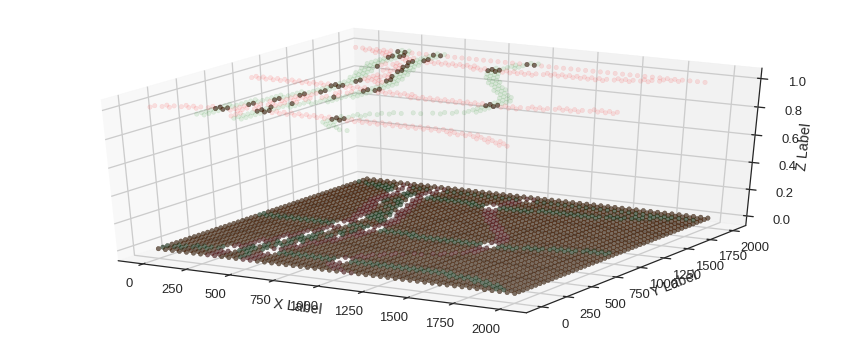

In [249]:
#fig = plt.figure()
#ax = fig.add_subplot(111, projection='3d')
##ax.scatter(grid_x, grid_y, grid_z0, c="b", alpha = 0.1)
#ax.scatter(grid_x, grid_y, asc3, c="r", alpha = 0.1)
#ax.scatter(grid_x, grid_y, bsc3, c="g", alpha = 0.1)
#ax.scatter(grid_x, grid_y, c, c="black", alpha = 0.5)
#
#ax.set_xlabel('X Label')
#ax.set_ylabel('Y Label')
#ax.set_zlabel('Z Label')
#
#plt.show()

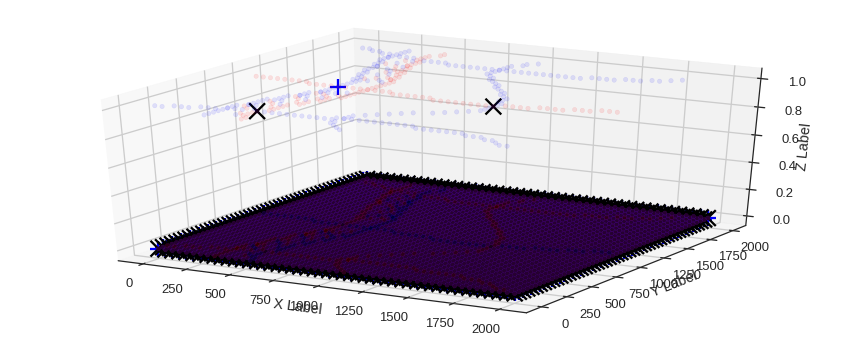

In [372]:
#fault_line = grid_minX[grid_maxX]
#figsize(15,6)
#fig = plt.figure()
#ax = fig.add_subplot(111, projection='3d')
##ax.scatter(grid_x, grid_y, grid_z0, c="b", alpha = 0.1)
#ax.scatter(grid_x, grid_y, grid_minY, c="b", alpha = 0.1)
#ax.scatter(grid_x, grid_y, grid_maxY, c="r", alpha = 0.1)
#ax.scatter(grid_x, grid_y, grid_minX, c="b", alpha = 0.1)
#ax.scatter(grid_x, grid_y, grid_maxX, c="r", alpha = 0.1)
#ax.scatter(grid_x, grid_y, spill_points, c="black", alpha = 1, marker='x', s = 250)
#ax.scatter(grid_x, grid_y, leak_point, c="b", alpha = 1, marker='+', s= 250)
#
#ax.set_xlabel('X Label')
#ax.set_ylabel('Y Label')
#ax.set_zlabel('Z Label')
#
#plt.show()

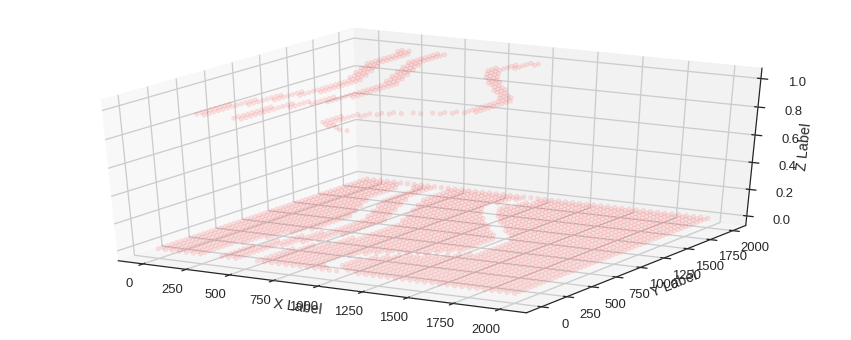

In [245]:
#fig = plt.figure()
#ax = fig.add_subplot(111, projection='3d')
##ax.scatter(grid_x, grid_y, grid_z0, c="b", alpha = 0.1)
##ax.scatter(grid_x, grid_y, -a, c="r", alpha = 0.1)
##ax.scatter(grid_x, grid_y, -asignchange, c="g", alpha = 0.1)
#ax.scatter(grid_x, grid_y, bsc3, c="r", alpha = 0.1)
#
#ax.set_xlabel('X Label')
#ax.set_ylabel('Y Label')
#ax.set_zlabel('Z Label')
#
#plt.show()

In [38]:
# SPILL AND LEAK POINT FUNCTIONS

# Finding the spill point
#def spill_point(res_surface):
#    mini = argrelextrema(res_surface[:,2], np.less, order=10)
#    minima = np.array(list(zip(np.take(res_surface[:,1], mini[0]), np.take(res_surface[:,0], mini[0]), np.take(res_surface[:,2], mini[0]))))
#    fault_thresh = minima[:,1] > 700 #taking only relevant side by setting a threshold visually estimated, best: 20
#    spill_min_line = minima[fault_thresh]
#    spill_pos = np.array(np.argmax(spill_min_line[:,2]))
#    spill_z = np.take(spill_min_line[:,2], spill_pos)
#    spill_p = np.array([np.take(spill_min_line[:,1], spill_pos), np.take(spill_min_line[:,0],
#                                spill_pos), np.take(spill_min_line[:,2], spill_pos)])
#    
#    # Horizontal plane defined by z-pos of spill
#    if True:
#        spill_bottom = np.ones_like(res_surface)
#        spill_bottom[:,0] = res_surface[:,0]
#        spill_bottom[:,1] = res_surface[:,1]
#        spill_bottom[:,2] = spill_z    
#    
#    return spill_z, spill_p, spill_min_line, spill_bottom
#
## Finding the leak point ( critically inefficient method! takes 10s!)
#def leak_point(res_surface):
#    counter = 0
#    # Creating empty lists and arrays to save values
#    xvals = []
#    yvals = []
#    zvals = []
#    leak_min = np.empty((0,3), dtype=int)
#    #leak_min = np.empty([3,], dtype=int)
#    
#    for i in np.unique(res_surface[:,1]):
#        
#    #while counter < model_size:
#        #print(counter)
#        for e in res_surface:
#            # Looking at a slice along y-axis for y = e[1] = counter, 
#            # and appending x,y,z-values into lists
#            # This is a way of RESORTING the array as needed
#            #if int(e[1]) == counter:
#            if e[1] == i:
#                xvals.append(e[0])
#                yvals.append(e[1])
#                zvals.append(e[2])
#            
#        # Saving x,y,z-values as lists/arrays      
#        zvals = np.array(zvals)
#        yvals = np.array(yvals)
#        xvals = np.array(xvals)
#
#        # Looking fore minima positions in z-array
#        min_pos = argrelextrema(zvals, np.less, order=10)
#        
#        # Saving x,y,z-positions of minima
#        ypos = yvals[min_pos]
#        xpos = xvals[min_pos]
#        mins = zvals[min_pos]
#        
#        # Condition: Check if any minimum was found and if any data is given at y = counter
#        # If no minimum found, restart loop at next iteration
#        # This way, we can work with the data that coesn't cover every 1 step along the model
#        # (such as the surface vertices)
#        if len(mins) == 0:
#            counter += 1
#            #lists have to be emptied again
#            xvals = []
#            yvals = []
#            zvals = []
#            continue
#        
#        #np.append(leak_min, mins) -----> what did I use this for?
#        
#        # Create and array element to save coordinates of minima
#        mins_pos = np.array(list(zip(xpos, ypos, mins)))
#        # Save minima of slice into array of ALL minima
#        leak_min = np.vstack((leak_min, mins_pos))
#
#        # Empty lists for next iteration
#        xvals = []
#        yvals = []
#        zvals = []
#    
#        counter += 1
#        
#    #leak_min = np.delete(leak_min, 0, 0) #what does this do???
#    
#    # Result of the loop above is one or SEVERAL lines of minima ("leak lines")
#    # only want to look at the line bordering the fault surface
#    # need for a general function/method to limit to only that line!
#    # For now: Taking only relevant side by setting a threshold that is visually estimated
#    near_fault_thresh = leak_min[:,0] < 1500
#    leak_line = leak_min[near_fault_thresh]
#    
#    # The highest point of the leak line is the leak point!
#    leak_pos = np.array(np.argmax(leak_line[:,2]))
#    leak_z = np.take(leak_line[:,2], leak_pos)
#
#    # Full coordinates of the leak point as array element
#    leak_p = np.array([np.take(leak_line[:,1], leak_pos), np.take(leak_line[:,0], leak_pos), np.take(leak_line[:,2], leak_pos)])
#    
#    # Creating a horizontal plane defined by the leak point z-position, in shape of res_surface
#    leak_bottom = np.ones_like(res_surface)
#    leak_bottom[:,0] = res_surface[:,0]
#    leak_bottom[:,1] = res_surface[:,1]
#    leak_bottom[:,2] = leak_z
#   
#    return leak_z, leak_p, leak_line, leak_bottom

### PLOTTING SP, LP and TRAP
#def plot_spill(res_surface, spill_min_line, spill_p):
#    fig = plt.figure()
#    ax = fig.add_subplot(111, projection='3d')
#    ax.scatter(-res_surface[:,1], -res_surface[:,0], res_surface[:,2], c="b", alpha = 0.1)
#    ax.scatter(-spill_min_line[:,0], -spill_min_line[:,1], spill_min_line[:,2], c='r', s = 50)
#    ax.scatter(-spill_p[1], -spill_p[0], spill_p[2], c='yellow', s = 200)
#    
#    ax.set_xlabel('X Label')
#    ax.set_ylabel('Y Label')
#    ax.set_zlabel('Z Label')
#
#    plt.show()
#
#def plot_leak(res_surface, leak_line, leak_p):
#    fig = plt.figure()
#    ax = fig.add_subplot(111, projection='3d')
#    
#    ax.scatter(-res_surface[:,1], -res_surface[:,0], res_surface[:,2], c="b", alpha = 0.1)
#    ax.scatter(-leak_line[:,1], -leak_line[:,0], leak_line[:,2], c='r', s = 50)
#    ax.scatter(-leak_p[1], -leak_p[0], leak_p[2], c='green', s = 200)
#    
#    ax.set_xlabel('X Label')
#    ax.set_ylabel('Y Label')
#    ax.set_zlabel('Z Label')
#    
#    plt.show()
#    
#def plot_trap(res_surface, bottom_surface, spill_p, leak_p):
#    fig = plt.figure()
#    ax = fig.add_subplot(111, projection='3d')
#    ax.scatter(-bottom_surface[:,1], -bottom_surface[:,0], bottom_surface[:,2], c="r", alpha = 0.05)
#    ax.scatter(-res_surface[:,1], -res_surface[:,0], res_surface[:,2], c="b", alpha = 0.1)
#    ax.scatter(-spill_p[1], -spill_p[0], spill_p[2], c='yellow', s = 1000)
#    ax.scatter(-leak_p[1], -leak_p[0], leak_p[2], c='green', s = 1000)
#
#    
#    ax.set_xlabel('X Label')
#    ax.set_ylabel('Y Label')
#    ax.set_zlabel('Z Label')
#    
#    plt.show()